In [1]:
import time
import os
import random
import numpy as np                                                
import matplotlib.pyplot as plt                                   
import autograd, autograd.core, autograd.extend, autograd.tracer  
import autograd.numpy as anp      
import scipy, scipy.ndimage, scipy.sparse, scipy.sparse.linalg    
                                                     
import gym
from gymnasium import spaces

from stable_baselines3 import PPO, A2C
from stable_baselines3.common.env_checker import check_env
from stable_baselines3.common.monitor import Monitor
from stable_baselines3.common.results_plotter import load_results, ts2xy
from stable_baselines3.common.callbacks import BaseCallback
from stable_baselines3.common import results_plotter

from skimage.transform import resize
import torch
import torch.nn as nn
import torch.nn.functional as F

import mcts
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

from functools import reduce
import operator
from copy import deepcopy

The below code is my RL extension to https://www.researchgate.net/publication/360698153_A_Tutorial_on_Structural_Optimization 

In [2]:
x0,y0=6,6

In [3]:
class ObjectView(object):
    def __init__(self, d): self.__dict__ = d
    
def get_args(normals, forces, density=1e-4):  # Manage the problem setup parameters
    width = normals.shape[0] - 1
    height = normals.shape[1] - 1
    fixdofs = np.flatnonzero(normals.ravel())
    alldofs = np.arange(2 * (width + 1) * (height + 1))
    freedofs = np.sort(list(set(alldofs) - set(fixdofs)))
    params = {
      # material properties
      'young': 1, 'young_min': 1e-9, 'poisson': 0.3, 'g': 0,
      # constraints
      'density': density, 'xmin': 0.001, 'xmax': 1.0,
      # input parameters
      'nelx': width, 'nely': height, 'mask': 1, 'penal': 3.0, 'filter_width': 1,
      'freedofs': freedofs, 'fixdofs': fixdofs, 'forces': forces.ravel(),
      # optimization parameters
      'opt_steps': 80, 'print_every': 10}
    return ObjectView(params)

def mbb_beam(width = y0, height = x0, density=1e-4, y=1, x=0, rd=-1):  # textbook beam example
    normals = np.zeros((width + 1, height + 1, 2))
    normals[0, 0, x] = 1
    normals[0, 0, y] = 1
    normals[0, -1, x] = 1
    normals[0, -1, y] = 1
    forces = np.zeros((width + 1, height + 1, 2))
    forces[-1, rd, y] = -1
    return normals, forces, density

In [4]:
def young_modulus(x, e_0, e_min, p=3):
    return e_min + x ** p * (e_0 - e_min)

def physical_density(x, args, volume_contraint=False, use_filter=True):
    x = args.mask * x.reshape(args.nely, args.nelx)  # reshape from 1D to 2D
    return gaussian_filter(x, args.filter_width) if use_filter else x  # maybe filter

def mean_density(x, args, volume_contraint=False, use_filter=True):
    return anp.mean(physical_density(x, args, volume_contraint, use_filter)) / anp.mean(args.mask)

In [5]:
def objective(x, args, volume_contraint=False, use_filter=True):
    kwargs = dict(penal=args.penal, e_min=args.young_min, e_0=args.young)
    x_phys = physical_density(x, args, volume_contraint=volume_contraint, use_filter=use_filter)
    ke     = get_stiffness_matrix(args.young, args.poisson)  # stiffness matrix
    u      = displace(x_phys, ke, args.forces, args.freedofs, args.fixdofs, **kwargs)
    c      = compliance(x_phys, u, ke, **kwargs)
    return c

In [6]:
@autograd.extend.primitive
def gaussian_filter(x, width): # 2D gaussian blur/filter
    return scipy.ndimage.gaussian_filter(x, width, mode='reflect')

def _gaussian_filter_vjp(ans, x, width): # gives the gradient of orig. function w.r.t. x
    del ans, x  # unused
    return lambda g: gaussian_filter(g, width)
autograd.extend.defvjp(gaussian_filter, _gaussian_filter_vjp)

In [7]:
def compliance(x_phys, u, ke, *, penal=3, e_min=1e-9, e_0=1):
    nely, nelx = x_phys.shape
    ely, elx = anp.meshgrid(range(nely), range(nelx))  # x, y coords for the index map

    n1 = (nely+1)*(elx+0) + (ely+0)  # nodes
    n2 = (nely+1)*(elx+1) + (ely+0)
    n3 = (nely+1)*(elx+1) + (ely+1)
    n4 = (nely+1)*(elx+0) + (ely+1)
    all_ixs = anp.array([2*n1, 2*n1+1, 2*n2, 2*n2+1, 2*n3, 2*n3+1, 2*n4, 2*n4+1])
    u_selected = u[all_ixs]  # select from u matrix

    ke_u = anp.einsum('ij,jkl->ikl', ke, u_selected)  # compute x^penal * U.T @ ke @ U
    ce = anp.einsum('ijk,ijk->jk', u_selected, ke_u)
    C = young_modulus(x_phys, e_0, e_min, p=penal) * ce.T
    return anp.sum(C)

def get_stiffness_matrix(e, nu):  # e=young's modulus, nu=poisson coefficient
    k = anp.array([1/2-nu/6, 1/8+nu/8, -1/4-nu/12, -1/8+3*nu/8,
                -1/4+nu/12, -1/8-nu/8, nu/6, 1/8-3*nu/8])
    return e/(1-nu**2)*anp.array([[k[0], k[1], k[2], k[3], k[4], k[5], k[6], k[7]],
                               [k[1], k[0], k[7], k[6], k[5], k[4], k[3], k[2]],
                               [k[2], k[7], k[0], k[5], k[6], k[3], k[4], k[1]],
                               [k[3], k[6], k[5], k[0], k[7], k[2], k[1], k[4]],
                               [k[4], k[5], k[6], k[7], k[0], k[1], k[2], k[3]],
                               [k[5], k[4], k[3], k[2], k[1], k[0], k[7], k[6]],
                               [k[6], k[3], k[4], k[1], k[2], k[7], k[0], k[5]],
                               [k[7], k[2], k[1], k[4], k[3], k[6], k[5], k[0]]])

In [8]:
def get_k(stiffness, ke):
    # Constructs sparse stiffness matrix k (used in the displace fn)
    # First, get position of the nodes of each element in the stiffness matrix
    nely, nelx = stiffness.shape
    ely, elx = anp.meshgrid(range(nely), range(nelx))  # x, y coords
    ely, elx = ely.reshape(-1, 1), elx.reshape(-1, 1)

    n1 = (nely+1)*(elx+0) + (ely+0)
    n2 = (nely+1)*(elx+1) + (ely+0)
    n3 = (nely+1)*(elx+1) + (ely+1)
    n4 = (nely+1)*(elx+0) + (ely+1)
    edof = anp.array([2*n1, 2*n1+1, 2*n2, 2*n2+1, 2*n3, 2*n3+1, 2*n4, 2*n4+1])
    edof = edof.T[0]
    x_list = anp.repeat(edof, 8)  # flat list pointer of each node in an element
    y_list = anp.tile(edof, 8).flatten()  # flat list pointer of each node in elem

    # make the global stiffness matrix K
    kd = stiffness.T.reshape(nelx*nely, 1, 1)
    value_list = (kd * anp.tile(ke, kd.shape)).flatten()
    return value_list, y_list, x_list

def displace(x_phys, ke, forces, freedofs, fixdofs, *, penal=3, e_min=1e-9, e_0=1):
    # Displaces the load x using finite element techniques (solve_coo=most of runtime)
    stiffness = young_modulus(x_phys, e_0, e_min, p=penal)
    k_entries, k_ylist, k_xlist = get_k(stiffness, ke)

    index_map, keep, indices = _get_dof_indices(freedofs, fixdofs, k_ylist, k_xlist)

    u_nonzero = solve_coo(k_entries[keep], indices, forces[freedofs], sym_pos=True)
    u_values = anp.concatenate([u_nonzero, anp.zeros(len(fixdofs))])
    return u_values[index_map]

In [9]:
def _get_dof_indices(freedofs, fixdofs, k_xlist, k_ylist):
    index_map = inverse_permutation(anp.concatenate([freedofs, fixdofs]))
    keep = anp.isin(k_xlist, freedofs) & anp.isin(k_ylist, freedofs)
    # Now we index an indexing array that is being indexed by the indices of k
    i = index_map[k_ylist][keep]
    j = index_map[k_xlist][keep]
    return index_map, keep, anp.stack([i, j])

def inverse_permutation(indices):  # reverses an index operation
    inverse_perm = np.zeros(len(indices), dtype=anp.int64)
    inverse_perm[indices] = np.arange(len(indices), dtype=anp.int64)
    return inverse_perm

In [10]:
def _get_solver(a_entries, a_indices, size, sym_pos):
    # a is (usu.) symmetric positive; could solve 2x faster w/sksparse.cholmod.cholesky(a).solve_A
    a = scipy.sparse.coo_matrix((a_entries, a_indices), shape=(size,)*2).tocsc()
    return scipy.sparse.linalg.splu(a).solve

@autograd.primitive
def solve_coo(a_entries, a_indices, b, sym_pos=False):
    solver = _get_solver(a_entries, a_indices, b.size, sym_pos)
    return solver(b)

def grad_solve_coo_entries(ans, a_entries, a_indices, b, sym_pos=False):
    def jvp(grad_ans):
        lambda_ = solve_coo(a_entries, a_indices if sym_pos else a_indices[::-1],
                            grad_ans, sym_pos)
        i, j = a_indices
        return -lambda_[i] * ans[j]
    return jvp

autograd.extend.defvjp(solve_coo, grad_solve_coo_entries,
                       lambda: print('err: gradient undefined'),
                       lambda: print('err: gradient not implemented'))

In [11]:
class Model:
    def __init__(self, x):
        self.flag_ = True
#         self.flag_ = False
        self.n, self.m = x.shape
        self.actions_dic={} 
        self.actions_dic_rev={}
    
        k=0
        for i in range(self.n):
            for j in range(self.m):
                self.actions_dic[k]=(i,j)
                self.actions_dic_rev[i,j]=k
                k+=1
        
    def action_space_(self, action, X):
        x,y=self.actions_dic[action]
        X[x][y]=1
        
    def draw(self,X):  
        plt.figure(dpi=50) 
        print('\nFinal Cantilever beam design:')
        plt.imshow(X) 
        plt.show()

In [12]:
def fast_stopt(args, x):

    reshape = lambda x: x.reshape(args.nely, args.nelx)
    objective_fn = lambda x: objective(reshape(x), args)
#     constraint = lambda params: mean_density(reshape(params), args) - args.density
    constraint = lambda params: mean_density(reshape(params), args) 
    value = objective_fn(x)
    const = constraint(x)
    return value, const

In [13]:
class NaughtsAndCrossesState():
    def __init__(self, board, tf_model):
        self.board = board
        self.currentPlayer = 1
        self.tf_model = tf_model
#         self.args_2=args_2
        
    def getCurrentPlayer(self):
        return self.currentPlayer

    def getPossibleActions(self):
        possibleActions = []
        for i in range(self.board.shape[0]):
            for j in range(self.board.shape[1]):
                if self.board[i][j] != 1:
                    possibleActions.append(Action(player=self.currentPlayer, x=i, y=j))
#         print(possibleActions)            
        return possibleActions

    def takeAction(self, action):
        newState = deepcopy(self)
        newState.board[action.x][action.y] = action.player
#         print(newState,'new')
        newState.currentPlayer = self.currentPlayer * -1
        return newState

    def isTerminal(self):
        count=0
        for i in range(self.board.shape[0]):
            for j in range(self.board.shape[1]):
                if self.board[i][j] == 1:
                    count+=1
#         print(count,'count',count/(self.board.shape[0]*self.board.shape[1]))            
        
        if count/(self.board.shape[0]*self.board.shape[1]) > 0.68:
            return True
        
#         if count >=self.board.shape[0]*self.board.shape[1]:
#             return True
        
        return reduce(operator.mul, sum(self.board.tolist(), []), 0)
#         return False
 
    def getReward(self):
        ans=self.tf_model.predict(self.board.reshape(1,self.board.shape[0]*self.board.shape[1]))
#         print(ans[0][0][0]+random.uniform(0, 1))
#         tmp, const = fast_stopt(self.args_2, self.board)
        return ans[0][0][0]
#         return tmp

class Action():
    def __init__(self, player, x, y):
        self.player = player
        self.x = x
        self.y = y

    def __str__(self):
        return str((self.x, self.y))

    def __repr__(self):
        return str(self)

    def __eq__(self, other):
        return self.__class__ == other.__class__ and self.x == other.x and self.y == other.y and self.player == other.player

    def __hash__(self):
        return hash((self.x, self.y, self.player))

In [14]:
class CantileverEnv(gym.Env):
    
    metadata = {"render.modes": ["human"]}

    def __init__(self, normalized_image: bool = False):
        super().__init__()
        
        
        self.rd=0
        self.args = get_args(*mbb_beam(rd=self.rd))
        
#         DIM=self.args.nelx*self.args.nely
        N_DISCRETE_ACTIONS=self.args.nelx*self.args.nely
        
        self.action_space = spaces.Discrete(N_DISCRETE_ACTIONS)
        self.observation_space = spaces.Box(low=0,
                                            high=255,
                                            shape=(self.args.nely, self.args.nelx, 1),
                                            dtype=np.float64)
        
 
        self.x = anp.ones((self.args.nely, self.args.nelx))*self.args.density
    
        self.M=Model(self.x)
        
        self.tf_model = Sequential()
        self.tf_model.add(Dense(self.x.shape[0]*self.x.shape[1], input_shape = (self.x.shape[0]*self.x.shape[1],1), name = "input_Layer"))
        self.tf_model.add(Dense(5, activation = "relu"))
        self.tf_model.add(Dense(5, activation = "relu"))
        self.tf_model.add(Dense(1, activation = None, name = "output_Layer"))
       
     
        self.tf_model.compile(loss = tf.keras.losses.mae,
                optimizer = tf.keras.optimizers.legacy.Adam(),
                metrics = ["mae"])
        
        self.reward=0
        self.step_=0
        self.needs_reset = True
        
    def step(self, action):
        
        self.args = get_args(*mbb_beam(rd=self.rd))
        
        
        
        if self.step_>15:
            initialState = NaughtsAndCrossesState(self.x, self.tf_model)
            searcher = mcts.mcts(timeLimit=500)
#             print(searcher)
        
            action_m = searcher.search(initialState=initialState)
        
        self.M.action_space_(action, self.x)
        
        tmp, const = fast_stopt(self.args, self.x)
        
        

        
        self.step_+=1
#         print(self.x)
#         print(action_m)
#         print(self.M.actions_dic_rev)
#         print(type(action_m))
#         print(action)
#         print(self.M.actions_dic_rev[action_m.x,action_m.y])
#         self.reward+=(1/tmp)**2+float(action==self.M.actions_dic_rev[action_m.x,action_m.y])
        
        if self.step_>16:
            self.tf_model.fit(self.x.reshape(1,self.x.shape[0]*self.x.shape[1]),
                          np.array([tmp])
                          , epochs = 5)
            self.reward+=(1/tmp)**2+float(action==self.M.actions_dic_rev[action_m.x,action_m.y])

        else:
            self.reward+=(1/tmp)**2
       
        done=False
                  
        if self.step_>self.M.n*self.M.m:
            done=True
            
        if const>0.65:
#             self.reward-=1
            done=True
            
        if self.needs_reset:
            raise RuntimeError("Tried to step environment that needs reset")
            
        if done:
            self.needs_reset = True
                         
                
#         resized_x = resize(self.x, ( self.args.nely, self.args.nelx), anti_aliasing=True)  
#         resized_x = (resized_x * 255).astype(np.uint8).reshape(x0,y0,1)

        return self.x.reshape(x0,y0,1), self.reward, done, False, {}

    def reset(self, seed=0):
        
        if not self.M.flag_:
            self.rd=random.choice([0,2,-2])
        else:
            self.rd=-1
           
        self.x = anp.ones((self.args.nely, self.args.nelx))*self.args.density 

        self.reward=0
        self.needs_reset = False
        self.step_=0
        
#         resized_x = resize(self.x, (self.args.nely, self.args.nelx), anti_aliasing=True)
#         resized_x = (resized_x * 255).astype(np.uint8).reshape(x0,y0,1)

        return self.x.reshape(x0,y0,1), {}

    def render(self, mode="human"):
        self.M.draw(self.x)    

    def close(self):
        pass

In [15]:
class SaveOnBestTrainingRewardCallback(BaseCallback):
    """
    Callback for saving a model (the check is done every ``check_freq`` steps)
    based on the training reward (in practice, we recommend using ``EvalCallback``).

    :param check_freq: (int)
    :param log_dir: (str) Path to the folder where the model will be saved.
      It must contains the file created by the ``Monitor`` wrapper.
    :param verbose: (int)
    """

    def __init__(self, check_freq: int, log_dir: str, verbose=1):
        super().__init__(verbose)
        self.check_freq = check_freq
        self.log_dir = log_dir
        self.save_path = os.path.join(log_dir, "best_model")
        self.best_mean_reward = -np.inf

    def _init_callback(self) -> None:
        # Create folder if needed
        if self.save_path is not None:
            os.makedirs(self.save_path, exist_ok=True)

    def _on_step(self) -> bool:
        if self.n_calls % self.check_freq == 0:

            # Retrieve training reward
            x, y = ts2xy(load_results(self.log_dir), "timesteps")
            if len(x) > 0:
                # Mean training reward over the last 100 episodes
                mean_reward = np.mean(y[-100:])
                if self.verbose > 0:
                    print(f"Num timesteps: {self.num_timesteps}")
                    print(
                        f"Best mean reward: {self.best_mean_reward:.2f} - Last mean reward per episode: {mean_reward:.2f}"
                    )

                # New best model, you could save the agent here
                if mean_reward > self.best_mean_reward:
                    self.best_mean_reward = mean_reward
                    # Example for saving best model
                    if self.verbose > 0:
                        print(f"Saving new best model to {self.save_path}.zip")
                    self.model.save(self.save_path)

        return True

In [16]:
# ts=5e6
ts=0.1e6

In [17]:
# Create log dir
log_dir = "/tmp/gym13/"
os.makedirs(log_dir, exist_ok=True)

# Create and wrap the environment
env = CantileverEnv()
# Logs will be saved in log_dir/monitor.csv
env = Monitor(env, log_dir)
check_env(env)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/stable_baselines3/common/env_checker.py:30: UserWarning: It seems that your observation  is an image but its `dtype` is (float64) whereas it has to be `np.uint8`. If your observation is not an image, we recommend you to flatten the observation to have only a 1D vector
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/stable_baselines3/common/env_checker.py:51: UserWarning: The minimal resolution for an image is 36x36 for the default `CnnPolicy`. You might need to use a custom features extractor cf. https://stable-baselines3.readthedocs.io/en/master/guide/custom_policy.html
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.render_mode to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.render_mode` for 

In [18]:
# callback = SaveOnBestTrainingRewardCallback(check_freq=5000, log_dir=log_dir)
callback = SaveOnBestTrainingRewardCallback(check_freq = 1000, log_dir = log_dir)

In [19]:
start = time.time()
model = PPO("MlpPolicy", env).learn(total_timesteps=ts, callback=callback)
# model = PPO.load(log_dir + "best_model.zip", env=env).learn(total_timesteps=ts, callback=callback)
end = time.time()   

1/1 [==============================] - 0s 59ms/step
Epoch 1/5
1/1 [==============================] - 0s 191ms/step - loss: 68826776.0000 - mae: 68826776.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68826776.0000 - mae: 68826776.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68826776.0000 - mae: 68826776.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68826776.0000 - mae: 68826776.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 231408.2656 - mae: 231408.2656
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 231408.2656 - mae: 231408.2656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 231408.2656 - mae: 231408.2656
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 231408.2500 - mae: 231408.2500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9078.5986 - mae: 9078.5986
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9078.5977 - mae: 9078.5977
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9078.5967 - mae: 9078.5967
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9078.5947 - mae: 9078.5947
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9073.9971 - mae: 9073.9971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9073.9961 - mae: 9073.9961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9073.9951 - mae: 9073.9951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9073.9941 - mae: 9073.9941
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 151.5334 - mae: 151.5334
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 151.5324 - mae: 151.5324
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 151.5314 - mae: 151.5314
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 133.5762 - mae: 133.5762
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.5752 - mae: 133.5752
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.5742 - mae: 133.5742
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 133.5732 - mae: 133.5732
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 93.5653 - mae: 93.5653
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 93.5643 - mae: 93.5643
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 346.8060 - mae: 346.8060
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 346.8050 - mae: 346.8050
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 346.8040 - mae: 346.8040
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 346.8029 - mae: 346.8029
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 346.8010 - mae: 346.8010
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 346.8000 - mae: 346.8000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 346.7990 - mae: 346.7990
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 346.7979 - mae: 346.7979
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 304

1/1 [==============================] - 0s 2ms/step - loss: 171.7089 - mae: 171.7089
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 171.7079 - mae: 171.7079
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.7916 - mae: 166.7916
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.7906 - mae: 166.7906
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.7896 - mae: 166.7896
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.7886 - mae: 166.7886
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 165.4680 - mae: 165.4680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 165.4670 - mae: 165.4670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 165.4660 - mae: 165.4660
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 110.0712 - mae: 110.0712
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0692 - mae: 110.0692
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0682 - mae: 110.0682
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0672 - mae: 110.0672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0662 - mae: 110.0662
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0642 - mae: 110.0642
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0632 - mae: 110.0632
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0622 - mae: 110.0622
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0612 - mae: 110.0612
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 8470.3906 - mae: 8470.3906
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8470.3896 - mae: 8470.3896
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8470.3887 - mae: 8470.3887
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8470.3867 - mae: 8470.3867
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8470.3857 - mae: 8470.3857
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8470.3848 - mae: 8470.3848
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8470.3838 - mae: 8470.3838
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8468.0254 - mae: 8468.0254
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8468.0244 - mae: 8468.0244
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 507.0695 - mae: 507.0695
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0675 - mae: 507.0675
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0665 - mae: 507.0665
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0656 - mae: 507.0656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0645 - mae: 507.0645
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0625 - mae: 507.0625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0615 - mae: 507.0615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 507.0605 - mae: 507.0605
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 507.0595 - mae: 507.0595
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 291.7661 - mae: 291.7661
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 291.7651 - mae: 291.7651
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 291.7641 - mae: 291.7641
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 291.7621 - mae: 291.7621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 291.7611 - mae: 291.7611
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 291.7601 - mae: 291.7601
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 291.7591 - mae: 291.7591
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 282.6113 - mae: 282.6113
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 282.6103 - mae: 282.6103
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 8ms/step - loss: 48.4619 - mae: 48.4619
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48.4609 - mae: 48.4609
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.4589 - mae: 48.4589
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.4579 - mae: 48.4579
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.4569 - mae: 48.4569
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.4559 - mae: 48.4559
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.1912 - mae: 38.1912
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.1902 - mae: 38.1902
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.1892 - mae: 38.1892
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 196.6451 - mae: 196.6451
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 196.6441 - mae: 196.6441
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 196.6431 - mae: 196.6431
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 196.6421 - mae: 196.6421
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 196.6401 - mae: 196.6401
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 196.6391 - mae: 196.6391
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 196.6381 - mae: 196.6381
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 196.6371 - mae: 196.6371
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 196

1/1 [==============================] - 0s 2ms/step - loss: 388.9742 - mae: 388.9742
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 388.9731 - mae: 388.9731
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 372.9289 - mae: 372.9289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 372.9279 - mae: 372.9279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 372.9269 - mae: 372.9269
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 372.9259 - mae: 372.9259
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 370.6741 - mae: 370.6741
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 370.6731 - mae: 370.6731
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 370.6721 - mae: 370.6721
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9243 - mae: 705.9243
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 705.9233 - mae: 705.9233
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9222 - mae: 705.9222
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9213 - mae: 705.9213
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9193 - mae: 705.9193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9183 - mae: 705.9183
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9172 - mae: 705.9172
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 705.9163 - mae: 705.9163
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 366

1/1 [==============================] - 0s 4ms/step - loss: 98.6791 - mae: 98.6791
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 98.6781 - mae: 98.6781
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 98.6761 - mae: 98.6761
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 98.6751 - mae: 98.6751
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 98.6741 - mae: 98.6741
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.6731 - mae: 98.6731
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.7707 - mae: 76.7707
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 76.7697 - mae: 76.7697
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 76.7687 - mae: 76.7687
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0255 - mae: 176.0255
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0245 - mae: 176.0245
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0235 - mae: 176.0235
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0225 - mae: 176.0225
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0204 - mae: 176.0204
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0195 - mae: 176.0195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0184 - mae: 176.0184
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 176.0175 - mae: 176.0175
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 176

1/1 [==============================] - 0s 2ms/step - loss: 427.4621 - mae: 427.4621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 427.4611 - mae: 427.4611
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 427.4601 - mae: 427.4601
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 427.4591 - mae: 427.4591
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 427.4571 - mae: 427.4571
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 427.4561 - mae: 427.4561
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 427.4551 - mae: 427.4551
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 427.4541 - mae: 427.4541
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 361.3644 - mae: 361.3644
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.1813 - mae: 40.1813
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.1803 - mae: 40.1803
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 40.1793 - mae: 40.1793
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.1783 - mae: 40.1783
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7780 - mae: 34.7780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7771 - mae: 34.7771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7761 - mae: 34.7761
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7751 - mae: 34.7751
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2620.8406 - mae: 26

1/1 [==============================] - 0s 2ms/step - loss: 168.3049 - mae: 168.3049
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.3039 - mae: 168.3039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.3029 - mae: 168.3029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.3019 - mae: 168.3019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 128.0078 - mae: 128.0078
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 128.0068 - mae: 128.0068
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 128.0058 - mae: 128.0058
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 128.0048 - mae: 128.0048
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 128.0028 - mae: 128.0028
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8211 - mae: 80.8211
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8201 - mae: 80.8201
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 80.8191 - mae: 80.8191
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8181 - mae: 80.8181
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8161 - mae: 80.8161
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8151 - mae: 80.8151
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8141 - mae: 80.8141
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 80.8131 - mae: 80.8131
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1609 - mae: 75.1

1/1 [==============================] - 0s 3ms/step - loss: 220038.7969 - mae: 220038.7969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220038.7969 - mae: 220038.7969
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 220038.7969 - mae: 220038.7969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220038.7969 - mae: 220038.7969
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 220038.7812 - mae: 220038.7812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220038.7812 - mae: 220038.7812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220038.7812 - mae: 220038.7812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220038.7812 - mae: 220038.7812
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 218652.7969 - mae

1/1 [==============================] - 0s 2ms/step - loss: 152.7260 - mae: 152.7260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7250 - mae: 152.7250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7240 - mae: 152.7240
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7220 - mae: 152.7220
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7210 - mae: 152.7210
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7200 - mae: 152.7200
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7190 - mae: 152.7190
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 147.5660 - mae: 147.5660
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 147.5650 - mae: 147.5650
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 128.0692 - mae: 128.0692
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 128.0682 - mae: 128.0682
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 128.0672 - mae: 128.0672
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 72.4461 - mae: 72.4461
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.4451 - mae: 72.4451
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 72.4441 - mae: 72.4441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 72.4431 - mae: 72.4431
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5983 - mae: 66.5983
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5973 - mae: 66.5973
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 119.4206 - mae: 119.4206
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 119.4196 - mae: 119.4196
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 119.4186 - mae: 119.4186
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 119.4176 - mae: 119.4176
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9500 - mae: 107.9500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9490 - mae: 107.9490
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9480 - mae: 107.9480
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9470 - mae: 107.9470
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107

1/1 [==============================] - 0s 2ms/step - loss: 84.6455 - mae: 84.6455
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10444.6611 - mae: 10444.6611
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10444.6602 - mae: 10444.6602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10444.6592 - mae: 10444.6592
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10444.6582 - mae: 10444.6582
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10404.8711 - mae: 10404.8711
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10404.8701 - mae: 10404.8701
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 10404.8691 - mae: 10404.8691
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10404.8682 - mae: 10404.8682
Epoch 5/5


1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.0840 - mae: 67.0840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67.0830 - mae: 67.0830
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.0820 - mae: 67.0820
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 67.0810 - mae: 67.0810
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.0790 - mae: 67.0790
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 67.0780 - mae: 67.0780
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.0770 - mae: 67.0770
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.0760 - mae: 67.0760
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 64.6311 - mae: 64.6

1/1 [==============================] - 0s 2ms/step - loss: 164.6358 - mae: 164.6358
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6348 - mae: 164.6348
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6338 - mae: 164.6338
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6328 - mae: 164.6328
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6308 - mae: 164.6308
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6298 - mae: 164.6298
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6288 - mae: 164.6288
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6278 - mae: 164.6278
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 164.6258 - mae: 164.6258
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 114.8753 - mae: 114.8753
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8743 - mae: 114.8743
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9549 - mae: 107.9549
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9539 - mae: 107.9539
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9529 - mae: 107.9529
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 107.9519 - mae: 107.9519
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9499 - mae: 107.9499
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9489 - mae: 107.9489
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107.9479 - mae: 107.9479
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.2723 - mae: 37.2723
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.2713 - mae: 37.2713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.2703 - mae: 37.2703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.2693 - mae: 37.2693
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 37.2673 - mae: 37.2673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.2663 - mae: 37.2663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.2653 - mae: 37.2653
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 37.2643 - mae: 37.2643
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.5562 - mae: 32.5

1/1 [==============================] - 0s 2ms/step - loss: 1633.8468 - mae: 1633.8468
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1633.8458 - mae: 1633.8458
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1633.8448 - mae: 1633.8448
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1633.8428 - mae: 1633.8428
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1633.8418 - mae: 1633.8418
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1633.8408 - mae: 1633.8408
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1633.8398 - mae: 1633.8398
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1538.4437 - mae: 1538.4437
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 1538.4427 - mae: 1538.4427
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 888.4566 - mae: 888.4566
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 888.4556 - mae: 888.4556
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 888.4546 - mae: 888.4546
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 888.4536 - mae: 888.4536
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 663.9705 - mae: 663.9705
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 663.9695 - mae: 663.9695
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 663.9685 - mae: 663.9685
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 663.9675 - mae: 663.9675
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 663.9655 - mae: 663.9655
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 147.0043 - mae: 147.0043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 147.0033 - mae: 147.0033
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 147.0013 - mae: 147.0013
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 147.0003 - mae: 147.0003
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 146.9993 - mae: 146.9993
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 146.9983 - mae: 146.9983
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 346.0896 - mae: 346.0896
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 346.0886 - mae: 346.0886
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 346.0876 - mae: 346.0876
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 111.4212 - mae: 111.4212
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4202 - mae: 111.4202
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4182 - mae: 111.4182
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4172 - mae: 111.4172
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4162 - mae: 111.4162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4152 - mae: 111.4152
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4132 - mae: 111.4132
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4122 - mae: 111.4122
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4112 - mae: 111.4112
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 423.7592 - mae: 423.7592
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 423.7582 - mae: 423.7582
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 310.2108 - mae: 310.2108
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 310.2098 - mae: 310.2098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 310.2088 - mae: 310.2088
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 310.2078 - mae: 310.2078
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 161.8680 - mae: 161.8680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 161.8670 - mae: 161.8670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 161.8660 - mae: 161.8660
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3255.6326 - mae: 3255.6326
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3255.6316 - mae: 3255.6316
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 3255.6306 - mae: 3255.6306
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3255.6294 - mae: 3255.6294
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3149.4807 - mae: 3149.4807
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3149.4797 - mae: 3149.4797
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3149.4788 - mae: 3149.4788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3149.4778 - mae: 3149.4778
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 660.5067 - mae: 660.5067
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 660.5057 - mae: 660.5057
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 660.5046 - mae: 660.5046
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 660.5037 - mae: 660.5037
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 488.8343 - mae: 488.8343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 488.8333 - mae: 488.8333
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 488.8322 - mae: 488.8322
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 488.8313 - mae: 488.8313
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 488.8293 - mae: 488.8293
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 66.1859 - mae: 66.1859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1849 - mae: 66.1849
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 66.1839 - mae: 66.1839
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1829 - mae: 66.1829
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1809 - mae: 66.1809
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1799 - mae: 66.1799
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1788 - mae: 66.1788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1778 - mae: 66.1778
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1758 - mae: 66.1758
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 126.2002 - mae: 126.2002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1992 - mae: 126.1992
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1982 - mae: 126.1982
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1972 - mae: 126.1972
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1952 - mae: 126.1952
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1942 - mae: 126.1942
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1932 - mae: 126.1932
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 126.1922 - mae: 126.1922
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 991.7487 - mae: 991.7487
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 991.7477 - mae: 991.7477
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 991.7468 - mae: 991.7468
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 991.7458 - mae: 991.7458
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 991.7437 - mae: 991.7437
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 991.7427 - mae: 991.7427
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 991.7418 - mae: 991.7418
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 991.7407 - mae: 991.7407
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 991

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5504 - mae: 665.5504
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5494 - mae: 665.5494
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5483 - mae: 665.5483
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5474 - mae: 665.5474
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5453 - mae: 665.5453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5444 - mae: 665.5444
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5433 - mae: 665.5433
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 665.5424 - mae: 665.5424
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 662

1/1 [==============================] - 0s 2ms/step - loss: 796.4672 - mae: 796.4672
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 796.4651 - mae: 796.4651
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 796.4642 - mae: 796.4642
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 796.4632 - mae: 796.4632
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 796.4622 - mae: 796.4622
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 133.7734 - mae: 133.7734
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 133.7724 - mae: 133.7724
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 133.7714 - mae: 133.7714
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.7704 - mae: 133.7704
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1508.1526 - mae: 1508.1526
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1508.1516 - mae: 1508.1516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1508.1505 - mae: 1508.1505
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 1508.1495 - mae: 1508.1495
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 725.2294 - mae: 725.2294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 725.2283 - mae: 725.2283
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 725.2274 - mae: 725.2274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 725.2264 - mae: 725.2264
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 229200.8438 - mae: 229200.8438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229200.8438 - mae: 229200.8438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229200.8438 - mae: 229200.8438
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 229200.8438 - mae: 229200.8438
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 228638.5312 - mae: 228638.5312
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 228638.5312 - mae: 228638.5312
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 228638.5312 - mae: 228638.5312
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 228638.5312 - mae: 228638.5312
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.6808 - mae: 50.6808
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.6798 - mae: 50.6798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.6788 - mae: 50.6788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.6778 - mae: 50.6778
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.3390 - mae: 48.3390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.3380 - mae: 48.3380
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 48.3370 - mae: 48.3370
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.3359 - mae: 48.3359
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.3340 - mae: 48.3

1/1 [==============================] - 0s 2ms/step - loss: 314.1566 - mae: 314.1566
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1555 - mae: 314.1555
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1545 - mae: 314.1545
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1536 - mae: 314.1536
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1516 - mae: 314.1516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1505 - mae: 314.1505
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1495 - mae: 314.1495
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1486 - mae: 314.1486
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 314.1465 - mae: 314.1465
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 278.9005 - mae: 278.9005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8995 - mae: 278.8995
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8985 - mae: 278.8985
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8975 - mae: 278.8975
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8955 - mae: 278.8955
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8945 - mae: 278.8945
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8935 - mae: 278.8935
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8925 - mae: 278.8925
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 278.8905 - mae: 278.8905
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 80.7329 - mae: 80.7329
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7319 - mae: 80.7319
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7309 - mae: 80.7309
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7289 - mae: 80.7289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7279 - mae: 80.7279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7269 - mae: 80.7269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7259 - mae: 80.7259
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5708 - mae: 70.5708
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5698 - mae: 70.5698
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7990 - mae: 984.7990
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7980 - mae: 984.7980
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7969 - mae: 984.7969
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7948 - mae: 984.7948
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7938 - mae: 984.7938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7928 - mae: 984.7928
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 984.7919 - mae: 984.7919
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7898 - mae: 984.7898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 984.7888 - mae: 984.7888
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 298.3894 - mae: 298.3894
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.3884 - mae: 298.3884
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.3874 - mae: 298.3874
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 262.5764 - mae: 262.5764
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 262.5754 - mae: 262.5754
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 262.5744 - mae: 262.5744
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 262.5734 - mae: 262.5734
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 262.5714 - mae: 262.5714
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 262.5704 - mae: 262.5704
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 380112.0000 - mae: 380112.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 380112.0000 - mae: 380112.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 380112.0000 - mae: 380112.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 380112.0000 - mae: 380112.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 217510.9375 - mae: 217510.9375
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 217510.9375 - mae: 217510.9375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 217510.9375 - mae: 217510.9375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 217510.9375 - mae: 217510.9375
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 127.5308 - mae: 127.5308
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.5298 - mae: 127.5298
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.5288 - mae: 127.5288
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.5278 - mae: 127.5278
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.1103 - mae: 122.1103
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.1093 - mae: 122.1093
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.1083 - mae: 122.1083
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.1073 - mae: 122.1073
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.1053 - mae: 122.1053
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 176.3442 - mae: 176.3442
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 131.3022 - mae: 131.3022
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131.3011 - mae: 131.3011
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 131.3002 - mae: 131.3002
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 131.2991 - mae: 131.2991
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7627 - mae: 127.7627
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7617 - mae: 127.7617
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7607 - mae: 127.7607
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7597 - mae: 127.7597
Epoch 5/5
1/1 [=========================

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 322.8045 - mae: 322.8045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 322.8035 - mae: 322.8035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 322.8025 - mae: 322.8025
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 322.8005 - mae: 322.8005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 322.7995 - mae: 322.7995
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 322.7985 - mae: 322.7985
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 322.7975 - mae: 322.7975
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 322.7955 - mae: 322.7955
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 322.7945 - mae: 322.7945
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 59.2967 - mae: 59.2967
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2957 - mae: 59.2957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2947 - mae: 59.2947
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2927 - mae: 59.2927
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2917 - mae: 59.2917
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 59.2907 - mae: 59.2907
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2897 - mae: 59.2897
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2877 - mae: 59.2877
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 59.2867 - mae: 59.2867
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 553.0352 - mae: 553.0352
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 545.1595 - mae: 545.1595
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 545.1585 - mae: 545.1585
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 545.1575 - mae: 545.1575
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 545.1565 - mae: 545.1565
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 321.8256 - mae: 321.8256
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 321.8246 - mae: 321.8246
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 321.8236 - mae: 321.8236
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 321.8226 - mae: 321.8226
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 184.8374 - mae: 184.8374
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8354 - mae: 184.8354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8345 - mae: 184.8345
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8335 - mae: 184.8335
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8325 - mae: 184.8325
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 184.8305 - mae: 184.8305
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8295 - mae: 184.8295
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8285 - mae: 184.8285
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 184.8275 - mae: 184.8275
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 229.2650 - mae: 229.2650
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229.2640 - mae: 229.2640
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.2630 - mae: 229.2630
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 229.2610 - mae: 229.2610
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.2600 - mae: 229.2600
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229.2590 - mae: 229.2590
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.2580 - mae: 229.2580
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3230 - mae: 225.3230
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3219 - mae: 225.3219
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1500.3801 - mae: 1500.3801
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1500.3792 - mae: 1500.3792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1500.3782 - mae: 1500.3782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1500.3771 - mae: 1500.3771
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1450.5637 - mae: 1450.5637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1450.5627 - mae: 1450.5627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1450.5618 - mae: 1450.5618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1450.5607 - mae: 1450.5607
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1341.8895 - mae: 1341.8895
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 572.4451 - mae: 572.4451
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 572.4442 - mae: 572.4442
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 572.4432 - mae: 572.4432
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 572.4421 - mae: 572.4421
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 571.1805 - mae: 571.1805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 571.1795 - mae: 571.1795
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 571.1785 - mae: 571.1785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 571.1775 - mae: 571.1775
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 571

1/1 [==============================] - 0s 2ms/step - loss: 520.6467 - mae: 520.6467
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 520.6448 - mae: 520.6448
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 520.6437 - mae: 520.6437
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 520.6428 - mae: 520.6428
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 520.6417 - mae: 520.6417
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 520.6398 - mae: 520.6398
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 520.6387 - mae: 520.6387
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 520.6378 - mae: 520.6378
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 520.6368 - mae: 520.6368
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 310.3765 - mae: 310.3765
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 247.8830 - mae: 247.8830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 247.8820 - mae: 247.8820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 247.8810 - mae: 247.8810
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 247.8801 - mae: 247.8801
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 247.8780 - mae: 247.8780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 247.8770 - mae: 247.8770
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 247.8760 - mae: 247.8760
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 247.8750 - mae: 247.8750
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 278.7598 - mae: 278.7598
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 278.7588 - mae: 278.7588
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 278.7578 - mae: 278.7578
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 278.7568 - mae: 278.7568
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 212.5297 - mae: 212.5297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 212.5287 - mae: 212.5287
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 212.5277 - mae: 212.5277
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 212.5267 - mae: 212.5267
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 212.5247 - mae: 212.5247
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5723 - mae: 39.5723
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5713 - mae: 39.5713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5703 - mae: 39.5703
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 39.5693 - mae: 39.5693
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5673 - mae: 39.5673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5663 - mae: 39.5663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5653 - mae: 39.5653
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 39.5643 - mae: 39.5643
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8204.4766 - mae: 82

1/1 [==============================] - 0s 2ms/step - loss: 466.6930 - mae: 466.6930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 466.6920 - mae: 466.6920
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 463.9696 - mae: 463.9696
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 463.9686 - mae: 463.9686
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 463.9676 - mae: 463.9676
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 463.9666 - mae: 463.9666
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 449.6063 - mae: 449.6063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 449.6053 - mae: 449.6053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 449.6043 - mae: 449.6043
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8859 - mae: 103.8859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8849 - mae: 103.8849
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 103.8839 - mae: 103.8839
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8829 - mae: 103.8829
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1271 - mae: 80.1271
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 80.1261 - mae: 80.1261
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1251 - mae: 80.1251
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1241 - mae: 80.1241
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1221 - m

1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3667.7473 - mae: 3667.7473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7466 - mae: 3667.7466
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7456 - mae: 3667.7456
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7449 - mae: 3667.7449
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7427 - mae: 3667.7427
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7412 - mae: 3667.7412
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7405 - mae: 3667.7405
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3667.7395 - mae: 3667.7395
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 171849.0625 - mae: 171849.0625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 171849.0625 - mae: 171849.0625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 171849.0625 - mae: 171849.0625
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 171849.0625 - mae: 171849.0625
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 145738.1875 - mae: 145738.1875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145738.1875 - mae: 145738.1875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145738.1875 - mae: 145738.1875
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145738.1875 - mae: 145738.1875
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 145730.5625 - mae

1/1 [==============================] - 0s 2ms/step - loss: 105.5010 - mae: 105.5010
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4990 - mae: 105.4990
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4980 - mae: 105.4980
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4970 - mae: 105.4970
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4960 - mae: 105.4960
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4940 - mae: 105.4940
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4930 - mae: 105.4930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4921 - mae: 105.4921
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 105.4911 - mae: 105.4911
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 635.3710 - mae: 635.3710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 635.3701 - mae: 635.3701
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 635.3691 - mae: 635.3691
Epoch 5/5
1/1 [==============================] - 0s 167ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 444.3564 - mae: 444.3564
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 444.3553 - mae: 444.3553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 444.3543 - mae: 444.3543
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 444.3534 - mae: 444.3534
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 444.3513 - mae: 444.3513
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 444.3503 - mae: 444.3503
Epoch 3/5
1/1 [========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2520 - mae: 22412.2520
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2500 - mae: 22412.2500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2500 - mae: 22412.2500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2480 - mae: 22412.2480
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2461 - mae: 22412.2461
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2461 - mae: 22412.2461
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 22412.2441 - mae: 22412.2441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22412.2441 - mae: 22412.2441
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4393 - mae: 198.4393
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4382 - mae: 198.4382
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4373 - mae: 198.4373
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4362 - mae: 198.4362
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4342 - mae: 198.4342
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4332 - mae: 198.4332
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 198.4323 - mae: 198.4323
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 198.4312 - mae: 198.4312
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198

1/1 [==============================] - 0s 2ms/step - loss: 691.4815 - mae: 691.4815
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 691.4805 - mae: 691.4805
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 691.4796 - mae: 691.4796
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 674.3693 - mae: 674.3693
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 674.3683 - mae: 674.3683
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 674.3673 - mae: 674.3673
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 674.3663 - mae: 674.3663
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 674.3643 - mae: 674.3643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 674.3633 - mae: 674.3633
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 254.1196 - mae: 254.1196
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 254.1186 - mae: 254.1186
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 254.1176 - mae: 254.1176
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 254.1166 - mae: 254.1166
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 137.7823 - mae: 137.7823
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 137.7813 - mae: 137.7813
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 137.7803 - mae: 137.7803
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 137.7793 - mae: 137.7793
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130

1/1 [==============================] - 0s 2ms/step - loss: 1575.8960 - mae: 1575.8960
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1575.8950 - mae: 1575.8950
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 544.3640 - mae: 544.3640
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 544.3630 - mae: 544.3630
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 544.3621 - mae: 544.3621
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 544.3610 - mae: 544.3610
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 534.2708 - mae: 534.2708
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 534.2698 - mae: 534.2698
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 534.2688 - mae: 534.2688
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6522 - mae: 114.6522
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6512 - mae: 114.6512
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6502 - mae: 114.6502
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6492 - mae: 114.6492
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6472 - mae: 114.6472
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6462 - mae: 114.6462
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 114.6452 - mae: 114.6452
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6442 - mae: 114.6442
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 791

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3692 - mae: 86.3692
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3682 - mae: 86.3682
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3672 - mae: 86.3672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3662 - mae: 86.3662
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3643 - mae: 86.3643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3633 - mae: 86.3633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3623 - mae: 86.3623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3613 - mae: 86.3613
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 86.3593 - mae: 86.3

1/1 [==============================] - 0s 2ms/step - loss: 179.1055 - mae: 179.1055
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.1045 - mae: 179.1045
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.1025 - mae: 179.1025
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 179.1015 - mae: 179.1015
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.1005 - mae: 179.1005
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.0995 - mae: 179.0995
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 167.4942 - mae: 167.4942
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 167.4932 - mae: 167.4932
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 167.4922 - mae: 167.4922
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 285.0893 - mae: 285.0893
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 285.0883 - mae: 285.0883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 285.0873 - mae: 285.0873
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 285.0863 - mae: 285.0863
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 270.7573 - mae: 270.7573
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270.7563 - mae: 270.7563
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 270.7553 - mae: 270.7553
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 270.7543 - mae: 270.7543
Epoch 5/5
1/1 [==============================] - 0s 168ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 211.6623 - mae: 211.6623
Epoch 2/5
1/1 [========================

1/1 [==============================] - 0s 2ms/step - loss: 81.2533 - mae: 81.2533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2523 - mae: 81.2523
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2503 - mae: 81.2503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2493 - mae: 81.2493
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2483 - mae: 81.2483
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2473 - mae: 81.2473
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2453 - mae: 81.2453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2443 - mae: 81.2443
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.2433 - mae: 81.2433
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1475 - mae: 11994.1475
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1465 - mae: 11994.1465
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1455 - mae: 11994.1455
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1445 - mae: 11994.1445
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1426 - mae: 11994.1426
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1416 - mae: 11994.1416
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1406 - mae: 11994.1406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11994.1396 - mae: 11994.1396
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9980 - mae: 24165.9980
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9980 - mae: 24165.9980
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9961 - mae: 24165.9961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9961 - mae: 24165.9961
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24165.9941 - mae: 24165.9941
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9922 - mae: 24165.9922
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9922 - mae: 24165.9922
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24165.9902 - mae: 24165.9902
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 3621.2952 - mae: 3621.2952
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8081 - mae: 3601.8081
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8071 - mae: 3601.8071
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8062 - mae: 3601.8062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8052 - mae: 3601.8052
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3601.8032 - mae: 3601.8032
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8020 - mae: 3601.8020
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8010 - mae: 3601.8010
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3601.8000 - mae: 3601.8000
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 114.9066 - mae: 114.9066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9056 - mae: 114.9056
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 101.8052 - mae: 101.8052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 101.8042 - mae: 101.8042
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 101.8032 - mae: 101.8032
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 101.8022 - mae: 101.8022
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5170 - mae: 85.5170
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5160 - mae: 85.5160
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5150 - mae: 85.5150
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7851.8037 - mae: 7851.8037
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7851.8027 - mae: 7851.8027
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 7851.8022 - mae: 7851.8022
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7851.8003 - mae: 7851.8003
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2025.7910 - mae: 2025.7910
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2025.7899 - mae: 2025.7899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2025.7891 - mae: 2025.7891
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2025.7882 - mae: 2025.7882
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 1ms/step - loss: 519.0562 - mae: 519.0562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0552 - mae: 519.0552
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0532 - mae: 519.0532
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0522 - mae: 519.0522
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0512 - mae: 519.0512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0502 - mae: 519.0502
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0482 - mae: 519.0482
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0472 - mae: 519.0472
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 519.0462 - mae: 519.0462
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 103.1773 - mae: 103.1773
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.1763 - mae: 103.1763
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.1753 - mae: 103.1753
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.1743 - mae: 103.1743
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 95.7751 - mae: 95.7751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.7741 - mae: 95.7741
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.7731 - mae: 95.7731
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.7721 - mae: 95.7721
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 88.8982 - mae: 88.8982
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9278 - mae: 39.9278
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9268 - mae: 39.9268
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 39.9258 - mae: 39.9258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9248 - mae: 39.9248
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9228 - mae: 39.9228
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9218 - mae: 39.9218
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9208 - mae: 39.9208
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9198 - mae: 39.9198
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9178 - mae: 39.9

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4715 - mae: 544.4715
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4705 - mae: 544.4705
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4695 - mae: 544.4695
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4685 - mae: 544.4685
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4665 - mae: 544.4665
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4655 - mae: 544.4655
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 544.4645 - mae: 544.4645
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 544.4635 - mae: 544.4635
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 544

1/1 [==============================] - 0s 2ms/step - loss: 1848.5204 - mae: 1848.5204
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1848.5195 - mae: 1848.5195
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6455 - mae: 560.6455
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6445 - mae: 560.6445
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6435 - mae: 560.6435
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6425 - mae: 560.6425
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6405 - mae: 560.6405
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6395 - mae: 560.6395
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 560.6385 - mae: 560.6385
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 122.3608 - mae: 122.3608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.3598 - mae: 122.3598
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.3588 - mae: 122.3588
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 122.3578 - mae: 122.3578
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.3558 - mae: 122.3558
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.3548 - mae: 122.3548
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.3538 - mae: 122.3538
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.3528 - mae: 122.3528
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 341.6499 - mae: 341.6499
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.6726 - mae: 67.6726
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67.6716 - mae: 67.6716
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.6706 - mae: 67.6706
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.6696 - mae: 67.6696
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5928 - mae: 55.5928
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5918 - mae: 55.5918
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5908 - mae: 55.5908
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5898 - mae: 55.5898
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5878 - mae: 55.5

1/1 [==============================] - 0s 2ms/step - loss: 105.7613 - mae: 105.7613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7603 - mae: 105.7603
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7593 - mae: 105.7593
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7573 - mae: 105.7573
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7563 - mae: 105.7563
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 105.7553 - mae: 105.7553
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7543 - mae: 105.7543
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7523 - mae: 105.7523
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.7513 - mae: 105.7513
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 870.1207 - mae: 870.1207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1197 - mae: 870.1197
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1177 - mae: 870.1177
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1167 - mae: 870.1167
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1157 - mae: 870.1157
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1147 - mae: 870.1147
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1127 - mae: 870.1127
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1117 - mae: 870.1117
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 870.1107 - mae: 870.1107
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 513.3890 - mae: 513.3890
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3870 - mae: 513.3870
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3860 - mae: 513.3860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3851 - mae: 513.3851
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3840 - mae: 513.3840
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3820 - mae: 513.3820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3810 - mae: 513.3810
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3801 - mae: 513.3801
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3790 - mae: 513.3790
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 99.1957 - mae: 99.1957
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1937 - mae: 99.1937
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1927 - mae: 99.1927
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1917 - mae: 99.1917
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1907 - mae: 99.1907
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.5205 - mae: 81.5205
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5195 - mae: 81.5195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5185 - mae: 81.5185
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5175 - mae: 81.5175
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 1536.1450 - mae: 1536.1450
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1536.1440 - mae: 1536.1440
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1536.1431 - mae: 1536.1431
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1536.1420 - mae: 1536.1420
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1025.8818 - mae: 1025.8818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1025.8809 - mae: 1025.8809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1025.8799 - mae: 1025.8799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1025.8788 - mae: 1025.8788
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1015.9860 - mae: 1015.9860
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 59.2670 - mae: 59.2670
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2660 - mae: 59.2660
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2640 - mae: 59.2640
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2630 - mae: 59.2630
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2620 - mae: 59.2620
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 59.2610 - mae: 59.2610
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5494 - mae: 53.5494
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5484 - mae: 53.5484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5474 - mae: 53.5474
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 35.1519 - mae: 35.1519
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1509 - mae: 35.1509
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1499 - mae: 35.1499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1489 - mae: 35.1489
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1469 - mae: 35.1469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1459 - mae: 35.1459
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1449 - mae: 35.1449
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1439 - mae: 35.1439
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1419 - mae: 35.1419
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 969.1137 - mae: 969.1137
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 969.1129 - mae: 969.1129
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 969.1118 - mae: 969.1118
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 969.1098 - mae: 969.1098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 969.1087 - mae: 969.1087
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 969.1077 - mae: 969.1077
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 969.1068 - mae: 969.1068
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 969.1048 - mae: 969.1048
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 969.1038 - mae: 969.1038
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 338.5579 - mae: 338.5579
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5569 - mae: 338.5569
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5558 - mae: 338.5558
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5539 - mae: 338.5539
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5529 - mae: 338.5529
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 338.5518 - mae: 338.5518
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5508 - mae: 338.5508
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5489 - mae: 338.5489
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 338.5479 - mae: 338.5479
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4834257.0000 - mae: 4834257.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4834257.0000 - mae: 4834257.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4834257.0000 - mae: 4834257.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4834257.0000 - mae: 4834257.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4834202.5000 - mae: 4834202.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4834202.5000 - mae: 4834202.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4834202.5000 - mae: 4834202.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4834202.5000 - mae: 4834202.5000
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4

1/1 [==============================] - 0s 2ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2399663.7500 - mae: 2399663.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2

1/1 [==============================] - 0s 2ms/step - loss: 98.3091 - mae: 98.3091
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3081 - mae: 98.3081
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3061 - mae: 98.3061
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3051 - mae: 98.3051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3041 - mae: 98.3041
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3031 - mae: 98.3031
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.4534 - mae: 96.4534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.4524 - mae: 96.4524
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.4514 - mae: 96.4514
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 670.8365 - mae: 670.8365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 670.8355 - mae: 670.8355
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 670.8345 - mae: 670.8345
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 670.8336 - mae: 670.8336
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 670.8315 - mae: 670.8315
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 670.8305 - mae: 670.8305
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 670.8295 - mae: 670.8295
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 670.8286 - mae: 670.8286
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 498

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0960 - mae: 102.0960
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0950 - mae: 102.0950
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0940 - mae: 102.0940
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0930 - mae: 102.0930
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.8100 - mae: 135.8100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.8091 - mae: 135.8091
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.8080 - mae: 135.8080
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.8071 - mae: 135.8071
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.1181 - mae: 46.1181
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.1171 - mae: 46.1171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.1161 - mae: 46.1161
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.1151 - mae: 46.1151
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8478 - mae: 36.8478
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8468 - mae: 36.8468
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8458 - mae: 36.8458
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8448 - mae: 36.8448
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8428 - mae: 36.8

1/1 [==============================] - 0s 2ms/step - loss: 48.1068 - mae: 48.1068
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 48.1058 - mae: 48.1058
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.1038 - mae: 48.1038
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.1028 - mae: 48.1028
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.1018 - mae: 48.1018
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.1008 - mae: 48.1008
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0988 - mae: 48.0988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0978 - mae: 48.0978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0968 - mae: 48.0968
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 100.0782 - mae: 100.0782
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.0772 - mae: 100.0772
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.0762 - mae: 100.0762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.0752 - mae: 100.0752
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.7945 - mae: 89.7945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.7935 - mae: 89.7935
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.7925 - mae: 89.7925
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.7915 - mae: 89.7915
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.7895 - m

1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2137 - mae: 46.2137
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2127 - mae: 46.2127
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2117 - mae: 46.2117
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2107 - mae: 46.2107
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2087 - mae: 46.2087
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2077 - mae: 46.2077
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2067 - mae: 46.2067
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2057 - mae: 46.2057
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1083 - mae: 32.1

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7549 - mae: 75.7549
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7539 - mae: 75.7539
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 75.7529 - mae: 75.7529
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7519 - mae: 75.7519
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7499 - mae: 75.7499
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7489 - mae: 75.7489
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7479 - mae: 75.7479
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7469 - mae: 75.7469
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.7449 - mae: 75.7

1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124547.3359 - mae: 124547.3359
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124531.4844 - mae

1/1 [==============================] - 0s 2ms/step - loss: 156.4460 - mae: 156.4460
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.4450 - mae: 156.4450
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 153.0235 - mae: 153.0235
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 153.0225 - mae: 153.0225
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 153.0215 - mae: 153.0215
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 153.0205 - mae: 153.0205
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.7160 - mae: 134.7160
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7150 - mae: 134.7150
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7140 - mae: 134.7140
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 13185.5732 - mae: 13185.5732
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13185.5723 - mae: 13185.5723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13185.5713 - mae: 13185.5713
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5980.7686 - mae: 5980.7686
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5980.7676 - mae: 5980.7676
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5980.7666 - mae: 5980.7666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5980.7656 - mae: 5980.7656
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5980.7632 - mae: 5980.7632
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5980.7622 - mae: 5980.7622
Epoch 3/5
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 177.7847 - mae: 177.7847
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 177.7837 - mae: 177.7837
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 177.7827 - mae: 177.7827
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 177.7816 - mae: 177.7816
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 171.2917 - mae: 171.2917
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 171.2907 - mae: 171.2907
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 171.2897 - mae: 171.2897
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 171.2887 - mae: 171.2887
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 171.2867 - mae: 171.2867
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3156 - mae: 206.3156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3146 - mae: 206.3146
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3136 - mae: 206.3136
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3126 - mae: 206.3126
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3106 - mae: 206.3106
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3096 - mae: 206.3096
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3086 - mae: 206.3086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 206.3076 - mae: 206.3076
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 189

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 489.4857 - mae: 489.4857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 489.4847 - mae: 489.4847
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 489.4837 - mae: 489.4837
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 489.4828 - mae: 489.4828
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 427.3133 - mae: 427.3133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 427.3123 - mae: 427.3123
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 427.3113 - mae: 427.3113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 427.3103 - mae: 427.3103
Epoch 5/5
1/1 [==============================] - 0s 56ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 427.3083 - mae: 427.3083
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 163.0836 - mae: 163.0836
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0826 - mae: 163.0826
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 163.0816 - mae: 163.0816
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0797 - mae: 163.0797
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0786 - mae: 163.0786
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0777 - mae: 163.0777
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0766 - mae: 163.0766
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0746 - mae: 163.0746
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 163.0736 - mae: 163.0736
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 168.4434 - mae: 168.4434
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.4424 - mae: 168.4424
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.4414 - mae: 168.4414
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168.4394 - mae: 168.4394
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.4384 - mae: 168.4384
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.4374 - mae: 168.4374
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 168.4364 - mae: 168.4364
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 151.9339 - mae: 151.9339
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 151.9329 - mae: 151.9329
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 222.7101 - mae: 222.7101
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 222.7091 - mae: 222.7091
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 222.7081 - mae: 222.7081
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 222.7071 - mae: 222.7071
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0457 - mae: 198.0457
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0447 - mae: 198.0447
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0437 - mae: 198.0437
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0427 - mae: 198.0427
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 99.0380 - mae: 99.0380
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 71.9294 - mae: 71.9294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.9284 - mae: 71.9284
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 71.9274 - mae: 71.9274
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 71.9264 - mae: 71.9264
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9720.3398 - mae: 9720.3398
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9720.3389 - mae: 9720.3389
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9720.3379 - mae: 9720.3379
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9720.3369 - mae: 9720.3369
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 969

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7422 - mae: 5110.7422
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7412 - mae: 5110.7412
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7402 - mae: 5110.7402
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7393 - mae: 5110.7393
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5110.7373 - mae: 5110.7373
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7363 - mae: 5110.7363
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7354 - mae: 5110.7354
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5110.7344 - mae: 5110.7344
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1635 - mae: 89.1635
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1625 - mae: 89.1625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1615 - mae: 89.1615
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1605 - mae: 89.1605
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1585 - mae: 89.1585
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1575 - mae: 89.1575
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 89.1565 - mae: 89.1565
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1555 - mae: 89.1555
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.2953 - mae: 68.2

1/1 [==============================] - 0s 2ms/step - loss: 1178.9884 - mae: 1178.9884
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9874 - mae: 1178.9874
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9865 - mae: 1178.9865
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9855 - mae: 1178.9855
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9834 - mae: 1178.9834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9824 - mae: 1178.9824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9814 - mae: 1178.9814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9805 - mae: 1178.9805
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.9784 - mae: 1178.9784
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 48.6662 - mae: 48.6662
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6652 - mae: 48.6652
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 48.6642 - mae: 48.6642
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6632 - mae: 48.6632
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6612 - mae: 48.6612
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6602 - mae: 48.6602
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 48.6592 - mae: 48.6592
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6582 - mae: 48.6582
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.8005 - mae: 34.8005
Epoch 2/5
1/1 [==============================] - 0s 9ms/st

1/1 [==============================] - 0s 2ms/step - loss: 2403695.7500 - mae: 2403695.7500
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 2403695.7500 - mae: 2403695.7500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6553 - mae: 170.6553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6543 - mae: 170.6543
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6533 - mae: 170.6533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6523 - mae: 170.6523
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 164.5870 - mae: 164.5870
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 164.5860 - mae: 164.5860
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 164.5850 - mae: 164.5850
Epoch 4/5
1/1 [=========

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220483.8281 - mae: 220483.8281
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4696 - mae: 1804.4696
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4686 - mae: 1804.4686
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1804.4675 - mae: 1804.4675
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4666 - mae: 1804.4666
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4646 - mae: 1804.4646
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4636 - mae: 1804.4636
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4625 - mae: 1804.4625
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1804.4615 - mae: 1804.4615
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.3820 - mae: 68.3820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.3810 - mae: 68.3810
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68.3800 - mae: 68.3800
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.3790 - mae: 68.3790
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9049 - mae: 51.9049
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9039 - mae: 51.9039
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 51.9029 - mae: 51.9029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9019 - mae: 51.9019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.2789 - mae: 49.2

1/1 [==============================] - 0s 2ms/step - loss: 337.7549 - mae: 337.7549
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 337.7539 - mae: 337.7539
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 264.6914 - mae: 264.6914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 264.6904 - mae: 264.6904
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 264.6894 - mae: 264.6894
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 264.6884 - mae: 264.6884
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140.3109 - mae: 140.3109
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.3098 - mae: 140.3098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.3089 - mae: 140.3089
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20474630.0000 - mae: 20474630.0000
Epoch 3/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3438 - mae: 216680.3438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3438 - mae: 216680.3438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3438 - mae: 216680.3438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3438 - mae: 216680.3438
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3438 - mae: 216680.3438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3438 - mae: 216680.3438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3281 - mae: 216680.3281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 216680.3281 - mae: 216680.3281
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 318.6417 - mae: 318.6417
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 318.6407 - mae: 318.6407
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 318.6397 - mae: 318.6397
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2762 - mae: 148.2762
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2752 - mae: 148.2752
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 148.2742 - mae: 148.2742
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2732 - mae: 148.2732
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.9073 - mae: 96.9073
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.9063 - mae: 96.9063
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0818 - mae: 2391.0818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0808 - mae: 2391.0808
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0798 - mae: 2391.0798
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0789 - mae: 2391.0789
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0769 - mae: 2391.0769
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0759 - mae: 2391.0759
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0750 - mae: 2391.0750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2391.0740 - mae: 2391.0740
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1277.4016 - mae: 1277.4016
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 1277.4006 - mae: 1277.4006
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1277.3997 - mae: 1277.3997
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1277.3987 - mae: 1277.3987
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 651.6899 - mae: 651.6899
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 651.6889 - mae: 651.6889
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 651.6879 - mae: 651.6879
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 651.6869 - mae: 651.6869
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3093 - mae: 197.3093
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3083 - mae: 197.3083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3073 - mae: 197.3073
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3063 - mae: 197.3063
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3043 - mae: 197.3043
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3033 - mae: 197.3033
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3023 - mae: 197.3023
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3013 - mae: 197.3013
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 95.

1/1 [==============================] - 0s 3ms/step - loss: 190.1732 - mae: 190.1732
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.1722 - mae: 190.1722
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190.1712 - mae: 190.1712
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190.1702 - mae: 190.1702
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 150.8316 - mae: 150.8316
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 150.8306 - mae: 150.8306
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 150.8296 - mae: 150.8296
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 150.8286 - mae: 150.8286
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0680 - mae: 110.0680
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1354.5459 - mae: 1354.5459
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.5449 - mae: 1354.5449
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.5439 - mae: 1354.5439
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.5419 - mae: 1354.5419
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.5409 - mae: 1354.5409
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.5399 - mae: 1354.5399
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.5389 - mae: 1354.5389
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1271.7456 - mae: 1271.7456
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1271.7446 - mae: 1271.7446
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 121.2888 - mae: 121.2888
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9458 - mae: 110.9458
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9448 - mae: 110.9448
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9438 - mae: 110.9438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9428 - mae: 110.9428
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9408 - mae: 110.9408
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9398 - mae: 110.9398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9388 - mae: 110.9388
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 110.9378 - mae: 110.9378
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.3545 - mae: 82.3545
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.3535 - mae: 82.3535
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.3525 - mae: 82.3525
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 82.3515 - mae: 82.3515
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.2024 - mae: 68.2024
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.2014 - mae: 68.2014
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68.2004 - mae: 68.2004
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.1994 - mae: 68.1994
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.2196 - mae: 66.2

1/1 [==============================] - 0s 1ms/step - loss: 8340.6426 - mae: 8340.6426
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8340.6416 - mae: 8340.6416
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168.5821 - mae: 168.5821
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.5811 - mae: 168.5811
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.5801 - mae: 168.5801
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.5791 - mae: 168.5791
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9728 - mae: 140.9728
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9718 - mae: 140.9718
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9708 - mae: 140.9708
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5881 - mae: 1256.5881
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 1256.5870 - mae: 1256.5870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5861 - mae: 1256.5861
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5851 - mae: 1256.5851
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5831 - mae: 1256.5831
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5820 - mae: 1256.5820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5811 - mae: 1256.5811
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1256.5801 - mae: 1256.5801
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 932.3710 - mae: 932.3710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 932.3700 - mae: 932.3700
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 932.3690 - mae: 932.3690
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 761.7977 - mae: 761.7977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 761.7968 - mae: 761.7968
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 761.7957 - mae: 761.7957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 761.7947 - mae: 761.7947
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 761.7927 - mae: 761.7927
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 761.7917 - mae: 761.7917
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 338.4713 - mae: 338.4713
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 338.4702 - mae: 338.4702
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3765 - mae: 332.3765
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3755 - mae: 332.3755
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3745 - mae: 332.3745
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3735 - mae: 332.3735
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3715 - mae: 332.3715
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3705 - mae: 332.3705
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 332.3695 - mae: 332.3695
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 335.7361 - mae: 335.7361
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 335.7351 - mae: 335.7351
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 335.7341 - mae: 335.7341
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 335.7331 - mae: 335.7331
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 281.9652 - mae: 281.9652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 281.9642 - mae: 281.9642
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 281.9632 - mae: 281.9632
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 281.9622 - mae: 281.9622
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 271

1/1 [==============================] - 0s 2ms/step - loss: 148.1433 - mae: 148.1433
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.1423 - mae: 148.1423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148.1413 - mae: 148.1413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.1403 - mae: 148.1403
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148.1383 - mae: 148.1383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.1373 - mae: 148.1373
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148.1363 - mae: 148.1363
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 148.1353 - mae: 148.1353
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 218.4153 - mae: 218.4153
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 53.0294 - mae: 53.0294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0284 - mae: 53.0284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0274 - mae: 53.0274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0264 - mae: 53.0264
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0244 - mae: 53.0244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0233 - mae: 53.0233
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 53.0224 - mae: 53.0224
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0214 - mae: 53.0214
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6109 - mae: 48.6109
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 66.1860 - mae: 66.1860
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 66.1850 - mae: 66.1850
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1840 - mae: 66.1840
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1820 - mae: 66.1820
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 66.1810 - mae: 66.1810
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1800 - mae: 66.1800
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 66.1790 - mae: 66.1790
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1770 - mae: 66.1770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.1760 - mae: 66.1760
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0879 - mae: 12182.0879
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0869 - mae: 12182.0869
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0859 - mae: 12182.0859
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0850 - mae: 12182.0850
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0830 - mae: 12182.0830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0811 - mae: 12182.0811
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 12182.0801 - mae: 12182.0801
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12182.0791 - mae: 12182.0791
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4393.9575 - mae: 4393.9575
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4393.9565 - mae: 4393.9565
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0933 - mae: 3926.0933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0925 - mae: 3926.0925
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0916 - mae: 3926.0916
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0908 - mae: 3926.0908
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0886 - mae: 3926.0886
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0876 - mae: 3926.0876
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3926.0869 - mae: 3926.0869
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 253.6009 - mae: 253.6009
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5999 - mae: 253.5999
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5988 - mae: 253.5988
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5978 - mae: 253.5978
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5959 - mae: 253.5959
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5949 - mae: 253.5949
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 253.5939 - mae: 253.5939
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5928 - mae: 253.5928
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 247

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 372.3650 - mae: 372.3650
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 372.3640 - mae: 372.3640
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 372.3630 - mae: 372.3630
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 372.3620 - mae: 372.3620
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 361.4502 - mae: 361.4502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 361.4492 - mae: 361.4492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 361.4482 - mae: 361.4482
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 361.4471 - mae: 361.4471
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 296

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2057 - mae: 121.2057
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2047 - mae: 121.2047
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2037 - mae: 121.2037
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2027 - mae: 121.2027
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5298 - mae: 1744.5298
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5288 - mae: 1744.5288
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5278 - mae: 1744.5278
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5269 - mae: 1744.5269
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 49.0761 - mae: 49.0761
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0751 - mae: 49.0751
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0741 - mae: 49.0741
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0721 - mae: 49.0721
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0711 - mae: 49.0711
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0701 - mae: 49.0701
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0691 - mae: 49.0691
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0671 - mae: 49.0671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.0661 - mae: 49.0661
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8696 - mae: 103.8696
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8686 - mae: 103.8686
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 103.8676 - mae: 103.8676
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8666 - mae: 103.8666
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8646 - mae: 103.8646
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 103.8636 - mae: 103.8636
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8626 - mae: 103.8626
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.8616 - mae: 103.8616
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103

1/1 [==============================] - 0s 2ms/step - loss: 23.7472 - mae: 23.7472
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 23.7462 - mae: 23.7462
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7452 - mae: 23.7452
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 252.3743 - mae: 252.3743
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 252.3734 - mae: 252.3734
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 252.3724 - mae: 252.3724
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 252.3714 - mae: 252.3714
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 252.3694 - mae: 252.3694
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 252.3683 - mae: 252.3683
Epoch 3/5
1/1 [==============================]

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.4818 - mae: 54.4818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.4808 - mae: 54.4808
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.4798 - mae: 54.4798
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.4788 - mae: 54.4788
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 51.1855 - mae: 51.1855
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.1845 - mae: 51.1845
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.1835 - mae: 51.1835
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.1825 - mae: 51.1825
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25460.6406 - mae: 2

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8874.7529 - mae: 8874.7529
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8874.7520 - mae: 8874.7520
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8874.7510 - mae: 8874.7510
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8874.7500 - mae: 8874.7500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6088 - mae: 81.6088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6078 - mae: 81.6078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6068 - mae: 81.6068
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6058 - mae: 81.6058
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6038 - mae: 81.6038
Epoch 2/5
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 411.9852 - mae: 411.9852
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 411.9842 - mae: 411.9842
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 398.5442 - mae: 398.5442
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 398.5432 - mae: 398.5432
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 398.5422 - mae: 398.5422
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 398.5412 - mae: 398.5412
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 333.1897 - mae: 333.1897
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 333.1887 - mae: 333.1887
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 333.1877 - mae: 333.1877
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 136.4562 - mae: 136.4562
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7829 - mae: 117.7829
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7818 - mae: 117.7818
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 117.7808 - mae: 117.7808
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7798 - mae: 117.7798
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7778 - mae: 117.7778
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7768 - mae: 117.7768
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7758 - mae: 117.7758
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7748 - mae: 117.7748
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 51.1121 - mae: 51.1121
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.9348 - mae: 42.9348
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.9338 - mae: 42.9338
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.9328 - mae: 42.9328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.9318 - mae: 42.9318
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.9298 - mae: 42.9298
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.9288 - mae: 42.9288
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.9278 - mae: 42.9278
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.9268 - mae: 42.9268
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 2ms/step - loss: 9305.2041 - mae: 9305.2041
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9305.2031 - mae: 9305.2031
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6719 - mae: 9213.6719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6709 - mae: 9213.6709
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6699 - mae: 9213.6699
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6689 - mae: 9213.6689
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6670 - mae: 9213.6670
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6660 - mae: 9213.6660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9213.6650 - mae: 9213.6650
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 187.2908 - mae: 187.2908
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2899 - mae: 187.2899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2888 - mae: 187.2888
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2878 - mae: 187.2878
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2858 - mae: 187.2858
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2849 - mae: 187.2849
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2838 - mae: 187.2838
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2829 - mae: 187.2829
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 169

1/1 [==============================] - 0s 2ms/step - loss: 86.2668 - mae: 86.2668
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9560 - mae: 85.9560
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9550 - mae: 85.9550
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9540 - mae: 85.9540
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9530 - mae: 85.9530
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1269.8536 - mae: 1269.8536
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1269.8527 - mae: 1269.8527
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1269.8517 - mae: 1269.8517
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1269.8507 - mae: 1269.8507
Epoch 5/5
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 114.0027 - mae: 114.0027
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.0017 - mae: 114.0017
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9997 - mae: 113.9997
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9987 - mae: 113.9987
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9977 - mae: 113.9977
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9967 - mae: 113.9967
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0029 - mae: 102.0029
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0019 - mae: 102.0019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0009 - mae: 102.0009
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 286.5752 - mae: 286.5752
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 286.5742 - mae: 286.5742
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 286.5732 - mae: 286.5732
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 286.5712 - mae: 286.5712
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 286.5702 - mae: 286.5702
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 286.5692 - mae: 286.5692
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 286.5682 - mae: 286.5682
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 261.2820 - mae: 261.2820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 261.2810 - mae: 261.2810
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 135.5428 - mae: 135.5428
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5408 - mae: 135.5408
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5398 - mae: 135.5398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5388 - mae: 135.5388
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5378 - mae: 135.5378
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6043.9517 - mae: 6043.9517
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6043.9507 - mae: 6043.9507
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 6043.9497 - mae: 6043.9497
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6043.9487 - mae: 6043.9487
Epoch 5/5
1/1 [=================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 274.4300 - mae: 274.4300
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 274.4290 - mae: 274.4290
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 274.4280 - mae: 274.4280
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 274.4270 - mae: 274.4270
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3430.6968 - mae: 3430.6968
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3430.6958 - mae: 3430.6958
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3430.6948 - mae: 3430.6948
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3430.6938 - mae: 3430.6938
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0368 - mae: 152.0368
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0358 - mae: 152.0358
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0348 - mae: 152.0348
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0338 - mae: 152.0338
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152.0318 - mae: 152.0318
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0308 - mae: 152.0308
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0298 - mae: 152.0298
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0288 - mae: 152.0288
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 257.2484 - mae: 257.2484
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 257.2474 - mae: 257.2474
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 257.2464 - mae: 257.2464
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 257.2454 - mae: 257.2454
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.9788 - mae: 232.9788
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.9778 - mae: 232.9778
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 232.9768 - mae: 232.9768
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.9758 - mae: 232.9758
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 232

1/1 [==============================] - 0s 1ms/step - loss: 128.5413 - mae: 128.5413
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9724 - mae: 117.9724
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9714 - mae: 117.9714
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9704 - mae: 117.9704
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9694 - mae: 117.9694
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 57.2584 - mae: 57.2584
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.2575 - mae: 57.2575
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57.2565 - mae: 57.2565
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 57.2555 - mae: 57.2555
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30.2783 - mae: 30.2783
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.2773 - mae: 30.2773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.2763 - mae: 30.2763
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30.2753 - mae: 30.2753
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5068.2861 - mae: 5068.2861
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5068.2852 - mae: 5068.2852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5068.2842 - mae: 5068.2842
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5068.2832 - mae: 5068.2832
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 506

1/1 [==============================] - 0s 2ms/step - loss: 568.9926 - mae: 568.9926
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 568.9915 - mae: 568.9915
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0164 - mae: 561.0164
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0153 - mae: 561.0153
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0143 - mae: 561.0143
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0133 - mae: 561.0133
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0114 - mae: 561.0114
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0103 - mae: 561.0103
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 561.0093 - mae: 561.0093
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2426.4932 - mae: 2426.4932
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2426.4922 - mae: 2426.4922
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 2426.4912 - mae: 2426.4912
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2407.3560 - mae: 2407.3560
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2407.3550 - mae: 2407.3550
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2407.3540 - mae: 2407.3540
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2407.3530 - mae: 2407.3530
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2407.3508 - mae: 2407.3508
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2407.3499 - mae: 2407.3499
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4393.4878 - mae: 4393.4878
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4393.4868 - mae: 4393.4868
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4393.4858 - mae: 4393.4858
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4393.4849 - mae: 4393.4849
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4377.0840 - mae: 4377.0840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4377.0830 - mae: 4377.0830
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4377.0820 - mae: 4377.0820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4377.0811 - mae: 4377.0811
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 386.8568 - mae: 386.8568
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 386.8558 - mae: 386.8558
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4619 - mae: 369.4619
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4610 - mae: 369.4610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4600 - mae: 369.4600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4590 - mae: 369.4590
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4569 - mae: 369.4569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4560 - mae: 369.4560
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4550 - mae: 369.4550
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 787.2479 - mae: 787.2479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 787.2469 - mae: 787.2469
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 787.2459 - mae: 787.2459
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 787.2449 - mae: 787.2449
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 775.2747 - mae: 775.2747
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 775.2737 - mae: 775.2737
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 775.2728 - mae: 775.2728
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 775.2717 - mae: 775.2717
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 775.2697 - mae: 775.2697
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2937 - mae: 174.2937
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2927 - mae: 174.2927
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2917 - mae: 174.2917
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2907 - mae: 174.2907
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2887 - mae: 174.2887
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2877 - mae: 174.2877
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2867 - mae: 174.2867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174.2857 - mae: 174.2857
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124

1/1 [==============================] - 0s 2ms/step - loss: 61.0314 - mae: 61.0314
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.0304 - mae: 61.0304
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61.0284 - mae: 61.0284
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.0274 - mae: 61.0274
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.0264 - mae: 61.0264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.0254 - mae: 61.0254
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1825.1519 - mae: 1825.1519
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1825.1510 - mae: 1825.1510
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1825.1499 - mae: 1825.1499
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 646.5822 - mae: 646.5822
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 646.5812 - mae: 646.5812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 646.5803 - mae: 646.5803
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 646.5792 - mae: 646.5792
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 633.1915 - mae: 633.1915
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 633.1906 - mae: 633.1906
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 633.1896 - mae: 633.1896
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 633.1885 - mae: 633.1885
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 633

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 370.6914 - mae: 370.6914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 370.6904 - mae: 370.6904
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 370.6894 - mae: 370.6894
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 370.6884 - mae: 370.6884
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 230.5240 - mae: 230.5240
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 230.5230 - mae: 230.5230
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 230.5220 - mae: 230.5220
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 230.5210 - mae: 230.5210
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 230

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 241.3624 - mae: 241.3624
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.3614 - mae: 241.3614
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.3604 - mae: 241.3604
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.3594 - mae: 241.3594
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197.8853 - mae: 197.8853
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.8843 - mae: 197.8843
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 197.8833 - mae: 197.8833
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 197.8823 - mae: 197.8823
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197

1/1 [==============================] - 0s 2ms/step - loss: 4745.6880 - mae: 4745.6880
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6870 - mae: 4745.6870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6860 - mae: 4745.6860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6851 - mae: 4745.6851
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6826 - mae: 4745.6826
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6816 - mae: 4745.6816
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6807 - mae: 4745.6807
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4745.6797 - mae: 4745.6797
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4494.8105 - mae: 4494.8105
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 160.6498 - mae: 160.6498
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6488 - mae: 160.6488
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6478 - mae: 160.6478
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6468 - mae: 160.6468
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6448 - mae: 160.6448
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6438 - mae: 160.6438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6428 - mae: 160.6428
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6418 - mae: 160.6418
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 160.6398 - mae: 160.6398
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 567.6588 - mae: 567.6588
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 567.6578 - mae: 567.6578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 567.6568 - mae: 567.6568
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 567.6558 - mae: 567.6558
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 510.7013 - mae: 510.7013
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 510.7003 - mae: 510.7003
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 510.6993 - mae: 510.6993
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 510.6984 - mae: 510.6984
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 510

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 880.9443 - mae: 880.9443
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 880.9424 - mae: 880.9424
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 880.9413 - mae: 880.9413
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 880.9404 - mae: 880.9404
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 880.9393 - mae: 880.9393
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 793.5354 - mae: 793.5354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 793.5344 - mae: 793.5344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 793.5334 - mae: 793.5334
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 793.5323 - mae: 793.5323
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 14215.8213 - mae: 14215.8213
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8203 - mae: 14215.8203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8193 - mae: 14215.8193
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8184 - mae: 14215.8184
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8164 - mae: 14215.8164
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8145 - mae: 14215.8145
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8135 - mae: 14215.8135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8125 - mae: 14215.8125
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14215.8105 - mae: 14215.8105
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3600 - mae: 86.3600
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3590 - mae: 86.3590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3580 - mae: 86.3580
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3570 - mae: 86.3570
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.8494 - mae: 81.8494
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.8484 - mae: 81.8484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.8475 - mae: 81.8475
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.8465 - mae: 81.8465
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.8445 - mae: 81.8

1/1 [==============================] - 0s 2ms/step - loss: 30.7701 - mae: 30.7701
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 30.7691 - mae: 30.7691
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8144 - mae: 25.8144
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8134 - mae: 25.8134
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8124 - mae: 25.8124
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8114 - mae: 25.8114
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8094 - mae: 25.8094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8084 - mae: 25.8084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8074 - mae: 25.8074
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4093 - mae: 152.4093
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4083 - mae: 152.4083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4073 - mae: 152.4073
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4063 - mae: 152.4063
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 146.8457 - mae: 146.8457
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 146.8447 - mae: 146.8447
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 146.8437 - mae: 146.8437
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 146.8427 - mae: 146.8427
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 146

1/1 [==============================] - 0s 2ms/step - loss: 665.8054 - mae: 665.8054
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 665.8044 - mae: 665.8044
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 644.7542 - mae: 644.7542
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 644.7532 - mae: 644.7532
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 644.7522 - mae: 644.7522
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 644.7512 - mae: 644.7512
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 256.5271 - mae: 256.5271
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 256.5261 - mae: 256.5261
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 256.5251 - mae: 256.5251
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 429.4423 - mae: 429.4423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 429.4413 - mae: 429.4413
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 429.4402 - mae: 429.4402
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 385.8601 - mae: 385.8601
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 385.8591 - mae: 385.8591
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 385.8581 - mae: 385.8581
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 385.8571 - mae: 385.8571
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 385.8551 - mae: 385.8551
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 385.8541 - mae: 385.8541
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 50.4949 - mae: 50.4949
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4939 - mae: 50.4939
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4929 - mae: 50.4929
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4909 - mae: 50.4909
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4899 - mae: 50.4899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4889 - mae: 50.4889
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4879 - mae: 50.4879
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 50.4859 - mae: 50.4859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.4849 - mae: 50.4849
Epoch 3/5
1/1 [==============================] - 0s 1ms/st

1/1 [==============================] - 0s 2ms/step - loss: 10134.9453 - mae: 10134.9453
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9443 - mae: 10134.9443
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9434 - mae: 10134.9434
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9414 - mae: 10134.9414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9404 - mae: 10134.9404
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9395 - mae: 10134.9395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9385 - mae: 10134.9385
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9365 - mae: 10134.9365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10134.9355 - mae: 10134.9355
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 2203.2014 - mae: 2203.2014
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.2004 - mae: 2203.2004
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.1985 - mae: 2203.1985
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.1975 - mae: 2203.1975
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2203.1965 - mae: 2203.1965
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.1956 - mae: 2203.1956
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.1934 - mae: 2203.1934
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.1924 - mae: 2203.1924
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2203.1914 - mae: 2203.1914
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210338.8438 - mae: 210338.8438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 210338.8281 - mae: 210338.8281
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 12029.5342 - mae: 12029.5342
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12029.5332 - mae: 12029.5332
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12029.5322 - mae: 12029.5322
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11213.1475 - mae: 11213.1475
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11213.1465 - mae: 11213.1465
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11213.1455 - mae: 11213.1455
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11213.1445 - mae: 11213.1445
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11213.1426 - mae: 11213.1426
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11213.1416 - mae: 11213.1416
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2779 - mae: 120.2779
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2769 - mae: 120.2769
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2759 - mae: 120.2759
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2749 - mae: 120.2749
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2729 - mae: 120.2729
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2719 - mae: 120.2719
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2709 - mae: 120.2709
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2699 - mae: 120.2699
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120

1/1 [==============================] - 0s 2ms/step - loss: 272.0239 - mae: 272.0239
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0229 - mae: 272.0229
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0219 - mae: 272.0219
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0209 - mae: 272.0209
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0189 - mae: 272.0189
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0179 - mae: 272.0179
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0169 - mae: 272.0169
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 272.0159 - mae: 272.0159
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7785 - mae: 253.7785
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 84.9208 - mae: 84.9208
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.9198 - mae: 84.9198
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 84.9188 - mae: 84.9188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.9178 - mae: 84.9178
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5387 - mae: 73.5387
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5377 - mae: 73.5377
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5367 - mae: 73.5367
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 73.5357 - mae: 73.5357
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5337 - mae: 73.5

1/1 [==============================] - 0s 2ms/step - loss: 375.3571 - mae: 375.3571
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3561 - mae: 375.3561
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3551 - mae: 375.3551
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3541 - mae: 375.3541
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3521 - mae: 375.3521
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3511 - mae: 375.3511
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3501 - mae: 375.3501
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3491 - mae: 375.3491
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 375.3471 - mae: 375.3471
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 405.8193 - mae: 405.8193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 405.8183 - mae: 405.8183
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 405.8173 - mae: 405.8173
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 405.8163 - mae: 405.8163
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 312.3402 - mae: 312.3402
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 312.3392 - mae: 312.3392
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 312.3382 - mae: 312.3382
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 312.3372 - mae: 312.3372
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 297

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5648 - mae: 130.5648
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5638 - mae: 130.5638
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5629 - mae: 130.5629
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 130.5618 - mae: 130.5618
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 101.0612 - mae: 101.0612
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 101.0602 - mae: 101.0602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 101.0592 - mae: 101.0592
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 101.0582 - mae: 101.0582
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.4925 - mae: 89.4925
Epoch 2/5
1/1 [=================

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2439 - mae: 46.2439
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.2429 - mae: 46.2429
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6971 - mae: 40.6971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6961 - mae: 40.6961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6951 - mae: 40.6951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6941 - mae: 40.6941
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40.6921 - mae: 40.6921
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6911 - mae: 40.6911
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6901 - mae: 40.6901
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3970 - mae: 557.3970
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3959 - mae: 557.3959
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3950 - mae: 557.3950
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 557.3939 - mae: 557.3939
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3920 - mae: 557.3920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3909 - mae: 557.3909
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3900 - mae: 557.3900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3890 - mae: 557.3890
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 526

1/1 [==============================] - 0s 2ms/step - loss: 19511.9316 - mae: 19511.9316
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9297 - mae: 19511.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9277 - mae: 19511.9277
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9277 - mae: 19511.9277
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9258 - mae: 19511.9258
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9238 - mae: 19511.9238
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9238 - mae: 19511.9238
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 19511.9219 - mae: 19511.9219
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19511.9219 - mae: 19511.9219
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 44.8014 - mae: 44.8014
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41.5634 - mae: 41.5634
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 41.5624 - mae: 41.5624
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.5614 - mae: 41.5614
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 41.5604 - mae: 41.5604
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.5584 - mae: 41.5584
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.5574 - mae: 41.5574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.5564 - mae: 41.5564
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.5554 - mae: 41.5554
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 181.7826 - mae: 181.7826
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 135.8445 - mae: 135.8445
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.8435 - mae: 135.8435
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 135.8425 - mae: 135.8425
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.8415 - mae: 135.8415
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7418 - mae: 134.7418
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7408 - mae: 134.7408
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7398 - mae: 134.7398
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 134.7388 - mae: 134.7388
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 10865.9219 - mae: 10865.9219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10865.9209 - mae: 10865.9209
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 10865.9199 - mae: 10865.9199
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10865.9189 - mae: 10865.9189
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1046.8552 - mae: 1046.8552
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1046.8542 - mae: 1046.8542
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1046.8531 - mae: 1046.8531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1046.8522 - mae: 1046.8522
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.4309 - mae: 1027.4309
Epoch 2/5
1/1 

1/1 [==============================] - 0s 1ms/step - loss: 352.0266 - mae: 352.0266
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0257 - mae: 352.0257
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 352.0237 - mae: 352.0237
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0226 - mae: 352.0226
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0217 - mae: 352.0217
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0207 - mae: 352.0207
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0186 - mae: 352.0186
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0176 - mae: 352.0176
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 352.0167 - mae: 352.0167
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 10ms/step - loss: 82.8811 - mae: 82.8811
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.8791 - mae: 82.8791
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.8781 - mae: 82.8781
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.8771 - mae: 82.8771
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.8761 - mae: 82.8761
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.9203 - mae: 73.9203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.9193 - mae: 73.9193
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.9183 - mae: 73.9183
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.9173 - mae: 73.9173
Epoch 5/5
1/1 [==============================] - 0s 42ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 79.1383 - mae: 79.1383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79.1373 - mae: 79.1373
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79.1363 - mae: 79.1363
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 79.1353 - mae: 79.1353
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5548 - mae: 64.5548
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5538 - mae: 64.5538
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5528 - mae: 64.5528
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5518 - mae: 64.5518
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5498 - mae: 64.5

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2064.8352 - mae: 2064.8352
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2064.8340 - mae: 2064.8340
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2064.8330 - mae: 2064.8330
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2064.8320 - mae: 2064.8320
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2064.8301 - mae: 2064.8301
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2064.8291 - mae: 2064.8291
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2064.8281 - mae: 2064.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2064.8271 - mae: 2064.8271
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 87.1083 - mae: 87.1083
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 87.1073 - mae: 87.1073
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 87.1063 - mae: 87.1063
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1053 - mae: 87.1053
Epoch 5/5
1/1 [==============================] - 0s 177ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7787.7988 - mae: 7787.7988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7787.7979 - mae: 7787.7979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7787.7959 - mae: 7787.7959
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7787.7949 - mae: 7787.7949
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7787.7935 - mae: 7787.7935
Epoch 2/5
1/1 [======================

1/1 [==============================] - 0s 3ms/step - loss: 93.6747 - mae: 93.6747
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 93.6737 - mae: 93.6737
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 93.6727 - mae: 93.6727
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 93.6716 - mae: 93.6716
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8686 - mae: 90.8686
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8676 - mae: 90.8676
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8666 - mae: 90.8666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8656 - mae: 90.8656
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8636 - mae: 90.8636
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 131.9702 - mae: 131.9702
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9692 - mae: 131.9692
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 131.9682 - mae: 131.9682
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9672 - mae: 131.9672
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 131.9652 - mae: 131.9652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9642 - mae: 131.9642
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9632 - mae: 131.9632
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9622 - mae: 131.9622
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.2939 - mae: 92.2939
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 2521.9473 - mae: 2521.9473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2521.9463 - mae: 2521.9463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2521.9453 - mae: 2521.9453
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2505.3970 - mae: 2505.3970
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2505.3960 - mae: 2505.3960
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2505.3950 - mae: 2505.3950
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2505.3938 - mae: 2505.3938
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2505.3918 - mae: 2505.3918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2505.3909 - mae: 2505.3909
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 832.4826 - mae: 832.4826
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 832.4816 - mae: 832.4816
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 832.4806 - mae: 832.4806
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 832.4796 - mae: 832.4796
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 76.0641 - mae: 76.0641
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 76.0631 - mae: 76.0631
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 76.0621 - mae: 76.0621
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 76.0611 - mae: 76.0611
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 108.1082 - mae: 108.1082
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 24.8010 - mae: 24.8010
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8000 - mae: 24.8000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7990 - mae: 24.7990
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7980 - mae: 24.7980
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.1535 - mae: 20.1535
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1524 - mae: 20.1524
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1514 - mae: 20.1514
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1504 - mae: 20.1504
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.1927 - mae: 16.1927
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.7689 - mae: 55.7689
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7679 - mae: 55.7679
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 55.7669 - mae: 55.7669
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 55.7659 - mae: 55.7659
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.7639 - mae: 55.7639
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7629 - mae: 55.7629
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7619 - mae: 55.7619
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7609 - mae: 55.7609
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.5421 - mae: 51.5

1/1 [==============================] - 0s 2ms/step - loss: 142.3113 - mae: 142.3113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 142.3103 - mae: 142.3103
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 132.9148 - mae: 132.9148
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 132.9138 - mae: 132.9138
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 132.9128 - mae: 132.9128
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 132.9118 - mae: 132.9118
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 126.3357 - mae: 126.3357
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.3347 - mae: 126.3347
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 126.3337 - mae: 126.3337
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 585.4771 - mae: 585.4771
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 585.4760 - mae: 585.4760
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 585.4750 - mae: 585.4750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 585.4741 - mae: 585.4741
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 204.9855 - mae: 204.9855
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 204.9845 - mae: 204.9845
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 204.9835 - mae: 204.9835
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 204.9825 - mae: 204.9825
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 163

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1074.0961 - mae: 1074.0961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1074.0951 - mae: 1074.0951
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1074.0940 - mae: 1074.0940
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1074.0930 - mae: 1074.0930
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1049.6769 - mae: 1049.6769
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1049.6759 - mae: 1049.6759
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1049.6748 - mae: 1049.6748
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1049.6738 - mae: 1049.6738
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 39.7808 - mae: 39.7808
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7798 - mae: 39.7798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7788 - mae: 39.7788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7778 - mae: 39.7778
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6359 - mae: 38.6359
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.6349 - mae: 38.6349
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.6339 - mae: 38.6339
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6329 - mae: 38.6329
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27661.4707 - mae: 27661.4707
Epoch 2/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 484.4338 - mae: 484.4338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 484.4328 - mae: 484.4328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 484.4318 - mae: 484.4318
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 484.4308 - mae: 484.4308
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 79.1344 - mae: 79.1344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79.1334 - mae: 79.1334
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 79.1324 - mae: 79.1324
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 79.1314 - mae: 79.1314
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 69.4654 - m

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 601.9891 - mae: 601.9891
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 601.9881 - mae: 601.9881
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 601.9871 - mae: 601.9871
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 601.9861 - mae: 601.9861
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 581.9265 - mae: 581.9265
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 581.9255 - mae: 581.9255
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 581.9244 - mae: 581.9244
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 581.9235 - mae: 581.9235
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 574

1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3281 - mae: 214463.3281
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 214463.3125 - mae: 214463.3125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 214463.3125 - mae

1/1 [==============================] - 0s 2ms/step - loss: 123.6918 - mae: 123.6918
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.6898 - mae: 123.6898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.6888 - mae: 123.6888
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.6878 - mae: 123.6878
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 123.6868 - mae: 123.6868
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 69.7760 - mae: 69.7760
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.7751 - mae: 69.7751
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69.7740 - mae: 69.7740
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 69.7731 - mae: 69.7731
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 18.3039 - mae: 18.3039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3029 - mae: 18.3029
Epoch 5/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3019 - mae: 18.3019
Num timesteps: 6000
Best mean reward: 5.72 - Last mean reward per episode: 6.32
Saving new best model to /tmp/gym13/best_model.zip
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 204.3303 - mae: 204.3303
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 204.3293 - mae: 204.3293
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 204.3283 - mae: 204.3283
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 204.3273 - mae: 204.3273
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 173.2804 - mae: 173.2804
Epoch 2/5
1/1 [====

1/1 [==============================] - 0s 3ms/step - loss: 29.0868 - mae: 29.0868
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.0858 - mae: 29.0858
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.0848 - mae: 29.0848
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29.0838 - mae: 29.0838
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.0606 - mae: 27.0606
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0596 - mae: 27.0596
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0586 - mae: 27.0586
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27.0576 - mae: 27.0576
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 710.5835 - mae: 710.5835
Epoch 2/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 51.2189 - mae: 51.2189
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.2179 - mae: 51.2179
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 51.2169 - mae: 51.2169
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.2159 - mae: 51.2159
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 45.9997 - mae: 45.9997
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9987 - mae: 45.9987
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9977 - mae: 45.9977
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9967 - mae: 45.9967
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 45.9947 - mae: 45.9947
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 593.4564 - mae: 593.4564
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 593.4543 - mae: 593.4543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 593.4534 - mae: 593.4534
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 593.4523 - mae: 593.4523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 593.4514 - mae: 593.4514
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 586.6172 - mae: 586.6172
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 586.6162 - mae: 586.6162
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 586.6152 - mae: 586.6152
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 586.6142 - mae: 586.6142
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 270.0719 - mae: 270.0719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0709 - mae: 270.0709
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0699 - mae: 270.0699
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0689 - mae: 270.0689
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 270.0669 - mae: 270.0669
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0659 - mae: 270.0659
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 270.0649 - mae: 270.0649
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 270.0639 - mae: 270.0639
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 270

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 275.4167 - mae: 275.4167
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 275.4157 - mae: 275.4157
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 275.4147 - mae: 275.4147
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 275.4137 - mae: 275.4137
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 243.2989 - mae: 243.2989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2979 - mae: 243.2979
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 243.2969 - mae: 243.2969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2959 - mae: 243.2959
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111

1/1 [==============================] - 0s 2ms/step - loss: 44.1774 - mae: 44.1774
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.1754 - mae: 44.1754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.1744 - mae: 44.1744
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.1734 - mae: 44.1734
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 44.1724 - mae: 44.1724
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.1704 - mae: 44.1704
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.1694 - mae: 44.1694
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.1684 - mae: 44.1684
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.1674 - mae: 44.1674
Epoch 5/5
1/1 [==============================] - 0s 45ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 218.7511 - mae: 218.7511
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 218.7501 - mae: 218.7501
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 218.7491 - mae: 218.7491
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 218.7481 - mae: 218.7481
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9383 - mae: 83.9383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9373 - mae: 83.9373
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 83.9363 - mae: 83.9363
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9353 - mae: 83.9353
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.9333 - m

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 116.1398 - mae: 116.1398
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 116.1388 - mae: 116.1388
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1378 - mae: 116.1378
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 116.1368 - mae: 116.1368
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.2496 - mae: 96.2496
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.2486 - mae: 96.2486
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.2476 - mae: 96.2476
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.2466 - mae: 96.2466
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 96.2446 - m

1/1 [==============================] - 0s 2ms/step - loss: 1515.2274 - mae: 1515.2274
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1515.2264 - mae: 1515.2264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1515.2255 - mae: 1515.2255
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1498.4033 - mae: 1498.4033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1498.4022 - mae: 1498.4022
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1498.4012 - mae: 1498.4012
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1498.4003 - mae: 1498.4003
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1498.3983 - mae: 1498.3983
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1498.3973 - mae: 1498.3973
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.0526 - mae: 114.0526
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.0516 - mae: 114.0516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.0506 - mae: 114.0506
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.0496 - mae: 114.0496
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.6938 - mae: 92.6938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.6928 - mae: 92.6928
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.6918 - mae: 92.6918
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 92.6908 - mae: 92.6908
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 226.7342 - 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.3192 - mae: 34.3192
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 34.3182 - mae: 34.3182
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 34.3172 - mae: 34.3172
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.3162 - mae: 34.3162
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.3142 - mae: 34.3142
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.3132 - mae: 34.3132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.3122 - mae: 34.3122
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 34.3112 - mae: 34.3112
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.2363 - mae: 27.2

1/1 [==============================] - 0s 3ms/step - loss: 211.9127 - mae: 211.9127
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 211.9117 - mae: 211.9117
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 211.9107 - mae: 211.9107
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 211.9097 - mae: 211.9097
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 203.1459 - mae: 203.1459
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 203.1449 - mae: 203.1449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 203.1439 - mae: 203.1439
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.1429 - mae: 203.1429
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203.1409 - mae: 203.1409
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 2217.9688 - mae: 2217.9688
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2217.9678 - mae: 2217.9678
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2217.9668 - mae: 2217.9668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2217.9658 - mae: 2217.9658
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2215.8804 - mae: 2215.8804
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2215.8794 - mae: 2215.8794
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2215.8782 - mae: 2215.8782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2215.8772 - mae: 2215.8772
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2215.8752 - mae: 2215.8752
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2173.2749 - mae: 2173.2749
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2173.2737 - mae: 2173.2737
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2173.2727 - mae: 2173.2727
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2173.2717 - mae: 2173.2717
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7762.8340 - mae: 7762.8340
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7762.8335 - mae: 7762.8335
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 7762.8315 - mae: 7762.8315
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7762.8306 - mae: 7762.8306
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1933.6920 - mae: 1933.6920
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1933.6909 - mae: 1933.6909
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1933.6901 - mae: 1933.6901
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1933.6890 - mae: 1933.6890
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152.0215 - mae: 152.0215
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0205 - mae: 152.0205
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0195 - mae: 152.0195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0185 - mae: 152.0185
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 333.7701 - mae: 333.7701
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 333.7691 - mae: 333.7691
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 333.7681 - mae: 333.7681
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 333.7661 - mae: 333.7661
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 333.7651 - mae: 333.7651
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 333.7641 - mae: 333.7641
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 333.7632 - mae: 333.7632
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 197.3465 - mae: 197.3465
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.3456 - mae: 197.3456
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 143.6371 - mae: 143.6371
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 143.6361 - mae: 143.6361
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 143.6351 - mae: 143.6351
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 143.6341 - mae: 143.6341
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2669.2385 - mae: 2669.2385
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2669.2375 - mae: 2669.2375
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2669.2366 - mae: 2669.2366
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2669.2356 - mae: 2669.2356
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 608.4977 - mae: 608.4977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 608.4968 - mae: 608.4968
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 608.4958 - mae: 608.4958
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 608.4948 - mae: 608.4948
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 608.4928 - mae: 608.4928
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 608.4918 - mae: 608.4918
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 608.4908 - mae: 608.4908
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 608.4897 - mae: 608.4897
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 605

1/1 [==============================] - 0s 3ms/step - loss: 12502.5928 - mae: 12502.5928
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 12502.5918 - mae: 12502.5918
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12502.5908 - mae: 12502.5908
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12502.5898 - mae: 12502.5898
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12502.5869 - mae: 12502.5869
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12502.5859 - mae: 12502.5859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12502.5850 - mae: 12502.5850
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12502.5840 - mae: 12502.5840
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12502.5820 - mae: 12502.5820
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 310.9659 - mae: 310.9659
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 310.9639 - mae: 310.9639
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 310.9629 - mae: 310.9629
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 310.9619 - mae: 310.9619
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 310.9609 - mae: 310.9609
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 310.9589 - mae: 310.9589
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 310.9579 - mae: 310.9579
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 310.9569 - mae: 310.9569
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 310.9559 - mae: 310.9559
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.1954 - mae: 36.1954
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1944 - mae: 36.1944
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1934 - mae: 36.1934
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1924 - mae: 36.1924
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.1904 - mae: 36.1904
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 36.1894 - mae: 36.1894
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1884 - mae: 36.1884
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 36.1874 - mae: 36.1874
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1854 - mae: 36.1

1/1 [==============================] - 0s 2ms/step - loss: 92.0887 - mae: 92.0887
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 92.0877 - mae: 92.0877
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.0857 - mae: 92.0857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.0847 - mae: 92.0847
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 92.0837 - mae: 92.0837
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.0827 - mae: 92.0827
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.5052 - mae: 38.5052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.5042 - mae: 38.5042
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.5032 - mae: 38.5032
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 677.3032 - mae: 677.3032
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 677.3022 - mae: 677.3022
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 677.3011 - mae: 677.3011
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3721 - mae: 657.3721
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3711 - mae: 657.3711
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3701 - mae: 657.3701
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3691 - mae: 657.3691
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 657.3671 - mae: 657.3671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3661 - mae: 657.3661
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.6518 - mae: 179.6518
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 179.6508 - mae: 179.6508
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.6498 - mae: 179.6498
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.6488 - mae: 179.6488
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.6468 - mae: 179.6468
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 179.6458 - mae: 179.6458
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.6448 - mae: 179.6448
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 179.6438 - mae: 179.6438
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 167

1/1 [==============================] - 0s 3ms/step - loss: 72.1055 - mae: 72.1055
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1035 - mae: 72.1035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1025 - mae: 72.1025
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1015 - mae: 72.1015
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1005 - mae: 72.1005
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.5623 - mae: 68.5623
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.5613 - mae: 68.5613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68.5603 - mae: 68.5603
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.5593 - mae: 68.5593
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32.3518 - mae: 32.3518
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3508 - mae: 32.3508
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3498 - mae: 32.3498
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3488 - mae: 32.3488
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32.3468 - mae: 32.3468
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 32.3458 - mae: 32.3458
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 32.3448 - mae: 32.3448
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3438 - mae: 32.3438
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.4495 - mae: 25.4

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 52.8029 - mae: 52.8029
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 52.8019 - mae: 52.8019
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 52.8009 - mae: 52.8009
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 52.7999 - mae: 52.7999
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47.9458 - mae: 47.9458
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.9448 - mae: 47.9448
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.9438 - mae: 47.9438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.9428 - mae: 47.9428
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47.9408 - mae: 47.9

1/1 [==============================] - 0s 3ms/step - loss: 368.8694 - mae: 368.8694
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.8684 - mae: 368.8684
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.8674 - mae: 368.8674
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.8664 - mae: 368.8664
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 350.2015 - mae: 350.2015
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 350.2006 - mae: 350.2006
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 350.1996 - mae: 350.1996
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 350.1985 - mae: 350.1985
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 346.5644 - mae: 346.5644
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1985 - mae: 241.1985
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1974 - mae: 241.1974
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1965 - mae: 241.1965
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1954 - mae: 241.1954
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 241.1934 - mae: 241.1934
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1925 - mae: 241.1925
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1915 - mae: 241.1915
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1905 - mae: 241.1905
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 145.4552 - mae: 145.4552
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 145.4542 - mae: 145.4542
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.4532 - mae: 145.4532
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.4522 - mae: 145.4522
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59.8351 - mae: 59.8351
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8341 - mae: 59.8341
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8331 - mae: 59.8331
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8321 - mae: 59.8321
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59.8301 - m

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1562 - mae: 104.1562
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1552 - mae: 104.1552
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1542 - mae: 104.1542
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1532 - mae: 104.1532
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1512 - mae: 104.1512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1502 - mae: 104.1502
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1492 - mae: 104.1492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1482 - mae: 104.1482
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104

1/1 [==============================] - 0s 2ms/step - loss: 11265.5811 - mae: 11265.5811
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11265.5801 - mae: 11265.5801
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11265.5791 - mae: 11265.5791
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11265.5771 - mae: 11265.5771
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11265.5762 - mae: 11265.5762
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11265.5752 - mae: 11265.5752
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11265.5742 - mae: 11265.5742
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11227.0195 - mae: 11227.0195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11227.0186 - mae: 11227.0186
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3195 - mae: 1019.3195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3184 - mae: 1019.3184
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3174 - mae: 1019.3174
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3164 - mae: 1019.3164
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1019.3143 - mae: 1019.3143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3134 - mae: 1019.3134
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3124 - mae: 1019.3124
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1019.3114 - mae: 1019.3114
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 769.5176 - mae: 769.5176
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 769.5165 - mae: 769.5165
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 769.5156 - mae: 769.5156
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 769.5145 - mae: 769.5145
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 769.5126 - mae: 769.5126
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 769.5115 - mae: 769.5115
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 769.5106 - mae: 769.5106
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 769.5096 - mae: 769.5096
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 769

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148.0902 - mae: 148.0902
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.0892 - mae: 148.0892
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 148.0882 - mae: 148.0882
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.0872 - mae: 148.0872
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.6847 - mae: 68.6847
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.6837 - mae: 68.6837
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 68.6827 - mae: 68.6827
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.6817 - mae: 68.6817
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 68.6797 - m

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9748 - mae: 35.9748
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9738 - mae: 35.9738
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9728 - mae: 35.9728
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9718 - mae: 35.9718
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9698 - mae: 35.9698
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9688 - mae: 35.9688
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9678 - mae: 35.9678
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9668 - mae: 35.9668
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9648 - mae: 35.9

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47.5117 - mae: 47.5117
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.5107 - mae: 47.5107
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.5097 - mae: 47.5097
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.5087 - mae: 47.5087
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.9226 - mae: 37.9226
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9216 - mae: 37.9216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9206 - mae: 37.9206
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9196 - mae: 37.9196
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.9176 - mae: 37.9

1/1 [==============================] - 0s 3ms/step - loss: 166.5069 - mae: 166.5069
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.5049 - mae: 166.5049
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 166.5039 - mae: 166.5039
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 166.5029 - mae: 166.5029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5019 - mae: 166.5019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.8082 - mae: 154.8082
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.8072 - mae: 154.8072
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.8062 - mae: 154.8062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.8052 - mae: 154.8052
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 597.5755 - mae: 597.5755
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 597.5745 - mae: 597.5745
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 597.5735 - mae: 597.5735
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 597.5725 - mae: 597.5725
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 597.5705 - mae: 597.5705
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 597.5695 - mae: 597.5695
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 597.5685 - mae: 597.5685
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 597.5675 - mae: 597.5675
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 286

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 177.5053 - mae: 177.5053
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 177.5043 - mae: 177.5043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 177.5033 - mae: 177.5033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 177.5023 - mae: 177.5023
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 177.5003 - mae: 177.5003
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 177.4993 - mae: 177.4993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 177.4983 - mae: 177.4983
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 177.4973 - mae: 177.4973
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 142

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.0566 - mae: 81.0566
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.0556 - mae: 81.0556
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.0546 - mae: 81.0546
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.0536 - mae: 81.0536
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.0516 - mae: 81.0516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.0506 - mae: 81.0506
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 81.0496 - mae: 81.0496
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 81.0486 - mae: 81.0486
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.0466 - mae: 81.0

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 158.0766 - mae: 158.0766
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 158.0756 - mae: 158.0756
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 158.0746 - mae: 158.0746
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 158.0736 - mae: 158.0736
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 158.0716 - mae: 158.0716
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 158.0706 - mae: 158.0706
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 158.0696 - mae: 158.0696
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 158.0686 - mae: 158.0686
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 153

1/1 [==============================] - 0s 3ms/step - loss: 135.3346 - mae: 135.3346
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 135.3336 - mae: 135.3336
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.3316 - mae: 135.3316
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.3306 - mae: 135.3306
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.3296 - mae: 135.3296
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.3286 - mae: 135.3286
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 123.7118 - mae: 123.7118
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 123.7108 - mae: 123.7108
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.7098 - mae: 123.7098
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 17149.0000 - mae: 17149.0000
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 17148.9980 - mae: 17148.9980
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17148.9980 - mae: 17148.9980
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11673.8564 - mae: 11673.8564
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11673.8555 - mae: 11673.8555
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11673.8545 - mae: 11673.8545
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11673.8535 - mae: 11673.8535
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 161.2503 - mae: 161.2503
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 161.2493 - mae: 161.2493
Epoch 3/5
1/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.2604 - mae: 77.2604
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 77.2594 - mae: 77.2594
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2584 - mae: 77.2584
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2574 - mae: 77.2574
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.2554 - mae: 77.2554
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2544 - mae: 77.2544
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 77.2534 - mae: 77.2534
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2524 - mae: 77.2524
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 72.5269 - mae: 72.5

1/1 [==============================] - 0s 2ms/step - loss: 1466.9304 - mae: 1466.9304
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1466.9283 - mae: 1466.9283
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1466.9274 - mae: 1466.9274
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1466.9264 - mae: 1466.9264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1466.9254 - mae: 1466.9254
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 127.7355 - mae: 127.7355
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 127.7345 - mae: 127.7345
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7335 - mae: 127.7335
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 127.7325 - mae: 127.7325
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 227.9230 - mae: 227.9230
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 224.3939 - mae: 224.3939
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 224.3929 - mae: 224.3929
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 224.3919 - mae: 224.3919
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 224.3909 - mae: 224.3909
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 221.9447 - mae: 221.9447
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 221.9437 - mae: 221.9437
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 221.9427 - mae: 221.9427
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 221.9417 - mae: 221.9417
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 212.5591 - mae: 212.5591
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 212.5581 - mae: 212.5581
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 212.5571 - mae: 212.5571
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3427 - mae: 160.3427
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3417 - mae: 160.3417
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3407 - mae: 160.3407
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3397 - mae: 160.3397
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 160.3377 - mae: 160.3377
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 160.3367 - mae: 160.3367
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 89.2272 - mae: 89.2272
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.2262 - mae: 89.2262
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.2253 - mae: 89.2253
Epoch 5/5
1/1 [==============================] - 0s 118ms/step
Epoch 1/5
1/1 [==============================] - 0s 9ms/step - loss: 89.2233 - mae: 89.2233
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 89.2222 - mae: 89.2222
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 89.2213 - mae: 89.2213
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 89.2202 - mae: 89.2202
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 89.2182 - mae: 89.2182
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 89.2173 - mae: 89.2173
Epoch 3/5
1/1 [==============================] - 0s 2ms/s

1/1 [==============================] - 0s 3ms/step - loss: 9139.5391 - mae: 9139.5391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9139.5381 - mae: 9139.5381
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9139.5371 - mae: 9139.5371
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9124.0469 - mae: 9124.0469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9124.0459 - mae: 9124.0459
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9124.0449 - mae: 9124.0449
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9124.0439 - mae: 9124.0439
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8898.0703 - mae: 8898.0703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8898.0693 - mae: 8898.0693
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4543.2290 - mae: 4543.2290
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4543.2280 - mae: 4543.2280
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4543.2271 - mae: 4543.2271
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4543.2261 - mae: 4543.2261
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4522.0161 - mae: 4522.0161
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4522.0151 - mae: 4522.0151
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4522.0142 - mae: 4522.0142
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4522.0132 - mae: 4522.0132
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 122.5360 - mae: 122.5360
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.5350 - mae: 122.5350
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 122.5340 - mae: 122.5340
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.5330 - mae: 122.5330
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.5310 - mae: 122.5310
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 122.5300 - mae: 122.5300
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 122.5290 - mae: 122.5290
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.5280 - mae: 122.5280
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 122

1/1 [==============================] - 0s 2ms/step - loss: 35.9287 - mae: 35.9287
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9277 - mae: 35.9277
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9267 - mae: 35.9267
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7462 - mae: 34.7462
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7452 - mae: 34.7452
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7442 - mae: 34.7442
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.7432 - mae: 34.7432
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.3152 - mae: 23.3152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.3142 - mae: 23.3142
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 4107.4102 - mae: 4107.4102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4092 - mae: 4107.4092
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4082 - mae: 4107.4082
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4072 - mae: 4107.4072
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4053 - mae: 4107.4053
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4043 - mae: 4107.4043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4033 - mae: 4107.4033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4107.4023 - mae: 4107.4023
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4100.7451 - mae: 4100.7451
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 120.9237 - mae: 120.9237
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.9227 - mae: 120.9227
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.8266 - mae: 105.8266
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.8256 - mae: 105.8256
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.8246 - mae: 105.8246
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.8236 - mae: 105.8236
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1982 - mae: 99.1982
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1972 - mae: 99.1972
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1962 - mae: 99.1962
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5315 - mae: 74.5315
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5305 - mae: 74.5305
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5295 - mae: 74.5295
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5285 - mae: 74.5285
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.9202 - mae: 30.9202
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.9192 - mae: 30.9192
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.9182 - mae: 30.9182
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30.9172 - mae: 30.9172
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30.9152 - mae: 30.9

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0586 - mae: 120.0586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0576 - mae: 120.0576
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0566 - mae: 120.0566
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0556 - mae: 120.0556
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0536 - mae: 120.0536
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0526 - mae: 120.0526
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0516 - mae: 120.0516
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.0506 - mae: 120.0506
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120

1/1 [==============================] - 0s 2ms/step - loss: 718.9181 - mae: 718.9181
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 718.9171 - mae: 718.9171
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 718.9161 - mae: 718.9161
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 718.9151 - mae: 718.9151
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 675.8879 - mae: 675.8879
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 675.8869 - mae: 675.8869
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 675.8859 - mae: 675.8859
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 675.8849 - mae: 675.8849
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 675.8829 - mae: 675.8829
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 184.3510 - mae: 184.3510
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 184.3500 - mae: 184.3500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 184.3490 - mae: 184.3490
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 184.3480 - mae: 184.3480
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6495 - mae: 81.6495
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6485 - mae: 81.6485
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 81.6475 - mae: 81.6475
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6465 - mae: 81.6465
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.6445 - m

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6890 - mae: 106.6890
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 106.6880 - mae: 106.6880
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6870 - mae: 106.6870
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6860 - mae: 106.6860
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6840 - mae: 106.6840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6830 - mae: 106.6830
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6820 - mae: 106.6820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6810 - mae: 106.6810
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 93.

1/1 [==============================] - 0s 2ms/step - loss: 1225.6099 - mae: 1225.6099
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1225.6088 - mae: 1225.6088
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1225.6078 - mae: 1225.6078
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1225.6058 - mae: 1225.6058
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1225.6049 - mae: 1225.6049
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1225.6039 - mae: 1225.6039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1225.6028 - mae: 1225.6028
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1220.1801 - mae: 1220.1801
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1220.1791 - mae: 1220.1791
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 296.8792 - mae: 296.8792
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 296.8782 - mae: 296.8782
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 296.8772 - mae: 296.8772
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 296.8762 - mae: 296.8762
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 295.1323 - mae: 295.1323
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 295.1313 - mae: 295.1313
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 295.1303 - mae: 295.1303
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 295.1293 - mae: 295.1293
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 245

1/1 [==============================] - 0s 2ms/step - loss: 33.0369 - mae: 33.0369
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7986 - mae: 27.7986
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7976 - mae: 27.7976
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7966 - mae: 27.7966
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7956 - mae: 27.7956
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7936 - mae: 27.7936
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7926 - mae: 27.7926
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7916 - mae: 27.7916
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7906 - mae: 27.7906
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 81.0503 - mae: 81.0503
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.0493 - mae: 81.0493
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.0483 - mae: 81.0483
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9624 - mae: 69.9624
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9614 - mae: 69.9614
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9604 - mae: 69.9604
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9594 - mae: 69.9594
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9574 - mae: 69.9574
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9564 - mae: 69.9564
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 374.2202 - mae: 374.2202
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 374.2192 - mae: 374.2192
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 374.2183 - mae: 374.2183
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 374.2173 - mae: 374.2173
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 365.1943 - mae: 365.1943
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 365.1933 - mae: 365.1933
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 365.1923 - mae: 365.1923
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 365.1913 - mae: 365.1913
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 350.7052 - mae: 350.7052
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 187.2173 - mae: 187.2173
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 187.2163 - mae: 187.2163
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 187.2153 - mae: 187.2153
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2143 - mae: 187.2143
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 133.0233 - mae: 133.0233
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 133.0223 - mae: 133.0223
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 133.0213 - mae: 133.0213
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.0203 - mae: 133.0203
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 133

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7106 - mae: 16.7106
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7096 - mae: 16.7096
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7086 - mae: 16.7086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7076 - mae: 16.7076
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7056 - mae: 16.7056
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7046 - mae: 16.7046
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7036 - mae: 16.7036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7026 - mae: 16.7026
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7006 - mae: 16.7

1/1 [==============================] - 0s 2ms/step - loss: 109.1750 - mae: 109.1750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1740 - mae: 109.1740
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 109.1730 - mae: 109.1730
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1720 - mae: 109.1720
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1700 - mae: 109.1700
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1690 - mae: 109.1690
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1680 - mae: 109.1680
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1670 - mae: 109.1670
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1650 - mae: 109.1650
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 202.9052 - mae: 202.9052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 202.9042 - mae: 202.9042
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 202.9032 - mae: 202.9032
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 202.9022 - mae: 202.9022
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 202.9002 - mae: 202.9002
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 202.8992 - mae: 202.8992
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 202.8982 - mae: 202.8982
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 202.8972 - mae: 202.8972
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 202

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.4249 - mae: 154.4249
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4239 - mae: 154.4239
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4229 - mae: 154.4229
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4219 - mae: 154.4219
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4199 - mae: 154.4199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4189 - mae: 154.4189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4179 - mae: 154.4179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4169 - mae: 154.4169
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 138

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.1254 - mae: 24.1254
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.1244 - mae: 24.1244
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.1234 - mae: 24.1234
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.1224 - mae: 24.1224
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.0141 - mae: 16.0141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.0131 - mae: 16.0131
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.0121 - mae: 16.0121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.0111 - mae: 16.0111
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.0091 - mae: 16.0

1/1 [==============================] - 0s 2ms/step - loss: 284.4649 - mae: 284.4649
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 284.4629 - mae: 284.4629
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 284.4619 - mae: 284.4619
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 284.4609 - mae: 284.4609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 284.4599 - mae: 284.4599
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 277.6459 - mae: 277.6459
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 277.6449 - mae: 277.6449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 277.6439 - mae: 277.6439
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 277.6429 - mae: 277.6429
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 421.2625 - mae: 421.2625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 421.2615 - mae: 421.2615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 421.2605 - mae: 421.2605
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 421.2595 - mae: 421.2595
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 359.7061 - mae: 359.7061
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 359.7051 - mae: 359.7051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 359.7041 - mae: 359.7041
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 359.7031 - mae: 359.7031
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 279.8391 - mae: 279.8391
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.7770 - mae: 44.7770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.7760 - mae: 44.7760
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.7750 - mae: 44.7750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.7740 - mae: 44.7740
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.7720 - mae: 44.7720
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 44.7710 - mae: 44.7710
Epoch 3/5
1/1 [==============================] - 0s 5ms/step - loss: 44.7700 - mae: 44.7700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.7690 - mae: 44.7690
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.7518 - mae: 210

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.2847 - mae: 104.2847
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 104.2837 - mae: 104.2837
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.2827 - mae: 104.2827
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.2817 - mae: 104.2817
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102.5936 - mae: 102.5936
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 102.5926 - mae: 102.5926
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102.5916 - mae: 102.5916
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102.5906 - mae: 102.5906
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102

1/1 [==============================] - 0s 2ms/step - loss: 686.3742 - mae: 686.3742
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 686.3732 - mae: 686.3732
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 686.3712 - mae: 686.3712
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 686.3702 - mae: 686.3702
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 686.3692 - mae: 686.3692
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 686.3682 - mae: 686.3682
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 504.9245 - mae: 504.9245
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 504.9236 - mae: 504.9236
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 504.9225 - mae: 504.9225
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 19.0729 - mae: 19.0729
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0719 - mae: 19.0719
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 397.5012 - mae: 397.5012
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 397.5002 - mae: 397.5002
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 397.4991 - mae: 397.4991
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 397.4981 - mae: 397.4981
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 328.4720 - mae: 328.4720
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 328.4710 - mae: 328.4710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 328.4700 - mae: 328.4700
Epoch 4/5
1/1 [=============================

1/1 [==============================] - 0s 2ms/step - loss: 33.4962 - mae: 33.4962
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4942 - mae: 33.4942
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4932 - mae: 33.4932
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4922 - mae: 33.4922
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4912 - mae: 33.4912
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6216 - mae: 31.6216
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6206 - mae: 31.6206
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6196 - mae: 31.6196
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 31.6186 - mae: 31.6186
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 49.1635 - mae: 49.1635
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1625 - mae: 49.1625
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1615 - mae: 49.1615
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1595 - mae: 49.1595
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1586 - mae: 49.1586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1576 - mae: 49.1576
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1566 - mae: 49.1566
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1546 - mae: 49.1546
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1536 - mae: 49.1536
Epoch 3/5
1/1 [==============================] - 0s 1ms/st

1/1 [==============================] - 0s 3ms/step - loss: 1495.1262 - mae: 1495.1262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1495.1252 - mae: 1495.1252
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1495.1243 - mae: 1495.1243
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 1495.1233 - mae: 1495.1233
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1403.6029 - mae: 1403.6029
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1403.6019 - mae: 1403.6019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1403.6010 - mae: 1403.6010
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1403.6000 - mae: 1403.6000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 345.4015 - mae: 345.4015
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 494.4533 - mae: 494.4533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4524 - mae: 494.4524
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4503 - mae: 494.4503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4494 - mae: 494.4494
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4484 - mae: 494.4484
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4474 - mae: 494.4474
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4454 - mae: 494.4454
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4444 - mae: 494.4444
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 494.4434 - mae: 494.4434
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 273.3377 - mae: 273.3377
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3398 - mae: 353.3398
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3388 - mae: 353.3388
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3378 - mae: 353.3378
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3368 - mae: 353.3368
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3348 - mae: 353.3348
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3338 - mae: 353.3338
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3328 - mae: 353.3328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 353.3318 - mae: 353.3318
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 83.0763 - mae: 83.0763
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0753 - mae: 83.0753
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0743 - mae: 83.0743
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8723 - mae: 66.8723
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8713 - mae: 66.8713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8703 - mae: 66.8703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8693 - mae: 66.8693
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9178 - mae: 27.9178
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9168 - mae: 27.9168
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 233.4552 - mae: 233.4552
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.4542 - mae: 233.4542
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.4532 - mae: 233.4532
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2871 - mae: 187.2871
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2861 - mae: 187.2861
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2851 - mae: 187.2851
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2841 - mae: 187.2841
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2821 - mae: 187.2821
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.2811 - mae: 187.2811
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4877.2739 - mae: 4877.2739
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4877.2729 - mae: 4877.2729
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4877.2720 - mae: 4877.2720
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4854.3975 - mae: 4854.3975
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4854.3965 - mae: 4854.3965
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 4854.3955 - mae: 4854.3955
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4854.3945 - mae: 4854.3945
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4788.3760 - mae: 4788.3760
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4788.3750 - mae: 4788.3750
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 17.5187 - mae: 17.5187
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5168 - mae: 17.5168
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 17.5158 - mae: 17.5158
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5148 - mae: 17.5148
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5138 - mae: 17.5138
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5118 - mae: 17.5118
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5108 - mae: 17.5108
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 17.5098 - mae: 17.5098
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5088 - mae: 17.5088
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 10448.7021 - mae: 10448.7021
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 10448.7012 - mae: 10448.7012
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10442.4658 - mae: 10442.4658
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10442.4648 - mae: 10442.4648
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10442.4639 - mae: 10442.4639
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10442.4629 - mae: 10442.4629
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203.2190 - mae: 203.2190
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 203.2180 - mae: 203.2180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 203.2170 - mae: 203.2170
Epoch 4/5
1/1 [=

1/1 [==============================] - 0s 4ms/step - loss: 156.2973 - mae: 156.2973
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 156.2963 - mae: 156.2963
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 156.2953 - mae: 156.2953
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.2943 - mae: 156.2943
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 125.0229 - mae: 125.0229
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 125.0219 - mae: 125.0219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 125.0210 - mae: 125.0210
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 125.0199 - mae: 125.0199
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105.2673 - mae: 105.2673
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 544.3479 - mae: 544.3479
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 544.3469 - mae: 544.3469
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 518.4656 - mae: 518.4656
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 518.4646 - mae: 518.4646
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 518.4636 - mae: 518.4636
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 518.4626 - mae: 518.4626
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 518.4606 - mae: 518.4606
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 518.4596 - mae: 518.4596
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 518.4586 - mae: 518.4586
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 417.6682 - mae: 417.6682
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 417.6672 - mae: 417.6672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 417.6662 - mae: 417.6662
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 417.6652 - mae: 417.6652
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 405.9260 - mae: 405.9260
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 405.9250 - mae: 405.9250
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 405.9240 - mae: 405.9240
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 405.9230 - mae: 405.9230
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 268.5761 - mae: 268.5761
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 116.6170 - mae: 116.6170
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 116.6160 - mae: 116.6160
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6645 - mae: 88.6645
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6635 - mae: 88.6635
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6625 - mae: 88.6625
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6615 - mae: 88.6615
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6595 - mae: 88.6595
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6585 - mae: 88.6585
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 88.6575 - mae: 88.6575
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 3ms/step - loss: 84.1050 - mae: 84.1050
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.1040 - mae: 84.1040
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 84.1030 - mae: 84.1030
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 84.1020 - mae: 84.1020
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.1813 - mae: 68.1813
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.1803 - mae: 68.1803
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68.1793 - mae: 68.1793
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.1783 - mae: 68.1783
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 68.1763 - mae: 68.1763
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 2886.6113 - mae: 2886.6113
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6094 - mae: 2886.6094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6084 - mae: 2886.6084
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2886.6074 - mae: 2886.6074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6064 - mae: 2886.6064
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6045 - mae: 2886.6045
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6035 - mae: 2886.6035
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6025 - mae: 2886.6025
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2886.6013 - mae: 2886.6013
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1543.0177 - mae: 1543.0177
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.0156 - mae: 1543.0156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.0146 - mae: 1543.0146
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.0137 - mae: 1543.0137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.0127 - mae: 1543.0127
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1532.6195 - mae: 1532.6195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1532.6185 - mae: 1532.6185
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1532.6176 - mae: 1532.6176
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1532.6166 - mae: 1532.6166
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 424.9173 - mae: 424.9173
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 424.9163 - mae: 424.9163
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 424.9153 - mae: 424.9153
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 424.9143 - mae: 424.9143
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 424.9123 - mae: 424.9123
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 424.9113 - mae: 424.9113
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 424.9103 - mae: 424.9103
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 424.9093 - mae: 424.9093
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 423.4372 - mae: 423.4372
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 64.6129 - mae: 64.6129
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.6119 - mae: 64.6119
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.6109 - mae: 64.6109
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.6099 - mae: 64.6099
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47.6398 - mae: 47.6398
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.6388 - mae: 47.6388
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.6378 - mae: 47.6378
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 47.6368 - mae: 47.6368
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47.6348 - mae: 47.6348
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 19.5785 - mae: 19.5785
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8839 - mae: 14.8839
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8829 - mae: 14.8829
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8819 - mae: 14.8819
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8809 - mae: 14.8809
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 269.1263 - mae: 269.1263
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 269.1253 - mae: 269.1253
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 269.1243 - mae: 269.1243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 269.1233 - mae: 269.1233
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 34.9091 - mae: 34.9091
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 34.9081 - mae: 34.9081
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9061 - mae: 34.9061
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9051 - mae: 34.9051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9041 - mae: 34.9041
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9031 - mae: 34.9031
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0637 - mae: 30.0637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0627 - mae: 30.0627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0617 - mae: 30.0617
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 159.4548 - mae: 159.4548
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 159.4528 - mae: 159.4528
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4518 - mae: 159.4518
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4508 - mae: 159.4508
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 159.4498 - mae: 159.4498
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 159.4478 - mae: 159.4478
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4468 - mae: 159.4468
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4458 - mae: 159.4458
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4448 - mae: 159.4448
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 237.5121 - mae: 237.5121
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.5111 - mae: 237.5111
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.5101 - mae: 237.5101
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 237.5091 - mae: 237.5091
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124.6489 - mae: 124.6489
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6479 - mae: 124.6479
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6469 - mae: 124.6469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6459 - mae: 124.6459
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 11ms/step - loss: 12

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5981 - mae: 37.5981
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5971 - mae: 37.5971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5961 - mae: 37.5961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5951 - mae: 37.5951
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 323.9089 - mae: 323.9089
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 323.9079 - mae: 323.9079
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 323.9069 - mae: 323.9069
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 323.9059 - mae: 323.9059
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 288.0225 - 

1/1 [==============================] - 0s 3ms/step - loss: 127.7410 - mae: 127.7410
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 127.7400 - mae: 127.7400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7390 - mae: 127.7390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7380 - mae: 127.7380
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7360 - mae: 127.7360
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7350 - mae: 127.7350
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7340 - mae: 127.7340
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7330 - mae: 127.7330
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 127.7310 - mae: 127.7310
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3145 - mae: 26794.3145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3145 - mae: 26794.3145
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3125 - mae: 26794.3125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3125 - mae: 26794.3125
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3105 - mae: 26794.3105
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3086 - mae: 26794.3086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3086 - mae: 26794.3086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26794.3066 - mae: 26794.3066
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1154.1252 - mae: 1154.1252
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1154.1243 - mae: 1154.1243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1154.1233 - mae: 1154.1233
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1154.1213 - mae: 1154.1213
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1154.1202 - mae: 1154.1202
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1154.1193 - mae: 1154.1193
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1154.1183 - mae: 1154.1183
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1154.1163 - mae: 1154.1163
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1154.1154 - mae: 1154.1154
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 471.8294 - mae: 471.8294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 471.8283 - mae: 471.8283
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 471.8274 - mae: 471.8274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 471.8264 - mae: 471.8264
Epoch 5/5
1/1 [==============================] - 0s 182ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 445.3683 - mae: 445.3683
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 445.3673 - mae: 445.3673
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 445.3663 - mae: 445.3663
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 445.3653 - mae: 445.3653
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 93.3976 - mae: 93.3976
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 93.3966 - mae: 93.3966
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 93.3956 - mae: 93.3956
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 93.3946 - mae: 93.3946
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 91.5110 - mae: 91.5110
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 91.5100 - mae: 91.5100
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 91.5090 - mae: 91.5090
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.5080 - mae: 91.5080
Epoch 5/5
1/1 [==============================] - 0s 56ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.7677 - mae: 89.7

1/1 [==============================] - 0s 2ms/step - loss: 138257.0469 - mae: 138257.0469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0469 - mae: 138257.0469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0469 - mae: 138257.0469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0312 - mae: 138257.0312
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0312 - mae: 138257.0312
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0312 - mae: 138257.0312
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0312 - mae: 138257.0312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138257.0312 - mae: 138257.0312
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 188.9666 - mae: 1

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.8666 - mae: 77.8666
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8656 - mae: 77.8656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8646 - mae: 77.8646
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8636 - mae: 77.8636
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 302.7089 - mae: 302.7089
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 302.7079 - mae: 302.7079
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 302.7069 - mae: 302.7069
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 302.7059 - mae: 302.7059
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 302.7039 - 

1/1 [==============================] - 0s 3ms/step - loss: 61.1767 - mae: 61.1767
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.1757 - mae: 61.1757
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.1747 - mae: 61.1747
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61.1727 - mae: 61.1727
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.1717 - mae: 61.1717
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.1707 - mae: 61.1707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.1697 - mae: 61.1697
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.6688 - mae: 43.6688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.6678 - mae: 43.6678
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 208.8065 - mae: 208.8065
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 208.8055 - mae: 208.8055
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 208.8045 - mae: 208.8045
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 208.8035 - mae: 208.8035
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 208.8015 - mae: 208.8015
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 208.8005 - mae: 208.8005
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 208.7995 - mae: 208.7995
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 208.7985 - mae: 208.7985
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 208

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4206.9375 - mae: 4206.9375
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 4206.9365 - mae: 4206.9365
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4206.9355 - mae: 4206.9355
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4206.9346 - mae: 4206.9346
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3558.1067 - mae: 3558.1067
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3558.1057 - mae: 3558.1057
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3558.1047 - mae: 3558.1047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3558.1038 - mae: 3558.1038
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 740.6890 - mae: 740.6890
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 740.6879 - mae: 740.6879
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 740.6870 - mae: 740.6870
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 740.6860 - mae: 740.6860
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 740.6840 - mae: 740.6840
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 740.6830 - mae: 740.6830
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 740.6819 - mae: 740.6819
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 740.6810 - mae: 740.6810
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 740

1/1 [==============================] - 0s 3ms/step - loss: 189.6758 - mae: 189.6758
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 189.6748 - mae: 189.6748
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 189.6738 - mae: 189.6738
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 189.6728 - mae: 189.6728
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.3620 - mae: 80.3620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.3610 - mae: 80.3610
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 80.3600 - mae: 80.3600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.3590 - mae: 80.3590
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.6834 - mae: 76.6834
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.5422 - mae: 48.5422
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 48.5412 - mae: 48.5412
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.5402 - mae: 48.5402
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48.5392 - mae: 48.5392
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.7163 - mae: 42.7163
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7153 - mae: 42.7153
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 42.7143 - mae: 42.7143
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 42.7133 - mae: 42.7133
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.9452 - mae: 25.9

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 180.7356 - mae: 180.7356
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 180.7346 - mae: 180.7346
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 180.7336 - mae: 180.7336
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 180.7326 - mae: 180.7326
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 176.8576 - mae: 176.8576
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 176.8566 - mae: 176.8566
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 176.8556 - mae: 176.8556
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 176.8546 - mae: 176.8546
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 176

1/1 [==============================] - 0s 4ms/step - loss: 265.4654 - mae: 265.4654
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4634 - mae: 265.4634
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4624 - mae: 265.4624
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4614 - mae: 265.4614
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4604 - mae: 265.4604
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 139.7495 - mae: 139.7495
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 139.7484 - mae: 139.7484
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 139.7475 - mae: 139.7475
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 139.7464 - mae: 139.7464
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1721.3127 - mae: 1721.3127
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1721.3116 - mae: 1721.3116
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1721.3107 - mae: 1721.3107
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1721.3097 - mae: 1721.3097
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1721.3077 - mae: 1721.3077
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1721.3066 - mae: 1721.3066
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1721.3057 - mae: 1721.3057
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1721.3047 - mae: 1721.3047
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 52.1489 - mae: 52.1489
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 52.1479 - mae: 52.1479
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.5783 - mae: 37.5783
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5773 - mae: 37.5773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5763 - mae: 37.5763
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 37.5753 - mae: 37.5753
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.5733 - mae: 37.5733
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5723 - mae: 37.5723
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5713 - mae: 37.5713
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 214.0179 - mae: 214.0179
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 214.0169 - mae: 214.0169
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 214.0159 - mae: 214.0159
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 198.2226 - mae: 198.2226
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.2216 - mae: 198.2216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 198.2206 - mae: 198.2206
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 198.2197 - mae: 198.2197
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 190.5524 - mae: 190.5524
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.5514 - mae: 190.5514
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 981.8868 - mae: 981.8868
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 981.8859 - mae: 981.8859
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 981.8849 - mae: 981.8849
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 956.4388 - mae: 956.4388
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 956.4378 - mae: 956.4378
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 956.4368 - mae: 956.4368
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 956.4359 - mae: 956.4359
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 956.4338 - mae: 956.4338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 956.4329 - mae: 956.4329
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 170.1064 - mae: 170.1064
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.1054 - mae: 170.1054
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6757 - mae: 34.6757
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6747 - mae: 34.6747
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6737 - mae: 34.6737
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6727 - mae: 34.6727
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 255.5706 - mae: 255.5706
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 255.5696 - mae: 255.5696
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 255.5686 - mae: 255.5686
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6869 - mae: 110.6869
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6859 - mae: 110.6859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6849 - mae: 110.6849
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6839 - mae: 110.6839
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6819 - mae: 110.6819
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6809 - mae: 110.6809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6799 - mae: 110.6799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 110.6789 - mae: 110.6789
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107

1/1 [==============================] - 0s 3ms/step - loss: 9764.3828 - mae: 9764.3828
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3818 - mae: 9764.3818
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3809 - mae: 9764.3809
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3799 - mae: 9764.3799
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3779 - mae: 9764.3779
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3760 - mae: 9764.3760
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3750 - mae: 9764.3750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9764.3740 - mae: 9764.3740
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9764.3721 - mae: 9764.3721
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2038.0853 - mae: 2038.0853
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2038.0845 - mae: 2038.0845
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2038.0834 - mae: 2038.0834
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2038.0823 - mae: 2038.0823
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1144.8043 - mae: 1144.8043
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1144.8033 - mae: 1144.8033
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1144.8024 - mae: 1144.8024
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1144.8013 - mae: 1144.8013
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 928.4543 - mae: 928.4543
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 928.4524 - mae: 928.4524
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 928.4513 - mae: 928.4513
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 928.4503 - mae: 928.4503
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 928.4493 - mae: 928.4493
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 446.2506 - mae: 446.2506
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 446.2496 - mae: 446.2496
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 446.2486 - mae: 446.2486
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 446.2476 - mae: 446.2476
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5258 - mae: 14.5258
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5248 - mae: 14.5248
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5238 - mae: 14.5238
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5228 - mae: 14.5228
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5208 - mae: 14.5208
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5198 - mae: 14.5198
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 14.5188 - mae: 14.5188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5178 - mae: 14.5178
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5158 - mae: 14.5

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 712.1062 - mae: 712.1062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 712.1052 - mae: 712.1052
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 712.1042 - mae: 712.1042
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 712.1031 - mae: 712.1031
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 696.4904 - mae: 696.4904
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 696.4894 - mae: 696.4894
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 696.4884 - mae: 696.4884
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 696.4874 - mae: 696.4874
Epoch 5/5
1/1 [==============================] - 0s 182ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 69

1/1 [==============================] - 0s 2ms/step - loss: 384.4761 - mae: 384.4761
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 384.4751 - mae: 384.4751
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 384.4741 - mae: 384.4741
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 328.9707 - mae: 328.9707
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 328.9697 - mae: 328.9697
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 328.9687 - mae: 328.9687
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 328.9677 - mae: 328.9677
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1911 - mae: 232.1911
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1901 - mae: 232.1901
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2458 - mae: 62.2458
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2448 - mae: 62.2448
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2438 - mae: 62.2438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2428 - mae: 62.2428
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2408 - mae: 62.2408
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2398 - mae: 62.2398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2388 - mae: 62.2388
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2378 - mae: 62.2378
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.2358 - mae: 62.2

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9152 - mae: 62.9152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9142 - mae: 62.9142
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9132 - mae: 62.9132
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9122 - mae: 62.9122
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9102 - mae: 62.9102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9092 - mae: 62.9092
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9082 - mae: 62.9082
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9072 - mae: 62.9072
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9052 - mae: 62.9

1/1 [==============================] - 0s 2ms/step - loss: 1528.9185 - mae: 1528.9185
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.9175 - mae: 1528.9175
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.9165 - mae: 1528.9165
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.9155 - mae: 1528.9155
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1504.4625 - mae: 1504.4625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1504.4614 - mae: 1504.4614
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1504.4604 - mae: 1504.4604
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1504.4595 - mae: 1504.4595
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 104.4927 - mae: 104.4927
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 6.6517 - mae: 6.6517
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4444 - mae: 3.4444
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4434 - mae: 3.4434
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4424 - mae: 3.4424
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 3.4414 - mae: 3.4414
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 272130976.0000 - mae: 272130976.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272130976.0000 - mae: 272130976.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 272130976.0000 - mae: 272130976.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 272130976.0000 - mae: 272130976.0000
Epoch 5/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 138.1113 - mae: 138.1113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138.1104 - mae: 138.1104
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3284 - mae: 137.3284
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3274 - mae: 137.3274
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3264 - mae: 137.3264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3254 - mae: 137.3254
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129.2911 - mae: 129.2911
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.2901 - mae: 129.2901
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.2891 - mae: 129.2891
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 188.8360 - mae: 188.8360
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 188.8350 - mae: 188.8350
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 188.8340 - mae: 188.8340
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 188.8320 - mae: 188.8320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 188.8310 - mae: 188.8310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 188.8300 - mae: 188.8300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 188.8290 - mae: 188.8290
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 182.2274 - mae: 182.2274
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 182.2264 - mae: 182.2264
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 738.8370 - mae: 738.8370
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 738.8360 - mae: 738.8360
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 738.8350 - mae: 738.8350
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 738.8340 - mae: 738.8340
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 720.5725 - mae: 720.5725
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 720.5715 - mae: 720.5715
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 720.5706 - mae: 720.5706
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 720.5695 - mae: 720.5695
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 720

1/1 [==============================] - 0s 2ms/step - loss: 466.7519 - mae: 466.7519
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 466.7509 - mae: 466.7509
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 466.7499 - mae: 466.7499
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0967 - mae: 461.0967
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0958 - mae: 461.0958
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0947 - mae: 461.0947
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0937 - mae: 461.0937
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0917 - mae: 461.0917
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0907 - mae: 461.0907
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 57.0753 - mae: 57.0753
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57.0743 - mae: 57.0743
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57.0733 - mae: 57.0733
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5860 - mae: 37.5860
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5850 - mae: 37.5850
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 37.5840 - mae: 37.5840
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5830 - mae: 37.5830
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5810 - mae: 37.5810
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5800 - mae: 37.5800
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0847 - mae: 1339.0847
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0837 - mae: 1339.0837
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0828 - mae: 1339.0828
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0817 - mae: 1339.0817
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0797 - mae: 1339.0797
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0787 - mae: 1339.0787
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0778 - mae: 1339.0778
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1339.0767 - mae: 1339.0767
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 327.7046 - mae: 327.7046
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 327.7036 - mae: 327.7036
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 327.7026 - mae: 327.7026
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 327.7016 - mae: 327.7016
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 327.6996 - mae: 327.6996
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 327.6986 - mae: 327.6986
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 327.6976 - mae: 327.6976
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 327.6966 - mae: 327.6966
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 153

1/1 [==============================] - 0s 3ms/step - loss: 22.2593 - mae: 22.2593
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8179 - mae: 17.8179
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8169 - mae: 17.8169
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8159 - mae: 17.8159
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8149 - mae: 17.8149
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8129 - mae: 17.8129
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8119 - mae: 17.8119
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8109 - mae: 17.8109
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8099 - mae: 17.8099
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 808.7988 - mae: 808.7988
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 808.7978 - mae: 808.7978
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 808.7968 - mae: 808.7968
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 112.2482 - mae: 112.2482
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.2472 - mae: 112.2472
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.2462 - mae: 112.2462
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.2452 - mae: 112.2452
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 112.2432 - mae: 112.2432
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.2422 - mae: 112.2422
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 9990.8486 - mae: 9990.8486
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9990.8477 - mae: 9990.8477
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9990.8467 - mae: 9990.8467
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9990.8457 - mae: 9990.8457
Epoch 5/5
1/1 [==============================] - 0s 170ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9990.8438 - mae: 9990.8438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9990.8428 - mae: 9990.8428
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9990.8418 - mae: 9990.8418
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9990.8408 - mae: 9990.8408
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9990.8379 - mae: 9990.8379
Epoch 2/5
1/1 [======

1/1 [==============================] - 0s 3ms/step - loss: 9593.5918 - mae: 9593.5918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9593.5908 - mae: 9593.5908
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9593.5898 - mae: 9593.5898
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9593.5889 - mae: 9593.5889
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9591.6699 - mae: 9591.6699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9591.6689 - mae: 9591.6689
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9591.6680 - mae: 9591.6680
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9591.6670 - mae: 9591.6670
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9591.6650 - mae: 9591.6650
Epoch 2/5
1/1 [=======

Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2402.1711 - mae: 2402.1711
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2402.1692 - mae: 2402.1692
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2402.1682 - mae: 2402.1682
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2402.1672 - mae: 2402.1672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2402.1660 - mae: 2402.1660
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2396.9033 - mae: 2396.9033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2396.9023 - mae: 2396.9023
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2396.9014 - mae: 2396.9014
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2396.9004 - mae: 2396.9004
Epoch 5/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 317.6237 - mae: 317.6237
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 317.6227 - mae: 317.6227
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 317.6217 - mae: 317.6217
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 312.9193 - mae: 312.9193
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 312.9183 - mae: 312.9183
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 312.9173 - mae: 312.9173
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 312.9163 - mae: 312.9163
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 312.9143 - mae: 312.9143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 312.9133 - mae: 312.9133
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 169.0594 - mae: 169.0594
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 169.0584 - mae: 169.0584
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 169.0574 - mae: 169.0574
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0564 - mae: 169.0564
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156.5529 - mae: 156.5529
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.5519 - mae: 156.5519
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.5509 - mae: 156.5509
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.5499 - mae: 156.5499
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156

1/1 [==============================] - 0s 2ms/step - loss: 22.5441 - mae: 22.5441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22.5431 - mae: 22.5431
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 896.3202 - mae: 896.3202
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 896.3192 - mae: 896.3192
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 896.3182 - mae: 896.3182
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 896.3172 - mae: 896.3172
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 845.7108 - mae: 845.7108
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 845.7098 - mae: 845.7098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 845.7088 - mae: 845.7088
Epoch 4/5
1/1 [=============================

1/1 [==============================] - 0s 2ms/step - loss: 428.7163 - mae: 428.7163
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 428.7143 - mae: 428.7143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 428.7133 - mae: 428.7133
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 428.7123 - mae: 428.7123
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 428.7113 - mae: 428.7113
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 406.3727 - mae: 406.3727
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 406.3717 - mae: 406.3717
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 406.3707 - mae: 406.3707
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 406.3697 - mae: 406.3697
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 103283.4375 - mae: 103283.4375
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103283.4375 - mae: 103283.4375
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 103283.4375 - mae: 103283.4375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103283.4375 - mae: 103283.4375
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 309.5433 - mae: 309.5433
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 309.5423 - mae: 309.5423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 309.5413 - mae: 309.5413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 309.5403 - mae: 309.5403
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 233.7529 - mae: 233.7529
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7518 - mae: 233.7518
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 233.7508 - mae: 233.7508
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7498 - mae: 233.7498
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 233.7478 - mae: 233.7478
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7469 - mae: 233.7469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7458 - mae: 233.7458
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7448 - mae: 233.7448
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 64.1241 - mae: 64.1241
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.1231 - mae: 64.1231
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.1221 - mae: 64.1221
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.1211 - mae: 64.1211
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.1191 - mae: 64.1191
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.1181 - mae: 64.1181
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 64.1171 - mae: 64.1171
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.1161 - mae: 64.1161
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.1141 - mae: 64.1

1/1 [==============================] - 0s 3ms/step - loss: 54.7975 - mae: 54.7975
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7965 - mae: 54.7965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7955 - mae: 54.7955
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7945 - mae: 54.7945
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 54.7925 - mae: 54.7925
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 54.7915 - mae: 54.7915
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7905 - mae: 54.7905
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 54.7895 - mae: 54.7895
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.6639 - mae: 39.6639
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 499.7332 - mae: 499.7332
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 459.8807 - mae: 459.8807
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 459.8797 - mae: 459.8797
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8788 - mae: 459.8788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8777 - mae: 459.8777
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 452.0213 - mae: 452.0213
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 452.0203 - mae: 452.0203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 452.0193 - mae: 452.0193
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 452.0183 - mae: 452.0183
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 55.6726 - mae: 55.6726
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 55.6716 - mae: 55.6716
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.6707 - mae: 55.6707
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 55.6697 - mae: 55.6697
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 55.6677 - mae: 55.6677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.6667 - mae: 55.6667
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.6657 - mae: 55.6657
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.6647 - mae: 55.6647
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 498.5302 - mae: 498.5302
Epoch 2/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 109.4007 - mae: 109.4007
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.6198 - mae: 94.6198
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.6188 - mae: 94.6188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.6178 - mae: 94.6178
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.6168 - mae: 94.6168
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.0616 - mae: 86.0616
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.0606 - mae: 86.0606
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.0596 - mae: 86.0596
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.0586 - mae: 86.0586
Epoch 5/5
1/1 [==============================] - 0s 43ms

1/1 [==============================] - 0s 2ms/step - loss: 95.6894 - mae: 95.6894
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8419 - mae: 94.8419
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8409 - mae: 94.8409
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8399 - mae: 94.8399
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8389 - mae: 94.8389
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8369 - mae: 94.8369
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8359 - mae: 94.8359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8349 - mae: 94.8349
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8339 - mae: 94.8339
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 12289.9834 - mae: 12289.9834
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12289.9824 - mae: 12289.9824
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12289.9814 - mae: 12289.9814
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12289.9795 - mae: 12289.9795
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12289.9785 - mae: 12289.9785
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12289.9775 - mae: 12289.9775
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12289.9756 - mae: 12289.9756
Epoch 5/5
1/1 [==============================] - 0s 169ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5629.3931 - mae: 5629.3931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5629.3921 - mae: 5629.3921
Epoch 3

1/1 [==============================] - 0s 2ms/step - loss: 798.1951 - mae: 798.1951
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1931 - mae: 798.1931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1921 - mae: 798.1921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1911 - mae: 798.1911
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1901 - mae: 798.1901
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1881 - mae: 798.1881
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1871 - mae: 798.1871
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1861 - mae: 798.1861
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 798.1851 - mae: 798.1851
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 80.7900 - mae: 80.7900
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7880 - mae: 80.7880
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 80.7870 - mae: 80.7870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7860 - mae: 80.7860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7850 - mae: 80.7850
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.6436 - mae: 45.6436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.6426 - mae: 45.6426
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.6416 - mae: 45.6416
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.6406 - mae: 45.6406
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 181.5309 - mae: 181.5309
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 181.5299 - mae: 181.5299
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 181.5289 - mae: 181.5289
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 181.5279 - mae: 181.5279
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 181.5259 - mae: 181.5259
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 181.5249 - mae: 181.5249
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 181.5239 - mae: 181.5239
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 181.5229 - mae: 181.5229
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 142

1/1 [==============================] - 0s 2ms/step - loss: 9184.3086 - mae: 9184.3086
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8004.2490 - mae: 8004.2490
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8004.2480 - mae: 8004.2480
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8004.2476 - mae: 8004.2476
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8004.2466 - mae: 8004.2466
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6822.9365 - mae: 6822.9365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6822.9355 - mae: 6822.9355
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6822.9346 - mae: 6822.9346
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6822.9336 - mae: 6822.9336
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 21.3194 - mae: 21.3194
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3184 - mae: 21.3184
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3174 - mae: 21.3174
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3164 - mae: 21.3164
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.0007 - mae: 16.0007
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 15.9997 - mae: 15.9997
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9987 - mae: 15.9987
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9977 - mae: 15.9977
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198588.6406 - mae: 198588.6406
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1461 - mae: 15.1461
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1451 - mae: 15.1451
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1441 - mae: 15.1441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1431 - mae: 15.1431
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1411 - mae: 15.1411
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1401 - mae: 15.1401
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1391 - mae: 15.1391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1381 - mae: 15.1381
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1361 - mae: 15.1

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 167.0411 - mae: 167.0411
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 167.0401 - mae: 167.0401
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 167.0391 - mae: 167.0391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 167.0381 - mae: 167.0381
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 160.7780 - mae: 160.7780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.7770 - mae: 160.7770
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.7760 - mae: 160.7760
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 160.7750 - mae: 160.7750
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 160

1/1 [==============================] - 0s 1ms/step - loss: 210.9047 - mae: 210.9047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 210.9037 - mae: 210.9037
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.9017 - mae: 210.9017
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.9007 - mae: 210.9007
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8997 - mae: 210.8997
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8987 - mae: 210.8987
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8967 - mae: 210.8967
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8957 - mae: 210.8957
Epoch 3/5
1/1 [==============================] - 0s 13ms/step - loss: 210.8947 - mae: 210.8947
Epoch 4/5
1/1 [========================

1/1 [==============================] - 0s 2ms/step - loss: 16.7436 - mae: 16.7436
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 457.8834 - mae: 457.8834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 457.8824 - mae: 457.8824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 457.8814 - mae: 457.8814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 457.8804 - mae: 457.8804
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 457.8784 - mae: 457.8784
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 457.8774 - mae: 457.8774
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 457.8764 - mae: 457.8764
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 457.8754 - mae: 457.8754
Epoch 5/5
1/1 [===========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1945 - mae: 55.1945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1935 - mae: 55.1935
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1925 - mae: 55.1925
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1915 - mae: 55.1915
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.3111 - mae: 45.3111
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.3101 - mae: 45.3101
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.3091 - mae: 45.3091
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.3081 - mae: 45.3081
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 45.3061 - mae: 45.3

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0688 - mae: 123.0688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0678 - mae: 123.0678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0668 - mae: 123.0668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0658 - mae: 123.0658
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 123.0638 - mae: 123.0638
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0628 - mae: 123.0628
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0618 - mae: 123.0618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0608 - mae: 123.0608
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 97.

1/1 [==============================] - 0s 2ms/step - loss: 186.0143 - mae: 186.0143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0133 - mae: 186.0133
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0123 - mae: 186.0123
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0113 - mae: 186.0113
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0093 - mae: 186.0093
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0083 - mae: 186.0083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0073 - mae: 186.0073
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186.0063 - mae: 186.0063
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 186.0043 - mae: 186.0043
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 76.1424 - mae: 76.1424
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 76.1414 - mae: 76.1414
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.5470 - mae: 53.5470
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5460 - mae: 53.5460
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5450 - mae: 53.5450
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5440 - mae: 53.5440
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5420 - mae: 53.5420
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5410 - mae: 53.5410
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.5401 - mae: 53.5401
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 81.3637 - mae: 81.3637
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 81.3627 - mae: 81.3627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.3617 - mae: 81.3617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.3607 - mae: 81.3607
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.3587 - mae: 81.3587
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.3577 - mae: 81.3577
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.3567 - mae: 81.3567
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.3557 - mae: 81.3557
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.3537 - mae: 81.3537
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 96.1631 - mae: 96.1631
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1621 - mae: 96.1621
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1611 - mae: 96.1611
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1601 - mae: 96.1601
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1581 - mae: 96.1581
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1571 - mae: 96.1571
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1561 - mae: 96.1561
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1551 - mae: 96.1551
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1531 - mae: 96.1531
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7703 - mae: 309.7703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7693 - mae: 309.7693
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7683 - mae: 309.7683
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7673 - mae: 309.7673
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7653 - mae: 309.7653
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7643 - mae: 309.7643
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7633 - mae: 309.7633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 309.7623 - mae: 309.7623
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 278

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2158 - mae: 50.2158
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2148 - mae: 50.2148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2138 - mae: 50.2138
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2128 - mae: 50.2128
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2108 - mae: 50.2108
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2098 - mae: 50.2098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2088 - mae: 50.2088
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2078 - mae: 50.2078
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2058 - mae: 50.2

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.5780 - mae: 10.5780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.5770 - mae: 10.5770
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.5760 - mae: 10.5760
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.5750 - mae: 10.5750
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7138 - mae: 4.7138
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7128 - mae: 4.7128
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7118 - mae: 4.7118
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7108 - mae: 4.7108
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1305.2522 - mae: 1305.2522


Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9989 - mae: 83.9989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9979 - mae: 83.9979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9969 - mae: 83.9969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9959 - mae: 83.9959
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9939 - mae: 83.9939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9929 - mae: 83.9929
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9919 - mae: 83.9919
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 83.9909 - mae: 83.9909
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9889 - mae: 83.9889
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 114.2199 - mae: 114.2199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.2189 - mae: 114.2189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.2179 - mae: 114.2179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.2169 - mae: 114.2169
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.2149 - mae: 114.2149
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 114.2139 - mae: 114.2139
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.2129 - mae: 114.2129
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.2119 - mae: 114.2119
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.2099 - mae: 114.2099
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 3227.3311 - mae: 3227.3311
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3227.3301 - mae: 3227.3301
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3227.3281 - mae: 3227.3281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3227.3271 - mae: 3227.3271
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3227.3259 - mae: 3227.3259
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3227.3250 - mae: 3227.3250
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3227.3230 - mae: 3227.3230
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3227.3220 - mae: 3227.3220
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3227.3210 - mae: 3227.3210
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 160.3628 - mae: 160.3628
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 157.4627 - mae: 157.4627
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 157.4617 - mae: 157.4617
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 157.4607 - mae: 157.4607
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 157.4597 - mae: 157.4597
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 157.4577 - mae: 157.4577
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 157.4567 - mae: 157.4567
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 157.4557 - mae: 157.4557
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 157.4547 - mae: 157.4547
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 21.0419 - mae: 21.0419
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0409 - mae: 21.0409
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0399 - mae: 21.0399
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0379 - mae: 21.0379
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0369 - mae: 21.0369
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0359 - mae: 21.0359
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0349 - mae: 21.0349
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6927 - mae: 9.6927
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6917 - mae: 9.6917
Epoch 3/5
1/1 [==============================] - 0s 1ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 51.3275 - mae: 51.3275
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3255 - mae: 51.3255
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3245 - mae: 51.3245
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3235 - mae: 51.3235
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3225 - mae: 51.3225
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.3205 - mae: 51.3205
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3195 - mae: 51.3195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3185 - mae: 51.3185
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3175 - mae: 51.3175
Epoch 5/5
1/1 [==============================] - 0s 47ms/s

1/1 [==============================] - 0s 2ms/step - loss: 2641.7866 - mae: 2641.7866
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7847 - mae: 2641.7847
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7834 - mae: 2641.7834
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7825 - mae: 2641.7825
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7815 - mae: 2641.7815
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2641.7795 - mae: 2641.7795
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7786 - mae: 2641.7786
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7776 - mae: 2641.7776
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2641.7766 - mae: 2641.7766
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1993.5171 - mae: 1993.5171
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1993.5162 - mae: 1993.5162
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1993.5151 - mae: 1993.5151
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1993.5142 - mae: 1993.5142
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1993.5122 - mae: 1993.5122
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1993.5112 - mae: 1993.5112
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1993.5103 - mae: 1993.5103
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1993.5092 - mae: 1993.5092
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0289 - mae: 68.0289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0280 - mae: 68.0280
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0269 - mae: 68.0269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0260 - mae: 68.0260
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0240 - mae: 68.0240
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0229 - mae: 68.0229
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0220 - mae: 68.0220
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 68.0210 - mae: 68.0210
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 63.6072 - mae: 63.6

1/1 [==============================] - 0s 2ms/step - loss: 35.6235 - mae: 35.6235
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6225 - mae: 35.6225
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6215 - mae: 35.6215
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6205 - mae: 35.6205
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28.4106 - mae: 28.4106
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28.4096 - mae: 28.4096
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 28.4086 - mae: 28.4086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.4076 - mae: 28.4076
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.4056 - mae: 28.4056
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 285.2628 - mae: 285.2628
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 285.2618 - mae: 285.2618
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 285.2608 - mae: 285.2608
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 285.2598 - mae: 285.2598
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 235.4761 - mae: 235.4761
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 235.4751 - mae: 235.4751
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 235.4741 - mae: 235.4741
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 235.4731 - mae: 235.4731
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 235

1/1 [==============================] - 0s 3ms/step - loss: 24.2685 - mae: 24.2685
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.2675 - mae: 24.2675
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.2665 - mae: 24.2665
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.2655 - mae: 24.2655
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50324.2344 - mae: 50324.2344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50324.2344 - mae: 50324.2344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50324.2344 - mae: 50324.2344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50324.2305 - mae: 50324.2305
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50324.2305 - mae: 50324.2305
Epoch 2/5
1/1 [=============

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4536.2417 - mae: 4536.2417
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2407 - mae: 4536.2407
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2397 - mae: 4536.2397
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2388 - mae: 4536.2388
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2368 - mae: 4536.2368
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2358 - mae: 4536.2358
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2349 - mae: 4536.2349
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4536.2339 - mae: 4536.2339
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0592 - mae: 73.0592
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0582 - mae: 73.0582
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0572 - mae: 73.0572
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0562 - mae: 73.0562
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7988 - mae: 54.7988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7978 - mae: 54.7978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7968 - mae: 54.7968
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7958 - mae: 54.7958
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.7938 - mae: 54.7

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2850.3425 - mae: 2850.3425
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2850.3416 - mae: 2850.3416
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2850.3406 - mae: 2850.3406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2850.3396 - mae: 2850.3396
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1811.8475 - mae: 1811.8475
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1811.8464 - mae: 1811.8464
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1811.8455 - mae: 1811.8455
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1811.8445 - mae: 1811.8445
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4543 - mae: 60.4543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4533 - mae: 60.4533
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4523 - mae: 60.4523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4513 - mae: 60.4513
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4493 - mae: 60.4493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4483 - mae: 60.4483
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4473 - mae: 60.4473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.4463 - mae: 60.4463
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3458 - mae: 41.3

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2301 - mae: 105.2301
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2291 - mae: 105.2291
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2281 - mae: 105.2281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2271 - mae: 105.2271
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105.2251 - mae: 105.2251
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2241 - mae: 105.2241
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2231 - mae: 105.2231
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2221 - mae: 105.2221
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 102

1/1 [==============================] - 0s 2ms/step - loss: 324.9460 - mae: 324.9460
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 192.1215 - mae: 192.1215
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 192.1205 - mae: 192.1205
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 192.1195 - mae: 192.1195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 192.1185 - mae: 192.1185
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 170.8488 - mae: 170.8488
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.8478 - mae: 170.8478
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.8468 - mae: 170.8468
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.8458 - mae: 170.8458
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 526.8843 - mae: 526.8843
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 462.3203 - mae: 462.3203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 462.3193 - mae: 462.3193
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 462.3183 - mae: 462.3183
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 462.3173 - mae: 462.3173
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 167.6442 - mae: 167.6442
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 167.6432 - mae: 167.6432
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 167.6422 - mae: 167.6422
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 167.6412 - mae: 167.6412
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1379 - mae: 62.1379
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1369 - mae: 62.1369
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1359 - mae: 62.1359
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 62.1349 - mae: 62.1349
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.3943 - mae: 33.3943
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.3933 - mae: 33.3933
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.3923 - mae: 33.3923
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.3913 - mae: 33.3913
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.3893 - mae: 33.3

1/1 [==============================] - 0s 2ms/step - loss: 108.9242 - mae: 108.9242
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9222 - mae: 108.9222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9212 - mae: 108.9212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9202 - mae: 108.9202
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9192 - mae: 108.9192
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.1620 - mae: 56.1620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.1610 - mae: 56.1610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.1600 - mae: 56.1600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.1590 - mae: 56.1590
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 146.1275 - mae: 146.1275
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 146.1265 - mae: 146.1265
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 146.1255 - mae: 146.1255
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 146.1245 - mae: 146.1245
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7981 - mae: 65.7981
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7971 - mae: 65.7971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7961 - mae: 65.7961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7951 - mae: 65.7951
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7931 - m

1/1 [==============================] - 0s 2ms/step - loss: 145.5569 - mae: 145.5569
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.5559 - mae: 145.5559
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 145.5539 - mae: 145.5539
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145.5529 - mae: 145.5529
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.5519 - mae: 145.5519
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.5509 - mae: 145.5509
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2366 - mae: 53.2366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2356 - mae: 53.2356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2346 - mae: 53.2346
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 34.5383 - mae: 34.5383
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5373 - mae: 34.5373
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 34.5363 - mae: 34.5363
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 252.5535 - mae: 252.5535
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 252.5526 - mae: 252.5526
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 252.5515 - mae: 252.5515
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 252.5505 - mae: 252.5505
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 252.5485 - mae: 252.5485
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 252.5475 - mae: 252.5475
Epoch 3/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 63.0375 - mae: 63.0375
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3608 - mae: 19.3608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3598 - mae: 19.3598
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3588 - mae: 19.3588
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3578 - mae: 19.3578
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.3558 - mae: 19.3558
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3548 - mae: 19.3548
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3538 - mae: 19.3538
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3528 - mae: 19.3528
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 83.0811 - mae: 83.0811
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0801 - mae: 83.0801
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0781 - mae: 83.0781
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0771 - mae: 83.0771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0761 - mae: 83.0761
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0751 - mae: 83.0751
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.0731 - mae: 83.0731
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0721 - mae: 83.0721
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0711 - mae: 83.0711
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7759 - mae: 111.7759
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7749 - mae: 111.7749
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7739 - mae: 111.7739
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7729 - mae: 111.7729
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.5891 - mae: 86.5891
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 86.5880 - mae: 86.5880
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.5871 - mae: 86.5871
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.5860 - mae: 86.5860
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.5840 - m

1/1 [==============================] - 0s 2ms/step - loss: 3302.2664 - mae: 3302.2664
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4563 - mae: 2889.4563
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4553 - mae: 2889.4553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4543 - mae: 2889.4543
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4531 - mae: 2889.4531
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4512 - mae: 2889.4512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4502 - mae: 2889.4502
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4492 - mae: 2889.4492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2889.4482 - mae: 2889.4482
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.9704 - mae: 31.9704
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9694 - mae: 31.9694
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9684 - mae: 31.9684
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9674 - mae: 31.9674
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9654 - mae: 31.9654
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9644 - mae: 31.9644
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9634 - mae: 31.9634
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9624 - mae: 31.9624
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.9604 - mae: 31.9

1/1 [==============================] - 0s 2ms/step - loss: 590.1891 - mae: 590.1891
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 567.2725 - mae: 567.2725
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 567.2714 - mae: 567.2714
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 567.2704 - mae: 567.2704
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 567.2695 - mae: 567.2695
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 456.2007 - mae: 456.2007
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 456.1996 - mae: 456.1996
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 456.1987 - mae: 456.1987
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 456.1976 - mae: 456.1976
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 119.3549 - mae: 119.3549
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3539 - mae: 119.3539
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3519 - mae: 119.3519
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3509 - mae: 119.3509
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3499 - mae: 119.3499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3489 - mae: 119.3489
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 119.3469 - mae: 119.3469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3459 - mae: 119.3459
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 119.3449 - mae: 119.3449
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 9.7874 - mae: 9.7874
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7864 - mae: 9.7864
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7854 - mae: 9.7854
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7834 - mae: 9.7834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7824 - mae: 9.7824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7814 - mae: 9.7814
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 9.7804 - mae: 9.7804
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7784 - mae: 9.7784
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7774 - mae: 9.7774
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.7764 

1/1 [==============================] - 0s 2ms/step - loss: 117.3439 - mae: 117.3439
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3429 - mae: 117.3429
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3419 - mae: 117.3419
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3409 - mae: 117.3409
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 117.3389 - mae: 117.3389
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3379 - mae: 117.3379
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3369 - mae: 117.3369
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 117.3359 - mae: 117.3359
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3339 - mae: 117.3339
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 125.5053 - mae: 125.5053
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 125.5043 - mae: 125.5043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 125.5033 - mae: 125.5033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 125.5023 - mae: 125.5023
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1389 - mae: 65.1389
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1379 - mae: 65.1379
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1369 - mae: 65.1369
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1359 - mae: 65.1359
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1339 - m

1/1 [==============================] - 0s 3ms/step - loss: 24.3493 - mae: 24.3493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3483 - mae: 24.3483
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3473 - mae: 24.3473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3463 - mae: 24.3463
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7352 - mae: 18.7352
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7342 - mae: 18.7342
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7332 - mae: 18.7332
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7322 - mae: 18.7322
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1948.4015 - mae: 1948.4015
Epoch 2/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 1040.4663 - mae: 1040.4663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4652 - mae: 1040.4652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4642 - mae: 1040.4642
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4623 - mae: 1040.4623
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4613 - mae: 1040.4613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4602 - mae: 1040.4602
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4592 - mae: 1040.4592
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4573 - mae: 1040.4573
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1040.4563 - mae: 1040.4563
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 78.6657 - mae: 78.6657
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 78.6637 - mae: 78.6637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.6628 - mae: 78.6628
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 78.6617 - mae: 78.6617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 78.6608 - mae: 78.6608
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 78.6588 - mae: 78.6588
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.6577 - mae: 78.6577
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.6568 - mae: 78.6568
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 78.6557 - mae: 78.6557
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 2ms/step - loss: 171.6019 - mae: 171.6019
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 171.6009 - mae: 171.6009
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 171.5989 - mae: 171.5989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 171.5979 - mae: 171.5979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 171.5969 - mae: 171.5969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 171.5959 - mae: 171.5959
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0605 - mae: 152.0605
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0595 - mae: 152.0595
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0585 - mae: 152.0585
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 24.7623 - mae: 24.7623
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7613 - mae: 24.7613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7603 - mae: 24.7603
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7593 - mae: 24.7593
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7573 - mae: 24.7573
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7563 - mae: 24.7563
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 24.7553 - mae: 24.7553
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7543 - mae: 24.7543
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.7523 - mae: 24.7523
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 199.9180 - mae: 199.9180
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.0258 - mae: 187.0258
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.0248 - mae: 187.0248
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.0238 - mae: 187.0238
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.0228 - mae: 187.0228
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 176.2003 - mae: 176.2003
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 176.1993 - mae: 176.1993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 176.1983 - mae: 176.1983
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 176.1973 - mae: 176.1973
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 32.4858 - mae: 32.4858
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.4848 - mae: 32.4848
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32.4828 - mae: 32.4828
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.4818 - mae: 32.4818
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.4808 - mae: 32.4808
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.4798 - mae: 32.4798
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7191 - mae: 27.7191
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7181 - mae: 27.7181
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7171 - mae: 27.7171
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 122.5051 - mae: 122.5051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.5041 - mae: 122.5041
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.5032 - mae: 122.5032
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.3071 - mae: 94.3071
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.3061 - mae: 94.3061
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.3051 - mae: 94.3051
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.3041 - mae: 94.3041
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7142 - mae: 87.7142
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7133 - mae: 87.7133
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 1ms/step - loss: 1927.0530 - mae: 1927.0530
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1927.0519 - mae: 1927.0519
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1825.3424 - mae: 1825.3424
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1825.3413 - mae: 1825.3413
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1825.3403 - mae: 1825.3403
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1825.3394 - mae: 1825.3394
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1693.0597 - mae: 1693.0597
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1693.0587 - mae: 1693.0587
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1693.0576 - mae: 1693.0576
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 136.5452 - mae: 136.5452
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1657 - mae: 116.1657
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1647 - mae: 116.1647
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1637 - mae: 116.1637
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1627 - mae: 116.1627
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 116.1607 - mae: 116.1607
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1597 - mae: 116.1597
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1587 - mae: 116.1587
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 116.1577 - mae: 116.1577
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 86.1717 - mae: 86.1717
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.1707 - mae: 86.1707
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 86.1697 - mae: 86.1697
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.1687 - mae: 86.1687
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.5833 - mae: 80.5833
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.5823 - mae: 80.5823
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 80.5813 - mae: 80.5813
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.5803 - mae: 80.5803
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.5783 - mae: 80.5

1/1 [==============================] - 0s 2ms/step - loss: 277.7960 - mae: 277.7960
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 277.7950 - mae: 277.7950
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 277.7940 - mae: 277.7940
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 260.9988 - mae: 260.9988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 260.9978 - mae: 260.9978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 260.9968 - mae: 260.9968
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 260.9958 - mae: 260.9958
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 260.9938 - mae: 260.9938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 260.9928 - mae: 260.9928
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 119.6440 - mae: 119.6440
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 119.6430 - mae: 119.6430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 119.6420 - mae: 119.6420
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 262.7492 - mae: 262.7492
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 262.7482 - mae: 262.7482
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 262.7472 - mae: 262.7472
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 262.7462 - mae: 262.7462
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 120.5786 - mae: 120.5786
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.5776 - mae: 120.5776
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.8743 - mae: 12.8743
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8733 - mae: 12.8733
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8723 - mae: 12.8723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8713 - mae: 12.8713
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8693 - mae: 12.8693
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8683 - mae: 12.8683
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8673 - mae: 12.8673
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8663 - mae: 12.8663
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.8643 - mae: 12.8

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8652 - mae: 94.8652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8642 - mae: 94.8642
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8632 - mae: 94.8632
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.8622 - mae: 94.8622
Epoch 5/5
1/1 [==============================] - 0s 171ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.1719 - mae: 74.1719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1709 - mae: 74.1709
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1700 - mae: 74.1700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1690 - mae: 74.1690
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.1670 

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2855 - mae: 123.2855
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2845 - mae: 123.2845
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2835 - mae: 123.2835
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2815 - mae: 123.2815
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2805 - mae: 123.2805
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2795 - mae: 123.2795
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2785 - mae: 123.2785
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2765 - mae: 123.2765
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.2755 - mae: 123.2755
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 58225.7148 - mae: 58225.7148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58225.7148 - mae: 58225.7148
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58225.7148 - mae: 58225.7148
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24552.4336 - mae: 24552.4336
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24552.4336 - mae: 24552.4336
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24552.4316 - mae: 24552.4316
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24552.4316 - mae: 24552.4316
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24552.4297 - mae: 24552.4297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24552.4277 - mae: 24552.4277
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 554.1660 - mae: 554.1660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 554.1650 - mae: 554.1650
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3188 - mae: 513.3188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3179 - mae: 513.3179
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3169 - mae: 513.3169
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 513.3159 - mae: 513.3159
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7576 - mae: 253.7576
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7566 - mae: 253.7566
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7556 - mae: 253.7556
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 37.5762 - mae: 37.5762
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5752 - mae: 37.5752
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5742 - mae: 37.5742
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5722 - mae: 37.5722
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5712 - mae: 37.5712
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5702 - mae: 37.5702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.5692 - mae: 37.5692
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.6677 - mae: 33.6677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.6667 - mae: 33.6667
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 203.4111 - mae: 203.4111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.4101 - mae: 203.4101
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 175.0397 - mae: 175.0397
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 175.0387 - mae: 175.0387
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 175.0377 - mae: 175.0377
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 175.0367 - mae: 175.0367
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 175.0347 - mae: 175.0347
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 175.0337 - mae: 175.0337
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 175.0327 - mae: 175.0327
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 24.6832 - mae: 24.6832
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6822 - mae: 24.6822
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.6802 - mae: 24.6802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6792 - mae: 24.6792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6782 - mae: 24.6782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6772 - mae: 24.6772
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6752 - mae: 24.6752
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6742 - mae: 24.6742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.6732 - mae: 24.6732
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 20.2317 - mae: 20.2317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.2307 - mae: 20.2307
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.2297 - mae: 20.2297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.2287 - mae: 20.2287
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.8431 - mae: 16.8431
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8421 - mae: 16.8421
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8411 - mae: 16.8411
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8401 - mae: 16.8401
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.3091 - mae: 12.3091
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 514.5971 - mae: 514.5971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 514.5961 - mae: 514.5961
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 514.5951 - mae: 514.5951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 514.5941 - mae: 514.5941
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 514.5921 - mae: 514.5921
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 514.5911 - mae: 514.5911
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 514.5901 - mae: 514.5901
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 514.5891 - mae: 514.5891
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 458.3377 - mae: 458.3377
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 162674.0000 - mae: 162674.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 162630.7812 - mae: 162630.7812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae: 162630.7656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae: 162630.7656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae: 162630.7656
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae: 162630.7656
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae: 162630.7656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae: 162630.7656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162630.7656 - mae

1/1 [==============================] - 0s 2ms/step - loss: 233.6884 - mae: 233.6884
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6874 - mae: 233.6874
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6864 - mae: 233.6864
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 233.6854 - mae: 233.6854
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 233.6834 - mae: 233.6834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6824 - mae: 233.6824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6814 - mae: 233.6814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6804 - mae: 233.6804
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 233.6784 - mae: 233.6784
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 27.3619 - mae: 27.3619
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3609 - mae: 27.3609
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6671 - mae: 17.6671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6661 - mae: 17.6661
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6651 - mae: 17.6651
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6641 - mae: 17.6641
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.5003 - mae: 10.5003
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4993 - mae: 10.4993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4983 - mae: 10.4983
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 122.9889 - mae: 122.9889
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.9880 - mae: 122.9880
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.9871 - mae: 122.9871
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7905 - mae: 111.7905
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7896 - mae: 111.7896
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7887 - mae: 111.7887
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7878 - mae: 111.7878
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6302 - mae: 106.6302
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.6293 - mae: 106.6293
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 67.4613 - mae: 67.4613
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67.4603 - mae: 67.4603
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.4593 - mae: 67.4593
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.4583 - mae: 67.4583
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 67.4563 - mae: 67.4563
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 67.4553 - mae: 67.4553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.4543 - mae: 67.4543
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 67.4533 - mae: 67.4533
Epoch 5/5
1/1 [==============================] - 0s 170ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.4513 - mae: 67.4513
Epoch 2/5
1/1 [==============================] - 0s 2ms/s

1/1 [==============================] - 0s 2ms/step - loss: 371.7544 - mae: 371.7544
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7534 - mae: 371.7534
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7524 - mae: 371.7524
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7514 - mae: 371.7514
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7494 - mae: 371.7494
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7484 - mae: 371.7484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7474 - mae: 371.7474
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 371.7464 - mae: 371.7464
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 371.7444 - mae: 371.7444
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 33.9822 - mae: 33.9822
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.9802 - mae: 33.9802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9792 - mae: 33.9792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9782 - mae: 33.9782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9772 - mae: 33.9772
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9752 - mae: 33.9752
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9742 - mae: 33.9742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9732 - mae: 33.9732
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.9722 - mae: 33.9722
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 27.7853 - mae: 27.7853
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1157 - mae: 18.1157
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1147 - mae: 18.1147
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1137 - mae: 18.1137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1127 - mae: 18.1127
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1107 - mae: 18.1107
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1097 - mae: 18.1097
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 18.1087 - mae: 18.1087
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.1077 - mae: 18.1077
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 2ms/step - loss: 13962.9180 - mae: 13962.9180
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13962.9170 - mae: 13962.9170
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13571.5879 - mae: 13571.5879
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13571.5869 - mae: 13571.5869
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13571.5859 - mae: 13571.5859
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13571.5850 - mae: 13571.5850
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13571.5830 - mae: 13571.5830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13571.5820 - mae: 13571.5820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13571.5811 - mae: 13571.5811
Epoc

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1396 - mae: 114.1396
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1386 - mae: 114.1386
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1376 - mae: 114.1376
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1366 - mae: 114.1366
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1346 - mae: 114.1346
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1336 - mae: 114.1336
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1326 - mae: 114.1326
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1316 - mae: 114.1316
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114

1/1 [==============================] - 0s 2ms/step - loss: 60.4732 - mae: 60.4732
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58.7151 - mae: 58.7151
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7141 - mae: 58.7141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7131 - mae: 58.7131
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7121 - mae: 58.7121
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7101 - mae: 58.7101
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 58.7091 - mae: 58.7091
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7081 - mae: 58.7081
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7071 - mae: 58.7071
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 2ms/step - loss: 99.2412 - mae: 99.2412
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2402 - mae: 99.2402
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2382 - mae: 99.2382
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2372 - mae: 99.2372
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2362 - mae: 99.2362
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2352 - mae: 99.2352
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 99.2332 - mae: 99.2332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2322 - mae: 99.2322
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 99.2312 - mae: 99.2312
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 17164.2598 - mae: 17164.2598
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17159.6484 - mae: 17159.6484
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17159.6484 - mae: 17159.6484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17159.6465 - mae: 17159.6465
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 17159.6445 - mae: 17159.6445
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16646.4727 - mae: 16646.4727
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16646.4727 - mae: 16646.4727
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 16646.4707 - mae: 16646.4707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16646.4707 - mae: 16646.4707
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 4094.3889 - mae: 4094.3889
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3877 - mae: 4094.3877
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3867 - mae: 4094.3867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3855 - mae: 4094.3855
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3838 - mae: 4094.3838
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3823 - mae: 4094.3823
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3816 - mae: 4094.3816
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3806 - mae: 4094.3806
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4094.3784 - mae: 4094.3784
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 576.3421 - mae: 576.3421
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3411 - mae: 576.3411
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3401 - mae: 576.3401
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3381 - mae: 576.3381
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3371 - mae: 576.3371
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3361 - mae: 576.3361
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3351 - mae: 576.3351
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3331 - mae: 576.3331
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 576.3322 - mae: 576.3322
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 526.9924 - mae: 526.9924
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 526.9914 - mae: 526.9914
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 526.9904 - mae: 526.9904
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 526.9894 - mae: 526.9894
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 507.2098 - mae: 507.2098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 507.2088 - mae: 507.2088
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 507.2078 - mae: 507.2078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 507.2068 - mae: 507.2068
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 507

1/1 [==============================] - 0s 1ms/step - loss: 391.1197 - mae: 391.1197
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1187 - mae: 391.1187
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 354.9262 - mae: 354.9262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 354.9253 - mae: 354.9253
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 354.9243 - mae: 354.9243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 354.9232 - mae: 354.9232
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 313.3167 - mae: 313.3167
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 313.3157 - mae: 313.3157
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 313.3147 - mae: 313.3147
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 39.0463 - mae: 39.0463
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0443 - mae: 39.0443
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0433 - mae: 39.0433
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0423 - mae: 39.0423
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 39.0413 - mae: 39.0413
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.2113 - mae: 23.2113
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.2103 - mae: 23.2103
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 23.2093 - mae: 23.2093
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.2083 - mae: 23.2083
Epoch 5/5
1/1 [==============================] - 0s 49ms/s

1/1 [==============================] - 0s 2ms/step - loss: 40.8751 - mae: 40.8751
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 40.8741 - mae: 40.8741
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.8731 - mae: 40.8731
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 40.8721 - mae: 40.8721
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.8701 - mae: 40.8701
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.8691 - mae: 40.8691
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.8681 - mae: 40.8681
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 40.8671 - mae: 40.8671
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.0187 - mae: 28.0187
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 287.1817 - mae: 287.1817
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 287.1808 - mae: 287.1808
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 287.1797 - mae: 287.1797
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 287.1777 - mae: 287.1777
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 287.1768 - mae: 287.1768
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 287.1758 - mae: 287.1758
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 287.1747 - mae: 287.1747
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 256.9381 - mae: 256.9381
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 256.9371 - mae: 256.9371
Epoch 3/5
1/1 [=========================

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1705 - mae: 109.1705
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1695 - mae: 109.1695
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1685 - mae: 109.1685
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1675 - mae: 109.1675
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.1655 - mae: 109.1655
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1645 - mae: 109.1645
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1635 - mae: 109.1635
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.1625 - mae: 109.1625
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102.8064 - mae: 102.8064
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 140.0520 - mae: 140.0520
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.0511 - mae: 140.0511
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.0500 - mae: 140.0500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.0491 - mae: 140.0491
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 136.7400 - mae: 136.7400
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 136.7390 - mae: 136.7390
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 136.7380 - mae: 136.7380
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 136.7370 - mae: 136.7370
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 136.7350 - mae: 136.7350
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2552.7266 - mae: 2552.7266
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2547.3081 - mae: 2547.3081
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2547.3071 - mae: 2547.3071
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2547.3062 - mae: 2547.3062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2547.3052 - mae: 2547.3052
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1543.2167 - mae: 1543.2167
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.2157 - mae: 1543.2157
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.2147 - mae: 1543.2147
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1543.2136 - mae: 1543.2136
Epoch 5/5
1/1 [=======

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 293.2585 - mae: 293.2585
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 293.2575 - mae: 293.2575
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 293.2565 - mae: 293.2565
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 293.2556 - mae: 293.2556
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 192.8459 - mae: 192.8459
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 192.8449 - mae: 192.8449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 192.8439 - mae: 192.8439
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 192.8429 - mae: 192.8429
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 75.1372 - mae: 75.1372
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1362 - mae: 75.1362
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1814 - mae: 74.1814
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1804 - mae: 74.1804
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1794 - mae: 74.1794
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.1784 - mae: 74.1784
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3340 - mae: 51.3340
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3330 - mae: 51.3330
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3320 - mae: 51.3320
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 21.7687 - mae: 21.7687
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.7677 - mae: 21.7677
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8834 - mae: 11.8834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8824 - mae: 11.8824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8814 - mae: 11.8814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8804 - mae: 11.8804
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8784 - mae: 11.8784
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8774 - mae: 11.8774
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.8764 - mae: 11.8764
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 562.5933 - mae: 562.5933
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 562.5923 - mae: 562.5923
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 562.5906 - mae: 562.5906
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 562.5896 - mae: 562.5896
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 562.5887 - mae: 562.5887
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 562.5878 - mae: 562.5878
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 562.5859 - mae: 562.5859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 562.5850 - mae: 562.5850
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 562.5840 - mae: 562.5840
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 70.5374 - mae: 70.5374
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5364 - mae: 70.5364
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5354 - mae: 70.5354
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5344 - mae: 70.5344
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5324 - mae: 70.5324
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5314 - mae: 70.5314
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5304 - mae: 70.5304
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.5294 - mae: 70.5294
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4575.1538 - mae: 45

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1330.0094 - mae: 1330.0094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1330.0083 - mae: 1330.0083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1330.0073 - mae: 1330.0073
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1330.0063 - mae: 1330.0063
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1330.0044 - mae: 1330.0044
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1330.0034 - mae: 1330.0034
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1330.0023 - mae: 1330.0023
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1330.0013 - mae: 1330.0013
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 69.5973 - mae: 69.5973
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5963 - mae: 69.5963
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 69.5943 - mae: 69.5943
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5933 - mae: 69.5933
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5923 - mae: 69.5923
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5913 - mae: 69.5913
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5893 - mae: 69.5893
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5883 - mae: 69.5883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69.5873 - mae: 69.5873
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 29705.5859 - mae: 29705.5859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29705.5859 - mae: 29705.5859
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29705.5859 - mae: 29705.5859
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29705.5840 - mae: 29705.5840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29705.5840 - mae: 29705.5840
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29705.5840 - mae: 29705.5840
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29705.5801 - mae: 29705.5801
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29516.5664 - mae: 29516.5664
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29516.5664 - mae: 29516.5664
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 28756.1836 - mae: 28756.1836
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.6914 - mae: 28737.6914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.6914 - mae: 28737.6914
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 28737.6895 - mae: 28737.6895
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 28737.6895 - mae: 28737.6895
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.6875 - mae: 28737.6875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.6855 - mae: 28737.6855
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.6855 - mae: 28737.6855
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.6836 - mae: 28737.6836
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 3703.7275 - mae: 3703.7275
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3703.7261 - mae: 3703.7261
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3703.7244 - mae: 3703.7244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3703.7236 - mae: 3703.7236
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 3703.7222 - mae: 3703.7222
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 3703.7214 - mae: 3703.7214
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3700.5752 - mae: 3700.5752
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3700.5742 - mae: 3700.5742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3700.5732 - mae: 3700.5732
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8587.6221 - mae: 8587.6221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8587.6211 - mae: 8587.6211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8587.6201 - mae: 8587.6201
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8587.6191 - mae: 8587.6191
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4152.9780 - mae: 4152.9780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4152.9771 - mae: 4152.9771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4152.9756 - mae: 4152.9756
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4152.9746 - mae: 4152.9746
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 81.5499 - mae: 81.5499
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 81.5489 - mae: 81.5489
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5479 - mae: 81.5479
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 463.4483 - mae: 463.4483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 463.4473 - mae: 463.4473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 463.4464 - mae: 463.4464
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 463.4453 - mae: 463.4453
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 422.5520 - mae: 422.5520
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 422.5510 - mae: 422.5510
Epoch 3/5
1/1 [==============================]

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5173 - mae: 28.5173
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.5153 - mae: 28.5153
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5143 - mae: 28.5143
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5133 - mae: 28.5133
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5123 - mae: 28.5123
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13.7624 - mae: 13.7624
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7614 - mae: 13.7614
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7604 - mae: 13.7604
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7594 - mae: 13.7594
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 92.8713 - mae: 92.8713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.8703 - mae: 92.8703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.8693 - mae: 92.8693
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.1988 - mae: 89.1988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1978 - mae: 89.1978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1968 - mae: 89.1968
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.1958 - mae: 89.1958
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.3494 - mae: 75.3494
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.3484 - mae: 75.3484
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 7ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4911867.0000 - mae: 4911867.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/

1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4870719.5000 - mae: 4870719.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2874 - mae: 582.2874
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2863 - mae: 582.2863
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2853 - mae: 582.2853
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2844 - mae: 582.2844
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2823 - mae: 582.2823
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2814 - mae: 582.2814
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2803 - mae: 582.2803
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 582.2794 - mae: 582.2794
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 582

1/1 [==============================] - 0s 2ms/step - loss: 294.6248 - mae: 294.6248
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 294.6237 - mae: 294.6237
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 294.6227 - mae: 294.6227
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 289.0221 - mae: 289.0221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 289.0211 - mae: 289.0211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 289.0201 - mae: 289.0201
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 289.0191 - mae: 289.0191
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 268.7926 - mae: 268.7926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 268.7916 - mae: 268.7916
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 14.1629 - mae: 14.1629
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1609 - mae: 14.1609
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1599 - mae: 14.1599
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1589 - mae: 14.1589
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1579 - mae: 14.1579
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 263.0625 - mae: 263.0625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 263.0616 - mae: 263.0616
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 263.0605 - mae: 263.0605
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 263.0595 - mae: 263.0595
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0227 - mae: 24.0227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0217 - mae: 24.0217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0207 - mae: 24.0207
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 24.0197 - mae: 24.0197
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0177 - mae: 24.0177
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0167 - mae: 24.0167
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0157 - mae: 24.0157
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0147 - mae: 24.0147
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0127 - mae: 24.0

1/1 [==============================] - 0s 3ms/step - loss: 375.9796 - mae: 375.9796
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 375.9785 - mae: 375.9785
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 375.9775 - mae: 375.9775
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 375.9765 - mae: 375.9765
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 375.9745 - mae: 375.9745
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 375.9735 - mae: 375.9735
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 375.9725 - mae: 375.9725
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 375.9716 - mae: 375.9716
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 266.3628 - mae: 266.3628
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7032 - mae: 130.7032
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7023 - mae: 130.7023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7012 - mae: 130.7012
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7003 - mae: 130.7003
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.6983 - mae: 130.6983
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.6973 - mae: 130.6973
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.6963 - mae: 130.6963
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.6953 - mae: 130.6953
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 21.6578 - mae: 21.6578
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.6568 - mae: 21.6568
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.6558 - mae: 21.6558
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.6548 - mae: 21.6548
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0146 - mae: 19.0146
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0136 - mae: 19.0136
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0126 - mae: 19.0126
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0116 - mae: 19.0116
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.8359 - mae: 12.8359
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 214.6035 - mae: 214.6035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214.6026 - mae: 214.6026
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 202.7091 - mae: 202.7091
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 202.7081 - mae: 202.7081
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 202.7071 - mae: 202.7071
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 202.7061 - mae: 202.7061
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 202.7041 - mae: 202.7041
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 202.7031 - mae: 202.7031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 202.7021 - mae: 202.7021
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 771.6683 - mae: 771.6683
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 771.6673 - mae: 771.6673
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 771.6663 - mae: 771.6663
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 771.6653 - mae: 771.6653
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 693.7455 - mae: 693.7455
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 693.7446 - mae: 693.7446
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 693.7435 - mae: 693.7435
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 693.7426 - mae: 693.7426
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 644

1/1 [==============================] - 0s 2ms/step - loss: 1105.1726 - mae: 1105.1726
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1716 - mae: 1105.1716
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1707 - mae: 1105.1707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1697 - mae: 1105.1697
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1677 - mae: 1105.1677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1666 - mae: 1105.1666
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1656 - mae: 1105.1656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1105.1647 - mae: 1105.1647
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 309.8974 - mae: 309.8974
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 59.9341 - mae: 59.9341
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.9331 - mae: 59.9331
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.9321 - mae: 59.9321
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.8872 - mae: 54.8872
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.8862 - mae: 54.8862
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.8852 - mae: 54.8852
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.8842 - mae: 54.8842
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.1742 - mae: 48.1742
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.1732 - mae: 48.1732
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 1566.0150 - mae: 1566.0150
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0140 - mae: 1566.0140
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0131 - mae: 1566.0131
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1566.0110 - mae: 1566.0110
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0100 - mae: 1566.0100
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0090 - mae: 1566.0090
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0081 - mae: 1566.0081
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0060 - mae: 1566.0060
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1566.0050 - mae: 1566.0050
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 592.0141 - mae: 592.0141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 592.0131 - mae: 592.0131
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 592.0121 - mae: 592.0121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 592.0110 - mae: 592.0110
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 360.5961 - mae: 360.5961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 360.5952 - mae: 360.5952
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 360.5941 - mae: 360.5941
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 360.5931 - mae: 360.5931
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 360

1/1 [==============================] - 0s 2ms/step - loss: 137.2509 - mae: 137.2509
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 137.2499 - mae: 137.2499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 137.2489 - mae: 137.2489
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 480.7752 - mae: 480.7752
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 480.7742 - mae: 480.7742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 480.7732 - mae: 480.7732
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 480.7722 - mae: 480.7722
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 480.7702 - mae: 480.7702
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 480.7692 - mae: 480.7692
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 145.7676 - mae: 145.7676
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.7666 - mae: 145.7666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.7656 - mae: 145.7656
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140.6133 - mae: 140.6133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.6123 - mae: 140.6123
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.6113 - mae: 140.6113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.6103 - mae: 140.6103
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7346 - mae: 113.7346
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7336 - mae: 113.7336
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 21.4694 - mae: 21.4694
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4684 - mae: 21.4684
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4664 - mae: 21.4664
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4654 - mae: 21.4654
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4644 - mae: 21.4644
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 21.4634 - mae: 21.4634
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.4765 - mae: 13.4765
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.4755 - mae: 13.4755
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 13.4745 - mae: 13.4745
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 556.6556 - mae: 556.6556
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 556.6545 - mae: 556.6545
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 556.6536 - mae: 556.6536
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 540.0003 - mae: 540.0003
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 539.9993 - mae: 539.9993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 539.9983 - mae: 539.9983
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 539.9973 - mae: 539.9973
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 539.9953 - mae: 539.9953
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 539.9943 - mae: 539.9943
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 104.2280 - mae: 104.2280
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.2271 - mae: 104.2271
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1010 - mae: 75.1010
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1000 - mae: 75.1000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 75.0990 - mae: 75.0990
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.0980 - mae: 75.0980
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2193 - mae: 105.2193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2183 - mae: 105.2183
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2173 - mae: 105.2173
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 27.6151 - mae: 27.6151
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6131 - mae: 27.6131
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.6121 - mae: 27.6121
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.6111 - mae: 27.6111
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 27.6101 - mae: 27.6101
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6081 - mae: 27.6081
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.6071 - mae: 27.6071
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.6061 - mae: 27.6061
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.6051 - mae: 27.6051
Epoch 5/5
1/1 [==============================] - 0s 45ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2339 - mae: 169.2339
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2329 - mae: 169.2329
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2319 - mae: 169.2319
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2309 - mae: 169.2309
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 169.2289 - mae: 169.2289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2279 - mae: 169.2279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2269 - mae: 169.2269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2259 - mae: 169.2259
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 169

1/1 [==============================] - 0s 2ms/step - loss: 35.3957 - mae: 35.3957
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11818.8643 - mae: 11818.8643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11818.8633 - mae: 11818.8633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11818.8623 - mae: 11818.8623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11818.8613 - mae: 11818.8613
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11792.9785 - mae: 11792.9785
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11792.9775 - mae: 11792.9775
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11792.9766 - mae: 11792.9766
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11792.9756 - mae: 11792.9756
Epoch 5/5


1/1 [==============================] - 0s 2ms/step - loss: 4847.0679 - mae: 4847.0679
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4847.0669 - mae: 4847.0669
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4847.0649 - mae: 4847.0649
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4847.0640 - mae: 4847.0640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4847.0630 - mae: 4847.0630
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4847.0620 - mae: 4847.0620
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4842.4233 - mae: 4842.4233
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4842.4224 - mae: 4842.4224
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4842.4214 - mae: 4842.4214
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 235.7693 - mae: 235.7693
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7683 - mae: 235.7683
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7673 - mae: 235.7673
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7653 - mae: 235.7653
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7643 - mae: 235.7643
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7633 - mae: 235.7633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7623 - mae: 235.7623
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7603 - mae: 235.7603
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 235.7593 - mae: 235.7593
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 716.4348 - mae: 716.4348
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 500.7586 - mae: 500.7586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 500.7576 - mae: 500.7576
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 500.7566 - mae: 500.7566
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 500.7556 - mae: 500.7556
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 465.4648 - mae: 465.4648
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 465.4638 - mae: 465.4638
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 465.4628 - mae: 465.4628
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 465.4618 - mae: 465.4618
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 368.0132 - mae: 368.0132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.0122 - mae: 368.0122
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.0112 - mae: 368.0112
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 368.0092 - mae: 368.0092
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.0082 - mae: 368.0082
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.0072 - mae: 368.0072
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.0062 - mae: 368.0062
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 351.3691 - mae: 351.3691
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 351.3681 - mae: 351.3681
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 207.8522 - mae: 207.8522
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 207.8513 - mae: 207.8513
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 207.8503 - mae: 207.8503
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 200.5704 - mae: 200.5704
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 200.5694 - mae: 200.5694
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 200.5684 - mae: 200.5684
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 200.5674 - mae: 200.5674
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.6591 - mae: 198.6591
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 198.6581 - mae: 198.6581
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 117.4146 - mae: 117.4146
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.4136 - mae: 117.4136
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.0870 - mae: 42.0870
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.0860 - mae: 42.0860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.0850 - mae: 42.0850
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.0840 - mae: 42.0840
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.0820 - mae: 42.0820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.0810 - mae: 42.0810
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.0800 - mae: 42.0800
Epoch 4/5
1/1 [==============================] - 0s 1m

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 907.5842 - mae: 907.5842
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 907.5832 - mae: 907.5832
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 907.5822 - mae: 907.5822
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 907.5812 - mae: 907.5812
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 873.7301 - mae: 873.7301
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 873.7291 - mae: 873.7291
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 873.7281 - mae: 873.7281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 873.7271 - mae: 873.7271
Epoch 5/5
1/1 [==============================] - 0s 73ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 873

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4385 - mae: 42.4385
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4375 - mae: 42.4375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4365 - mae: 42.4365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4355 - mae: 42.4355
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4335 - mae: 42.4335
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4325 - mae: 42.4325
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4315 - mae: 42.4315
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4305 - mae: 42.4305
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.4285 - mae: 42.4

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 113.9688 - mae: 113.9688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9678 - mae: 113.9678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9668 - mae: 113.9668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9658 - mae: 113.9658
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 85.9449 - mae: 85.9449
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9439 - mae: 85.9439
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9429 - mae: 85.9429
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 85.9419 - mae: 85.9419
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 78.0111 - m

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2469 - mae: 169.2469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2460 - mae: 169.2460
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2449 - mae: 169.2449
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 169.2440 - mae: 169.2440
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 161.9485 - mae: 161.9485
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9475 - mae: 161.9475
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9465 - mae: 161.9465
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9455 - mae: 161.9455
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 161

1/1 [==============================] - 0s 2ms/step - loss: 29.3811 - mae: 29.3811
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3801 - mae: 29.3801
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3791 - mae: 29.3791
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3771 - mae: 29.3771
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3761 - mae: 29.3761
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3751 - mae: 29.3751
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3741 - mae: 29.3741
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29.3721 - mae: 29.3721
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.3711 - mae: 29.3711
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0998 - mae: 112.0998
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0988 - mae: 112.0988
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0978 - mae: 112.0978
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0968 - mae: 112.0968
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 112.0948 - mae: 112.0948
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0938 - mae: 112.0938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0928 - mae: 112.0928
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.0918 - mae: 112.0918
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 283.9313 - mae: 283.9313
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 137.6422 - mae: 137.6422
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 137.6412 - mae: 137.6412
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 137.6402 - mae: 137.6402
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 137.6392 - mae: 137.6392
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 99.8896 - mae: 99.8896
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 99.8887 - mae: 99.8887
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 99.8876 - mae: 99.8876
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.8867 - mae: 99.8867
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 34.1361 - mae: 34.1361
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.1351 - mae: 34.1351
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.1341 - mae: 34.1341
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1106 - mae: 15.1106
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1096 - mae: 15.1096
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 15.1086 - mae: 15.1086
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 15.1076 - mae: 15.1076
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 517.4971 - mae: 517.4971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 517.4962 - mae: 517.4962
Epoch 3/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 233.7415 - mae: 233.7415
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7405 - mae: 233.7405
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7385 - mae: 233.7385
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7375 - mae: 233.7375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7365 - mae: 233.7365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7355 - mae: 233.7355
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7335 - mae: 233.7335
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7325 - mae: 233.7325
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7315 - mae: 233.7315
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 229.1130 - mae: 229.1130
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1120 - mae: 229.1120
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 229.1100 - mae: 229.1100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1090 - mae: 229.1090
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 229.1080 - mae: 229.1080
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1070 - mae: 229.1070
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 217.7490 - mae: 217.7490
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 217.7480 - mae: 217.7480
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 217.7470 - mae: 217.7470
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 13272.0820 - mae: 13272.0820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13272.0811 - mae: 13272.0811
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13090.0430 - mae: 13090.0430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.0420 - mae: 13090.0420
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.0410 - mae: 13090.0410
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.0400 - mae: 13090.0400
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.0381 - mae: 13090.0381
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.0371 - mae: 13090.0371
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.0361 - mae: 13090.0361
Epoc

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11770.1416 - mae: 11770.1416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11770.1406 - mae: 11770.1406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11770.1396 - mae: 11770.1396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11770.1387 - mae: 11770.1387
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.1974 - mae: 81.1974
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.1965 - mae: 81.1965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.1954 - mae: 81.1954
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.1945 - mae: 81.1945
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 84.3707 - mae: 84.3707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3697 - mae: 84.3697
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3677 - mae: 84.3677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3667 - mae: 84.3667
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3657 - mae: 84.3657
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3647 - mae: 84.3647
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.5300 - mae: 77.5300
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.5290 - mae: 77.5290
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.5280 - mae: 77.5280
Epoch 4/5
1/1 [==============================] - 0s 1ms/st

1/1 [==============================] - 0s 2ms/step - loss: 1205080.7500 - mae: 1205080.7500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19209.9277 - mae: 19209.9277
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19209.9258 - mae: 19209.9258
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19209.9258 - mae: 19209.9258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19209.9238 - mae: 19209.9238
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19182.3672 - mae: 19182.3672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19182.3672 - mae: 19182.3672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19182.3652 - mae: 19182.3652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19182.3652 - mae: 19182.3652


1/1 [==============================] - 0s 2ms/step - loss: 18732.3516 - mae: 18732.3516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3496 - mae: 18732.3496
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3496 - mae: 18732.3496
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3457 - mae: 18732.3457
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3457 - mae: 18732.3457
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3438 - mae: 18732.3438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3438 - mae: 18732.3438
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3418 - mae: 18732.3418
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18732.3398 - mae: 18732.3398
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 376.5699 - mae: 376.5699
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5679 - mae: 376.5679
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5670 - mae: 376.5670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5659 - mae: 376.5659
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5649 - mae: 376.5649
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5630 - mae: 376.5630
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5620 - mae: 376.5620
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5609 - mae: 376.5609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 376.5599 - mae: 376.5599
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 127.1543 - mae: 127.1543
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.1533 - mae: 127.1533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.1523 - mae: 127.1523
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3189 - mae: 118.3189
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3179 - mae: 118.3179
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3169 - mae: 118.3169
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3159 - mae: 118.3159
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3139 - mae: 118.3139
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3129 - mae: 118.3129
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.5744 - mae: 26.5744
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5734 - mae: 26.5734
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5724 - mae: 26.5724
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5714 - mae: 26.5714
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3422 - mae: 17.3422
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3412 - mae: 17.3412
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3402 - mae: 17.3402
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3392 - mae: 17.3392
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 154.8658 - mae: 154

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4985 - mae: 0.4985
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4993 - mae: 0.4993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4999 - mae: 0.4999
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.5004 - mae: 0.5004
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1981 - mae: 4.1981
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1982 - mae: 4.1982
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1981 - mae: 4.1981
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1980 - mae: 4.1980
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15462309.0000 - mae: 15462309.0000


1/1 [==============================] - 0s 3ms/step - loss: 6710557.0000 - mae: 6710557.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6710557.0000 - mae: 6710557.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6710557.0000 - mae: 6710557.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6710557.0000 - mae: 6710557.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27022.1035 - mae: 27022.1035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27022.1016 - mae: 27022.1016
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27022.1016 - mae: 27022.1016
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27022.0996 - mae: 27022.0996
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1055.5422 - mae: 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.6888 - mae: 25.6888
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.6878 - mae: 25.6878
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.6868 - mae: 25.6868
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.6858 - mae: 25.6858
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8009 - mae: 17.8009
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7999 - mae: 17.7999
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7989 - mae: 17.7989
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7979 - mae: 17.7979
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0669 - mae: 14.0

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3916 - mae: 9834.3916
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3926 - mae: 9834.3926
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3936 - mae: 9834.3936
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3936 - mae: 9834.3936
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3945 - mae: 9834.3945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3945 - mae: 9834.3945
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3945 - mae: 9834.3945
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9834.3945 - mae: 9834.3945
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5430 - mae: 2290.5430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5417 - mae: 2290.5417
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5408 - mae: 2290.5408
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5398 - mae: 2290.5398
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5378 - mae: 2290.5378
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5369 - mae: 2290.5369
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5359 - mae: 2290.5359
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2290.5349 - mae: 2290.5349
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 285.3883 - mae: 285.3883
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 285.3863 - mae: 285.3863
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 285.3853 - mae: 285.3853
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 285.3843 - mae: 285.3843
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 285.3833 - mae: 285.3833
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 285.3813 - mae: 285.3813
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 285.3803 - mae: 285.3803
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 285.3793 - mae: 285.3793
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 285.3783 - mae: 285.3783
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2557.8682 - mae: 2557.8682
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2557.8669 - mae: 2557.8669
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2557.8660 - mae: 2557.8660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2557.8650 - mae: 2557.8650
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2468.7458 - mae: 2468.7458
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2468.7449 - mae: 2468.7449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2468.7439 - mae: 2468.7439
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2468.7429 - mae: 2468.7429
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0096 - mae: 45.0096
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0086 - mae: 45.0086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0076 - mae: 45.0076
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0066 - mae: 45.0066
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 45.0046 - mae: 45.0046
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0036 - mae: 45.0036
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0026 - mae: 45.0026
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0016 - mae: 45.0016
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.9996 - mae: 44.9

1/1 [==============================] - 0s 3ms/step - loss: 34.9261 - mae: 34.9261
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9251 - mae: 34.9251
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9241 - mae: 34.9241
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9231 - mae: 34.9231
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9211 - mae: 34.9211
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9201 - mae: 34.9201
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9191 - mae: 34.9191
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9181 - mae: 34.9181
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.9161 - mae: 34.9161
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2683170.7500 - mae: 2683170.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2683170.7500 - mae: 2683170.7500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1033956.0000 - mae: 1033956.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1033956.0000 - mae: 1033956.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1033956.0000 - mae: 1033956.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1033956.0000 - mae: 1033956.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1012344.5625 - mae: 1012344.5625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1012344.5625 - mae: 1012344.5625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2300 - mae: 3499.2300
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2290 - mae: 3499.2290
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2280 - mae: 3499.2280
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2271 - mae: 3499.2271
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2251 - mae: 3499.2251
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2241 - mae: 3499.2241
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2231 - mae: 3499.2231
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3499.2222 - mae: 3499.2222
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3606 - mae: 238.3606
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3596 - mae: 238.3596
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 238.3586 - mae: 238.3586
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 238.3576 - mae: 238.3576
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3556 - mae: 238.3556
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3546 - mae: 238.3546
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3536 - mae: 238.3536
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 238.3526 - mae: 238.3526
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1100 - mae: 660.1100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1091 - mae: 660.1091
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1080 - mae: 660.1080
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1071 - mae: 660.1071
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1050 - mae: 660.1050
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1041 - mae: 660.1041
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1030 - mae: 660.1030
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 660.1021 - mae: 660.1021
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 660

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28845.3906 - mae: 28845.3906
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28845.3887 - mae: 28845.3887
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3902.9463 - mae: 3902.9463
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 3902.9448 - mae: 3902.9448
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3902.9441 - mae: 3902.9441
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 3902.9426 - mae: 3902.9426
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3902.9409 - mae: 3902.9409
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3902.9402 - mae: 3902.9402
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3902.9387 - mae: 3902.9387
Epoch 4/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2102.0085 - mae: 2102.0085
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2102.0076 - mae: 2102.0076
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2102.0066 - mae: 2102.0066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2102.0054 - mae: 2102.0054
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 126.2725 - mae: 126.2725
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.2715 - mae: 126.2715
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 126.2705 - mae: 126.2705
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 126.2695 - mae: 126.2695
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 384.7718 - mae: 384.7718
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 384.7708 - mae: 384.7708
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 384.7688 - mae: 384.7688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 384.7678 - mae: 384.7678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 384.7668 - mae: 384.7668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 384.7657 - mae: 384.7657
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 384.7638 - mae: 384.7638
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 384.7628 - mae: 384.7628
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 384.7617 - mae: 384.7617
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 300.9584 - mae: 300.9584
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 300.9574 - mae: 300.9574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 300.9564 - mae: 300.9564
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 300.9554 - mae: 300.9554
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 263.5245 - mae: 263.5245
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 263.5235 - mae: 263.5235
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 263.5225 - mae: 263.5225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 263.5215 - mae: 263.5215
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 242

1/1 [==============================] - 0s 2ms/step - loss: 78.5193 - mae: 78.5193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5183 - mae: 78.5183
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 78.5173 - mae: 78.5173
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 78.5163 - mae: 78.5163
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 78.5143 - mae: 78.5143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5133 - mae: 78.5133
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5123 - mae: 78.5123
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5113 - mae: 78.5113
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31307.7910 - mae: 31307.7910
Epoch 2/5
1/1 [==============================] - 0s 

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1071.7152 - mae: 1071.7152
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1071.7142 - mae: 1071.7142
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1071.7133 - mae: 1071.7133
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1071.7123 - mae: 1071.7123
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 730.6700 - mae: 730.6700
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 730.6691 - mae: 730.6691
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 730.6681 - mae: 730.6681
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 730.6671 - mae: 730.6671
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 730.6651 - mae: 730.6651
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 500.0776 - mae: 500.0776
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 500.0767 - mae: 500.0767
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 500.0756 - mae: 500.0756
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 500.0746 - mae: 500.0746
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 443.9173 - mae: 443.9173
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 443.9163 - mae: 443.9163
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 443.9153 - mae: 443.9153
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 443.9142 - mae: 443.9142
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 443

1/1 [==============================] - 0s 2ms/step - loss: 3261.3965 - mae: 3261.3965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.3955 - mae: 3261.3955
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.3945 - mae: 3261.3945
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3261.3926 - mae: 3261.3926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.3916 - mae: 3261.3916
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.3906 - mae: 3261.3906
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3261.3896 - mae: 3261.3896
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3246.8208 - mae: 3246.8208
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3246.8196 - mae: 3246.8196
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 2447.5623 - mae: 2447.5623
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2447.5613 - mae: 2447.5613
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2447.5603 - mae: 2447.5603
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2236.4783 - mae: 2236.4783
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2236.4773 - mae: 2236.4773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2236.4763 - mae: 2236.4763
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2236.4753 - mae: 2236.4753
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2236.4734 - mae: 2236.4734
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2236.4722 - mae: 2236.4722
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 169ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1465.1859 - mae: 1465.1859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1849 - mae: 1465.1849
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1838 - mae: 1465.1838
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1829 - mae: 1465.1829
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1809 - mae: 1465.1809
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1799 - mae: 1465.1799
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1790 - mae: 1465.1790
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1465.1779 - mae: 1465.1779
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms

1/1 [==============================] - 0s 2ms/step - loss: 3637.6985 - mae: 3637.6985
Epoch 3/5
1/1 [==============================] - 0s 13ms/step - loss: 3637.6975 - mae: 3637.6975
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6965 - mae: 3637.6965
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6946 - mae: 3637.6946
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6936 - mae: 3637.6936
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6926 - mae: 3637.6926
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6917 - mae: 3637.6917
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6895 - mae: 3637.6895
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3637.6885 - mae: 3637.6885
Epoch 3/5
1/1 [======

1/1 [==============================] - 0s 2ms/step - loss: 1048.3429 - mae: 1048.3429
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3418 - mae: 1048.3418
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3408 - mae: 1048.3408
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3389 - mae: 1048.3389
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3379 - mae: 1048.3379
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3368 - mae: 1048.3368
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3358 - mae: 1048.3358
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3339 - mae: 1048.3339
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1048.3329 - mae: 1048.3329
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 40.3077 - mae: 40.3077
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3067 - mae: 40.3067
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3047 - mae: 40.3047
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3037 - mae: 40.3037
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3027 - mae: 40.3027
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3017 - mae: 40.3017
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2997 - mae: 40.2997
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2987 - mae: 40.2987
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2977 - mae: 40.2977
Epoch 4/5
1/1 [==============================] - 0s 1ms/st

1/1 [==============================] - 0s 2ms/step - loss: 8481.5820 - mae: 8481.5820
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 8481.5811 - mae: 8481.5811
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8481.5801 - mae: 8481.5801
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8481.5771 - mae: 8481.5771
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8481.5762 - mae: 8481.5762
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8481.5752 - mae: 8481.5752
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8481.5742 - mae: 8481.5742
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8356.4473 - mae: 8356.4473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8356.4463 - mae: 8356.4463
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 2352.6270 - mae: 2352.6270
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1323 - mae: 2100.1323
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1313 - mae: 2100.1313
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1304 - mae: 2100.1304
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1294 - mae: 2100.1294
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1274 - mae: 2100.1274
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1265 - mae: 2100.1265
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1255 - mae: 2100.1255
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2100.1245 - mae: 2100.1245
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3658 - mae: 548.3658
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3648 - mae: 548.3648
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3638 - mae: 548.3638
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3628 - mae: 548.3628
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3608 - mae: 548.3608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3598 - mae: 548.3598
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 548.3588 - mae: 548.3588
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 548.3578 - mae: 548.3578
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.

1/1 [==============================] - 0s 2ms/step - loss: 29.0001 - mae: 29.0001
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.9991 - mae: 28.9991
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.1281 - mae: 27.1281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.1271 - mae: 27.1271
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.1261 - mae: 27.1261
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.1251 - mae: 27.1251
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.5712 - mae: 23.5712
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.5702 - mae: 23.5702
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.5692 - mae: 23.5692
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 247.6329 - mae: 247.6329
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 247.6319 - mae: 247.6319
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 247.6309 - mae: 247.6309
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6672 - mae: 114.6672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6662 - mae: 114.6662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6652 - mae: 114.6652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6643 - mae: 114.6643
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6622 - mae: 114.6622
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6612 - mae: 114.6612
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 5990.3589 - mae: 5990.3589
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5967.6128 - mae: 5967.6128
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5967.6118 - mae: 5967.6118
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5967.6104 - mae: 5967.6104
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5967.6094 - mae: 5967.6094
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3623.9580 - mae: 3623.9580
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3623.9570 - mae: 3623.9570
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3623.9558 - mae: 3623.9558
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3623.9548 - mae: 3623.9548
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 421.7543 - mae: 421.7543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 421.7533 - mae: 421.7533
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 421.7523 - mae: 421.7523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 421.7513 - mae: 421.7513
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 421.7493 - mae: 421.7493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 421.7483 - mae: 421.7483
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 421.7473 - mae: 421.7473
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 421.7463 - mae: 421.7463
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 421.7443 - mae: 421.7443
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 175.3745 - mae: 175.3745
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 175.3735 - mae: 175.3735
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3715 - mae: 175.3715
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3705 - mae: 175.3705
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3695 - mae: 175.3695
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3685 - mae: 175.3685
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3665 - mae: 175.3665
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3655 - mae: 175.3655
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 175.3645 - mae: 175.3645
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 107.3581 - mae: 107.3581
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3571 - mae: 107.3571
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3561 - mae: 107.3561
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3551 - mae: 107.3551
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3531 - mae: 107.3531
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3521 - mae: 107.3521
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3511 - mae: 107.3511
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 107.3501 - mae: 107.3501
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 107.3481 - mae: 107.3481
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 90.0721 - mae: 90.0721
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.0711 - mae: 90.0711
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 64.2374 - mae: 64.2374
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.2364 - mae: 64.2364
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 64.2354 - mae: 64.2354
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.2344 - mae: 64.2344
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.9597 - mae: 50.9597
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.9587 - mae: 50.9587
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.9577 - mae: 50.9577
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.5801 - mae: 25.5801
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.5791 - mae: 25.5791
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.5781 - mae: 25.5781
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.5771 - mae: 25.5771
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0019 - mae: 4.0019
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0027 - mae: 4.0027
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0033 - mae: 4.0033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0037 - mae: 4.0037
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0042 - mae: 4.0042
Epoch 

1/1 [==============================] - 0s 2ms/step - loss: 680.7390 - mae: 680.7390
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 637.2604 - mae: 637.2604
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2594 - mae: 637.2594
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2584 - mae: 637.2584
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2574 - mae: 637.2574
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2554 - mae: 637.2554
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2544 - mae: 637.2544
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2534 - mae: 637.2534
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 637.2524 - mae: 637.2524
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 157.2618 - mae: 157.2618
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 157.2608 - mae: 157.2608
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 157.2598 - mae: 157.2598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 157.2589 - mae: 157.2589
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 157.2569 - mae: 157.2569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 157.2558 - mae: 157.2558
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 157.2549 - mae: 157.2549
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 157.2538 - mae: 157.2538
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 139

1/1 [==============================] - 0s 2ms/step - loss: 85.2033 - mae: 85.2033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.2023 - mae: 85.2023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 85.2013 - mae: 85.2013
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 85.2003 - mae: 85.2003
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 85.1983 - mae: 85.1983
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.1973 - mae: 85.1973
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 85.1963 - mae: 85.1963
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 85.1953 - mae: 85.1953
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1575.8052 - mae: 1575.8052
Epoch 2/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 31.1566 - mae: 31.1566
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.1556 - mae: 31.1556
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.1546 - mae: 31.1546
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.1536 - mae: 31.1536
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5146 - mae: 17.5146
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5136 - mae: 17.5136
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5126 - mae: 17.5126
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5116 - mae: 17.5116
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.6097 - mae: 15.6097
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13447.2109 - mae: 13447.2109
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13447.2090 - mae: 13447.2090
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13447.2080 - mae: 13447.2080
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13447.2070 - mae: 13447.2070
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13447.2061 - mae: 13447.2061
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13428.1592 - mae: 13428.1592
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13428.1582 - mae: 13428.1582
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13428.1572 - mae: 13428.1572
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13428.1562 - mae: 13428

1/1 [==============================] - 0s 2ms/step - loss: 285188.2500 - mae: 285188.2500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 285188.2500 - mae: 285188.2500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 285129.5938 - mae: 285129.5938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 285129.5938 - mae: 285129.5938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 285129.5938 - mae: 285129.5938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 285129.5938 - mae: 285129.5938
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 285129.5938 - mae: 285129.5938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 285129.5938 - mae: 285129.5938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 285129.5938 - mae

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0633 - mae: 236.0633
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0623 - mae: 236.0623
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0613 - mae: 236.0613
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0603 - mae: 236.0603
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0583 - mae: 236.0583
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0573 - mae: 236.0573
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0563 - mae: 236.0563
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 236.0553 - mae: 236.0553
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.

1/1 [==============================] - 0s 2ms/step - loss: 499.5035 - mae: 499.5035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 499.5026 - mae: 499.5026
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 499.5016 - mae: 499.5016
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 499.5005 - mae: 499.5005
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 483.1888 - mae: 483.1888
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 483.1879 - mae: 483.1879
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 483.1869 - mae: 483.1869
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 483.1859 - mae: 483.1859
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 483.1839 - mae: 483.1839
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 58.7378 - mae: 58.7378
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7368 - mae: 58.7368
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7358 - mae: 58.7358
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7338 - mae: 58.7338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7328 - mae: 58.7328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7318 - mae: 58.7318
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.7308 - mae: 58.7308
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38.8500 - mae: 38.8500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.8490 - mae: 38.8490
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 2794858.0000 - mae: 2794858.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2794858.0000 - mae: 2794858.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2794858.0000 - mae: 2794858.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2794858.0000 - mae: 2794858.0000
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2569690.7500 - mae: 2569690.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2569690.7500 - mae: 2569690.7500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2569690.7500 - mae: 2569690.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2569690.7500 - mae: 2569690.7500
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1

1/1 [==============================] - 0s 2ms/step - loss: 180.9140 - mae: 180.9140
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 180.9130 - mae: 180.9130
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 180.9120 - mae: 180.9120
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 180.9100 - mae: 180.9100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 180.9090 - mae: 180.9090
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 180.9080 - mae: 180.9080
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 180.9070 - mae: 180.9070
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 139.6128 - mae: 139.6128
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 139.6118 - mae: 139.6118
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 55.7659 - mae: 55.7659
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7649 - mae: 55.7649
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7629 - mae: 55.7629
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7619 - mae: 55.7619
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7609 - mae: 55.7609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.7599 - mae: 55.7599
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.1961 - mae: 53.1961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1951 - mae: 53.1951
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1941 - mae: 53.1941
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7363 - mae: 724.7363
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7354 - mae: 724.7354
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7344 - mae: 724.7344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7335 - mae: 724.7335
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7317 - mae: 724.7317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7307 - mae: 724.7307
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7298 - mae: 724.7298
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 724.7288 - mae: 724.7288
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 724

1/1 [==============================] - 0s 2ms/step - loss: 148.7313 - mae: 148.7313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.7303 - mae: 148.7303
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 459640.7500 - mae: 459640.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 459640.7500 - mae: 459640.7500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 459640.7500 - mae: 459640.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 459640.7500 - mae: 459640.7500
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 459546.8125 - mae: 459546.8125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 459546.8125 - mae: 459546.8125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 459546.8125 - mae: 459546.812

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40.6593 - mae: 40.6593
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6583 - mae: 40.6583
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6573 - mae: 40.6573
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6563 - mae: 40.6563
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6543 - mae: 40.6543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6533 - mae: 40.6533
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6523 - mae: 40.6523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.6513 - mae: 40.6513
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.4432 - mae: 31.4

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7730 - mae: 130.7730
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7720 - mae: 130.7720
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7710 - mae: 130.7710
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7700 - mae: 130.7700
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 130.7680 - mae: 130.7680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7670 - mae: 130.7670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7660 - mae: 130.7660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.7650 - mae: 130.7650
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 108

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29849.4785 - mae: 29849.4785
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29849.4785 - mae: 29849.4785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29849.4766 - mae: 29849.4766
Epoch 5/5
1/1 [==============================] - 0s 172ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29812.2910 - mae: 29812.2910
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29812.2910 - mae: 29812.2910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29812.2891 - mae: 29812.2891
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29812.2891 - mae: 29812.2891
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4454.7153 - mae: 4454.7153
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4454.7144 - mae: 4454.71

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.7928 - mae: 134.7928
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7918 - mae: 134.7918
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7908 - mae: 134.7908
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7898 - mae: 134.7898
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.7878 - mae: 134.7878
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7868 - mae: 134.7868
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7858 - mae: 134.7858
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 134.7848 - mae: 134.7848
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 99.3181 - mae: 99.3181
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3171 - mae: 99.3171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3161 - mae: 99.3161
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3151 - mae: 99.3151
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3131 - mae: 99.3131
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3121 - mae: 99.3121
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3111 - mae: 99.3111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3101 - mae: 99.3101
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 99.3081 - mae: 99.3

1/1 [==============================] - 0s 2ms/step - loss: 144.7078 - mae: 144.7078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 144.7068 - mae: 144.7068
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5001 - mae: 89.5001
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 89.4991 - mae: 89.4991
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.4981 - mae: 89.4981
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 89.4971 - mae: 89.4971
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 79.2968 - mae: 79.2968
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79.2958 - mae: 79.2958
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79.2948 - mae: 79.2948
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 148.0850 - mae: 148.0850
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148.0843 - mae: 148.0843
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.0835 - mae: 148.0835
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.1003 - mae: 123.1003
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0994 - mae: 123.0994
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0985 - mae: 123.0985
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.0977 - mae: 123.0977
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 96.9834 - mae: 96.9834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.9825 - mae: 96.9825
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 2ms/step - loss: 56.8903 - mae: 56.8903
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8893 - mae: 56.8893
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8883 - mae: 56.8883
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.8863 - mae: 56.8863
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8853 - mae: 56.8853
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8843 - mae: 56.8843
Epoch 4/5
1/1 [==============================] - 0s 10ms/step - loss: 56.8833 - mae: 56.8833
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 50.6843 - mae: 50.6843
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.6833 - mae: 50.6833
Epoch 3/5
1/1 [==============================] - 0s 2ms/s

1/1 [==============================] - 0s 2ms/step - loss: 46.8093 - mae: 46.8093
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8083 - mae: 46.8083
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 46.8073 - mae: 46.8073
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5597 - mae: 40.5597
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5587 - mae: 40.5587
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5577 - mae: 40.5577
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5567 - mae: 40.5567
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5547 - mae: 40.5547
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5537 - mae: 40.5537
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33814.6133 - mae: 33814.6133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33814.6133 - mae: 33814.6133
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 33814.6094 - mae: 33814.6094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33814.6094 - mae: 33814.6094
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32906.0469 - mae: 32906.0469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32906.0430 - mae: 32906.0430
Epoch 3/5
1/1 [==============================] - 0s 14ms/step - loss: 32906.0430 - mae: 32906.0430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32906.0430 - mae: 32906.0430
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [========================

1/1 [==============================] - 0s 2ms/step - loss: 480.2218 - mae: 480.2218
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 480.2208 - mae: 480.2208
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 480.2198 - mae: 480.2198
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 480.2178 - mae: 480.2178
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 480.2167 - mae: 480.2167
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 480.2158 - mae: 480.2158
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 480.2148 - mae: 480.2148
Epoch 5/5
1/1 [==============================] - 0s 70ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 480.2128 - mae: 480.2128
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 480.2118 - mae: 480.2118
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 147.9904 - mae: 147.9904
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 147.9894 - mae: 147.9894
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 147.9884 - mae: 147.9884
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 147.9864 - mae: 147.9864
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 147.9854 - mae: 147.9854
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 147.9844 - mae: 147.9844
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 147.9834 - mae: 147.9834
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 138.2969 - mae: 138.2969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138.2959 - mae: 138.2959
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 77.3340 - mae: 77.3340
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.3330 - mae: 77.3330
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3737 - mae: 53.3737
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3727 - mae: 53.3727
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3717 - mae: 53.3717
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3707 - mae: 53.3707
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3687 - mae: 53.3687
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3677 - mae: 53.3677
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3667 - mae: 53.3667
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 143.3717 - mae: 143.3717
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3707 - mae: 143.3707
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3687 - mae: 143.3687
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3677 - mae: 143.3677
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3667 - mae: 143.3667
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3657 - mae: 143.3657
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3637 - mae: 143.3637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3627 - mae: 143.3627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 143.3617 - mae: 143.3617
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 18.6271 - mae: 18.6271
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44750.5742 - mae: 44750.5742
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 44750.5742 - mae: 44750.5742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44750.5703 - mae: 44750.5703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44750.5703 - mae: 44750.5703
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44699.8125 - mae: 44699.8125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44699.8086 - mae: 44699.8086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44699.8086 - mae: 44699.8086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44699.8086 - mae: 44699.8086
Epoch 5/5


1/1 [==============================] - 0s 2ms/step - loss: 43447.2969 - mae: 43447.2969
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43447.2969 - mae: 43447.2969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43447.2969 - mae: 43447.2969
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43447.2930 - mae: 43447.2930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43447.2930 - mae: 43447.2930
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 304.6042 - mae: 304.6042
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 304.6031 - mae: 304.6031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 304.6022 - mae: 304.6022
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 304.6012 - mae: 304.6012
Epoch 5/5
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 38291.4648 - mae: 38291.4648
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 308.2697 - mae: 308.2697
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 308.2687 - mae: 308.2687
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 308.2677 - mae: 308.2677
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 308.2667 - mae: 308.2667
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 299.7378 - mae: 299.7378
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 299.7368 - mae: 299.7368
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 299.7358 - mae: 299.7358
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 299.7348 - mae: 299.7348
Epoch 5/5
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 154.3620 - mae: 154.3620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3610 - mae: 154.3610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3600 - mae: 154.3600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3590 - mae: 154.3590
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3570 - mae: 154.3570
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3560 - mae: 154.3560
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3550 - mae: 154.3550
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3540 - mae: 154.3540
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.0181 - mae: 106.0181
Epoch 2/5
1/1 [=========================

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1347 - mae: 13.1347
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1337 - mae: 13.1337
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1317 - mae: 13.1317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1307 - mae: 13.1307
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 13.1297 - mae: 13.1297
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13.1287 - mae: 13.1287
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1267 - mae: 13.1267
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1257 - mae: 13.1257
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1247 - mae: 13.1247
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 31372.1016 - mae: 31372.1016
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31372.0977 - mae: 31372.0977
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31372.0977 - mae: 31372.0977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31372.0977 - mae: 31372.0977
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31372.0938 - mae: 31372.0938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31372.0938 - mae: 31372.0938
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31372.0898 - mae: 31372.0898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31372.0898 - mae: 31372.0898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31372.0898 - mae: 31372.0898
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 661.8140 - mae: 661.8140
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8120 - mae: 661.8120
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8109 - mae: 661.8109
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8099 - mae: 661.8099
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8090 - mae: 661.8090
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8069 - mae: 661.8069
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8060 - mae: 661.8060
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8049 - mae: 661.8049
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8040 - mae: 661.8040
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 301.2687 - mae: 301.2687
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 301.2677 - mae: 301.2677
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.0391 - mae: 2080.0391
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.0381 - mae: 2080.0381
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.0371 - mae: 2080.0371
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.0361 - mae: 2080.0361
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2080.0339 - mae: 2080.0339
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.0330 - mae: 2080.0330
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.0320 - mae: 2080.0320
Epoch 4/5
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 794.8441 - mae: 794.8441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 794.8430 - mae: 794.8430
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 794.8411 - mae: 794.8411
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 794.8400 - mae: 794.8400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 794.8391 - mae: 794.8391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 794.8380 - mae: 794.8380
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 781.9490 - mae: 781.9490
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 781.9480 - mae: 781.9480
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 781.9470 - mae: 781.9470
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 173.0009 - mae: 173.0009
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9999 - mae: 172.9999
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9989 - mae: 172.9989
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9969 - mae: 172.9969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9959 - mae: 172.9959
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9949 - mae: 172.9949
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9939 - mae: 172.9939
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 172.9919 - mae: 172.9919
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 172.9910 - mae: 172.9910
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 103.5673 - mae: 103.5673
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.5663 - mae: 103.5663
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.5653 - mae: 103.5653
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.5633 - mae: 103.5633
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.5623 - mae: 103.5623
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.5613 - mae: 103.5613
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 103.5603 - mae: 103.5603
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 84.3371 - mae: 84.3371
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3361 - mae: 84.3361
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4292 - mae: 52.4292
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4282 - mae: 52.4282
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4272 - mae: 52.4272
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 52.4262 - mae: 52.4262
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4242 - mae: 52.4242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4232 - mae: 52.4232
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4222 - mae: 52.4222
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4212 - mae: 52.4212
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 52.4192 - mae: 52.4

1/1 [==============================] - 0s 2ms/step - loss: 186.6171 - mae: 186.6171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186.6160 - mae: 186.6160
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186.6151 - mae: 186.6151
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 186.6131 - mae: 186.6131
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 186.6120 - mae: 186.6120
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186.6111 - mae: 186.6111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186.6100 - mae: 186.6100
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 162.7626 - mae: 162.7626
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162.7616 - mae: 162.7616
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 129.5321 - mae: 129.5321
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5311 - mae: 129.5311
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5291 - mae: 129.5291
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5281 - mae: 129.5281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5271 - mae: 129.5271
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5261 - mae: 129.5261
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129.5241 - mae: 129.5241
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5231 - mae: 129.5231
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.5221 - mae: 129.5221
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5227 - mae: 31.5227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5217 - mae: 31.5217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5207 - mae: 31.5207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5197 - mae: 31.5197
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.0299 - mae: 117.0299
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.0289 - mae: 117.0289
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.0279 - mae: 117.0279
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.0269 - mae: 117.0269
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 117.0249 - 

1/1 [==============================] - 0s 2ms/step - loss: 73.5963 - mae: 73.5963
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5953 - mae: 73.5953
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5933 - mae: 73.5933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5923 - mae: 73.5923
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5913 - mae: 73.5913
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5903 - mae: 73.5903
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 71.3560 - mae: 71.3560
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.3551 - mae: 71.3551
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 71.3540 - mae: 71.3540
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 31.0962 - mae: 31.0962
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0952 - mae: 31.0952
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0932 - mae: 31.0932
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0922 - mae: 31.0922
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0912 - mae: 31.0912
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0902 - mae: 31.0902
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0882 - mae: 31.0882
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0872 - mae: 31.0872
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0862 - mae: 31.0862
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 1119.4615 - mae: 1119.4615
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1119.4602 - mae: 1119.4602
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1119.4595 - mae: 1119.4595
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1119.4587 - mae: 1119.4587
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1119.4579 - mae: 1119.4579
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 900.0793 - mae: 900.0793
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 900.0784 - mae: 900.0784
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 900.0776 - mae: 900.0776
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 900.0767 - mae: 900.0767
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 93.2967 - mae: 93.2967
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2957 - mae: 93.2957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2947 - mae: 93.2947
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2927 - mae: 93.2927
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 93.2917 - mae: 93.2917
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2907 - mae: 93.2907
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2897 - mae: 93.2897
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 93.2877 - mae: 93.2877
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2867 - mae: 93.2867
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.9363 - mae: 3899.9363
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9353 - mae: 3899.9353
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9346 - mae: 3899.9346
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9331 - mae: 3899.9331
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9314 - mae: 3899.9314
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9307 - mae: 3899.9307
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9292 - mae: 3899.9292
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.9285 - mae: 3899.9285
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 66.5199 - mae: 66.5199
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.2035 - mae: 53.2035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2025 - mae: 53.2025
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2015 - mae: 53.2015
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2005 - mae: 53.2005
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1985 - mae: 53.1985
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1975 - mae: 53.1975
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1965 - mae: 53.1965
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1955 - mae: 53.1955
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4848 - mae: 14.4848
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4838 - mae: 14.4838
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4828 - mae: 14.4828
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4818 - mae: 14.4818
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 205.3525 - mae: 205.3525
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 205.3515 - mae: 205.3515
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 205.3505 - mae: 205.3505
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 205.3495 - mae: 205.3495
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 205.3475 - 

1/1 [==============================] - 0s 2ms/step - loss: 57.5357 - mae: 57.5357
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57.5347 - mae: 57.5347
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.2154 - mae: 53.2154
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2144 - mae: 53.2144
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2134 - mae: 53.2134
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2124 - mae: 53.2124
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2104 - mae: 53.2104
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2094 - mae: 53.2094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2084 - mae: 53.2084
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 45.8929 - mae: 45.8929
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8909 - mae: 45.8909
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8899 - mae: 45.8899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8889 - mae: 45.8889
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8879 - mae: 45.8879
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8859 - mae: 45.8859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8849 - mae: 45.8849
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8839 - mae: 45.8839
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8829 - mae: 45.8829
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 678.1669 - mae: 678.1669
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 678.1658 - mae: 678.1658
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 678.1649 - mae: 678.1649
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 678.1638 - mae: 678.1638
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 650.0305 - mae: 650.0305
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 650.0294 - mae: 650.0294
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 650.0284 - mae: 650.0284
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 650.0275 - mae: 650.0275
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 650

1/1 [==============================] - 0s 3ms/step - loss: 1.4083 - mae: 1.4083
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4084 - mae: 1.4084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4083 - mae: 1.4083
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4082 - mae: 1.4082
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4077 - mae: 1.4077
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4073 - mae: 1.4073
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4069 - mae: 1.4069
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1.4064 - mae: 1.4064
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.4052 - mae: 1.4052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.4046 

1/1 [==============================] - 0s 2ms/step - loss: 81.6611 - mae: 81.6611
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 63.6390 - mae: 63.6390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 63.6380 - mae: 63.6380
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 63.6370 - mae: 63.6370
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 63.6360 - mae: 63.6360
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9354 - mae: 45.9354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9344 - mae: 45.9344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9334 - mae: 45.9334
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9324 - mae: 45.9324
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 11629.8018 - mae: 11629.8018
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11629.8008 - mae: 11629.8008
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11629.7998 - mae: 11629.7998
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11615.1504 - mae: 11615.1504
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11615.1484 - mae: 11615.1484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11615.1475 - mae: 11615.1475
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11615.1465 - mae: 11615.1465
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11615.1445 - mae: 11615.1445
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11615.1436 - mae: 11615.1436
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 23442.1699 - mae: 23442.1699
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7847 - mae: 4154.7847
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7837 - mae: 4154.7837
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7827 - mae: 4154.7827
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7817 - mae: 4154.7817
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4154.7798 - mae: 4154.7798
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7783 - mae: 4154.7783
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7773 - mae: 4154.7773
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4154.7764 - mae: 4154.7764
Epoch 5/5
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 114.9692 - mae: 114.9692
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9682 - mae: 114.9682
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.9662 - mae: 114.9662
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9652 - mae: 114.9652
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9642 - mae: 114.9642
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9632 - mae: 114.9632
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9612 - mae: 114.9612
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9602 - mae: 114.9602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.9592 - mae: 114.9592
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 135.4970 - mae: 135.4970
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.4960 - mae: 135.4960
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 135.4940 - mae: 135.4940
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.4930 - mae: 135.4930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.4920 - mae: 135.4920
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.4910 - mae: 135.4910
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7709 - mae: 129.7709
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7699 - mae: 129.7699
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7689 - mae: 129.7689
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 1578.5067 - mae: 1578.5067
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1578.5057 - mae: 1578.5057
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1578.5046 - mae: 1578.5046
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1578.5037 - mae: 1578.5037
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1515.4883 - mae: 1515.4883
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1515.4873 - mae: 1515.4873
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1515.4863 - mae: 1515.4863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1515.4852 - mae: 1515.4852
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1504.5702 - mae: 1504.5702
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1015.8782 - mae: 1015.8782
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1015.8773 - mae: 1015.8773
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1015.8762 - mae: 1015.8762
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1006.8915 - mae: 1006.8915
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1006.8904 - mae: 1006.8904
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1006.8894 - mae: 1006.8894
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1006.8884 - mae: 1006.8884
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 945.6799 - mae: 945.6799
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 945.6788 - mae: 945.6788
Epoch 3/5
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 79.5205 - mae: 79.5205
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5185 - mae: 79.5185
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5175 - mae: 79.5175
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5165 - mae: 79.5165
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5155 - mae: 79.5155
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 79.5135 - mae: 79.5135
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5125 - mae: 79.5125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5115 - mae: 79.5115
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 79.5105 - mae: 79.5105
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 451.7700 - mae: 451.7700
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7690 - mae: 451.7690
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7680 - mae: 451.7680
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 451.7660 - mae: 451.7660
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7650 - mae: 451.7650
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7640 - mae: 451.7640
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7630 - mae: 451.7630
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7610 - mae: 451.7610
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 451.7600 - mae: 451.7600
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1727.9255 - mae: 1727.9255
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9246 - mae: 1727.9246
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9236 - mae: 1727.9236
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9216 - mae: 1727.9216
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9205 - mae: 1727.9205
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1727.9196 - mae: 1727.9196
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9186 - mae: 1727.9186
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9166 - mae: 1727.9166
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1727.9155 - mae: 1727.9155
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 106.2146 - mae: 106.2146
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2136 - mae: 106.2136
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2126 - mae: 106.2126
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2116 - mae: 106.2116
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2096 - mae: 106.2096
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2086 - mae: 106.2086
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 106.2076 - mae: 106.2076
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2066 - mae: 106.2066
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 404

1/1 [==============================] - 0s 2ms/step - loss: 237.8182 - mae: 237.8182
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.8172 - mae: 237.8172
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 237.8162 - mae: 237.8162
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 237.8142 - mae: 237.8142
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.8132 - mae: 237.8132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.8122 - mae: 237.8122
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 237.8112 - mae: 237.8112
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 234.4863 - mae: 234.4863
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 234.4852 - mae: 234.4852
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 336.4912 - mae: 336.4912
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 336.4902 - mae: 336.4902
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 310.6901 - mae: 310.6901
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 310.6891 - mae: 310.6891
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 310.6881 - mae: 310.6881
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 310.6871 - mae: 310.6871
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 310.6851 - mae: 310.6851
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 310.6841 - mae: 310.6841
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 310.6831 - mae: 310.6831
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 5526.9673 - mae: 5526.9673
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5526.9653 - mae: 5526.9653
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5526.9644 - mae: 5526.9644
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5526.9629 - mae: 5526.9629
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5526.9619 - mae: 5526.9619
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4909.3569 - mae: 4909.3569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4909.3560 - mae: 4909.3560
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4909.3550 - mae: 4909.3550
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4909.3540 - mae: 4909.3540
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3159 - mae: 4780.3159
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3149 - mae: 4780.3149
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 4780.3140 - mae: 4780.3140
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3130 - mae: 4780.3130
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3110 - mae: 4780.3110
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3101 - mae: 4780.3101
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3091 - mae: 4780.3091
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.3081 - mae: 4780.3081
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 452.0701 - mae: 452.0701
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 452.0691 - mae: 452.0691
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 444.4075 - mae: 444.4075
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4065 - mae: 444.4065
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4055 - mae: 444.4055
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4045 - mae: 444.4045
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 444.4025 - mae: 444.4025
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4015 - mae: 444.4015
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4005 - mae: 444.4005
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 200.2509 - mae: 200.2509
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2499 - mae: 200.2499
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 200.2479 - mae: 200.2479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2469 - mae: 200.2469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2459 - mae: 200.2459
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2449 - mae: 200.2449
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2429 - mae: 200.2429
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2419 - mae: 200.2419
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 200.2409 - mae: 200.2409
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 139.7831 - mae: 139.7831
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 139.7821 - mae: 139.7821
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 283.3502 - mae: 283.3502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 283.3492 - mae: 283.3492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 283.3482 - mae: 283.3482
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 283.3472 - mae: 283.3472
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 229.4742 - mae: 229.4742
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 229.4732 - mae: 229.4732
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229.4722 - mae: 229.4722
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 659.9999 - mae: 659.9999
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 660.0007 - mae: 660.0007
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 660.0013 - mae: 660.0013
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 660.0017 - mae: 660.0017
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 124.1759 - mae: 124.1759
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124.1759 - mae: 124.1759
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124.1758 - mae: 124.1758
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124.1757 - mae: 124.1757
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124.1751 - mae: 124.1751
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 32.7359 - mae: 32.7359
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9414 - mae: 16.9414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9404 - mae: 16.9404
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9394 - mae: 16.9394
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9384 - mae: 16.9384
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9364 - mae: 16.9364
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9354 - mae: 16.9354
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9344 - mae: 16.9344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9334 - mae: 16.9334
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 1189.7863 - mae: 1189.7863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7853 - mae: 1189.7853
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7833 - mae: 1189.7833
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7823 - mae: 1189.7823
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7812 - mae: 1189.7812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7803 - mae: 1189.7803
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7783 - mae: 1189.7783
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7773 - mae: 1189.7773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.7762 - mae: 1189.7762
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 145867.1719 - mae: 145867.1719
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145867.1562 - mae: 145867.1562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145867.1562 - mae: 145867.1562
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 145867.1562 - mae: 145867.1562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145867.1562 - mae: 145867.1562
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145867.1562 - mae: 145867.1562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145867.1562 - mae: 145867.1562
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 145795.2031 - mae: 145795.2031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145795.2031 - mae

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5840 - mae: 43.5840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5830 - mae: 43.5830
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5820 - mae: 43.5820
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 43.5810 - mae: 43.5810
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.5790 - mae: 43.5790
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5780 - mae: 43.5780
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5770 - mae: 43.5770
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5760 - mae: 43.5760
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.5714 - mae: 37.5

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.1989 - mae: 8.1989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1979 - mae: 8.1979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1969 - mae: 8.1969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1959 - mae: 8.1959
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.3920 - mae: 4.3920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.3910 - mae: 4.3910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.3900 - mae: 4.3900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.3890 - mae: 4.3890
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.3039 - mae: 2.3039
Epoch 2/5
1/1 

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 329.4695 - mae: 329.4695
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 329.4685 - mae: 329.4685
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 329.4676 - mae: 329.4676
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 329.4666 - mae: 329.4666
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 329.4646 - mae: 329.4646
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 329.4636 - mae: 329.4636
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 329.4626 - mae: 329.4626
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 329.4616 - mae: 329.4616
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 231

1/1 [==============================] - 0s 2ms/step - loss: 1962.7352 - mae: 1962.7352
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1962.7344 - mae: 1962.7344
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1962.7324 - mae: 1962.7324
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1962.7313 - mae: 1962.7313
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1962.7302 - mae: 1962.7302
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1962.7294 - mae: 1962.7294
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1764.2889 - mae: 1764.2889
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1764.2878 - mae: 1764.2878
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1764.2869 - mae: 1764.2869
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 59.4722 - mae: 59.4722
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.4712 - mae: 59.4712
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.4702 - mae: 59.4702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.4692 - mae: 59.4692
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 330.3377 - mae: 330.3377
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 330.3367 - mae: 330.3367
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 330.3357 - mae: 330.3357
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 330.3347 - mae: 330.3347
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 325.7552 - mae: 325.7552
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168.8801 - mae: 168.8801
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.8791 - mae: 168.8791
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 168.8781 - mae: 168.8781
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.8771 - mae: 168.8771
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 168.8751 - mae: 168.8751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.8741 - mae: 168.8741
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.8731 - mae: 168.8731
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.8721 - mae: 168.8721
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 168

1/1 [==============================] - 0s 2ms/step - loss: 200.6270 - mae: 200.6270
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6260 - mae: 200.6260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6250 - mae: 200.6250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6240 - mae: 200.6240
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6220 - mae: 200.6220
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6210 - mae: 200.6210
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6200 - mae: 200.6200
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6190 - mae: 200.6190
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 200.6170 - mae: 200.6170
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 458.7424 - mae: 458.7424
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7414 - mae: 458.7414
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7404 - mae: 458.7404
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7394 - mae: 458.7394
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7374 - mae: 458.7374
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7364 - mae: 458.7364
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7354 - mae: 458.7354
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 458.7344 - mae: 458.7344
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 458.7324 - mae: 458.7324
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 43.3090 - mae: 43.3090
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 43.3080 - mae: 43.3080
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29.6651 - mae: 29.6651
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.6641 - mae: 29.6641
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.6631 - mae: 29.6631
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.6621 - mae: 29.6621
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4127 - mae: 18.4127
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4117 - mae: 18.4117
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4107 - mae: 18.4107
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 4210.9009 - mae: 4210.9009
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8999 - mae: 4210.8999
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8989 - mae: 4210.8989
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8979 - mae: 4210.8979
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8960 - mae: 4210.8960
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8950 - mae: 4210.8950
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8940 - mae: 4210.8940
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4210.8931 - mae: 4210.8931
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3986.5876 - mae: 3986.5876
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 77.2894 - mae: 77.2894
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2884 - mae: 77.2884
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2874 - mae: 77.2874
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2864 - mae: 77.2864
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.2844 - mae: 77.2844
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2834 - mae: 77.2834
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2824 - mae: 77.2824
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.2814 - mae: 77.2814
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.2794 - mae: 77.2794
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.0320 - mae: 36.0320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0310 - mae: 36.0310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0300 - mae: 36.0300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0290 - mae: 36.0290
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2842.7673 - mae: 2842.7673
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2842.7664 - mae: 2842.7664
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2842.7654 - mae: 2842.7654
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2842.7644 - mae: 2842.7644
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 261

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 562.9253 - mae: 562.9253
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 562.9243 - mae: 562.9243
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 562.9233 - mae: 562.9233
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 562.9223 - mae: 562.9223
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 558.0983 - mae: 558.0983
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 558.0972 - mae: 558.0972
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 558.0963 - mae: 558.0963
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 558.0953 - mae: 558.0953
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 551

1/1 [==============================] - 0s 2ms/step - loss: 82.6230 - mae: 82.6230
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.6221 - mae: 82.6221
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.6210 - mae: 82.6210
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 74.7362 - mae: 74.7362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.7352 - mae: 74.7352
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.7342 - mae: 74.7342
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.7332 - mae: 74.7332
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 71.6142 - mae: 71.6142
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.6132 - mae: 71.6132
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 358.5596 - mae: 358.5596
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 358.5593 - mae: 358.5593
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 358.5590 - mae: 358.5590
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 281.2089 - mae: 281.2089
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 281.2084 - mae: 281.2084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 281.2079 - mae: 281.2079
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 281.2073 - mae: 281.2073
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 242.1831 - mae: 242.1831
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 242.1824 - mae: 242.1824
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.6391 - mae: 25.6391
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.6381 - mae: 25.6381
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 25.6371 - mae: 25.6371
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.6362 - mae: 25.6362
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.3322 - mae: 16.3322
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.3312 - mae: 16.3312
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.3302 - mae: 16.3302
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.3292 - mae: 16.3292
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.3272 - mae: 16.3

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 292.9471 - mae: 292.9471
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9461 - mae: 292.9461
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9451 - mae: 292.9451
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9441 - mae: 292.9441
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9421 - mae: 292.9421
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9411 - mae: 292.9411
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9401 - mae: 292.9401
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 292.9391 - mae: 292.9391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 292

1/1 [==============================] - 0s 2ms/step - loss: 353.0573 - mae: 353.0573
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 353.0564 - mae: 353.0564
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 344.1479 - mae: 344.1479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 344.1469 - mae: 344.1469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 344.1459 - mae: 344.1459
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 344.1449 - mae: 344.1449
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 344.1429 - mae: 344.1429
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 344.1419 - mae: 344.1419
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 344.1409 - mae: 344.1409
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 163.4147 - mae: 163.4147
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21042.1777 - mae: 21042.1777
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21042.1758 - mae: 21042.1758
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21042.1758 - mae: 21042.1758
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 21042.1738 - mae: 21042.1738
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20890.2812 - mae: 20890.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20890.2812 - mae: 20890.2812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20890.2793 - mae: 20890.2793
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20890.2793 - mae: 20890.2793
Epoch 5/

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3619 - mae: 19.3619
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3609 - mae: 19.3609
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3599 - mae: 19.3599
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3589 - mae: 19.3589
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.3569 - mae: 19.3569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3559 - mae: 19.3559
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3549 - mae: 19.3549
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.3539 - mae: 19.3539
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.1037 - mae: 4.103

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7924 - mae: 38.7924
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7914 - mae: 38.7914
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7894 - mae: 38.7894
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7884 - mae: 38.7884
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7874 - mae: 38.7874
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7864 - mae: 38.7864
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.6980 - mae: 31.6980
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6970 - mae: 31.6970
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 31.6960 - mae: 31.6960
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 434.0153 - mae: 434.0153
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 434.0145 - mae: 434.0145
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 434.0137 - mae: 434.0137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 434.0128 - mae: 434.0128
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 434.0111 - mae: 434.0111
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 434.0102 - mae: 434.0102
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 434.0093 - mae: 434.0093
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 434.0084 - mae: 434.0084
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 121.5412 - mae: 121.5412
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 19.8663 - mae: 19.8663
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.8643 - mae: 19.8643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8633 - mae: 19.8633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8623 - mae: 19.8623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8613 - mae: 19.8613
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0834 - mae: 9.0834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0824 - mae: 9.0824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0814 - mae: 9.0814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0804 - mae: 9.0804
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 2024.3490 - mae: 2024.3490
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2024.3479 - mae: 2024.3479
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2021.3719 - mae: 2021.3719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2021.3708 - mae: 2021.3708
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2021.3700 - mae: 2021.3700
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 2021.3689 - mae: 2021.3689
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2021.3669 - mae: 2021.3669
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2021.3658 - mae: 2021.3658
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2021.3650 - mae: 2021.3650
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1582 - mae: 106.1582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1572 - mae: 106.1572
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1562 - mae: 106.1562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1552 - mae: 106.1552
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1532 - mae: 106.1532
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1522 - mae: 106.1522
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1512 - mae: 106.1512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.1502 - mae: 106.1502
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 106

1/1 [==============================] - 0s 3ms/step - loss: 1057.4332 - mae: 1057.4332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4323 - mae: 1057.4323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4313 - mae: 1057.4313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4303 - mae: 1057.4303
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4282 - mae: 1057.4282
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4272 - mae: 1057.4272
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4263 - mae: 1057.4263
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1057.4253 - mae: 1057.4253
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148.8298 - mae: 148.8298
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 91.6706 - mae: 91.6706
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 91.6696 - mae: 91.6696
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6676 - mae: 91.6676
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 91.6666 - mae: 91.6666
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 91.6656 - mae: 91.6656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6646 - mae: 91.6646
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5477 - mae: 78.5477
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5467 - mae: 78.5467
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5457 - mae: 78.5457
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 166.0320 - mae: 166.0320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.0309 - mae: 166.0309
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.0300 - mae: 166.0300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.0289 - mae: 166.0289
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.0269 - mae: 166.0269
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.0260 - mae: 166.0260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.0249 - mae: 166.0249
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.0240 - mae: 166.0240
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 161.2759 - mae: 161.2759
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1589.5808 - mae: 1589.5808
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.5798 - mae: 1589.5798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.5789 - mae: 1589.5789
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1589.5778 - mae: 1589.5778
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.5758 - mae: 1589.5758
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.5748 - mae: 1589.5748
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1589.5739 - mae: 1589.5739
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.5729 - mae: 1589.5729
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.5708 - mae: 1589.5708
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 152.0906 - mae: 152.0906
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0896 - mae: 152.0896
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0141 - mae: 134.0141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0131 - mae: 134.0131
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0121 - mae: 134.0121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0111 - mae: 134.0111
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0091 - mae: 134.0091
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0081 - mae: 134.0081
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.0071 - mae: 134.0071
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106484.5703 - mae: 106484.5703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106484.5703 - mae: 106484.5703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106484.5703 - mae: 106484.5703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106484.5703 - mae: 106484.5703
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106124.9766 - mae: 106124.9766
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106124.9766 - mae: 106124.9766
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106124.9766 - mae: 106124.9766
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106124.9688 - mae: 106124.9688
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9844 - mae: 102285.9844
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9844 - mae: 102285.9844
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9844 - mae: 102285.9844
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9766 - mae: 102285.9766
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9766 - mae: 102285.9766
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9766 - mae: 102285.9766
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9766 - mae: 102285.9766
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102285.9766 - mae: 102285.9766
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2978 - mae: 707.2978
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2968 - mae: 707.2968
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2958 - mae: 707.2958
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2947 - mae: 707.2947
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2928 - mae: 707.2928
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2917 - mae: 707.2917
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 707.2908 - mae: 707.2908
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 707.2898 - mae: 707.2898
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 701

1/1 [==============================] - 0s 2ms/step - loss: 11070.6904 - mae: 11070.6904
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11070.6895 - mae: 11070.6895
Epoch 5/5
1/1 [==============================] - 0s 57ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 11070.6875 - mae: 11070.6875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11070.6865 - mae: 11070.6865
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 11070.6855 - mae: 11070.6855
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11070.6846 - mae: 11070.6846
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4979.9272 - mae: 4979.9272
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4979.9263 - mae: 4979.9263
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4979.9253 - mae: 4979.9253
Epoch 4/5


1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.3936 - mae: 89.3936
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3925 - mae: 89.3925
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3916 - mae: 89.3916
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3905 - mae: 89.3905
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3885 - mae: 89.3885
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3876 - mae: 89.3876
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3866 - mae: 89.3866
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3856 - mae: 89.3856
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.3836 - mae: 89.3

1/1 [==============================] - 0s 2ms/step - loss: 27.9122 - mae: 27.9122
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9112 - mae: 27.9112
Epoch 3/5
1/1 [==============================] - 0s 14ms/step - loss: 27.9102 - mae: 27.9102
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27.9092 - mae: 27.9092
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.9072 - mae: 27.9072
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9062 - mae: 27.9062
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9052 - mae: 27.9052
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9042 - mae: 27.9042
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9022 - mae: 27.9022
Epoch 2/5
1/1 [==============================] - 0s 2ms/s

1/1 [==============================] - 0s 3ms/step - loss: 35.5486 - mae: 35.5486
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5476 - mae: 35.5476
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5466 - mae: 35.5466
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5456 - mae: 35.5456
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5436 - mae: 35.5436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5426 - mae: 35.5426
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5416 - mae: 35.5416
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5406 - mae: 35.5406
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.5386 - mae: 35.5386
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 195.7278 - mae: 195.7278
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 195.7268 - mae: 195.7268
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 195.7258 - mae: 195.7258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 195.7248 - mae: 195.7248
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 189.9750 - mae: 189.9750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 189.9740 - mae: 189.9740
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 189.9730 - mae: 189.9730
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 189.9720 - mae: 189.9720
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.5643 - mae: 55.5643
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 2.7746 - mae: 2.7746
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5138 - mae: 2.5138
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5146 - mae: 2.5146
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5152 - mae: 2.5152
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5157 - mae: 2.5157
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5162 - mae: 2.5162
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5162 - mae: 2.5162
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5162 - mae: 2.5162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5161 - mae: 2.5161
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1063.6626 - mae: 1063.6626
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1063.6616 - mae: 1063.6616
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1063.6606 - mae: 1063.6606
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1063.6597 - mae: 1063.6597
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 975.3940 - mae: 975.3940
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 975.3930 - mae: 975.3930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 975.3919 - mae: 975.3919
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 975.3909 - mae: 975.3909
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2900 - mae: 106.2900
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2890 - mae: 106.2890
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2880 - mae: 106.2880
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 106.2870 - mae: 106.2870
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.5907 - mae: 96.5907
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.5897 - mae: 96.5897
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.5887 - mae: 96.5887
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.5877 - mae: 96.5877
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.5857 - m

1/1 [==============================] - 0s 2ms/step - loss: 13556.1562 - mae: 13556.1562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13556.1553 - mae: 13556.1553
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 13556.1543 - mae: 13556.1543
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13556.1533 - mae: 13556.1533
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6203.8193 - mae: 6203.8193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6203.8184 - mae: 6203.8184
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6203.8174 - mae: 6203.8174
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6203.8164 - mae: 6203.8164
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6203.8145 - mae: 6203.8145
Epoch 2/5
1/1 

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 148.4756 - mae: 148.4756
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 148.4746 - mae: 148.4746
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 148.4736 - mae: 148.4736
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.4726 - mae: 148.4726
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148.4706 - mae: 148.4706
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.4696 - mae: 148.4696
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148.4686 - mae: 148.4686
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.4676 - mae: 148.4676
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 146

1/1 [==============================] - 0s 2ms/step - loss: 154.0881 - mae: 154.0881
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.1793 - mae: 117.1793
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.1783 - mae: 117.1783
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.1773 - mae: 117.1773
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.1763 - mae: 117.1763
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 117.1743 - mae: 117.1743
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.1733 - mae: 117.1733
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.1723 - mae: 117.1723
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 117.1713 - mae: 117.1713
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 2655.8604 - mae: 2655.8604
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2655.8594 - mae: 2655.8594
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2655.8584 - mae: 2655.8584
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2655.8574 - mae: 2655.8574
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2525.1218 - mae: 2525.1218
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2525.1208 - mae: 2525.1208
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2525.1196 - mae: 2525.1196
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2525.1187 - mae: 2525.1187
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2513.2007 - mae: 2513.2007
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.6045 - mae: 1530.6045
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.6035 - mae: 1530.6035
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.6025 - mae: 1530.6025
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.6016 - mae: 1530.6016
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.5995 - mae: 1530.5995
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.5985 - mae: 1530.5985
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.5975 - mae: 1530.5975
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1530.5966 - mae: 1530.5966
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 246.1925 - mae: 246.1925
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9306 - mae: 25.9306
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9296 - mae: 25.9296
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9286 - mae: 25.9286
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9276 - mae: 25.9276
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.9256 - mae: 25.9256
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9246 - mae: 25.9246
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9236 - mae: 25.9236
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9226 - mae: 25.9226
Epoch 5/5
1/1 [==============================] - 0s 42ms

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4543 - mae: 140.4543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4534 - mae: 140.4534
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4525 - mae: 140.4525
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4515 - mae: 140.4515
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4496 - mae: 140.4496
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4487 - mae: 140.4487
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4478 - mae: 140.4478
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.4468 - mae: 140.4468
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140

1/1 [==============================] - 0s 2ms/step - loss: 72.9007 - mae: 72.9007
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8122 - mae: 4.8122
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8112 - mae: 4.8112
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8102 - mae: 4.8102
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8092 - mae: 4.8092
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8072 - mae: 4.8072
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8062 - mae: 4.8062
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8052 - mae: 4.8052
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8042 - mae: 4.8042
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 43428.2266 - mae: 43428.2266
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2266 - mae: 43428.2266
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2227 - mae: 43428.2227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2227 - mae: 43428.2227
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2188 - mae: 43428.2188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2188 - mae: 43428.2188
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2188 - mae: 43428.2188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2148 - mae: 43428.2148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43428.2148 - mae: 43428.2148
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 5171.9995 - mae: 5171.9995
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5171.9985 - mae: 5171.9985
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5171.9976 - mae: 5171.9976
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5163.7080 - mae: 5163.7080
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5163.7070 - mae: 5163.7070
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5163.7056 - mae: 5163.7056
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5163.7046 - mae: 5163.7046
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5159.7275 - mae: 5159.7275
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5159.7266 - mae: 5159.7266
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 379.7340 - mae: 379.7340
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 379.7330 - mae: 379.7330
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 379.7321 - mae: 379.7321
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 379.7310 - mae: 379.7310
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 305.9528 - mae: 305.9528
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 305.9518 - mae: 305.9518
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 305.9507 - mae: 305.9507
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 305.9497 - mae: 305.9497
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 242

1/1 [==============================] - 0s 3ms/step - loss: 21.1302 - mae: 21.1302
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1292 - mae: 21.1292
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.1272 - mae: 21.1272
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1262 - mae: 21.1262
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1252 - mae: 21.1252
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1242 - mae: 21.1242
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1222 - mae: 21.1222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1212 - mae: 21.1212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.1202 - mae: 21.1202
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 36.7666 - mae: 36.7666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.7656 - mae: 36.7656
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4347 - mae: 33.4347
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4337 - mae: 33.4337
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4327 - mae: 33.4327
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33.4317 - mae: 33.4317
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4297 - mae: 33.4297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4287 - mae: 33.4287
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.4277 - mae: 33.4277
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 5238.8589 - mae: 5238.8589
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5238.8574 - mae: 5238.8574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5238.8564 - mae: 5238.8564
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5238.8555 - mae: 5238.8555
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5232.8018 - mae: 5232.8018
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5232.8008 - mae: 5232.8008
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5232.7998 - mae: 5232.7998
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5232.7988 - mae: 5232.7988
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5232.7969 - mae: 5232.7969
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1313.8956 - mae: 1313.8956
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1313.8945 - mae: 1313.8945
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1313.8926 - mae: 1313.8926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1313.8916 - mae: 1313.8916
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1313.8906 - mae: 1313.8906
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1313.8896 - mae: 1313.8896
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1313.8876 - mae: 1313.8876
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1313.8866 - mae: 1313.8866
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1313.8856 - mae: 1313.8856
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2627 - mae: 1.2627
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2618 - mae: 1.2618
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2609 - mae: 1.2609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2600 - mae: 1.2600
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2582 - mae: 1.2582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2573 - mae: 1.2573
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2563 - mae: 1.2563
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.2554 - mae: 1.2554
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.2535 - mae: 1.2535
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 0.1573 - mae: 0.1573
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1577 - mae: 0.1577
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1582 - mae: 0.1582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1582 - mae: 0.1582
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 0.1582 - mae: 0.1582
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1581 - mae: 0.1581
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1575 - mae: 0.1575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1571 - mae: 0.1571
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1567 - mae: 0.1567
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1562 

1/1 [==============================] - 0s 2ms/step - loss: 12355.2617 - mae: 12355.2617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12355.2607 - mae: 12355.2607
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12355.2588 - mae: 12355.2588
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 12355.2578 - mae: 12355.2578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12355.2568 - mae: 12355.2568
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12355.2559 - mae: 12355.2559
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11322.7949 - mae: 11322.7949
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11322.7939 - mae: 11322.7939
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11322.7939 - mae: 11322.7939
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10253.5264 - mae: 10253.5264
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10253.5254 - mae: 10253.5254
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10253.5244 - mae: 10253.5244
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10253.5225 - mae: 10253.5225
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10253.5215 - mae: 10253.5215
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10253.5195 - mae: 10253.5195
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10253.5186 - mae: 10253.5186
Epoch 5/5
1/1 [==============================] - 0s 2ms/step - loss: 10253.5176 - mae: 10253.5176
Num timesteps: 19000
Best mean reward: 12.63 - Last mean reward per episode: 13.65
Saving new best model to /tmp/gym13/best_model.zip
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.9105 - mae: 1.9105
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9095 - mae: 1.9095
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9085 - mae: 1.9085
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9075 - mae: 1.9075
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6.1668 - mae: 6.1668
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6.1676 - mae: 6.1676
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6.1682 - mae: 6.1682
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6.1687 - mae: 6.1687
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10.7115 - mae: 10.7115
Epoch 2/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 2146.9404 - mae: 2146.9404
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2146.9385 - mae: 2146.9385
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2146.9375 - mae: 2146.9375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2146.9365 - mae: 2146.9365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2146.9355 - mae: 2146.9355
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2146.9336 - mae: 2146.9336
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2146.9326 - mae: 2146.9326
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2146.9314 - mae: 2146.9314
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2146.9304 - mae: 2146.9304
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 111.6464 - mae: 111.6464
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6454 - mae: 111.6454
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6444 - mae: 111.6444
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6434 - mae: 111.6434
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6414 - mae: 111.6414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6404 - mae: 111.6404
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6394 - mae: 111.6394
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6384 - mae: 111.6384
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.6364 - mae: 111.6364
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7589 - mae: 2.7589
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7590 - mae: 2.7590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7589 - mae: 2.7589
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7588 - mae: 2.7588
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4331.3091 - mae: 4331.3091
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4331.3091 - mae: 4331.3091
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4331.3091 - mae: 4331.3091
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4331.3091 - mae: 4331.3091
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4

1/1 [==============================] - 0s 3ms/step - loss: 124.2283 - mae: 124.2283
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124.2273 - mae: 124.2273
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124.2263 - mae: 124.2263
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124.2253 - mae: 124.2253
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124.2233 - mae: 124.2233
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 124.2223 - mae: 124.2223
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124.2213 - mae: 124.2213
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124.2203 - mae: 124.2203
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124.2183 - mae: 124.2183
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 81.5913 - mae: 81.5913
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5903 - mae: 81.5903
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5893 - mae: 81.5893
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5873 - mae: 81.5873
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5863 - mae: 81.5863
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5853 - mae: 81.5853
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5843 - mae: 81.5843
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.5824 - mae: 81.5824
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.5814 - mae: 81.5814
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41661.0156 - mae: 41661.0156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41661.0156 - mae: 41661.0156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41661.0156 - mae: 41661.0156
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41661.0117 - mae: 41661.0117
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41661.0117 - mae: 41661.0117
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41661.0117 - mae: 41661.0117
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41661.0078 - mae: 41661.0078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41661.0078 - mae: 41661.0078
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 95.0773 - mae: 95.0773
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.0763 - mae: 95.0763
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.3433 - mae: 31.3433
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3423 - mae: 31.3423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3413 - mae: 31.3413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3403 - mae: 31.3403
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31066.3359 - mae: 31066.3359
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31066.3359 - mae: 31066.3359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31066.3340 - mae: 31066.3340
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 241.9446 - mae: 241.9446
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9437 - mae: 241.9437
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9427 - mae: 241.9427
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 241.9406 - mae: 241.9406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9396 - mae: 241.9396
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9386 - mae: 241.9386
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9377 - mae: 241.9377
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 241.9357 - mae: 241.9357
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9346 - mae: 241.9346
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1065.9460 - mae: 1065.9460
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1065.9451 - mae: 1065.9451
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1065.9441 - mae: 1065.9441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1065.9431 - mae: 1065.9431
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1065.9410 - mae: 1065.9410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1065.9401 - mae: 1065.9401
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1065.9391 - mae: 1065.9391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1065.9381 - mae: 1065.9381
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1065.9362 - mae: 1065.9362
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 3606.7251 - mae: 3606.7251
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1106 - mae: 3571.1106
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1096 - mae: 3571.1096
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1086 - mae: 3571.1086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1077 - mae: 3571.1077
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1057 - mae: 3571.1057
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1047 - mae: 3571.1047
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1038 - mae: 3571.1038
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3571.1025 - mae: 3571.1025
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60.6945 - mae: 60.6945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.6935 - mae: 60.6935
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.6925 - mae: 60.6925
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.6915 - mae: 60.6915
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56.0466 - mae: 56.0466
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.0456 - mae: 56.0456
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 56.0446 - mae: 56.0446
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.0436 - mae: 56.0436
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.0416 - mae: 56.0

1/1 [==============================] - 0s 2ms/step - loss: 592.5645 - mae: 592.5645
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5635 - mae: 592.5635
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5625 - mae: 592.5625
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 592.5615 - mae: 592.5615
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5595 - mae: 592.5595
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5585 - mae: 592.5585
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5575 - mae: 592.5575
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5565 - mae: 592.5565
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5545 - mae: 592.5545
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 176.2221 - mae: 176.2221
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 176.2211 - mae: 176.2211
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 176.2201 - mae: 176.2201
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 176.2181 - mae: 176.2181
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 176.2171 - mae: 176.2171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 176.2161 - mae: 176.2161
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 176.2151 - mae: 176.2151
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 142.2686 - mae: 142.2686
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 142.2676 - mae: 142.2676
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3953.8538 - mae: 3953.8538
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3953.8528 - mae: 3953.8528
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3953.8516 - mae: 3953.8516
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3953.8506 - mae: 3953.8506
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3937.3989 - mae: 3937.3989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3937.3979 - mae: 3937.3979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3937.3972 - mae: 3937.3972
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3937.3958 - mae: 3937.3958
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 675.2502 - mae: 675.2502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2492 - mae: 675.2492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2482 - mae: 675.2482
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2472 - mae: 675.2472
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2452 - mae: 675.2452
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2442 - mae: 675.2442
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2432 - mae: 675.2432
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2422 - mae: 675.2422
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 675.2402 - mae: 675.2402
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17647.4492 - mae: 17647.4492
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17647.4473 - mae: 17647.4473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17647.4473 - mae: 17647.4473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17647.4453 - mae: 17647.4453
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17639.9531 - mae: 17639.9531
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17639.9531 - mae: 17639.9531
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17639.9512 - mae: 17639.9512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17639.9512 - mae: 17639.9512
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1518.6827 - mae: 1518.6827
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1518.6818 - mae: 1518.6818
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1518.6807 - mae: 1518.6807
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 194.3671 - mae: 194.3671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.3661 - mae: 194.3661
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 194.3651 - mae: 194.3651
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.3641 - mae: 194.3641
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 176.4529 - mae: 176.4529
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 176.4519 - mae: 176.4519
Epoch 3/5
1/1 [===================

1/1 [==============================] - 0s 2ms/step - loss: 141.9290 - mae: 141.9290
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.9839 - mae: 39.9839
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9829 - mae: 39.9829
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9819 - mae: 39.9819
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.9809 - mae: 39.9809
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13332.1016 - mae: 13332.1016
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13332.1006 - mae: 13332.1006
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 13332.0996 - mae: 13332.0996
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13332.0986 - mae: 13332.0986
Epoch 5/5
1/1 [=================

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5239 - mae: 5536.5239
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5220 - mae: 5536.5220
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5210 - mae: 5536.5210
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5200 - mae: 5536.5200
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5190 - mae: 5536.5190
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5536.5171 - mae: 5536.5171
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5161 - mae: 5536.5161
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5151 - mae: 5536.5151
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5536.5142 - mae: 5536.5142
Epoch 5/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 87.1475 - mae: 87.1475
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 87.1465 - mae: 87.1465
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5199 - mae: 34.5199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5189 - mae: 34.5189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5179 - mae: 34.5179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5169 - mae: 34.5169
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5149 - mae: 34.5149
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5139 - mae: 34.5139
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.5129 - mae: 34.5129
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 118.3740 - mae: 118.3740
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3736 - mae: 118.3736
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3731 - mae: 118.3731
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3726 - mae: 118.3726
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.0541 - mae: 111.0541
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.0535 - mae: 111.0535
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.0528 - mae: 111.0528
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.0520 - mae: 111.0520
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.0148 - mae: 62.0148
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 12.4219 - mae: 12.4219
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4199 - mae: 12.4199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4189 - mae: 12.4189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4179 - mae: 12.4179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4169 - mae: 12.4169
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4149 - mae: 12.4149
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4139 - mae: 12.4139
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4129 - mae: 12.4129
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4119 - mae: 12.4119
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 407.9254 - mae: 407.9254
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 407.9244 - mae: 407.9244
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 281.8182 - mae: 281.8182
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 281.8172 - mae: 281.8172
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 281.8162 - mae: 281.8162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 281.8152 - mae: 281.8152
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 281.8132 - mae: 281.8132
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 281.8122 - mae: 281.8122
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 281.8112 - mae: 281.8112
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2915.1716 - mae: 2915.1716
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2915.1707 - mae: 2915.1707
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2915.1697 - mae: 2915.1697
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2915.1685 - mae: 2915.1685
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1378.9623 - mae: 1378.9623
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1378.9612 - mae: 1378.9612
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1378.9602 - mae: 1378.9602
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1378.9592 - mae: 1378.9592
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 64.3324 - mae: 64.3324
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.3314 - mae: 64.3314
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.3304 - mae: 64.3304
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 211927.5156 - mae: 211927.5156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 211927.5156 - mae: 211927.5156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 211927.5156 - mae: 211927.5156
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 211927.5156 - mae: 211927.5156
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 211927.5156 - mae: 211927.5156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 211927.5156 - mae: 211927.5156
Epoch 3/5


1/1 [==============================] - 0s 2ms/step - loss: 20.8844 - mae: 20.8844
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8834 - mae: 20.8834
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8824 - mae: 20.8824
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8804 - mae: 20.8804
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8794 - mae: 20.8794
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8784 - mae: 20.8784
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8774 - mae: 20.8774
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6028 - mae: 12.6028
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6018 - mae: 12.6018
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 335.4553 - mae: 335.4553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 335.4543 - mae: 335.4543
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 335.4533 - mae: 335.4533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 335.4523 - mae: 335.4523
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 335.4503 - mae: 335.4503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 335.4493 - mae: 335.4493
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 335.4483 - mae: 335.4483
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 335.4473 - mae: 335.4473
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 261.8511 - mae: 261.8511
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 194.0529 - mae: 194.0529
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.0519 - mae: 194.0519
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 194.0509 - mae: 194.0509
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.0499 - mae: 194.0499
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 194.0479 - mae: 194.0479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.0469 - mae: 194.0469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 194.0459 - mae: 194.0459
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.0449 - mae: 194.0449
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174

1/1 [==============================] - 0s 2ms/step - loss: 305.9044 - mae: 305.9044
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 305.9038 - mae: 305.9038
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 305.9032 - mae: 305.9032
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0725 - mae: 298.0725
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0717 - mae: 298.0717
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0710 - mae: 298.0710
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0702 - mae: 298.0702
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0685 - mae: 298.0685
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0677 - mae: 298.0677
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 49.6402 - mae: 49.6402
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6392 - mae: 49.6392
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6382 - mae: 49.6382
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6362 - mae: 49.6362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6353 - mae: 49.6353
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6343 - mae: 49.6343
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6333 - mae: 49.6333
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6313 - mae: 49.6313
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6303 - mae: 49.6303
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 4746.3428 - mae: 4746.3428
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4746.3418 - mae: 4746.3418
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4746.3403 - mae: 4746.3403
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4736.3335 - mae: 4736.3335
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4736.3325 - mae: 4736.3325
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4736.3315 - mae: 4736.3315
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4736.3306 - mae: 4736.3306
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4736.3286 - mae: 4736.3286
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4736.3276 - mae: 4736.3276
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 2750.0994 - mae: 2750.0994
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2750.0984 - mae: 2750.0984
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2750.0974 - mae: 2750.0974
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2738.8369 - mae: 2738.8369
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2738.8359 - mae: 2738.8359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2738.8350 - mae: 2738.8350
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2738.8337 - mae: 2738.8337
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2725.9602 - mae: 2725.9602
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2725.9592 - mae: 2725.9592
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2090.3203 - mae: 2090.3203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2090.3193 - mae: 2090.3193
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2090.3184 - mae: 2090.3184
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2090.3174 - mae: 2090.3174
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9988 - mae: 69.9988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9978 - mae: 69.9978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9968 - mae: 69.9968
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 69.9958 - mae: 69.9958
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 579

1/1 [==============================] - 0s 2ms/step - loss: 163.3330 - mae: 163.3330
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3320 - mae: 163.3320
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3310 - mae: 163.3310
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 163.3290 - mae: 163.3290
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3280 - mae: 163.3280
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3270 - mae: 163.3270
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3260 - mae: 163.3260
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3240 - mae: 163.3240
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3230 - mae: 163.3230
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9329 - mae: 117.9329
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9319 - mae: 117.9319
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9309 - mae: 117.9309
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9299 - mae: 117.9299
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 117.9279 - mae: 117.9279
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9269 - mae: 117.9269
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9259 - mae: 117.9259
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.9249 - mae: 117.9249
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114

1/1 [==============================] - 0s 2ms/step - loss: 197.5892 - mae: 197.5892
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5882 - mae: 197.5882
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5862 - mae: 197.5862
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5852 - mae: 197.5852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5842 - mae: 197.5842
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5832 - mae: 197.5832
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5812 - mae: 197.5812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5802 - mae: 197.5802
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 197.5792 - mae: 197.5792
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 31.6272 - mae: 31.6272
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6262 - mae: 31.6262
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6252 - mae: 31.6252
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31.6242 - mae: 31.6242
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6222 - mae: 31.6222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6212 - mae: 31.6212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6202 - mae: 31.6202
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.6192 - mae: 31.6192
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.8277 - mae: 28.8277
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 3705.9956 - mae: 3705.9956
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3705.9949 - mae: 3705.9949
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3705.9934 - mae: 3705.9934
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3705.9927 - mae: 3705.9927
Epoch 5/5
1/1 [==============================] - 0s 83ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3705.9910 - mae: 3705.9910
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3705.9895 - mae: 3705.9895
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3705.9888 - mae: 3705.9888
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3705.9873 - mae: 3705.9873
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3705.9856 - mae: 3705.9856
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 168.1819 - mae: 168.1819
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 168.1809 - mae: 168.1809
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 168.1799 - mae: 168.1799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.1789 - mae: 168.1789
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 168.1769 - mae: 168.1769
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 168.1759 - mae: 168.1759
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.1749 - mae: 168.1749
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.1739 - mae: 168.1739
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 168

1/1 [==============================] - 0s 3ms/step - loss: 100.7137 - mae: 100.7137
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.7127 - mae: 100.7127
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 100.7117 - mae: 100.7117
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 100.7097 - mae: 100.7097
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.7087 - mae: 100.7087
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.7077 - mae: 100.7077
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 100.7067 - mae: 100.7067
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1012.2092 - mae: 1012.2092
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1012.2083 - mae: 1012.2083
Epoch 3/5
1/1 [=====================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.3264 - mae: 114.3264
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.3254 - mae: 114.3254
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.3244 - mae: 114.3244
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 114.3234 - mae: 114.3234
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.3214 - mae: 114.3214
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.3204 - mae: 114.3204
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.3194 - mae: 114.3194
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 114.3184 - mae: 114.3184
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.

1/1 [==============================] - 0s 3ms/step - loss: 2.5743 - mae: 2.5743
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5.3999 - mae: 5.3999
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.3999 - mae: 5.3999
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5.3999 - mae: 5.3999
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5.3998 - mae: 5.3998
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.2015 - mae: 12.2015
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.2011 - mae: 12.2011
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12.2007 - mae: 12.2007
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.2002 - mae: 12.2002
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 

1/1 [==============================] - 0s 3ms/step - loss: 53.0339 - mae: 53.0339
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 53.0329 - mae: 53.0329
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0319 - mae: 53.0319
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.0299 - mae: 53.0299
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0289 - mae: 53.0289
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0279 - mae: 53.0279
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0269 - mae: 53.0269
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.0250 - mae: 53.0250
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0240 - mae: 53.0240
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 166.8158 - mae: 166.8158
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.8138 - mae: 166.8138
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.8128 - mae: 166.8128
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.8118 - mae: 166.8118
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 166.8108 - mae: 166.8108
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.8088 - mae: 166.8088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.8078 - mae: 166.8078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.8068 - mae: 166.8068
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 166.8058 - mae: 166.8058
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7837 - mae: 3.7837
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7827 - mae: 3.7827
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7817 - mae: 3.7817
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7807 - mae: 3.7807
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7787 - mae: 3.7787
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7777 - mae: 3.7777
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7767 - mae: 3.7767
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7757 - mae: 3.7757
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7737 - mae: 3.7737
Epoch 2/5
1/1 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 248.9973 - mae: 248.9973
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 248.9963 - mae: 248.9963
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 248.9953 - mae: 248.9953
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 248.9943 - mae: 248.9943
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5173 - mae: 203.5173
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5163 - mae: 203.5163
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5153 - mae: 203.5153
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.5143 - mae: 203.5143
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203

1/1 [==============================] - 0s 2ms/step - loss: 178.1041 - mae: 178.1041
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 178.1021 - mae: 178.1021
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 178.1011 - mae: 178.1011
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 178.1001 - mae: 178.1001
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 178.0991 - mae: 178.0991
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 178.0971 - mae: 178.0971
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 178.0961 - mae: 178.0961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 178.0951 - mae: 178.0951
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 178.0941 - mae: 178.0941
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19305358.0000 - mae: 19305358.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 19305358.0000 - mae: 19305358.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 19305358.0000 - mae: 19305358.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 19305358.0000 - mae: 19305358.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16504402.0000 - mae: 16504402.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16504402.0000 - mae: 16504402.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16504402.0000 - mae: 16504402.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16504402.0000 - mae: 16504402.0000
Epoch 5/5
1/1 [==============================] - 0s 42

1/1 [==============================] - 0s 3ms/step - loss: 146.8581 - mae: 146.8581
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 146.8571 - mae: 146.8571
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 146.8561 - mae: 146.8561
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 146.8551 - mae: 146.8551
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 146.8531 - mae: 146.8531
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 146.8521 - mae: 146.8521
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 146.8511 - mae: 146.8511
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 146.8501 - mae: 146.8501
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.0845 - mae: 55.0845
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 3ms/step - loss: 46.0364 - mae: 46.0364
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.0354 - mae: 46.0354
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.0344 - mae: 46.0344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.0334 - mae: 46.0334
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6399 - mae: 26.6399
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6389 - mae: 26.6389
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6379 - mae: 26.6379
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6369 - mae: 26.6369
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.6349 - mae: 26.6349
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.5781 - mae: 74.5781
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5771 - mae: 74.5771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5761 - mae: 74.5761
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.5751 - mae: 74.5751
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.4361 - mae: 27.4361
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.4351 - mae: 27.4351
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.4341 - mae: 27.4341
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.4331 - mae: 27.4331
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.0851 - mae: 24.0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.5996 - mae: 8.5996
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5987 - mae: 8.5987
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5978 - mae: 8.5978
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8.5968 - mae: 8.5968
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.4989 - mae: 21.4989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4980 - mae: 21.4980
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4970 - mae: 21.4970
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4961 - mae: 21.4961
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.4941 - mae: 21.4941
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2541.3926 - mae: 2541.3926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2541.3916 - mae: 2541.3916
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2541.3906 - mae: 2541.3906
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2541.3896 - mae: 2541.3896
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2534.9099 - mae: 2534.9099
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2534.9089 - mae: 2534.9089
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2534.9077 - mae: 2534.9077
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2534.9067 - mae: 2534.9067
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 24504.8281 - mae: 24504.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24504.8262 - mae: 24504.8262
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24504.8262 - mae: 24504.8262
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 24504.8242 - mae: 24504.8242
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24504.8223 - mae: 24504.8223
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24504.8223 - mae: 24504.8223
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 24504.8203 - mae: 24504.8203
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24504.8203 - mae: 24504.8203
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24497.9141 - mae: 24497.9141
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 3272.5227 - mae: 3272.5227
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3272.5217 - mae: 3272.5217
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3247.5581 - mae: 3247.5581
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3247.5569 - mae: 3247.5569
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3247.5559 - mae: 3247.5559
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3247.5549 - mae: 3247.5549
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3247.5530 - mae: 3247.5530
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 3247.5520 - mae: 3247.5520
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3247.5510 - mae: 3247.5510
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 214.4847 - mae: 214.4847
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214.4837 - mae: 214.4837
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.1416 - mae: 43.1416
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 43.1406 - mae: 43.1406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1396 - mae: 43.1396
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 43.1386 - mae: 43.1386
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.6221 - mae: 19.6221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.6211 - mae: 19.6211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.6201 - mae: 19.6201
Epoch 4/5
1/1 [==============================] - 0s 3m

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1528.2354 - mae: 1528.2354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.2344 - mae: 1528.2344
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1528.2334 - mae: 1528.2334
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1528.2323 - mae: 1528.2323
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1523.3970 - mae: 1523.3970
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1523.3960 - mae: 1523.3960
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1523.3950 - mae: 1523.3950
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1523.3939 - mae: 1523.3939
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 107.0426 - mae: 107.0426
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 84.3240 - mae: 84.3240
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3230 - mae: 84.3230
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3220 - mae: 84.3220
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3210 - mae: 84.3210
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 78.5083 - mae: 78.5083
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5072 - mae: 78.5072
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5063 - mae: 78.5063
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 78.5052 - mae: 78.5052
Epoch 5/5
1/1 [==============================] - 0s 42ms

1/1 [==============================] - 0s 2ms/step - loss: 31.7289 - mae: 31.7289
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.9039 - mae: 179.9039
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 179.9029 - mae: 179.9029
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 179.9019 - mae: 179.9019
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.9009 - mae: 179.9009
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.8989 - mae: 179.8989
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 179.8979 - mae: 179.8979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.8969 - mae: 179.8969
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 179.8959 - mae: 179.8959
Epoch 5/5
1/1 [===========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7.9535 - mae: 7.9535
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7.9529 - mae: 7.9529
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 7.9522 - mae: 7.9522
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 7.9515 - mae: 7.9515
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7.9500 - mae: 7.9500
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 7.9492 - mae: 7.9492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7.9484 - mae: 7.9484
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7.9476 - mae: 7.9476
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7.9459 - mae: 7.9459
Epoch 2/5
1/1 

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 579.1651 - mae: 579.1651
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 579.1631 - mae: 579.1631
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 579.1621 - mae: 579.1621
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 579.1611 - mae: 579.1611
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 579.1602 - mae: 579.1602
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 579.1582 - mae: 579.1582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 579.1572 - mae: 579.1572
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 579.1562 - mae: 579.1562
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 579.1552 - mae: 579.1552
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 463.9832 - mae: 463.9832
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 463.9822 - mae: 463.9822
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 463.9812 - mae: 463.9812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 463.9802 - mae: 463.9802
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 445.9097 - mae: 445.9097
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 445.9088 - mae: 445.9088
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 445.9077 - mae: 445.9077
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 445.9067 - mae: 445.9067
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 430

1/1 [==============================] - 0s 3ms/step - loss: 29.0702 - mae: 29.0702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.0692 - mae: 29.0692
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.0928 - mae: 25.0928
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.0918 - mae: 25.0918
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 25.0908 - mae: 25.0908
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.0898 - mae: 25.0898
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3436.8228 - mae: 3436.8228
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3436.8218 - mae: 3436.8218
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3436.8208 - mae: 3436.8208
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 1317.0604 - mae: 1317.0604
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1317.0583 - mae: 1317.0583
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1317.0574 - mae: 1317.0574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1317.0564 - mae: 1317.0564
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1317.0554 - mae: 1317.0554
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1314.2699 - mae: 1314.2699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1314.2689 - mae: 1314.2689
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1314.2679 - mae: 1314.2679
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1314.2670 - mae: 1314.2670
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 80.4038 - mae: 80.4038
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.4028 - mae: 80.4028
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 65.3871 - mae: 65.3871
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 65.3861 - mae: 65.3861
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 65.3851 - mae: 65.3851
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3841 - mae: 65.3841
Epoch 5/5
1/1 [==============================] - 0s 167ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 65.3821 - mae: 65.3821
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3811 - mae: 65.3811
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3801 - mae: 65.3801
Epoch 4/5
1/1 [==============================] - 0s 2ms/s

1/1 [==============================] - 0s 2ms/step - loss: 11766.5488 - mae: 11766.5488
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11766.5479 - mae: 11766.5479
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11697.2383 - mae: 11697.2383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11697.2373 - mae: 11697.2373
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11697.2363 - mae: 11697.2363
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11697.2354 - mae: 11697.2354
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11697.2334 - mae: 11697.2334
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11697.2314 - mae: 11697.2314
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11697.2305 - mae: 11697.2305
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 580.0862 - mae: 580.0862
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 580.0852 - mae: 580.0852
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 580.0832 - mae: 580.0832
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 580.0822 - mae: 580.0822
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 580.0812 - mae: 580.0812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 580.0802 - mae: 580.0802
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 580.0782 - mae: 580.0782
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 580.0772 - mae: 580.0772
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 580.0762 - mae: 580.0762
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8931 - mae: 56.8931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8921 - mae: 56.8921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8911 - mae: 56.8911
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8901 - mae: 56.8901
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.8881 - mae: 56.8881
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 56.8871 - mae: 56.8871
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 56.8861 - mae: 56.8861
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.8851 - mae: 56.8851
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.4218 - mae: 43.4

1/1 [==============================] - 0s 3ms/step - loss: 264.3481 - mae: 264.3481
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 264.3471 - mae: 264.3471
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 264.3461 - mae: 264.3461
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 247.9250 - mae: 247.9250
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 247.9240 - mae: 247.9240
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 247.9230 - mae: 247.9230
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 247.9220 - mae: 247.9220
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 247.9200 - mae: 247.9200
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 247.9190 - mae: 247.9190
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 89.5950 - mae: 89.5950
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.5940 - mae: 89.5940
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5920 - mae: 89.5920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.5910 - mae: 89.5910
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5900 - mae: 89.5900
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5890 - mae: 89.5890
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7589818.5000 - mae: 7589818.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7589818.5000 - mae: 7589818.5000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 7589818.5000 - mae: 7589818.5000
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 2ms/step - loss: 105.1516 - mae: 105.1516
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5276 - mae: 89.5276
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5266 - mae: 89.5266
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5256 - mae: 89.5256
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.5246 - mae: 89.5246
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.5226 - mae: 89.5226
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.5216 - mae: 89.5216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.5206 - mae: 89.5206
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.5196 - mae: 89.5196
Epoch 5/5
1/1 [==============================] - 0s 42ms

1/1 [==============================] - 0s 2ms/step - loss: 11475.4248 - mae: 11475.4248
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11475.4238 - mae: 11475.4238
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 11475.4219 - mae: 11475.4219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11475.4209 - mae: 11475.4209
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11475.4199 - mae: 11475.4199
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11475.4189 - mae: 11475.4189
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11469.0361 - mae: 11469.0361
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11469.0352 - mae: 11469.0352
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11469.0342 - mae: 11469.0342
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 88.3294 - mae: 88.3294
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 88.3284 - mae: 88.3284
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 88.3274 - mae: 88.3274
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 88.3264 - mae: 88.3264
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 66.4683 - mae: 66.4683
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.4673 - mae: 66.4673
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 66.4663 - mae: 66.4663
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 66.4653 - mae: 66.4653
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.2357 - mae: 43.2357
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 14.1741 - mae: 14.1741
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14.1731 - mae: 14.1731
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1721 - mae: 14.1721
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6.6376 - mae: 6.6376
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 6.6366 - mae: 6.6366
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6.6356 - mae: 6.6356
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6.6346 - mae: 6.6346
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6.6326 - mae: 6.6326
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 6.6316 - mae: 6.6316
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6

1/1 [==============================] - 0s 2ms/step - loss: 91.1920 - mae: 91.1920
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.1911 - mae: 91.1911
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 91.1891 - mae: 91.1891
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 91.1880 - mae: 91.1880
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 91.1871 - mae: 91.1871
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.1861 - mae: 91.1861
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 85.6945 - mae: 85.6945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.6935 - mae: 85.6935
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 85.6925 - mae: 85.6925
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 327.1340 - mae: 327.1340
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 327.1330 - mae: 327.1330
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 327.1310 - mae: 327.1310
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 327.1300 - mae: 327.1300
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 327.1290 - mae: 327.1290
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 327.1280 - mae: 327.1280
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 327.1260 - mae: 327.1260
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 327.1250 - mae: 327.1250
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 327.1240 - mae: 327.1240
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 149.6069 - mae: 149.6069
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 116.4462 - mae: 116.4462
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 116.4452 - mae: 116.4452
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 116.4442 - mae: 116.4442
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 116.4432 - mae: 116.4432
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 403.6343 - mae: 403.6343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 403.6333 - mae: 403.6333
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 403.6323 - mae: 403.6323
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 403.6313 - mae: 403.6313
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 301.2171 - mae: 301.2171
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 301.2161 - mae: 301.2161
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 301.2151 - mae: 301.2151
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 301.2141 - mae: 301.2141
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 288.0177 - mae: 288.0177
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 288.0167 - mae: 288.0167
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 288.0157 - mae: 288.0157
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 288.0147 - mae: 288.0147
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 241.1150 - mae: 241.1150
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 12213.2236 - mae: 12213.2236
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12213.2227 - mae: 12213.2227
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12213.2217 - mae: 12213.2217
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12213.2207 - mae: 12213.2207
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5668.4424 - mae: 5668.4424
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5668.4414 - mae: 5668.4414
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5668.4404 - mae: 5668.4404
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5668.4395 - mae: 5668.4395
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5659.2656 - mae: 5659.2656
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 5091.7617 - mae: 5091.7617
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5091.7607 - mae: 5091.7607
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 156.7520 - mae: 156.7520
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 156.7510 - mae: 156.7510
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 156.7500 - mae: 156.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.7490 - mae: 156.7490
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.7513 - mae: 135.7513
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 135.7503 - mae: 135.7503
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 135.7493 - mae: 135.7493
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.0052 - mae: 25.0052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.0044 - mae: 25.0044
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.0036 - mae: 25.0036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.0028 - mae: 25.0028
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.0011 - mae: 25.0011
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 25.0002 - mae: 25.0002
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.9994 - mae: 24.9994
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.9985 - mae: 24.9985
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.9966 - mae: 24.9

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 423.5266 - mae: 423.5266
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 423.5256 - mae: 423.5256
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 423.5246 - mae: 423.5246
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 86.6875 - mae: 86.6875
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 86.6865 - mae: 86.6865
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 86.6855 - mae: 86.6855
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 86.6845 - mae: 86.6845
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58.0635 - mae: 58.0635
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.0625 - mae: 58.0625
Epoch 3/5
1/1 [===========================

Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 26348.0820 - mae: 26348.0820
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 26348.0801 - mae: 26348.0801
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26348.0801 - mae: 26348.0801
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26348.0781 - mae: 26348.0781
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 26348.0781 - mae: 26348.0781
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26348.0762 - mae: 26348.0762
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26348.0742 - mae: 26348.0742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26348.0742 - mae: 26348.0742
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 26348.0723 - mae: 26348

Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 19916.3223 - mae: 19916.3223
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19916.3223 - mae: 19916.3223
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 19916.3203 - mae: 19916.3203
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3540.2803 - mae: 3540.2803
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3540.2793 - mae: 3540.2793
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3540.2783 - mae: 3540.2783
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3540.2773 - mae: 3540.2773
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3540.2751 - mae: 3540.2751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3540.2742 - mae: 3540.2742
Epoch 

1/1 [==============================] - 0s 2ms/step - loss: 277.9903 - mae: 277.9903
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 277.9893 - mae: 277.9893
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 277.9873 - mae: 277.9873
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 277.9863 - mae: 277.9863
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 277.9854 - mae: 277.9854
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 277.9843 - mae: 277.9843
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 277.9823 - mae: 277.9823
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 277.9814 - mae: 277.9814
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 277.9803 - mae: 277.9803
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 315.5744 - mae: 315.5744
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 315.5734 - mae: 315.5734
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 315.5724 - mae: 315.5724
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 291.8969 - mae: 291.8969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8959 - mae: 291.8959
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8949 - mae: 291.8949
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 291.8939 - mae: 291.8939
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 261.1399 - mae: 261.1399
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 261.1389 - mae: 261.1389
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 147.2602 - mae: 147.2602
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 553.8560 - mae: 553.8560
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 553.8549 - mae: 553.8549
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 553.8539 - mae: 553.8539
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 553.8530 - mae: 553.8530
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 553.8510 - mae: 553.8510
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 553.8499 - mae: 553.8499
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 553.8489 - mae: 553.8489
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 553.8480 - mae: 553.8480
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 25.1853 - mae: 25.1853
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 25.1843 - mae: 25.1843
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25.1833 - mae: 25.1833
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.1813 - mae: 25.1813
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.1803 - mae: 25.1803
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.1793 - mae: 25.1793
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25.1783 - mae: 25.1783
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.5736 - mae: 20.5736
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.5726 - mae: 20.5726
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.7115 - mae: 104.7115
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 104.7105 - mae: 104.7105
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.7095 - mae: 104.7095
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 104.7085 - mae: 104.7085
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 96.8087 - mae: 96.8087
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8077 - mae: 96.8077
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8067 - mae: 96.8067
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8057 - mae: 96.8057
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.6373 - m

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 108.6673 - mae: 108.6673
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 108.6663 - mae: 108.6663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 108.6653 - mae: 108.6653
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 108.6643 - mae: 108.6643
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 108.6623 - mae: 108.6623
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 108.6613 - mae: 108.6613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 108.6603 - mae: 108.6603
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 108.6593 - mae: 108.6593
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 108

1/1 [==============================] - 0s 4ms/step - loss: 29768.4023 - mae: 29768.4023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29768.4023 - mae: 29768.4023
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29768.4023 - mae: 29768.4023
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29768.4023 - mae: 29768.4023
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29761.7637 - mae: 29761.7637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29761.7637 - mae: 29761.7637
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29761.7637 - mae: 29761.7637
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29761.7637 - mae: 29761.7637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29751.1152 - mae: 29751.1152
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 25949.2637 - mae: 25949.2637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25949.2637 - mae: 25949.2637
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25949.2617 - mae: 25949.2617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25949.2617 - mae: 25949.2617
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25949.2598 - mae: 25949.2598
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25949.2578 - mae: 25949.2578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25949.2559 - mae: 25949.2559
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25949.2559 - mae: 25949.2559
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21192.3457 - mae: 21192.3457
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 36.9086 - mae: 36.9086
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.8686 - mae: 18.8686
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 18.8676 - mae: 18.8676
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 18.8666 - mae: 18.8666
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.8656 - mae: 18.8656
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.8636 - mae: 18.8636
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.8626 - mae: 18.8626
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.8616 - mae: 18.8616
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.8606 - mae: 18.8606
Epoch 5/5
1/1 [==============================] - 0s 62ms/s

1/1 [==============================] - 0s 2ms/step - loss: 13930.3623 - mae: 13930.3623
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13930.3594 - mae: 13930.3594
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13930.3584 - mae: 13930.3584
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13930.3574 - mae: 13930.3574
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13930.3564 - mae: 13930.3564
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13930.3545 - mae: 13930.3545
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13930.3535 - mae: 13930.3535
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13930.3525 - mae: 13930.3525
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13930.3516 - mae: 13930.3516
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4819.7407 - mae: 4819.7407
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4819.7397 - mae: 4819.7397
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4819.7388 - mae: 4819.7388
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4819.7378 - mae: 4819.7378
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26761.9414 - mae: 26761.9414
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 26761.9395 - mae: 26761.9395
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26761.9395 - mae: 26761.9395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26761.9375 - mae: 26761.9375
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] -

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.3649 - mae: 21.3649
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3639 - mae: 21.3639
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3629 - mae: 21.3629
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3619 - mae: 21.3619
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.5116 - mae: 1.5116
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5106 - mae: 1.5106
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1.5096 - mae: 1.5096
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5086 - mae: 1.5086
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21747560.0000 - mae: 217475

1/1 [==============================] - 0s 2ms/step - loss: 151054.1250 - mae: 151054.1250
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 151054.1250 - mae: 151054.1250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 151054.1250 - mae: 151054.1250
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 151054.1094 - mae: 151054.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 151054.1094 - mae: 151054.1094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 151054.1094 - mae: 151054.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 151054.1094 - mae: 151054.1094
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129078.3906 - mae: 129078.3906
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129078.3906 - mae

1/1 [==============================] - 0s 3ms/step - loss: 3105.7332 - mae: 3105.7332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3105.7322 - mae: 3105.7322
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3105.7312 - mae: 3105.7312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3105.7302 - mae: 3105.7302
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1229.3738 - mae: 1229.3738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1229.3728 - mae: 1229.3728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1229.3717 - mae: 1229.3717
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1229.3707 - mae: 1229.3707
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 850.3955 - mae: 850.3955
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5770064.0000 - mae: 5770064.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105754.4219 - mae: 105754.4219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105754.4219 - mae: 105754.4219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105754.4141 - mae: 105754.4141
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105754.4141 - mae: 105754.4141
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105754.4141 - mae: 105754.4141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105754.4141 - mae: 105754.4141
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 105754.4141 - mae: 105754.4141
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 105754.4141 - mae: 105754.4141
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105754.

1/1 [==============================] - 0s 3ms/step - loss: 159.3157 - mae: 159.3157
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.3147 - mae: 159.3147
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 159.3127 - mae: 159.3127
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 159.3117 - mae: 159.3117
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 159.3107 - mae: 159.3107
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.3097 - mae: 159.3097
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.1149 - mae: 134.1149
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.1139 - mae: 134.1139
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.1129 - mae: 134.1129
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 609.1496 - mae: 609.1496
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 609.1486 - mae: 609.1486
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 609.1476 - mae: 609.1476
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 609.1466 - mae: 609.1466
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 609.1446 - mae: 609.1446
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 609.1436 - mae: 609.1436
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 609.1426 - mae: 609.1426
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 609.1416 - mae: 609.1416
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 609

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6.8098 - mae: 6.8098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6.8088 - mae: 6.8088
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6.8078 - mae: 6.8078
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6.8068 - mae: 6.8068
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.0651 - mae: 16.0651
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.0659 - mae: 16.0659
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 16.0666 - mae: 16.0666
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 16.0670 - mae: 16.0670
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 151.8761 - mae: 151.8761
Ep

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8456 - mae: 4.8456
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8457 - mae: 4.8457
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8456 - mae: 4.8456
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8455 - mae: 4.8455
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8450 - mae: 4.8450
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8446 - mae: 4.8446
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8441 - mae: 4.8441
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8437 - mae: 4.8437
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8425 - mae: 4.8425
Epoch 2/5
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 23.7778 - mae: 23.7778
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7768 - mae: 23.7768
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7759 - mae: 23.7759
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.7739 - mae: 23.7739
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7729 - mae: 23.7729
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7720 - mae: 23.7720
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7710 - mae: 23.7710
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.7690 - mae: 23.7690
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7680 - mae: 23.7680
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 11472.4863 - mae: 11472.4863
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11472.4854 - mae: 11472.4854
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11472.4844 - mae: 11472.4844
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11472.4834 - mae: 11472.4834
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 232.7084 - mae: 232.7084
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 232.7075 - mae: 232.7075
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 232.7065 - mae: 232.7065
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.7056 - mae: 232.7056
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 232.7037 - mae: 232.7037
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 36.5890 - mae: 36.5890
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.5870 - mae: 36.5870
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 36.5860 - mae: 36.5860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5850 - mae: 36.5850
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 36.5840 - mae: 36.5840
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 306.7244 - mae: 306.7244
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 306.7234 - mae: 306.7234
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 306.7224 - mae: 306.7224
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 306.7214 - mae: 306.7214
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.9842 - mae: 135.9842
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 135.9832 - mae: 135.9832
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.9822 - mae: 135.9822
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.9812 - mae: 135.9812
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.9792 - mae: 135.9792
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 135.9782 - mae: 135.9782
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.9772 - mae: 135.9772
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 135.9762 - mae: 135.9762
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 98.

1/1 [==============================] - 0s 2ms/step - loss: 9855417.0000 - mae: 9855417.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9855417.0000 - mae: 9855417.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9855314.0000 - mae: 9855314.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9855314.0000 - mae: 9855314.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9855314.0000 - mae: 9855314.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9855314.0000 - mae: 9855314.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9855314.0000 - mae: 9855314.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9855314.0000 - mae: 9855314.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 523.8362 - mae: 523.8362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 523.8353 - mae: 523.8353
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 523.8342 - mae: 523.8342
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 523.8333 - mae: 523.8333
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 502.3900 - mae: 502.3900
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 502.3889 - mae: 502.3889
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 502.3880 - mae: 502.3880
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 502.3869 - mae: 502.3869
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 502

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 220.9068 - mae: 220.9068
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220.9058 - mae: 220.9058
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220.9048 - mae: 220.9048
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 220.9038 - mae: 220.9038
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 220.9018 - mae: 220.9018
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220.9008 - mae: 220.9008
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220.8998 - mae: 220.8998
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220.8988 - mae: 220.8988
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 200

1/1 [==============================] - 0s 3ms/step - loss: 13.1482 - mae: 13.1482
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1472 - mae: 13.1472
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1462 - mae: 13.1462
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1452 - mae: 13.1452
Epoch 5/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1442 - mae: 13.1442
Num timesteps: 22000
Best mean reward: 14.58 - Last mean reward per episode: 14.61
Saving new best model to /tmp/gym13/best_model.zip
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13.1432 - mae: 13.1432
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 13.1422 - mae: 13.1422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1412 - mae: 13.1412
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.1402 - mae: 13.1

1/1 [==============================] - 0s 3ms/step - loss: 189.7083 - mae: 189.7083
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 189.7074 - mae: 189.7074
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 189.7065 - mae: 189.7065
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 189.7057 - mae: 189.7057
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 102.3333 - mae: 102.3333
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 102.3324 - mae: 102.3324
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102.3314 - mae: 102.3314
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102.3305 - mae: 102.3305
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 102.3286 - mae: 102.3286
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 78.3913 - mae: 78.3913
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3903 - mae: 78.3903
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 78.3893 - mae: 78.3893
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 78.3873 - mae: 78.3873
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3863 - mae: 78.3863
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3853 - mae: 78.3853
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3843 - mae: 78.3843
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 282.8331 - mae: 282.8331
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 282.8322 - mae: 282.8322
Epoch 3/5
1/1 [==============================] - 0s 3m

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.3793 - mae: 34.3793
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.2086 - mae: 19.2086
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.2076 - mae: 19.2076
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.2066 - mae: 19.2066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.2056 - mae: 19.2056
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.3818 - mae: 11.3818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.3808 - mae: 11.3808
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.3798 - mae: 11.3798
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11.3788 - mae: 11.3788
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 352.7680 - mae: 352.7680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 352.7670 - mae: 352.7670
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 352.7660 - mae: 352.7660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 352.7650 - mae: 352.7650
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 308.3660 - mae: 308.3660
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3650 - mae: 308.3650
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 308.3640 - mae: 308.3640
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 308.3630 - mae: 308.3630
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 308

1/1 [==============================] - 0s 2ms/step - loss: 429.4149 - mae: 429.4149
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 429.4139 - mae: 429.4139
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 429.4129 - mae: 429.4129
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 429.4109 - mae: 429.4109
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 429.4099 - mae: 429.4099
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 429.4089 - mae: 429.4089
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 429.4079 - mae: 429.4079
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 326.6165 - mae: 326.6165
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 326.6154 - mae: 326.6154
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 120.8226 - mae: 120.8226
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.8216 - mae: 120.8216
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 263697.2188 - mae: 263697.2188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 263697.2188 - mae: 263697.2188
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 263697.2188 - mae: 263697.2188
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 263697.2188 - mae: 263697.2188
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 263697.2188 - mae: 263697.2188
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 263697.2188 - mae: 263697.2188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 263697.2188 - mae: 263697.218

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 127.2602 - mae: 127.2602
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2592 - mae: 127.2592
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2582 - mae: 127.2582
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2572 - mae: 127.2572
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105.3951 - mae: 105.3951
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.3941 - mae: 105.3941
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.3931 - mae: 105.3931
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.3921 - mae: 105.3921
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105

1/1 [==============================] - 0s 2ms/step - loss: 77.8145 - mae: 77.8145
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 77.8135 - mae: 77.8135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8125 - mae: 77.8125
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.8105 - mae: 77.8105
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8095 - mae: 77.8095
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8085 - mae: 77.8085
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.8075 - mae: 77.8075
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 57.0707 - mae: 57.0707
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.0697 - mae: 57.0697
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 209.5838 - mae: 209.5838
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 209.5828 - mae: 209.5828
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 209.5818 - mae: 209.5818
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 209.5808 - mae: 209.5808
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.3661 - mae: 135.3661
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.3651 - mae: 135.3651
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.3641 - mae: 135.3641
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 135.3631 - mae: 135.3631
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 135.3611 - mae: 135.3611
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 13.3212 - mae: 13.3212
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.3206 - mae: 13.3206
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.3199 - mae: 13.3199
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.3192 - mae: 13.3192
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.0577 - mae: 17.0577
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 17.0569 - mae: 17.0569
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.0561 - mae: 17.0561
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17.0553 - mae: 17.0553
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.0536 - mae: 17.0536
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 4ms/step - loss: 7.0215 - mae: 7.0215
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7.0205 - mae: 7.0205
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 7.0195 - mae: 7.0195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7.0185 - mae: 7.0185
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.8635 - mae: 8.8635
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8643 - mae: 8.8643
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8649 - mae: 8.8649
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 8.8654 - mae: 8.8654
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.8659 - mae: 8.8659
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8659 

1/1 [==============================] - 0s 2ms/step - loss: 29745.0762 - mae: 29745.0762
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29745.0762 - mae: 29745.0762
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29745.0723 - mae: 29745.0723
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29745.0723 - mae: 29745.0723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29745.0723 - mae: 29745.0723
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29745.0703 - mae: 29745.0703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29745.0703 - mae: 29745.0703
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 29745.0703 - mae: 29745.0703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29745.0703 - mae: 29745.0703
Epoc

Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 308.7573 - mae: 308.7573
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 308.7563 - mae: 308.7563
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 308.7553 - mae: 308.7553
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1031.2931 - mae: 1031.2931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1031.2921 - mae: 1031.2921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1031.2911 - mae: 1031.2911
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1031.2902 - mae: 1031.2902
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1031.2881 - mae: 1031.2881
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1031.2871 - mae: 1031.2871
Epoch 3/5
1/1 [===

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8250 - mae: 134.8250
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8240 - mae: 134.8240
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8230 - mae: 134.8230
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8220 - mae: 134.8220
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8200 - mae: 134.8200
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8190 - mae: 134.8190
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8180 - mae: 134.8180
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8170 - mae: 134.8170
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.

1/1 [==============================] - 0s 2ms/step - loss: 436.3555 - mae: 436.3555
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 436.3545 - mae: 436.3545
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 431.8069 - mae: 431.8069
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 431.8059 - mae: 431.8059
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 431.8049 - mae: 431.8049
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 431.8039 - mae: 431.8039
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 431.8019 - mae: 431.8019
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 431.8009 - mae: 431.8009
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 431.7999 - mae: 431.7999
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 170.9045 - mae: 170.9045
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9035 - mae: 170.9035
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 170.9015 - mae: 170.9015
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9005 - mae: 170.9005
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.8995 - mae: 170.8995
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 170.8985 - mae: 170.8985
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 149.3081 - mae: 149.3081
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 149.3071 - mae: 149.3071
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 149.3061 - mae: 149.3061
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 11.2641 - mae: 11.2641
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.2633 - mae: 11.2633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.2625 - mae: 11.2625
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.2608 - mae: 11.2608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.2599 - mae: 11.2599
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.2590 - mae: 11.2590
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.2581 - mae: 11.2581
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.2563 - mae: 11.2563
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.2554 - mae: 11.2554
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 339.1253 - mae: 339.1253
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 339.1233 - mae: 339.1233
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 339.1223 - mae: 339.1223
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 339.1213 - mae: 339.1213
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 339.1203 - mae: 339.1203
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 339.1183 - mae: 339.1183
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 339.1173 - mae: 339.1173
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 339.1163 - mae: 339.1163
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 339.1153 - mae: 339.1153
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 929.6554 - mae: 929.6554
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 929.6534 - mae: 929.6534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 929.6525 - mae: 929.6525
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 929.6515 - mae: 929.6515
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 929.6504 - mae: 929.6504
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 929.6484 - mae: 929.6484
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 929.6473 - mae: 929.6473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 929.6464 - mae: 929.6464
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 929.6454 - mae: 929.6454
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 3730.0005 - mae: 3730.0005
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2577.1145 - mae: 2577.1145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2577.1135 - mae: 2577.1135
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2577.1125 - mae: 2577.1125
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2577.1116 - mae: 2577.1116
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2577.1094 - mae: 2577.1094
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2577.1084 - mae: 2577.1084
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2577.1074 - mae: 2577.1074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2577.1064 - mae: 2577.1064
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 679.8722 - mae: 679.8722
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 679.8712 - mae: 679.8712
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 679.8702 - mae: 679.8702
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 679.8692 - mae: 679.8692
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 679.8672 - mae: 679.8672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 679.8662 - mae: 679.8662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 679.8652 - mae: 679.8652
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 679.8642 - mae: 679.8642
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 679.8622 - mae: 679.8622
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 240.3360 - mae: 240.3360
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 172.1671 - mae: 172.1671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 172.1661 - mae: 172.1661
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 172.1651 - mae: 172.1651
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 172.1641 - mae: 172.1641
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 172.1621 - mae: 172.1621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 172.1611 - mae: 172.1611
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 172.1601 - mae: 172.1601
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 172.1591 - mae: 172.1591
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 99.1337 - mae: 99.1337
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 99.1327 - mae: 99.1327
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.4620 - mae: 44.4620
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 44.4610 - mae: 44.4610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4600 - mae: 44.4600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4590 - mae: 44.4590
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.4570 - mae: 44.4570
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4560 - mae: 44.4560
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4550 - mae: 44.4550
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 334.8743 - mae: 334.8743
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 334.8751 - mae: 334.8751
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 334.8757 - mae: 334.8757
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 334.8761 - mae: 334.8761
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 334.8765 - mae: 334.8765
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 334.8766 - mae: 334.8766
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 334.8765 - mae: 334.8765
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 334.8763 - mae: 334.8763
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 202

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.5981 - mae: 51.5981
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5971 - mae: 51.5971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5961 - mae: 51.5961
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 51.5951 - mae: 51.5951
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.5931 - mae: 51.5931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5921 - mae: 51.5921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5911 - mae: 51.5911
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5901 - mae: 51.5901
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.4898 - mae: 46.4

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 741.3624 - mae: 741.3624
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 741.3613 - mae: 741.3613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 741.3604 - mae: 741.3604
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 741.3594 - mae: 741.3594
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 741.3574 - mae: 741.3574
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 741.3563 - mae: 741.3563
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 741.3553 - mae: 741.3553
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 741.3544 - mae: 741.3544
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 727

1/1 [==============================] - 0s 2ms/step - loss: 314.6834 - mae: 314.6834
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 314.6824 - mae: 314.6824
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7804 - mae: 253.7804
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7794 - mae: 253.7794
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7784 - mae: 253.7784
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7774 - mae: 253.7774
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7754 - mae: 253.7754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7744 - mae: 253.7744
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7734 - mae: 253.7734
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 83.7157 - mae: 83.7157
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.7137 - mae: 83.7137
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 83.7127 - mae: 83.7127
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7117 - mae: 83.7117
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7107 - mae: 83.7107
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.9623 - mae: 80.9623
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 80.9613 - mae: 80.9613
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 80.9603 - mae: 80.9603
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 80.9593 - mae: 80.9593
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 91.6744 - mae: 91.6744
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 91.6734 - mae: 91.6734
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6724 - mae: 91.6724
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 91.6714 - mae: 91.6714
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.7509 - mae: 80.7509
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7499 - mae: 80.7499
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.7489 - mae: 80.7489
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 80.7479 - mae: 80.7479
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.7459 - mae: 80.7

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 548.5523 - mae: 548.5523
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 548.5513 - mae: 548.5513
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 548.5503 - mae: 548.5503
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 548.5493 - mae: 548.5493
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 505.3774 - mae: 505.3774
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 505.3765 - mae: 505.3765
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 505.3754 - mae: 505.3754
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 505.3745 - mae: 505.3745
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 505

1/1 [==============================] - 0s 3ms/step - loss: 193.3901 - mae: 193.3901
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 193.3891 - mae: 193.3891
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.3881 - mae: 193.3881
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.3871 - mae: 193.3871
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 155.4940 - mae: 155.4940
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 155.4930 - mae: 155.4930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 155.4920 - mae: 155.4920
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 155.4910 - mae: 155.4910
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 145.3367 - mae: 145.3367
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.3825 - mae: 90.3825
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.3815 - mae: 90.3815
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 90.3805 - mae: 90.3805
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.3795 - mae: 90.3795
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.3775 - mae: 90.3775
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 90.3765 - mae: 90.3765
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 90.3755 - mae: 90.3755
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 90.3745 - mae: 90.3745
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.3725 - mae: 90.3

1/1 [==============================] - 0s 2ms/step - loss: 36516.9062 - mae: 36516.9062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36516.9062 - mae: 36516.9062
Epoch 5/5
1/1 [==============================] - 0s 85ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36516.9023 - mae: 36516.9023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36516.9023 - mae: 36516.9023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36516.9023 - mae: 36516.9023
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 36516.9023 - mae: 36516.9023
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36516.8984 - mae: 36516.8984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36516.8984 - mae: 36516.8984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36516.8945 - mae: 36516.8945
Epoc

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3076.1228 - mae: 3076.1228
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3076.1218 - mae: 3076.1218
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3076.1208 - mae: 3076.1208
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3076.1199 - mae: 3076.1199
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 110.5527 - mae: 110.5527
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.5517 - mae: 110.5517
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 110.5507 - mae: 110.5507
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 110.5497 - mae: 110.5497
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 2.8834 - mae: 2.8834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.8824 - mae: 2.8824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.8814 - mae: 2.8814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.8804 - mae: 2.8804
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.8784 - mae: 2.8784
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.8774 - mae: 2.8774
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.8764 - mae: 2.8764
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.8754 - mae: 2.8754
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.0436 - mae: 0.0436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.0426 

1/1 [==============================] - 0s 3ms/step - loss: 41.8496 - mae: 41.8496
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 41.8486 - mae: 41.8486
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.8476 - mae: 41.8476
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.8456 - mae: 41.8456
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.8446 - mae: 41.8446
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.8436 - mae: 41.8436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.8426 - mae: 41.8426
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.8406 - mae: 41.8406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.8396 - mae: 41.8396
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 71.4970 - mae: 71.4970
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 71.4961 - mae: 71.4961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 71.4952 - mae: 71.4952
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.2338 - mae: 66.2338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.2329 - mae: 66.2329
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.2319 - mae: 66.2319
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.2310 - mae: 66.2310
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61.2059 - mae: 61.2059
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.2049 - mae: 61.2049
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 33.0296 - mae: 33.0296
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.0286 - mae: 33.0286
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.0276 - mae: 33.0276
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.0266 - mae: 33.0266
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.0246 - mae: 33.0246
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.0236 - mae: 33.0236
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.0226 - mae: 33.0226
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.0216 - mae: 33.0216
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 418.4097 - mae: 418.4097
Epoch 2/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 1ms/step - loss: 341.4256 - mae: 341.4256
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.2157 - mae: 107.2157
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.2147 - mae: 107.2147
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 107.2137 - mae: 107.2137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 107.2127 - mae: 107.2127
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.9410 - mae: 89.9410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.9400 - mae: 89.9400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.9390 - mae: 89.9390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.9380 - mae: 89.9380
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 440.4993 - mae: 440.4993
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4983 - mae: 440.4983
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4973 - mae: 440.4973
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4963 - mae: 440.4963
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4943 - mae: 440.4943
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4933 - mae: 440.4933
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4923 - mae: 440.4923
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4913 - mae: 440.4913
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 440.4893 - mae: 440.4893
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 369.7136 - mae: 369.7136
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1288 - mae: 210.1288
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1277 - mae: 210.1277
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1268 - mae: 210.1268
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 210.1258 - mae: 210.1258
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1237 - mae: 210.1237
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1228 - mae: 210.1228
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1218 - mae: 210.1218
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 210.1208 - mae: 210.1208
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 17.5261 - mae: 17.5261
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5251 - mae: 17.5251
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5241 - mae: 17.5241
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5221 - mae: 17.5221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5211 - mae: 17.5211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5201 - mae: 17.5201
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5191 - mae: 17.5191
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.5171 - mae: 17.5171
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.5161 - mae: 17.5161
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 345.6496 - mae: 345.6496
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 337.5795 - mae: 337.5795
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 337.5785 - mae: 337.5785
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 337.5775 - mae: 337.5775
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 337.5765 - mae: 337.5765
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 337.5745 - mae: 337.5745
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 337.5735 - mae: 337.5735
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 337.5724 - mae: 337.5724
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 337.5715 - mae: 337.5715
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 925.1666 - mae: 925.1666
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 925.1656 - mae: 925.1656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 925.1646 - mae: 925.1646
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 925.1625 - mae: 925.1625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 925.1617 - mae: 925.1617
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 925.1606 - mae: 925.1606
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 925.1596 - mae: 925.1596
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 925.1575 - mae: 925.1575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 925.1566 - mae: 925.1566
Epoch 3/5
1/1 [=========================

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 194.2834 - mae: 194.2834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.2824 - mae: 194.2824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 194.2814 - mae: 194.2814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.2804 - mae: 194.2804
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.0508 - mae: 111.0508
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.0498 - mae: 111.0498
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.0488 - mae: 111.0488
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 111.0478 - mae: 111.0478
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 95.9469 - mae: 95.9469
Epoch 2/5
1/1 [=================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.6488 - mae: 20.6488
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.6478 - mae: 20.6478
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 20.6468 - mae: 20.6468
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.6458 - mae: 20.6458
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.6438 - mae: 20.6438
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 20.6428 - mae: 20.6428
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.6418 - mae: 20.6418
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.6408 - mae: 20.6408
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.1450 - mae: 19.1

1/1 [==============================] - 0s 3ms/step - loss: 58.8684 - mae: 58.8684
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.8674 - mae: 58.8674
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56.4041 - mae: 56.4041
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.4031 - mae: 56.4031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.4021 - mae: 56.4021
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.4011 - mae: 56.4011
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.3991 - mae: 56.3991
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.3981 - mae: 56.3981
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.3971 - mae: 56.3971
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 12187.9189 - mae: 12187.9189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12187.9180 - mae: 12187.9180
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12187.9170 - mae: 12187.9170
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12187.9150 - mae: 12187.9150
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12187.9141 - mae: 12187.9141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12187.9131 - mae: 12187.9131
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12187.9121 - mae: 12187.9121
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12135.6133 - mae: 12135.6133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12135.6123 - mae: 12135.6123
Epoc

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2824.9675 - mae: 2824.9675
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2824.9666 - mae: 2824.9666
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2824.9656 - mae: 2824.9656
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2824.9646 - mae: 2824.9646
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2816.8818 - mae: 2816.8818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2816.8806 - mae: 2816.8806
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2816.8796 - mae: 2816.8796
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2816.8787 - mae: 2816.8787
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1458.2819 - mae: 1458.2819
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1458.2809 - mae: 1458.2809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1458.2799 - mae: 1458.2799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1458.2788 - mae: 1458.2788
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1458.2769 - mae: 1458.2769
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1458.2759 - mae: 1458.2759
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1458.2749 - mae: 1458.2749
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1458.2739 - mae: 1458.2739
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5183 - mae: 94.5183
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5173 - mae: 94.5173
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5163 - mae: 94.5163
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5153 - mae: 94.5153
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5133 - mae: 94.5133
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5123 - mae: 94.5123
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.5113 - mae: 94.5113
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5103 - mae: 94.5103
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 94.5083 - mae: 94.5

1/1 [==============================] - 0s 2ms/step - loss: 657.9233 - mae: 657.9233
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 651.8025 - mae: 651.8025
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 651.8015 - mae: 651.8015
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 651.8005 - mae: 651.8005
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 651.7995 - mae: 651.7995
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 651.7975 - mae: 651.7975
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 651.7965 - mae: 651.7965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 651.7955 - mae: 651.7955
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 651.7945 - mae: 651.7945
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 131.1503 - mae: 131.1503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131.1493 - mae: 131.1493
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 131.1483 - mae: 131.1483
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 131.1473 - mae: 131.1473
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129.4889 - mae: 129.4889
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.4879 - mae: 129.4879
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.4869 - mae: 129.4869
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 129.4859 - mae: 129.4859
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129.4839 - mae: 129.4839
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 284.0877 - mae: 284.0877
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 284.0867 - mae: 284.0867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 284.0857 - mae: 284.0857
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 284.0837 - mae: 284.0837
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 284.0827 - mae: 284.0827
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 284.0817 - mae: 284.0817
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 284.0807 - mae: 284.0807
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 273.9746 - mae: 273.9746
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 273.9736 - mae: 273.9736
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 776.8967 - mae: 776.8967
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 776.8957 - mae: 776.8957
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 776.8947 - mae: 776.8947
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 776.8937 - mae: 776.8937
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 776.8917 - mae: 776.8917
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 776.8907 - mae: 776.8907
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 776.8897 - mae: 776.8897
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 776.8887 - mae: 776.8887
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 763

1/1 [==============================] - 0s 3ms/step - loss: 4962.1577 - mae: 4962.1577
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4962.1567 - mae: 4962.1567
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4962.1558 - mae: 4962.1558
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4962.1548 - mae: 4962.1548
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4962.1528 - mae: 4962.1528
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4962.1519 - mae: 4962.1519
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4962.1509 - mae: 4962.1509
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4962.1499 - mae: 4962.1499
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4962.1479 - mae: 4962.1479
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 2178.1299 - mae: 2178.1299
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2178.1289 - mae: 2178.1289
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1346.9451 - mae: 1346.9451
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1346.9440 - mae: 1346.9440
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1346.9430 - mae: 1346.9430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1346.9420 - mae: 1346.9420
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1346.9401 - mae: 1346.9401
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1346.9390 - mae: 1346.9390
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1346.9380 - mae: 1346.9380
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 38.3178 - mae: 38.3178
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38.3168 - mae: 38.3168
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.1879 - mae: 15.1879
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 15.1869 - mae: 15.1869
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1859 - mae: 15.1859
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 15.1849 - mae: 15.1849
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.9533 - mae: 4.9533
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.9523 - mae: 4.9523
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.9513 - mae: 4.9513
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 109.3275 - mae: 109.3275
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 109.3265 - mae: 109.3265
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 109.3255 - mae: 109.3255
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.3245 - mae: 109.3245
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.3226 - mae: 109.3226
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.3216 - mae: 109.3216
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 109.3206 - mae: 109.3206
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 109.3196 - mae: 109.3196
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.3177 - mae: 109.3177
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 16816.8125 - mae: 16816.8125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16816.8125 - mae: 16816.8125
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16816.8125 - mae: 16816.8125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16816.8105 - mae: 16816.8105
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 16816.8105 - mae: 16816.8105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16816.8105 - mae: 16816.8105
Epoch 5/5
1/1 [==============================] - 0s 56ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6146.0815 - mae: 6146.0815
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6146.0811 - mae: 6146.0811
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6146.0801 - mae: 6146.0801
Epoch 4/5


1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1318 - mae: 72.1318
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1308 - mae: 72.1308
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1298 - mae: 72.1298
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1288 - mae: 72.1288
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1268 - mae: 72.1268
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1258 - mae: 72.1258
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1248 - mae: 72.1248
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1238 - mae: 72.1238
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 72.1218 - mae: 72.1

1/1 [==============================] - 0s 3ms/step - loss: 755.1962 - mae: 755.1962
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 755.1953 - mae: 755.1953
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 755.1942 - mae: 755.1942
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 755.1932 - mae: 755.1932
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 755.1912 - mae: 755.1912
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 755.1902 - mae: 755.1902
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 755.1892 - mae: 755.1892
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 755.1882 - mae: 755.1882
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 746.3580 - mae: 746.3580
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 155.0391 - mae: 155.0391
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 150.5825 - mae: 150.5825
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 150.5815 - mae: 150.5815
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 150.5805 - mae: 150.5805
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 150.5795 - mae: 150.5795
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 139.5749 - mae: 139.5749
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 139.5739 - mae: 139.5739
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 139.5729 - mae: 139.5729
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 139.5719 - mae: 139.5719
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 12.0362 - mae: 12.0362
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12.0352 - mae: 12.0352
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12.0342 - mae: 12.0342
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.0322 - mae: 12.0322
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.0312 - mae: 12.0312
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12.0302 - mae: 12.0302
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.0292 - mae: 12.0292
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4225.3496 - mae: 4225.3496
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4225.3486 - mae: 4225.3486
Epoch 3/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.6430 - mae: 17.6430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6420 - mae: 17.6420
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6410 - mae: 17.6410
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17.6400 - mae: 17.6400
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.6380 - mae: 17.6380
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6370 - mae: 17.6370
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17.6360 - mae: 17.6360
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.6350 - mae: 17.6350
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.8728 - mae: 15.8

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 147.4137 - mae: 147.4137
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 147.4127 - mae: 147.4127
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 147.4117 - mae: 147.4117
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 147.4107 - mae: 147.4107
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 123.6777 - mae: 123.6777
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.6767 - mae: 123.6767
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.6757 - mae: 123.6757
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 123.6747 - mae: 123.6747
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 123

1/1 [==============================] - 0s 3ms/step - loss: 27477.7812 - mae: 27477.7812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27477.7812 - mae: 27477.7812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27477.7793 - mae: 27477.7793
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27477.7793 - mae: 27477.7793
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27464.8789 - mae: 27464.8789
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27464.8770 - mae: 27464.8770
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27464.8770 - mae: 27464.8770
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27464.8750 - mae: 27464.8750
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26736.0664 - mae: 26736.0664
Epoc

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.9745 - mae: 16.9745
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 16.9735 - mae: 16.9735
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9725 - mae: 16.9725
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9715 - mae: 16.9715
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.9695 - mae: 16.9695
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9685 - mae: 16.9685
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.9675 - mae: 16.9675
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 16.9665 - mae: 16.9665
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.9645 - mae: 16.9

1/1 [==============================] - 0s 2ms/step - loss: 26.8895 - mae: 26.8895
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.8885 - mae: 26.8885
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 26.8875 - mae: 26.8875
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.4825 - mae: 9.4825
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.4815 - mae: 9.4815
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9.4805 - mae: 9.4805
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9.4795 - mae: 9.4795
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.4775 - mae: 9.4775
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.4765 - mae: 9.4765
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9

1/1 [==============================] - 0s 2ms/step - loss: 3930.7529 - mae: 3930.7529
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3930.7517 - mae: 3930.7517
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3930.7510 - mae: 3930.7510
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3930.7488 - mae: 3930.7488
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3930.7478 - mae: 3930.7478
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3930.7471 - mae: 3930.7471
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3930.7456 - mae: 3930.7456
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3913.2288 - mae: 3913.2288
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3913.2278 - mae: 3913.2278
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1954.0720 - mae: 1954.0720
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1954.0712 - mae: 1954.0712
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1014.7042 - mae: 1014.7042
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1014.7032 - mae: 1014.7032
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1014.7021 - mae: 1014.7021
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1014.7012 - mae: 1014.7012
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 683.2540 - mae: 683.2540
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 683.2531 - mae: 683.2531
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 683.2521 - mae: 683.2521
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 214.5667 - mae: 214.5667
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 214.5657 - mae: 214.5657
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214.5647 - mae: 214.5647
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214.5637 - mae: 214.5637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 214.5617 - mae: 214.5617
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 214.5607 - mae: 214.5607
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214.5597 - mae: 214.5597
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214.5587 - mae: 214.5587
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 208.6626 - mae: 208.6626
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 157.9345 - mae: 157.9345
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 157.9335 - mae: 157.9335
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 157.9325 - mae: 157.9325
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 144.5113 - mae: 144.5113
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 144.5103 - mae: 144.5103
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 144.5093 - mae: 144.5093
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 144.5083 - mae: 144.5083
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 127.5470 - mae: 127.5470
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.5460 - mae: 127.5460
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8678.2637 - mae: 8678.2637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8678.2637 - mae: 8678.2637
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8678.2627 - mae: 8678.2627
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8678.2627 - mae: 8678.2627
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8609.9395 - mae: 8609.9395
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8609.9395 - mae: 8609.9395
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8609.9385 - mae: 8609.9385
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8609.9375 - mae: 8609.9375
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 129.6106 - mae: 129.6106
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 129.6096 - mae: 129.6096
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.6086 - mae: 129.6086
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 129.6076 - mae: 129.6076
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129.6056 - mae: 129.6056
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.6046 - mae: 129.6046
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.6036 - mae: 129.6036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.6026 - mae: 129.6026
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129.6006 - mae: 129.6006
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.8611 - mae: 3899.8611
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.8604 - mae: 3899.8604
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3899.8589 - mae: 3899.8589
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.8582 - mae: 3899.8582
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.8560 - mae: 3899.8560
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.8550 - mae: 3899.8550
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.8542 - mae: 3899.8542
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3899.8528 - mae: 3899.8528
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 2055.2871 - mae: 2055.2871
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2055.2861 - mae: 2055.2861
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2055.2839 - mae: 2055.2839
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2055.2830 - mae: 2055.2830
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2055.2820 - mae: 2055.2820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2055.2810 - mae: 2055.2810
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1751.6780 - mae: 1751.6780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1751.6770 - mae: 1751.6770
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1751.6760 - mae: 1751.6760
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 357.0742 - mae: 357.0742
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 357.0732 - mae: 357.0732
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 357.0721 - mae: 357.0721
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 357.0711 - mae: 357.0711
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 357.0692 - mae: 357.0692
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 357.0681 - mae: 357.0681
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 357.0671 - mae: 357.0671
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 357.0662 - mae: 357.0662
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 357

1/1 [==============================] - 0s 2ms/step - loss: 294.7981 - mae: 294.7981
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 294.7971 - mae: 294.7971
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 272.7553 - mae: 272.7553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272.7543 - mae: 272.7543
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 272.7533 - mae: 272.7533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 272.7523 - mae: 272.7523
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 272.7503 - mae: 272.7503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272.7493 - mae: 272.7493
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 272.7483 - mae: 272.7483
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1175.3053 - mae: 1175.3053
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1175.3043 - mae: 1175.3043
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1068.7295 - mae: 1068.7295
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1068.7285 - mae: 1068.7285
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1068.7274 - mae: 1068.7274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1068.7264 - mae: 1068.7264
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 525.4166 - mae: 525.4166
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 525.4155 - mae: 525.4155
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 525.4146 - mae: 525.4146
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 657.3410 - mae: 657.3410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3400 - mae: 657.3400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3391 - mae: 657.3391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3380 - mae: 657.3380
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 657.3361 - mae: 657.3361
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3350 - mae: 657.3350
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 657.3340 - mae: 657.3340
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 657.3330 - mae: 657.3330
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 657.3311 - mae: 657.3311
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 187.5406 - mae: 187.5406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.5396 - mae: 187.5396
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.5386 - mae: 187.5386
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 187.5376 - mae: 187.5376
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 187.5356 - mae: 187.5356
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.5346 - mae: 187.5346
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.5336 - mae: 187.5336
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 187.5326 - mae: 187.5326
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 1.9516 - mae: 1.9516
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9521 - mae: 1.9521
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9522 - mae: 1.9522
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9521 - mae: 1.9521
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9520 - mae: 1.9520
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9514 - mae: 1.9514
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9511 - mae: 1.9511
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9506 - mae: 1.9506
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.9501 - mae: 1.9501
Epoch 5/5
1/1 [==============================] - 0s 111ms/step
Epoch 1/5
1/1

1/1 [==============================] - 0s 2ms/step - loss: 89.8354 - mae: 89.8354
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 57.9014 - mae: 57.9014
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.9005 - mae: 57.9005
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57.8995 - mae: 57.8995
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57.8986 - mae: 57.8986
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.6137 - mae: 34.6137
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6127 - mae: 34.6127
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6118 - mae: 34.6118
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6108 - mae: 34.6108
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 11.5563 - mae: 11.5563
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25236488.0000 - mae: 25236488.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - los

1/1 [==============================] - 0s 2ms/step - loss: 133.9091 - mae: 133.9091
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.4517 - mae: 122.4517
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.4507 - mae: 122.4507
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.4497 - mae: 122.4497
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.4487 - mae: 122.4487
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 95.0625 - mae: 95.0625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.0615 - mae: 95.0615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.0605 - mae: 95.0605
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.0595 - mae: 95.0595
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 111.6320 - mae: 111.6320
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.6300 - mae: 111.6300
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6290 - mae: 111.6290
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6280 - mae: 111.6280
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6270 - mae: 111.6270
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6250 - mae: 111.6250
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6240 - mae: 111.6240
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6230 - mae: 111.6230
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.6220 - mae: 111.6220
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 298.4055 - mae: 298.4055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.4045 - mae: 298.4045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.4035 - mae: 298.4035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.4025 - mae: 298.4025
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 298.4005 - mae: 298.4005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.3995 - mae: 298.3995
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.3985 - mae: 298.3985
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.3975 - mae: 298.3975
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 298

1/1 [==============================] - 0s 2ms/step - loss: 49.2313 - mae: 49.2313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.2303 - mae: 49.2303
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4477 - mae: 3.4477
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4467 - mae: 3.4467
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4457 - mae: 3.4457
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.4447 - mae: 3.4447
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7793 - mae: 10.7793
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7801 - mae: 10.7801
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7807 - mae: 10.7807
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - los

1/1 [==============================] - 0s 2ms/step - loss: 4.0366 - mae: 4.0366
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0371 - mae: 4.0371
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4294 - mae: 14.4294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4294 - mae: 14.4294
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4294 - mae: 14.4294
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4293 - mae: 14.4293
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4287 - mae: 14.4287
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4284 - mae: 14.4284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4279 - mae: 14.4279
Epoch 4/5
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 692.8607 - mae: 692.8607
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 692.8598 - mae: 692.8598
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 692.8582 - mae: 692.8582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 692.8572 - mae: 692.8572
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 692.8564 - mae: 692.8564
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 692.8555 - mae: 692.8555
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 424.1548 - mae: 424.1548
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 424.1539 - mae: 424.1539
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 424.1530 - mae: 424.1530
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 30.4044 - mae: 30.4044
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0703 - mae: 11.0703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0693 - mae: 11.0693
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11.0683 - mae: 11.0683
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0673 - mae: 11.0673
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 197.6931 - mae: 197.6931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 197.6921 - mae: 197.6921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 197.6911 - mae: 197.6911
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 197.6901 - mae: 197.6901
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 16.2554 - mae: 16.2554
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2548 - mae: 16.2548
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2541 - mae: 16.2541
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2534 - mae: 16.2534
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2519 - mae: 16.2519
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2511 - mae: 16.2511
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2503 - mae: 16.2503
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2495 - mae: 16.2495
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.8672 - mae: 21.8672
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 11217.1836 - mae: 11217.1836
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1816 - mae: 11217.1816
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1807 - mae: 11217.1807
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1797 - mae: 11217.1797
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1787 - mae: 11217.1787
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1768 - mae: 11217.1768
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1758 - mae: 11217.1758
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1748 - mae: 11217.1748
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11217.1738 - mae: 11217.1738
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 157.5927 - mae: 157.5927
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 157.5917 - mae: 157.5917
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 157.5897 - mae: 157.5897
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 157.5887 - mae: 157.5887
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 157.5877 - mae: 157.5877
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 157.5867 - mae: 157.5867
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152.2347 - mae: 152.2347
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.2337 - mae: 152.2337
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.2327 - mae: 152.2327
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 16.8466 - mae: 16.8466
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8456 - mae: 16.8456
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8446 - mae: 16.8446
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8436 - mae: 16.8436
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8416 - mae: 16.8416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8406 - mae: 16.8406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8396 - mae: 16.8396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8386 - mae: 16.8386
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.8366 - mae: 16.8366
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 13297.6934 - mae: 13297.6934
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13297.6924 - mae: 13297.6924
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13297.6914 - mae: 13297.6914
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13297.6904 - mae: 13297.6904
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9980.3154 - mae: 9980.3154
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9980.3145 - mae: 9980.3145
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9980.3135 - mae: 9980.3135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9980.3125 - mae: 9980.3125
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9973.9834 - mae: 9973.9834
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 88.7670 - mae: 88.7670
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 88.7660 - mae: 88.7660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 88.7650 - mae: 88.7650
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 88.7640 - mae: 88.7640
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 88.7620 - mae: 88.7620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 88.7610 - mae: 88.7610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 88.7600 - mae: 88.7600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 88.7590 - mae: 88.7590
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 88.7570 - mae: 88.7570
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5153 - mae: 2.5153
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5143 - mae: 2.5143
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5133 - mae: 2.5133
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.5123 - mae: 2.5123
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 202708.0000 - mae: 202708.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 202708.0000 - mae: 202708.0000
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 202708.0000 - mae: 202708.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 202708.0000 - mae: 202708.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3m

1/1 [==============================] - 0s 2ms/step - loss: 2080.4128 - mae: 2080.4128
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4109 - mae: 2080.4109
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4099 - mae: 2080.4099
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4089 - mae: 2080.4089
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4077 - mae: 2080.4077
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4058 - mae: 2080.4058
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4048 - mae: 2080.4048
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4038 - mae: 2080.4038
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2080.4028 - mae: 2080.4028
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 36088.1094 - mae: 36088.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1094 - mae: 36088.1094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1094 - mae: 36088.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1094 - mae: 36088.1094
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1055 - mae: 36088.1055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1055 - mae: 36088.1055
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1055 - mae: 36088.1055
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36088.1016 - mae: 36088.1016
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36088.1016 - mae: 36088.1016
Epoc

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3306 - mae: 117.3306
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3296 - mae: 117.3296
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3286 - mae: 117.3286
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.7300 - mae: 104.7300
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.7290 - mae: 104.7290
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.7281 - mae: 104.7281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.7271 - mae: 104.7271
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 104.7251 - mae: 104.7251
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.7241 - mae: 104.7241
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2911 - mae: 13.2911
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2912 - mae: 13.2912
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2912 - mae: 13.2912
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2910 - mae: 13.2910
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.9604 - mae: 14.9604
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.9600 - mae: 14.9600
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.9596 - mae: 14.9596
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14.9591 - mae: 14.9591
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1390.3668 - mae: 13

1/1 [==============================] - 0s 2ms/step - loss: 1248.1755 - mae: 1248.1755
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1248.1736 - mae: 1248.1736
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1248.1725 - mae: 1248.1725
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1248.1715 - mae: 1248.1715
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1248.1705 - mae: 1248.1705
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1226.6886 - mae: 1226.6886
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1226.6875 - mae: 1226.6875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1226.6865 - mae: 1226.6865
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1226.6855 - mae: 1226.6855
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 19.4606 - mae: 19.4606
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.4596 - mae: 19.4596
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.5024 - mae: 11.5024
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.5014 - mae: 11.5014
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.5004 - mae: 11.5004
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.4994 - mae: 11.4994
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.4974 - mae: 11.4974
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.4964 - mae: 11.4964
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.4954 - mae: 11.4954
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 230.2014 - mae: 230.2014
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 230.2019 - mae: 230.2019
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 230.2021 - mae: 230.2021
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0394 - mae: 193.0394
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0394 - mae: 193.0394
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0392 - mae: 193.0392
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0390 - mae: 193.0390
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0383 - mae: 193.0383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0378 - mae: 193.0378
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 75.1334 - mae: 75.1334
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1314 - mae: 75.1314
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1304 - mae: 75.1304
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1294 - mae: 75.1294
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1284 - mae: 75.1284
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1264 - mae: 75.1264
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1254 - mae: 75.1254
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1244 - mae: 75.1244
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.1234 - mae: 75.1234
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 221.8612 - mae: 221.8612
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 221.8602 - mae: 221.8602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 221.8592 - mae: 221.8592
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 221.8582 - mae: 221.8582
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 219.2066 - mae: 219.2066
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 219.2056 - mae: 219.2056
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 219.2046 - mae: 219.2046
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 219.2036 - mae: 219.2036
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 159

1/1 [==============================] - 0s 2ms/step - loss: 225.7234 - mae: 225.7234
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.7224 - mae: 225.7224
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 220.6035 - mae: 220.6035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220.6024 - mae: 220.6024
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220.6015 - mae: 220.6015
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220.6005 - mae: 220.6005
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9953 - mae: 212.9953
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9943 - mae: 212.9943
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9933 - mae: 212.9933
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 189.7731 - mae: 189.7731
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 189.7722 - mae: 189.7722
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 189.7714 - mae: 189.7714
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 189.7705 - mae: 189.7705
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174.7631 - mae: 174.7631
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 174.7622 - mae: 174.7622
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.7613 - mae: 174.7613
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174.7603 - mae: 174.7603
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 130.5177 - mae: 130.5177
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5167 - mae: 130.5167
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5157 - mae: 130.5157
Epoch 4/5
1/1 [==============================] - 0s 11ms/step - loss: 130.5147 - mae: 130.5147
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 121.0805 - mae: 121.0805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 121.0795 - mae: 121.0795
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 121.0785 - mae: 121.0785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 121.0775 - mae: 121.0775
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30007.6172 - mae: 30007.6172
Epoch 2/5
1/1 [==========

1/1 [==============================] - 0s 3ms/step - loss: 113.7083 - mae: 113.7083
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7073 - mae: 113.7073
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7063 - mae: 113.7063
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7053 - mae: 113.7053
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 113.7033 - mae: 113.7033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7023 - mae: 113.7023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7013 - mae: 113.7013
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.7003 - mae: 113.7003
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 113.6983 - mae: 113.6983
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1235.5176 - mae: 1235.5176
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1235.5166 - mae: 1235.5166
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1235.5156 - mae: 1235.5156
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1235.5146 - mae: 1235.5146
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1157.6340 - mae: 1157.6340
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1157.6331 - mae: 1157.6331
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1157.6321 - mae: 1157.6321
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1157.6311 - mae: 1157.6311
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 505.2574 - mae: 505.2574
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2563 - mae: 505.2563
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2554 - mae: 505.2554
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2543 - mae: 505.2543
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 505.2523 - mae: 505.2523
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2513 - mae: 505.2513
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2504 - mae: 505.2504
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2494 - mae: 505.2494
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 505.2474 - mae: 505.2474
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 54.6862 - mae: 54.6862
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.6852 - mae: 54.6852
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 54.6842 - mae: 54.6842
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.6832 - mae: 54.6832
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.6812 - mae: 54.6812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.6802 - mae: 54.6802
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.6792 - mae: 54.6792
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 54.6782 - mae: 54.6782
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.3324 - mae: 33.3

1/1 [==============================] - 0s 3ms/step - loss: 1316.9904 - mae: 1316.9904
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9894 - mae: 1316.9894
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9884 - mae: 1316.9884
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9874 - mae: 1316.9874
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9854 - mae: 1316.9854
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9844 - mae: 1316.9844
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9834 - mae: 1316.9834
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1316.9824 - mae: 1316.9824
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1311.3672 - mae: 1311.3672
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 2819.9673 - mae: 2819.9673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2819.9661 - mae: 2819.9661
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2819.9651 - mae: 2819.9651
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2819.9641 - mae: 2819.9641
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2597.0234 - mae: 2597.0234
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2597.0225 - mae: 2597.0225
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2597.0215 - mae: 2597.0215
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2597.0205 - mae: 2597.0205
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2597.0186 - mae: 2597.0186
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61.3216 - mae: 61.3216
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.3206 - mae: 61.3206
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 61.3196 - mae: 61.3196
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.3186 - mae: 61.3186
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60.1366 - mae: 60.1366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.1356 - mae: 60.1356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.1345 - mae: 60.1345
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.1336 - mae: 60.1336
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 215.0663 - mae: 215

1/1 [==============================] - 0s 2ms/step - loss: 27.9057 - mae: 27.9057
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9037 - mae: 27.9037
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9027 - mae: 27.9027
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9017 - mae: 27.9017
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9007 - mae: 27.9007
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6224 - mae: 12.6224
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6214 - mae: 12.6214
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12.6204 - mae: 12.6204
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6194 - mae: 12.6194
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 12641.8027 - mae: 12641.8027
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12628.7891 - mae: 12628.7891
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12628.7881 - mae: 12628.7881
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12628.7871 - mae: 12628.7871
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12628.7861 - mae: 12628.7861
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12628.7842 - mae: 12628.7842
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12628.7832 - mae: 12628.7832
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12628.7822 - mae: 12628.7822
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12628.7812 - mae: 12628.7812
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 379.3012 - mae: 379.3012
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 299.4832 - mae: 299.4832
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 299.4822 - mae: 299.4822
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 299.4812 - mae: 299.4812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 299.4802 - mae: 299.4802
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 240.9435 - mae: 240.9435
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 240.9426 - mae: 240.9426
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 240.9415 - mae: 240.9415
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 240.9405 - mae: 240.9405
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0884 - mae: 8.0884
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0874 - mae: 8.0874
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0864 - mae: 8.0864
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0854 - mae: 8.0854
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0834 - mae: 8.0834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0824 - mae: 8.0824
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 8.0814 - mae: 8.0814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0804 - mae: 8.0804
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0784 - mae: 8.0784
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 39.0089 - mae: 39.0089
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0079 - mae: 39.0079
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0059 - mae: 39.0059
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0049 - mae: 39.0049
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0039 - mae: 39.0039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.0029 - mae: 39.0029
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.6199 - mae: 18.6199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.6189 - mae: 18.6189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.6179 - mae: 18.6179
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 268.1035 - mae: 268.1035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 268.1025 - mae: 268.1025
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 240.5394 - mae: 240.5394
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 240.5384 - mae: 240.5384
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 240.5374 - mae: 240.5374
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 240.5364 - mae: 240.5364
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 233.9750 - mae: 233.9750
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 233.9741 - mae: 233.9741
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 233.9731 - mae: 233.9731
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2393 - mae: 782.2393
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2383 - mae: 782.2383
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 782.2373 - mae: 782.2373
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2363 - mae: 782.2363
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2343 - mae: 782.2343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2333 - mae: 782.2333
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2323 - mae: 782.2323
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 782.2313 - mae: 782.2313
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 483

1/1 [==============================] - 0s 2ms/step - loss: 43.2781 - mae: 43.2781
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.2771 - mae: 43.2771
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.2751 - mae: 43.2751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.2741 - mae: 43.2741
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.2731 - mae: 43.2731
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.2721 - mae: 43.2721
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.4602 - mae: 26.4602
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.4592 - mae: 26.4592
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.4582 - mae: 26.4582
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 117204.6406 - mae: 117204.6406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117204.6406 - mae

1/1 [==============================] - 0s 3ms/step - loss: 233.7470 - mae: 233.7470
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7459 - mae: 233.7459
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7449 - mae: 233.7449
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.7440 - mae: 233.7440
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 136.9920 - mae: 136.9920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 136.9910 - mae: 136.9910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 136.9900 - mae: 136.9900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 136.9890 - mae: 136.9890
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 136.9870 - mae: 136.9870
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7529 - mae: 2.7529
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7525 - mae: 2.7525
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7521 - mae: 2.7521
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7516 - mae: 2.7516
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.7505 - mae: 2.7505
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7498 - mae: 2.7498
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7492 - mae: 2.7492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7485 - mae: 2.7485
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2836 - mae: 13.2836
Epoch 2/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 33285.7461 - mae: 33285.7461
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33285.7461 - mae: 33285.7461
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7422 - mae: 33285.7422
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7422 - mae: 33285.7422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7422 - mae: 33285.7422
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7383 - mae: 33285.7383
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7383 - mae: 33285.7383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7383 - mae: 33285.7383
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33285.7344 - mae: 33285.7344
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 3590.9182 - mae: 3590.9182
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3590.9172 - mae: 3590.9172
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3590.9163 - mae: 3590.9163
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3590.9153 - mae: 3590.9153
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3514.1665 - mae: 3514.1665
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3514.1655 - mae: 3514.1655
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3514.1643 - mae: 3514.1643
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3514.1633 - mae: 3514.1633
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3503.7405 - mae: 3503.7405
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1030.9811 - mae: 1030.9811
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1030.9805 - mae: 1030.9805
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 510.8108 - mae: 510.8108
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 510.8100 - mae: 510.8100
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 510.8092 - mae: 510.8092
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 510.8084 - mae: 510.8084
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 480.3328 - mae: 480.3328
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 480.3319 - mae: 480.3319
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 480.3310 - mae: 480.3310
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61.4802 - mae: 61.4802
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 61.4792 - mae: 61.4792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.4782 - mae: 61.4782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.4772 - mae: 61.4772
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.1265 - mae: 34.1265
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.1255 - mae: 34.1255
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.1245 - mae: 34.1245
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.1235 - mae: 34.1235
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30.9211 - mae: 30.9

1/1 [==============================] - 0s 2ms/step - loss: 7.0489 - mae: 7.0489
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7.0490 - mae: 7.0490
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7.0489 - mae: 7.0489
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7.0488 - mae: 7.0488
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2341 - mae: 8.2341
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2337 - mae: 8.2337
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2333 - mae: 8.2333
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2328 - mae: 8.2328
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2317 - mae: 8.2317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2310 

1/1 [==============================] - 0s 3ms/step - loss: 29541.4473 - mae: 29541.4473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29541.4453 - mae: 29541.4453
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29541.4453 - mae: 29541.4453
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29541.4453 - mae: 29541.4453
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29535.2578 - mae: 29535.2578
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 29535.2578 - mae: 29535.2578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29535.2539 - mae: 29535.2539
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29535.2539 - mae: 29535.2539
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29535.2539 - mae: 29535.2539
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1041.9805 - mae: 1041.9805
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1041.9795 - mae: 1041.9795
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1041.9784 - mae: 1041.9784
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1114.5476 - mae: 1114.5476
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1114.5466 - mae: 1114.5466
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1114.5457 - mae: 1114.5457
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1114.5446 - mae: 1114.5446
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1114.5426 - mae: 1114.5426
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1114.5416 - mae: 1114.5416
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 747.9538 - mae: 747.9538
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 747.9528 - mae: 747.9528
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 747.9518 - mae: 747.9518
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 747.9508 - mae: 747.9508
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 747.9488 - mae: 747.9488
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 747.9478 - mae: 747.9478
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 747.9468 - mae: 747.9468
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 747.9458 - mae: 747.9458
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 747

1/1 [==============================] - 0s 3ms/step - loss: 179.2605 - mae: 179.2605
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.2595 - mae: 179.2595
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.2575 - mae: 179.2575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 179.2565 - mae: 179.2565
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.2555 - mae: 179.2555
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.2545 - mae: 179.2545
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.0975 - mae: 53.0975
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 53.0965 - mae: 53.0965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.0955 - mae: 53.0955
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 251.0521 - mae: 251.0521
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 251.0512 - mae: 251.0512
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 251.0501 - mae: 251.0501
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 251.0491 - mae: 251.0491
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 251.0471 - mae: 251.0471
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 251.0461 - mae: 251.0461
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 251.0451 - mae: 251.0451
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 251.0441 - mae: 251.0441
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 251

1/1 [==============================] - 0s 2ms/step - loss: 12.7597 - mae: 12.7597
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.7595 - mae: 12.7595
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.7590 - mae: 12.7590
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.7586 - mae: 12.7586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.7582 - mae: 12.7582
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 12.7577 - mae: 12.7577
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5674.2163 - mae: 5674.2163
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5674.2168 - mae: 5674.2168
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5674.2173 - mae: 5674.2173
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 67.2895 - mae: 67.2895
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 67.2885 - mae: 67.2885
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.2875 - mae: 67.2875
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.2865 - mae: 67.2865
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 67.2845 - mae: 67.2845
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67.2835 - mae: 67.2835
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.2825 - mae: 67.2825
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.2815 - mae: 67.2815
Epoch 5/5
1/1 [==============================] - 0s 90ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 67.2795 - mae: 67.2

1/1 [==============================] - 0s 2ms/step - loss: 4175.0327 - mae: 4175.0327
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4175.0317 - mae: 4175.0317
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4175.0308 - mae: 4175.0308
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4159.7900 - mae: 4159.7900
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4159.7891 - mae: 4159.7891
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4159.7876 - mae: 4159.7876
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4159.7866 - mae: 4159.7866
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4159.7847 - mae: 4159.7847
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4159.7837 - mae: 4159.7837
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 17311.8105 - mae: 17311.8105
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17311.8086 - mae: 17311.8086
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17311.8086 - mae: 17311.8086
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17311.8066 - mae: 17311.8066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17311.8066 - mae: 17311.8066
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8387.3994 - mae: 8387.3994
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8387.3984 - mae: 8387.3984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8387.3965 - mae: 8387.3965
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8387.3955 - mae: 8387.3955
Epoch 5/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 263.8456 - mae: 263.8456
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 263.8445 - mae: 263.8445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 263.8436 - mae: 263.8436
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 263.8416 - mae: 263.8416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 263.8406 - mae: 263.8406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 263.8396 - mae: 263.8396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 263.8386 - mae: 263.8386
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 259.9406 - mae: 259.9406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 259.9395 - mae: 259.9395
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 168.9394 - mae: 168.9394
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9384 - mae: 168.9384
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9364 - mae: 168.9364
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9354 - mae: 168.9354
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9344 - mae: 168.9344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9334 - mae: 168.9334
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9314 - mae: 168.9314
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9304 - mae: 168.9304
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9294 - mae: 168.9294
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7873968.0000 - mae: 7873968.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7

1/1 [==============================] - 0s 3ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154819.2656 - mae: 154819.2656
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22055.1172 - mae:

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4692 - mae: 8.4692
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4698 - mae: 8.4698
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4703 - mae: 8.4703
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.4708 - mae: 8.4708
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4708 - mae: 8.4708
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4708 - mae: 8.4708
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4706 - mae: 8.4706
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4701 - mae: 8.4701
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4697 - mae: 8.4697
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - los

1/1 [==============================] - 0s 2ms/step - loss: 51.0608 - mae: 51.0608
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.0599 - mae: 51.0599
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.0579 - mae: 51.0579
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.0570 - mae: 51.0570
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.0560 - mae: 51.0560
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.0550 - mae: 51.0550
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7799 - mae: 45.7799
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 45.7790 - mae: 45.7790
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7780 - mae: 45.7780
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1236.2137 - mae: 1236.2137
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1236.2137 - mae: 1236.2137
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1236.2135 - mae: 1236.2135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1236.2133 - mae: 1236.2133
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 756.5281 - mae: 756.5281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 756.5277 - mae: 756.5277
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 756.5272 - mae: 756.5272
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 756.5266 - mae: 756.5266
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4235 - mae: 187.4235
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4225 - mae: 187.4225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4215 - mae: 187.4215
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4195 - mae: 187.4195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4185 - mae: 187.4185
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4175 - mae: 187.4175
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4165 - mae: 187.4165
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4145 - mae: 187.4145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.4135 - mae: 187.4135
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 207.1882 - mae: 207.1882
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 207.1872 - mae: 207.1872
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 158.9748 - mae: 158.9748
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 158.9738 - mae: 158.9738
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 158.9728 - mae: 158.9728
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 158.9718 - mae: 158.9718
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.6343 - mae: 103.6343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.6333 - mae: 103.6333
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 103.6323 - mae: 103.6323
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 87.1210 - mae: 87.1210
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1200 - mae: 87.1200
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1180 - mae: 87.1180
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1170 - mae: 87.1170
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1160 - mae: 87.1160
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1150 - mae: 87.1150
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1130 - mae: 87.1130
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1120 - mae: 87.1120
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.1110 - mae: 87.1110
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1462 - mae: 62.1462
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1452 - mae: 62.1452
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1442 - mae: 62.1442
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1432 - mae: 62.1432
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 543.6284 - mae: 543.6284
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 543.6274 - mae: 543.6274
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 543.6264 - mae: 543.6264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 543.6254 - mae: 543.6254
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 543.6234 - 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4702 - mae: 347.4702
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4691 - mae: 347.4691
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4681 - mae: 347.4681
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4671 - mae: 347.4671
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4651 - mae: 347.4651
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4641 - mae: 347.4641
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 347.4631 - mae: 347.4631
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 347.4622 - mae: 347.4622
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 347

1/1 [==============================] - 0s 2ms/step - loss: 238.3811 - mae: 238.3811
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3791 - mae: 238.3791
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3781 - mae: 238.3781
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3771 - mae: 238.3771
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3761 - mae: 238.3761
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3741 - mae: 238.3741
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3731 - mae: 238.3731
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3721 - mae: 238.3721
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 238.3711 - mae: 238.3711
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 391.1748 - mae: 391.1748
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1738 - mae: 391.1738
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1728 - mae: 391.1728
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1718 - mae: 391.1718
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1698 - mae: 391.1698
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1688 - mae: 391.1688
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 391.1678 - mae: 391.1678
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 391.1668 - mae: 391.1668
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0040 - mae: 355.0040
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 125.1848 - mae: 125.1848
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 125.1838 - mae: 125.1838
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 125.1818 - mae: 125.1818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 125.1808 - mae: 125.1808
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 125.1798 - mae: 125.1798
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 125.1788 - mae: 125.1788
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 119.5292 - mae: 119.5292
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 119.5282 - mae: 119.5282
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 119.5272 - mae: 119.5272
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 198.5562 - mae: 198.5562
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5542 - mae: 198.5542
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5532 - mae: 198.5532
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5522 - mae: 198.5522
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5512 - mae: 198.5512
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5492 - mae: 198.5492
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5482 - mae: 198.5482
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 198.5472 - mae: 198.5472
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 198.5462 - mae: 198.5462
Epoch 5/5
1/1 [=========================

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 535.2359 - mae: 535.2359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 535.2349 - mae: 535.2349
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 535.2339 - mae: 535.2339
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 510.5431 - mae: 510.5431
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 510.5421 - mae: 510.5421
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 510.5411 - mae: 510.5411
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 510.5401 - mae: 510.5401
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 495.6580 - mae: 495.6580
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 495.6570 - mae: 495.6570
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8866 - mae: 201.8866
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8856 - mae: 201.8856
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8846 - mae: 201.8846
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8835 - mae: 201.8835
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8816 - mae: 201.8816
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8806 - mae: 201.8806
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8795 - mae: 201.8795
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 201.8786 - mae: 201.8786
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 201

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1169 - mae: 15.1169
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1159 - mae: 15.1159
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1149 - mae: 15.1149
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1139 - mae: 15.1139
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1119 - mae: 15.1119
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1109 - mae: 15.1109
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1099 - mae: 15.1099
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1089 - mae: 15.1089
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1069 - mae: 15.1

1/1 [==============================] - 0s 2ms/step - loss: 51.3437 - mae: 51.3437
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3427 - mae: 51.3427
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3417 - mae: 51.3417
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.9447 - mae: 19.9447
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.9437 - mae: 19.9437
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.9427 - mae: 19.9427
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 19.9417 - mae: 19.9417
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.9398 - mae: 19.9398
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 19.9388 - mae: 19.9388
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 2107.3809 - mae: 2107.3809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2107.3799 - mae: 2107.3799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2107.3787 - mae: 2107.3787
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2067.0415 - mae: 2067.0415
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2067.0405 - mae: 2067.0405
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2067.0396 - mae: 2067.0396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2067.0386 - mae: 2067.0386
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2067.0366 - mae: 2067.0366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2067.0356 - mae: 2067.0356
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.3057 - mae: 2063.3057
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.3047 - mae: 2063.3047
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.3037 - mae: 2063.3037
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.3025 - mae: 2063.3025
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.3005 - mae: 2063.3005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.2996 - mae: 2063.2996
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.2986 - mae: 2063.2986
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2063.2976 - mae: 2063.2976
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 464.5848 - mae: 464.5848
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5838 - mae: 464.5838
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5828 - mae: 464.5828
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5808 - mae: 464.5808
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5798 - mae: 464.5798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5788 - mae: 464.5788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5778 - mae: 464.5778
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5758 - mae: 464.5758
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 464.5748 - mae: 464.5748
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 38338.3242 - mae: 38338.3242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3242 - mae: 38338.3242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3203 - mae: 38338.3203
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3203 - mae: 38338.3203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3203 - mae: 38338.3203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3164 - mae: 38338.3164
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3164 - mae: 38338.3164
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3164 - mae: 38338.3164
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38338.3125 - mae: 38338.3125
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 358.0246 - mae: 358.0246
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 358.0236 - mae: 358.0236
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 358.0226 - mae: 358.0226
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 358.0216 - mae: 358.0216
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 320.9503 - mae: 320.9503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 320.9493 - mae: 320.9493
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 320.9483 - mae: 320.9483
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 320.9473 - mae: 320.9473
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320

1/1 [==============================] - 0s 2ms/step - loss: 80.2583 - mae: 80.2583
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 80.2573 - mae: 80.2573
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.2563 - mae: 80.2563
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9301 - mae: 76.9301
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9291 - mae: 76.9291
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9281 - mae: 76.9281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9271 - mae: 76.9271
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 71.6903 - mae: 71.6903
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.6893 - mae: 71.6893
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 430.3365 - mae: 430.3365
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 430.3356 - mae: 430.3356
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3346 - mae: 430.3346
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3326 - mae: 430.3326
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3316 - mae: 430.3316
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3306 - mae: 430.3306
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3296 - mae: 430.3296
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3276 - mae: 430.3276
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 430.3266 - mae: 430.3266
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1021.5452 - mae: 1021.5452
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1021.5432 - mae: 1021.5432
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1021.5422 - mae: 1021.5422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1021.5413 - mae: 1021.5413
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 1021.5403 - mae: 1021.5403
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 725.4021 - mae: 725.4021
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 725.4011 - mae: 725.4011
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 725.4001 - mae: 725.4001
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 725.3991 - mae: 725.3991
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 1323.9631 - mae: 1323.9631
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9636 - mae: 1323.9636
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9641 - mae: 1323.9641
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9645 - mae: 1323.9645
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9646 - mae: 1323.9646
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9645 - mae: 1323.9645
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9644 - mae: 1323.9644
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9637 - mae: 1323.9637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1323.9634 - mae: 1323.9634
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 113.0709 - mae: 113.0709
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0493 - mae: 37.0493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0483 - mae: 37.0483
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0473 - mae: 37.0473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0463 - mae: 37.0463
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0443 - mae: 37.0443
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0433 - mae: 37.0433
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0423 - mae: 37.0423
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0413 - mae: 37.0413
Epoch 5/5
1/1 [==============================] - 0s 42ms

1/1 [==============================] - 0s 2ms/step - loss: 18.5425 - mae: 18.5425
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.5415 - mae: 18.5415
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 18.5405 - mae: 18.5405
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.5395 - mae: 18.5395
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.6526 - mae: 2.6526
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.6516 - mae: 2.6516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.6506 - mae: 2.6506
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.6496 - mae: 2.6496
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.6476 - mae: 2.6476
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss:

1/1 [==============================] - 0s 2ms/step - loss: 37122.0898 - mae: 37122.0898
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37122.0898 - mae: 37122.0898
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9453 - mae: 37110.9453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9414 - mae: 37110.9414
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9414 - mae: 37110.9414
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9414 - mae: 37110.9414
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9414 - mae: 37110.9414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9375 - mae: 37110.9375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37110.9375 - mae: 37110.9375
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.7948 - mae: 103.7948
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.7938 - mae: 103.7938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.7928 - mae: 103.7928
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.7918 - mae: 103.7918
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 101.3162 - mae: 101.3162
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 101.3152 - mae: 101.3152
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 101.3142 - mae: 101.3142
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 101.3132 - mae: 101.3132
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 101

1/1 [==============================] - 0s 2ms/step - loss: 22568.0449 - mae: 22568.0449
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22568.0430 - mae: 22568.0430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22568.0430 - mae: 22568.0430
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22568.0410 - mae: 22568.0410
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22568.0391 - mae: 22568.0391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22568.0371 - mae: 22568.0371
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22568.0371 - mae: 22568.0371
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 22568.0352 - mae: 22568.0352
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22568.0352 - mae: 22568.0352
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 148178.1094 - mae: 148178.1094
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148178.1094 - mae: 148178.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148178.1094 - mae: 148178.1094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148178.1094 - mae: 148178.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148178.1094 - mae: 148178.1094
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148178.0938 - mae: 148178.0938
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 148178.0938 - mae: 148178.0938
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 148178.0938 - mae: 148178.0938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148178.0938 - mae

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129696.9453 - mae: 129696.9453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129696.9453 - mae: 129696.9453
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129696.9453 - mae: 129696.9453
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129696.9453 - mae: 129696.9453
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 125513.5938 - mae: 125513.5938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 125513.5938 - mae: 125513.5938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 125513.5938 - mae: 125513.5938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 125513.5938 - mae: 125513.5938
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 1617.5942 - mae: 1617.5942
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1617.5922 - mae: 1617.5922
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1617.5912 - mae: 1617.5912
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1617.5902 - mae: 1617.5902
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1617.5892 - mae: 1617.5892
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1613.2377 - mae: 1613.2377
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1613.2367 - mae: 1613.2367
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1613.2357 - mae: 1613.2357
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1613.2347 - mae: 1613.2347
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 28796.0410 - mae: 28796.0410
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28796.0391 - mae: 28796.0391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28796.0391 - mae: 28796.0391
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.5332 - mae: 28737.5332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.5312 - mae: 28737.5312
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.5293 - mae: 28737.5293
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.5293 - mae: 28737.5293
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.5273 - mae: 28737.5273
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28737.5254 - mae: 28737.5254
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 28368.2070 - mae: 28368.2070
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28368.2070 - mae: 28368.2070
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28368.2051 - mae: 28368.2051
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28368.2031 - mae: 28368.2031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28368.2031 - mae: 28368.2031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28368.2012 - mae: 28368.2012
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28368.2012 - mae: 28368.2012
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28328.4609 - mae: 28328.4609
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28328.4590 - mae: 28328.4590
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 27211.4609 - mae: 27211.4609
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4590 - mae: 27211.4590
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4590 - mae: 27211.4590
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4570 - mae: 27211.4570
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4551 - mae: 27211.4551
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4551 - mae: 27211.4551
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4531 - mae: 27211.4531
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4512 - mae: 27211.4512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27211.4512 - mae: 27211.4512
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4334 - mae: 130.4334
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4324 - mae: 130.4324
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4314 - mae: 130.4314
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4304 - mae: 130.4304
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4284 - mae: 130.4284
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4274 - mae: 130.4274
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 130.4264 - mae: 130.4264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.4254 - mae: 130.4254
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58.3099 - mae: 58.3099
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3089 - mae: 58.3089
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3079 - mae: 58.3079
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3069 - mae: 58.3069
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3049 - mae: 58.3049
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3039 - mae: 58.3039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3029 - mae: 58.3029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.3019 - mae: 58.3019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28.2724 - mae: 28.2

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1736.4373 - mae: 1736.4373
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1736.4379 - mae: 1736.4379
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1736.4382 - mae: 1736.4382
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1736.4385 - mae: 1736.4385
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1280.4117 - mae: 1280.4117
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1280.4116 - mae: 1280.4116
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1280.4115 - mae: 1280.4115
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1280.4113 - mae: 1280.4113
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 70.8587 - mae: 70.8587
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8577 - mae: 70.8577
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8557 - mae: 70.8557
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8547 - mae: 70.8547
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8537 - mae: 70.8537
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8527 - mae: 70.8527
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8507 - mae: 70.8507
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8497 - mae: 70.8497
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.8487 - mae: 70.8487
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7079 - mae: 574.7079
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7069 - mae: 574.7069
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7059 - mae: 574.7059
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7049 - mae: 574.7049
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7029 - mae: 574.7029
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7019 - mae: 574.7019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7009 - mae: 574.7009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 574.6999 - mae: 574.6999
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 479

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8933 - mae: 217.8933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8923 - mae: 217.8923
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8914 - mae: 217.8914
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8904 - mae: 217.8904
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8884 - mae: 217.8884
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8874 - mae: 217.8874
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8864 - mae: 217.8864
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 217.8853 - mae: 217.8853
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168

1/1 [==============================] - 0s 2ms/step - loss: 113.8950 - mae: 113.8950
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8940 - mae: 113.8940
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8930 - mae: 113.8930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8920 - mae: 113.8920
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 113.8900 - mae: 113.8900
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8890 - mae: 113.8890
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8880 - mae: 113.8880
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8870 - mae: 113.8870
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 113.8850 - mae: 113.8850
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 156.8711 - mae: 156.8711
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.8701 - mae: 156.8701
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.8691 - mae: 156.8691
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 87.6635 - mae: 87.6635
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.6625 - mae: 87.6625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.6615 - mae: 87.6615
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.6605 - mae: 87.6605
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3414 - mae: 72.3414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3404 - mae: 72.3404
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 3ms/step - loss: 153.4514 - mae: 153.4514
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4504 - mae: 153.4504
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4494 - mae: 153.4494
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4484 - mae: 153.4484
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4464 - mae: 153.4464
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4454 - mae: 153.4454
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4444 - mae: 153.4444
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 153.4434 - mae: 153.4434
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 97.3228 - mae: 97.3228
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16294087.0000 - mae: 16294087.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16294087.0000 - mae: 16294087.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16294087.0000 - mae: 16294087.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16294087.0000 - mae: 16294087.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16293895.0000 - mae: 16293895.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16293895.0000 - mae: 16293895.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16293895.0000 - mae: 16293895.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16293895.0000 - mae: 16293895.0000
Epoch 5/5
1/1 [==============================] - 0s 45

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6017 - mae: 26.6017
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6013 - mae: 26.6013
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6009 - mae: 26.6009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.6004 - mae: 26.6004
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6507 - mae: 32.6507
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6501 - mae: 32.6501
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6495 - mae: 32.6495
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6488 - mae: 32.6488
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.8973 - mae: 38.8

1/1 [==============================] - 0s 3ms/step - loss: 61393.4219 - mae: 61393.4219
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61393.4219 - mae: 61393.4219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4219 - mae: 61393.4219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4219 - mae: 61393.4219
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4219 - mae: 61393.4219
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4180 - mae: 61393.4180
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4180 - mae: 61393.4180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4180 - mae: 61393.4180
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61393.4180 - mae: 61393.4180
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.9387 - mae: 38.9387
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.9377 - mae: 38.9377
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.9367 - mae: 38.9367
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.9357 - mae: 38.9357
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.9337 - mae: 38.9337
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.9327 - mae: 38.9327
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.9317 - mae: 38.9317
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.9307 - mae: 38.9307
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.9287 - mae: 38.9

1/1 [==============================] - 0s 2ms/step - loss: 36.8982 - mae: 36.8982
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8972 - mae: 36.8972
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11988.3125 - mae: 11988.3125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11988.3135 - mae: 11988.3135
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11988.3135 - mae: 11988.3135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11988.3145 - mae: 11988.3145
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11988.3145 - mae: 11988.3145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11988.3145 - mae: 11988.3145
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 11988.3145 - mae: 11988.3145
Epoch 4/5
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 393.8779 - mae: 393.8779
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 393.8759 - mae: 393.8759
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 393.8749 - mae: 393.8749
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 393.8739 - mae: 393.8739
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 393.8729 - mae: 393.8729
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 393.8709 - mae: 393.8709
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 393.8699 - mae: 393.8699
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 393.8689 - mae: 393.8689
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 393.8679 - mae: 393.8679
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 256.8321 - mae: 256.8321
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 256.8301 - mae: 256.8301
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 256.8291 - mae: 256.8291
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 256.8281 - mae: 256.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 256.8271 - mae: 256.8271
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 256.8251 - mae: 256.8251
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 256.8241 - mae: 256.8241
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 256.8231 - mae: 256.8231
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 256.8221 - mae: 256.8221
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 688.4628 - mae: 688.4628
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 640.5322 - mae: 640.5322
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 640.5312 - mae: 640.5312
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 640.5302 - mae: 640.5302
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 640.5292 - mae: 640.5292
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 640.5272 - mae: 640.5272
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 640.5262 - mae: 640.5262
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 640.5251 - mae: 640.5251
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 640.5242 - mae: 640.5242
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8476 - mae: 23.8476
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8466 - mae: 23.8466
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8456 - mae: 23.8456
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 23.8446 - mae: 23.8446
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.8426 - mae: 23.8426
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8416 - mae: 23.8416
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8406 - mae: 23.8406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8396 - mae: 23.8396
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16.6195 - mae: 16.6

1/1 [==============================] - 0s 2ms/step - loss: 1612.7845 - mae: 1612.7845
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7836 - mae: 1612.7836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7826 - mae: 1612.7826
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7805 - mae: 1612.7805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7795 - mae: 1612.7795
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7786 - mae: 1612.7786
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7776 - mae: 1612.7776
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7756 - mae: 1612.7756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.7745 - mae: 1612.7745
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8619 - mae: 114.8619
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8609 - mae: 114.8609
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8599 - mae: 114.8599
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8589 - mae: 114.8589
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8569 - mae: 114.8569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8559 - mae: 114.8559
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8549 - mae: 114.8549
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.8540 - mae: 114.8540
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110

1/1 [==============================] - 0s 2ms/step - loss: 2621.0144 - mae: 2621.0144
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2621.0146 - mae: 2621.0146
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2621.0144 - mae: 2621.0144
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 2621.0144 - mae: 2621.0144
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2621.0142 - mae: 2621.0142
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2621.0139 - mae: 2621.0139
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2594.4158 - mae: 2594.4158
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2594.4153 - mae: 2594.4153
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2594.4148 - mae: 2594.4148
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1110.6403 - mae: 1110.6403
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1110.6392 - mae: 1110.6392
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1110.6382 - mae: 1110.6382
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 1110.6372 - mae: 1110.6372
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1091.2959 - mae: 1091.2959
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1091.2949 - mae: 1091.2949
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1091.2938 - mae: 1091.2938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1091.2928 - mae: 1091.2928
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 145.1058 - mae: 145.1058
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.1048 - mae: 145.1048
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.1038 - mae: 145.1038
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 145.1018 - mae: 145.1018
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145.1008 - mae: 145.1008
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.0998 - mae: 145.0998
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.0988 - mae: 145.0988
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 145.0968 - mae: 145.0968
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145.0958 - mae: 145.0958
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4992668.0000 - mae: 4992668.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4992668.0000 - mae: 4992668.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38594.1797 - mae: 38594.1797
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38594.1797 - mae: 38594.1797
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38594.1797 - mae: 38594.1797
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38594.1797 - mae: 38594.1797
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38535.9219 - mae: 38535.9219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38535.9219 - mae: 38535.9219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38535.9219 - mae: 38535.9

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8818 - mae: 12580.8818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8809 - mae: 12580.8809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8799 - mae: 12580.8799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8789 - mae: 12580.8789
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8770 - mae: 12580.8770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8760 - mae: 12580.8760
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8750 - mae: 12580.8750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12580.8740 - mae: 12580.8740
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9835 - mae: 6.9835
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9815 - mae: 6.9815
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9805 - mae: 6.9805
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9795 - mae: 6.9795
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9785 - mae: 6.9785
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9765 - mae: 6.9765
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9755 - mae: 6.9755
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9745 - mae: 6.9745
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9735 - mae: 6.9735
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 585.5186 - mae: 585.5186
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 585.5176 - mae: 585.5176
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 585.5167 - mae: 585.5167
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 577.4127 - mae: 577.4127
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 577.4117 - mae: 577.4117
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 577.4107 - mae: 577.4107
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 577.4097 - mae: 577.4097
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 577.4077 - mae: 577.4077
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 577.4067 - mae: 577.4067
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 3072.7144 - mae: 3072.7144
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3072.7134 - mae: 3072.7134
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3072.7114 - mae: 3072.7114
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3072.7104 - mae: 3072.7104
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3072.7095 - mae: 3072.7095
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3072.7085 - mae: 3072.7085
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2591.8318 - mae: 2591.8318
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2591.8308 - mae: 2591.8308
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2591.8298 - mae: 2591.8298
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.4383 - mae: 14.4383
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 14.4373 - mae: 14.4373
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4363 - mae: 14.4363
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4353 - mae: 14.4353
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 14.4333 - mae: 14.4333
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4323 - mae: 14.4323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4313 - mae: 14.4313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4303 - mae: 14.4303
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4283 - mae: 14.4

1/1 [==============================] - 0s 2ms/step - loss: 76.1271 - mae: 76.1271
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 76.1261 - mae: 76.1261
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 76.1251 - mae: 76.1251
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1371 - mae: 32.1371
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1361 - mae: 32.1361
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1351 - mae: 32.1351
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1341 - mae: 32.1341
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1321 - mae: 32.1321
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.1311 - mae: 32.1311
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 181.0666 - mae: 181.0666
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 181.0657 - mae: 181.0657
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 181.0648 - mae: 181.0648
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 177.8798 - mae: 177.8798
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 177.8788 - mae: 177.8788
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 177.8779 - mae: 177.8779
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 177.8770 - mae: 177.8770
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 177.8751 - mae: 177.8751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 177.8741 - mae: 177.8741
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4080277.2500 - mae: 4080277.2500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/

1/1 [==============================] - 0s 2ms/step - loss: 406.9082 - mae: 406.9082
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 406.9072 - mae: 406.9072
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 406.9052 - mae: 406.9052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 406.9042 - mae: 406.9042
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 406.9033 - mae: 406.9033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 406.9023 - mae: 406.9023
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 406.9002 - mae: 406.9002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 406.8992 - mae: 406.8992
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 406.8983 - mae: 406.8983
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 156.1623 - mae: 156.1623
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.1613 - mae: 156.1613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.1603 - mae: 156.1603
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.1593 - mae: 156.1593
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152.3893 - mae: 152.3893
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.3883 - mae: 152.3883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.3873 - mae: 152.3873
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.3863 - mae: 152.3863
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 152

1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66343984.0000 - mae: 66343984.0000
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7419669.5000 - mae: 7419669.5000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7500 - mae: 28797.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7500 - mae: 28797.7500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7480 - mae: 28797.7480
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7480 - mae: 28797.7480
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7461 - mae: 28797.7461
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7441 - mae: 28797.7441
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28797.7441 - mae: 28797.7441
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 28797.7422 - mae: 28797.7422
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 457.5521 - mae: 457.5521
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5511 - mae: 457.5511
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5501 - mae: 457.5501
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5490 - mae: 457.5490
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5470 - mae: 457.5470
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5461 - mae: 457.5461
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5451 - mae: 457.5451
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 457.5441 - mae: 457.5441
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 437

1/1 [==============================] - 0s 3ms/step - loss: 358.2235 - mae: 358.2235
Epoch 4/5
1/1 [==============================] - 0s 6ms/step - loss: 358.2225 - mae: 358.2225
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 358.2205 - mae: 358.2205
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 358.2195 - mae: 358.2195
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 358.2185 - mae: 358.2185
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 358.2175 - mae: 358.2175
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39188.5938 - mae: 39188.5938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39188.5938 - mae: 39188.5938
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 39188.5938 - mae: 39188.5938
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 52.1880 - mae: 52.1880
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 52.1870 - mae: 52.1870
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 52.1860 - mae: 52.1860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 52.1850 - mae: 52.1850
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5506 - mae: 39.5506
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5496 - mae: 39.5496
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5486 - mae: 39.5486
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5476 - mae: 39.5476
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.6116 - mae: 30.6

1/1 [==============================] - 0s 2ms/step - loss: 186727.7969 - mae: 186727.7969
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 186727.7969 - mae: 186727.7969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 186727.7969 - mae: 186727.7969
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186727.7969 - mae: 186727.7969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186727.7969 - mae: 186727.7969
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 186719.4531 - mae: 186719.4531
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 186719.4531 - mae: 186719.4531
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186719.4531 - mae: 186719.4531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186719.4531 - mae

1/1 [==============================] - 0s 2ms/step - loss: 175.7422 - mae: 175.7422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 175.7412 - mae: 175.7412
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 175.7402 - mae: 175.7402
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.8259 - mae: 111.8259
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 111.8249 - mae: 111.8249
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.8239 - mae: 111.8239
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 111.8229 - mae: 111.8229
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62.2442 - mae: 62.2442
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 62.2432 - mae: 62.2432
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.2534 - mae: 14.2534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.2524 - mae: 14.2524
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.2515 - mae: 14.2515
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14.2506 - mae: 14.2506
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.8838 - mae: 19.8838
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8829 - mae: 19.8829
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8819 - mae: 19.8819
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 19.8809 - mae: 19.8809
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5948 - mae: 26.5

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 452.9578 - mae: 452.9578
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 452.9568 - mae: 452.9568
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 452.9558 - mae: 452.9558
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 452.9548 - mae: 452.9548
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 452.9528 - mae: 452.9528
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 452.9518 - mae: 452.9518
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 452.9508 - mae: 452.9508
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 452.9498 - mae: 452.9498
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 410.5774 - mae: 410.5774
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 186ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 258.6368 - mae: 258.6368
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 258.6358 - mae: 258.6358
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 258.6348 - mae: 258.6348
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 258.6339 - mae: 258.6339
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 258.6318 - mae: 258.6318
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 258.6309 - mae: 258.6309
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 258.6299 - mae: 258.6299
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 258.6288 - mae: 258.6288
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.1857 - mae: 38.1857
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 38.1847 - mae: 38.1847
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.1838 - mae: 38.1838
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.1828 - mae: 38.1828
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1961.3483 - mae: 1961.3483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1961.3491 - mae: 1961.3491
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1961.3499 - mae: 1961.3499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1961.3502 - mae: 1961.3502
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152

1/1 [==============================] - 0s 2ms/step - loss: 24.8930 - mae: 24.8930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8922 - mae: 24.8922
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8905 - mae: 24.8905
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8896 - mae: 24.8896
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 24.8888 - mae: 24.8888
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 24.8879 - mae: 24.8879
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8860 - mae: 24.8860
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8851 - mae: 24.8851
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8842 - mae: 24.8842
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 369.4995 - mae: 369.4995
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4976 - mae: 369.4976
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4966 - mae: 369.4966
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4956 - mae: 369.4956
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4946 - mae: 369.4946
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 369.4926 - mae: 369.4926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4916 - mae: 369.4916
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4907 - mae: 369.4907
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 369.4897 - mae: 369.4897
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 163.3004 - mae: 163.3004
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 163.2994 - mae: 163.2994
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.2984 - mae: 163.2984
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156.0995 - mae: 156.0995
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 156.0985 - mae: 156.0985
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 156.0975 - mae: 156.0975
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 156.0965 - mae: 156.0965
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 138.6610 - mae: 138.6610
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138.6600 - mae: 138.6600
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 9.9692 - mae: 9.9692
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.9688 - mae: 9.9688
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.9684 - mae: 9.9684
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.9679 - mae: 9.9679
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10.7056 - mae: 10.7056
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7050 - mae: 10.7050
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7043 - mae: 10.7043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7036 - mae: 10.7036
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 165.2582 - mae: 165.2582
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 58.9673 - mae: 58.9673
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58.9653 - mae: 58.9653
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 58.9643 - mae: 58.9643
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9633 - mae: 58.9633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9623 - mae: 58.9623
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58.9603 - mae: 58.9603
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9593 - mae: 58.9593
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9583 - mae: 58.9583
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9573 - mae: 58.9573
Epoch 5/5
1/1 [==============================] - 0s 53ms/s

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 186.7970 - mae: 186.7970
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 186.7960 - mae: 186.7960
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 186.7950 - mae: 186.7950
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 186.7940 - mae: 186.7940
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 178.9466 - mae: 178.9466
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 178.9456 - mae: 178.9456
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 178.9446 - mae: 178.9446
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 178.9436 - mae: 178.9436
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 178

1/1 [==============================] - 0s 3ms/step - loss: 35.1505 - mae: 35.1505
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1500 - mae: 35.1500
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.1494 - mae: 35.1494
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.1481 - mae: 35.1481
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 35.1474 - mae: 35.1474
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1467 - mae: 35.1467
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.1459 - mae: 35.1459
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.1443 - mae: 35.1443
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.1435 - mae: 35.1435
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 15.5374 - mae: 15.5374
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5365 - mae: 15.5365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5355 - mae: 15.5355
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.3045 - mae: 23.3045
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.3035 - mae: 23.3035
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.3026 - mae: 23.3026
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23.3016 - mae: 23.3016
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.2997 - mae: 23.2997
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.2987 - mae: 23.2987
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 5345.8628 - mae: 5345.8628
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5345.8618 - mae: 5345.8618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5345.8608 - mae: 5345.8608
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 5018.4629 - mae: 5018.4629
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5018.4619 - mae: 5018.4619
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5018.4609 - mae: 5018.4609
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5018.4600 - mae: 5018.4600
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5018.4575 - mae: 5018.4575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5018.4565 - mae: 5018.4565
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 182611.4062 - mae: 182611.4062
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 125850.1094 - mae: 125850.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 125850.0938 - mae

1/1 [==============================] - 0s 2ms/step - loss: 124519.2656 - mae: 124519.2656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124519.2656 - mae: 124519.2656
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2328178.5000 - mae: 2328178.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2328178.5000 - mae: 2328178.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2328178.5000 - mae: 2328178.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2328178.5000 - mae: 2328178.5000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2328178.5000 - mae: 2328178.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2328178.5000 - mae: 2328178.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23281

1/1 [==============================] - 0s 2ms/step - loss: 293.6223 - mae: 293.6223
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 293.6213 - mae: 293.6213
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 271.8142 - mae: 271.8142
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 271.8132 - mae: 271.8132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 271.8122 - mae: 271.8122
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 271.8112 - mae: 271.8112
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 271.8092 - mae: 271.8092
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 271.8082 - mae: 271.8082
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 271.8072 - mae: 271.8072
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 8.0672 - mae: 8.0672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0680 - mae: 8.0680
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0686 - mae: 8.0686
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0691 - mae: 8.0691
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.5739 - mae: 12.5739
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5740 - mae: 12.5740
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5739 - mae: 12.5739
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5738 - mae: 12.5738
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.5732 - mae: 12.5732
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - los

1/1 [==============================] - 0s 2ms/step - loss: 132.9755 - mae: 132.9755
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 132.9745 - mae: 132.9745
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 132.9725 - mae: 132.9725
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 132.9715 - mae: 132.9715
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 132.9705 - mae: 132.9705
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 132.9695 - mae: 132.9695
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 118.3483 - mae: 118.3483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3473 - mae: 118.3473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 118.3463 - mae: 118.3463
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 368.9540 - mae: 368.9540
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.9532 - mae: 368.9532
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.9524 - mae: 368.9524
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.9515 - mae: 368.9515
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 337.3353 - mae: 337.3353
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 337.3344 - mae: 337.3344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 337.3335 - mae: 337.3335
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 337.3326 - mae: 337.3326
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 118.1655 - mae: 118.1655
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.0917 - mae: 20.0917
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0907 - mae: 20.0907
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0897 - mae: 20.0897
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0887 - mae: 20.0887
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.0867 - mae: 20.0867
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 20.0857 - mae: 20.0857
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 20.0847 - mae: 20.0847
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0837 - mae: 20.0837
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22679.6699 - mae: 2

1/1 [==============================] - 0s 3ms/step - loss: 206.1576 - mae: 206.1576
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 206.1566 - mae: 206.1566
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 206.1556 - mae: 206.1556
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 206.1546 - mae: 206.1546
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 195.1289 - mae: 195.1289
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 195.1279 - mae: 195.1279
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 195.1269 - mae: 195.1269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 195.1259 - mae: 195.1259
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.5154 - mae: 16.5154
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 3ms/step - loss: 43.5397 - mae: 43.5397
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5387 - mae: 43.5387
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5378 - mae: 43.5378
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5368 - mae: 43.5368
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.5349 - mae: 43.5349
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 43.5339 - mae: 43.5339
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5329 - mae: 43.5329
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.5319 - mae: 43.5319
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.6861 - mae: 9.6861
Epoch 2/5
1/1 [==============================] - 0s 3ms/step

1/1 [==============================] - 0s 3ms/step - loss: 166.6120 - mae: 166.6120
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.6119 - mae: 166.6119
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 166.6118 - mae: 166.6118
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.6113 - mae: 166.6113
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 166.6109 - mae: 166.6109
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 166.6104 - mae: 166.6104
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.6100 - mae: 166.6100
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.6088 - mae: 166.6088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.6082 - mae: 166.6082
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 17.8056 - mae: 17.8056
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8046 - mae: 17.8046
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8036 - mae: 17.8036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8026 - mae: 17.8026
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8006 - mae: 17.8006
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7996 - mae: 17.7996
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7986 - mae: 17.7986
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7976 - mae: 17.7976
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.7956 - mae: 17.7956
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.2390 - mae: 8.2390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2382 - mae: 8.2382
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2374 - mae: 8.2374
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.2365 - mae: 8.2365
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.0268 - mae: 24.0268
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0259 - mae: 24.0259
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 24.0250 - mae: 24.0250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0241 - mae: 24.0241
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.0223 - mae: 24.0223
Epoc

1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 310.1971 - mae: 310.1971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 310.1961 - mae: 310.1961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 310.1951 - mae: 310.1951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 310.1941 - mae: 310.1941
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 310.1921 - mae: 310.1921
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 310.1912 - mae: 310.1912
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 310.1902 - mae: 310.1902
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 310.1891 - mae: 310.1891
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 291

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2352525.2500 - mae: 2352525.2500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2352525.2500 - mae: 2352525.2500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2352525.2500 - mae: 2352525.2500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2352525.2500 - mae: 2352525.2500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2685.3323 - mae: 2685.3323
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2685.3313 - mae: 2685.3313
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2685.3303 - mae: 2685.3303
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2685.3293 - mae: 2685.3293
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 549.3062 - mae: 549.3062
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 549.3042 - mae: 549.3042
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 549.3032 - mae: 549.3032
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 549.3022 - mae: 549.3022
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 549.3012 - mae: 549.3012
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 266.3654 - mae: 266.3654
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 266.3644 - mae: 266.3644
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 266.3634 - mae: 266.3634
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 266.3624 - mae: 266.3624
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 560.1009 - mae: 560.1009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 560.0999 - mae: 560.0999
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 560.0979 - mae: 560.0979
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 560.0969 - mae: 560.0969
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 560.0959 - mae: 560.0959
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 560.0949 - mae: 560.0949
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 560.0929 - mae: 560.0929
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 560.0919 - mae: 560.0919
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 560.0909 - mae: 560.0909
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.3491 - mae: 74.3491
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 74.3481 - mae: 74.3481
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 74.3471 - mae: 74.3471
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.3461 - mae: 74.3461
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.3441 - mae: 74.3441
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 74.3431 - mae: 74.3431
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.3421 - mae: 74.3421
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.3411 - mae: 74.3411
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.3391 - mae: 74.3

1/1 [==============================] - 0s 3ms/step - loss: 28.4527 - mae: 28.4527
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 28.4517 - mae: 28.4517
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.4507 - mae: 28.4507
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.4497 - mae: 28.4497
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25575.0781 - mae: 25575.0781
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25575.0781 - mae: 25575.0781
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25575.0762 - mae: 25575.0762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25575.0762 - mae: 25575.0762
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25342.7148 - mae: 25342.7148
Epoch 2/5
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 17721.6621 - mae: 17721.6621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6602 - mae: 17721.6602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6602 - mae: 17721.6602
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6582 - mae: 17721.6582
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6562 - mae: 17721.6562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6562 - mae: 17721.6562
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6543 - mae: 17721.6543
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17721.6543 - mae: 17721.6543
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17699.8867 - mae: 17699.8867
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 5645.7104 - mae: 5645.7104
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5645.7085 - mae: 5645.7085
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5645.7075 - mae: 5645.7075
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5645.7065 - mae: 5645.7065
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5645.7056 - mae: 5645.7056
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5644.3022 - mae: 5644.3022
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5644.3013 - mae: 5644.3013
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5644.3003 - mae: 5644.3003
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5644.2993 - mae: 5644.2993
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 46452.1562 - mae: 46452.1562
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 46452.1562 - mae: 46452.1562
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46452.1523 - mae: 46452.1523
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 46452.1523 - mae: 46452.1523
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38476.4414 - mae: 38476.4414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38476.4375 - mae: 38476.4375
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38476.4375 - mae: 38476.4375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38476.4375 - mae: 38476.4375
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.1745 - mae: 39.1745
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1735 - mae: 39.1735
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1725 - mae: 39.1725
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1715 - mae: 39.1715
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.1695 - mae: 39.1695
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1685 - mae: 39.1685
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1675 - mae: 39.1675
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1665 - mae: 39.1665
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.1645 - mae: 39.1

1/1 [==============================] - 0s 3ms/step - loss: 1612.4393 - mae: 1612.4393
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1612.4382 - mae: 1612.4382
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1612.4373 - mae: 1612.4373
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.4363 - mae: 1612.4363
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1612.4343 - mae: 1612.4343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.4333 - mae: 1612.4333
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.4323 - mae: 1612.4323
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.4313 - mae: 1612.4313
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1612.4293 - mae: 1612.4293
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 778.9075 - mae: 778.9075
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5474 - mae: 765.5474
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5464 - mae: 765.5464
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5454 - mae: 765.5454
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5444 - mae: 765.5444
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5424 - mae: 765.5424
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5414 - mae: 765.5414
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5404 - mae: 765.5404
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 765.5394 - mae: 765.5394
Epoch 5/5
1/1 [=========================

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 627.0647 - mae: 627.0647
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 627.0637 - mae: 627.0637
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 627.0627 - mae: 627.0627
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 627.0617 - mae: 627.0617
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 320.8777 - mae: 320.8777
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 320.8768 - mae: 320.8768
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 320.8758 - mae: 320.8758
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 320.8748 - mae: 320.8748
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320.8728 - mae: 320.8728
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 12.0547 - mae: 12.0547
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28.1079 - mae: 28.1079
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28.1072 - mae: 28.1072
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.1066 - mae: 28.1066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.1059 - mae: 28.1059
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1044 - mae: 28.1044
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1036 - mae: 28.1036
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.1028 - mae: 28.1028
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.1020 - mae: 28.1020
Epoch 5/5
1/1 [==============================] - 0s 51ms/s

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 375.4294 - mae: 375.4294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 375.4284 - mae: 375.4284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 375.4274 - mae: 375.4274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 375.4265 - mae: 375.4265
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 375.4244 - mae: 375.4244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 375.4235 - mae: 375.4235
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 375.4225 - mae: 375.4225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 375.4214 - mae: 375.4214
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 367

1/1 [==============================] - 0s 3ms/step - loss: 92.0373 - mae: 92.0373
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.0363 - mae: 92.0363
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 90.5458 - mae: 90.5458
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 90.5448 - mae: 90.5448
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 90.5438 - mae: 90.5438
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 90.5428 - mae: 90.5428
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 86.9723 - mae: 86.9723
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 86.9713 - mae: 86.9713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.9703 - mae: 86.9703
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59.2140 - mae: 59.2140
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.2130 - mae: 59.2130
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 59.2120 - mae: 59.2120
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 59.2110 - mae: 59.2110
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 404.0301 - mae: 404.0301
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 404.0291 - mae: 404.0291
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 404.0280 - mae: 404.0280
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 404.0270 - mae: 404.0270
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 404.0251 - 

1/1 [==============================] - 0s 2ms/step - loss: 9.6451 - mae: 9.6451
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6441 - mae: 9.6441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6431 - mae: 9.6431
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 9.6411 - mae: 9.6411
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6401 - mae: 9.6401
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6391 - mae: 9.6391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.6381 - mae: 9.6381
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5.2390 - mae: 5.2390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.2380 - mae: 5.2380
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5.2370 

1/1 [==============================] - 0s 3ms/step - loss: 701.3367 - mae: 701.3367
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3357 - mae: 701.3357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3347 - mae: 701.3347
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3337 - mae: 701.3337
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3317 - mae: 701.3317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3307 - mae: 701.3307
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3297 - mae: 701.3297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3287 - mae: 701.3287
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 701.3267 - mae: 701.3267
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.6262 - mae: 11.6262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.6252 - mae: 11.6252
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.6242 - mae: 11.6242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.6232 - mae: 11.6232
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8063 - mae: 0.8063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8071 - mae: 0.8071
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8077 - mae: 0.8077
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8081 - mae: 0.8081
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8086 - mae: 0.8086
Epoch 

1/1 [==============================] - 0s 2ms/step - loss: 25.7483 - mae: 25.7483
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.7463 - mae: 25.7463
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 25.7453 - mae: 25.7453
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7443 - mae: 25.7443
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7433 - mae: 25.7433
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29.2244 - mae: 29.2244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2234 - mae: 29.2234
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2224 - mae: 29.2224
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2214 - mae: 29.2214
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62.6733 - mae: 62.6733
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6723 - mae: 62.6723
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6713 - mae: 62.6713
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6703 - mae: 62.6703
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62.6683 - mae: 62.6683
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 62.6673 - mae: 62.6673
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6663 - mae: 62.6663
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6653 - mae: 62.6653
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 49.9237 - mae: 49.9

1/1 [==============================] - 0s 2ms/step - loss: 1276.8882 - mae: 1276.8882
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1276.8872 - mae: 1276.8872
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1261.2729 - mae: 1261.2729
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1261.2720 - mae: 1261.2720
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1261.2709 - mae: 1261.2709
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1261.2699 - mae: 1261.2699
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1261.2679 - mae: 1261.2679
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1261.2670 - mae: 1261.2670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1261.2659 - mae: 1261.2659
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 232.1016 - mae: 232.1016
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1006 - mae: 232.1006
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 232.0986 - mae: 232.0986
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.0976 - mae: 232.0976
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 232.0966 - mae: 232.0966
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.0956 - mae: 232.0956
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.0590 - mae: 122.0590
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.0580 - mae: 122.0580
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.0570 - mae: 122.0570
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 31.5576 - mae: 31.5576
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5567 - mae: 31.5567
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.5549 - mae: 31.5549
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 31.5540 - mae: 31.5540
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5530 - mae: 31.5530
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5521 - mae: 31.5521
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.5502 - mae: 31.5502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5493 - mae: 31.5493
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5483 - mae: 31.5483
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 1027.6205 - mae: 1027.6205
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6195 - mae: 1027.6195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6185 - mae: 1027.6185
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6176 - mae: 1027.6176
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1027.6155 - mae: 1027.6155
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6145 - mae: 1027.6145
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6135 - mae: 1027.6135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6125 - mae: 1027.6125
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1027.6106 - mae: 1027.6106
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 1ms/step - loss: 4232.0024 - mae: 4232.0024
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4232.0015 - mae: 4232.0015
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4231.9995 - mae: 4231.9995
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4231.9985 - mae: 4231.9985
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4231.9976 - mae: 4231.9976
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4231.9966 - mae: 4231.9966
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4231.9941 - mae: 4231.9941
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4231.9932 - mae: 4231.9932
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4231.9922 - mae: 4231.9922
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 196ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 89.3804 - mae: 89.3804
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 89.3794 - mae: 89.3794
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3784 - mae: 89.3784
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 89.3774 - mae: 89.3774
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3754 - mae: 89.3754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3744 - mae: 89.3744
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3734 - mae: 89.3734
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3724 - mae: 89.3724
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152840.8281 - mae:

1/1 [==============================] - 0s 2ms/step - loss: 82.0038 - mae: 82.0038
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0028 - mae: 82.0028
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0018 - mae: 82.0018
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0008 - mae: 82.0008
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.9988 - mae: 81.9988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.9978 - mae: 81.9978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.9968 - mae: 81.9968
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.9958 - mae: 81.9958
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.9938 - mae: 81.9938
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3317 - mae: 89.3317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3307 - mae: 89.3307
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 89.3297 - mae: 89.3297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3287 - mae: 89.3287
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3267 - mae: 89.3267
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3257 - mae: 89.3257
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3247 - mae: 89.3247
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.3237 - mae: 89.3237
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.3217 - mae: 89.3

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9483 - mae: 170.9483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9473 - mae: 170.9473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9463 - mae: 170.9463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9453 - mae: 170.9453
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 170.9433 - mae: 170.9433
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9423 - mae: 170.9423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9413 - mae: 170.9413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.9403 - mae: 170.9403
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 161

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4159 - mae: 0.4159
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4149 - mae: 0.4149
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.4129 - mae: 0.4129
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4119 - mae: 0.4119
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4109 - mae: 0.4109
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4099 - mae: 0.4099
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.4079 - mae: 0.4079
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 0.4069 - mae: 0.4069
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4059 - mae: 0.4059
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - los

1/1 [==============================] - 0s 2ms/step - loss: 556.5854 - mae: 556.5854
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5844 - mae: 556.5844
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 556.5824 - mae: 556.5824
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5814 - mae: 556.5814
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5804 - mae: 556.5804
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5794 - mae: 556.5794
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5774 - mae: 556.5774
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5764 - mae: 556.5764
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 556.5754 - mae: 556.5754
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3102 - mae: 123.3102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3093 - mae: 123.3093
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3083 - mae: 123.3083
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3074 - mae: 123.3074
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3055 - mae: 123.3055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3045 - mae: 123.3045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3035 - mae: 123.3035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.3025 - mae: 123.3025
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 123

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.8420 - mae: 24.8420
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8410 - mae: 24.8410
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8400 - mae: 24.8400
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.8390 - mae: 24.8390
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32522.2910 - mae: 32522.2910
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32522.2910 - mae: 32522.2910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32522.2891 - mae: 32522.2891
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32522.2891 - mae: 32522.2891
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 10758.1680 - mae: 10758.1680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10758.1670 - mae: 10758.1670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10758.1660 - mae: 10758.1660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10758.1650 - mae: 10758.1650
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10685.6201 - mae: 10685.6201
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10685.6191 - mae: 10685.6191
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10685.6182 - mae: 10685.6182
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10685.6172 - mae: 10685.6172
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10685.6152 - mae: 10685.6152
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 5178.0664 - mae: 5178.0664
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5178.0654 - mae: 5178.0654
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5178.0645 - mae: 5178.0645
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5178.0620 - mae: 5178.0620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5178.0610 - mae: 5178.0610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5178.0601 - mae: 5178.0601
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5178.0591 - mae: 5178.0591
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5178.0571 - mae: 5178.0571
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5178.0562 - mae: 5178.0562
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 262.1188 - mae: 262.1188
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 262.1168 - mae: 262.1168
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 262.1158 - mae: 262.1158
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 262.1148 - mae: 262.1148
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 262.1138 - mae: 262.1138
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3802 - mae: 78.3802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3792 - mae: 78.3792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3782 - mae: 78.3782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 78.3772 - mae: 78.3772
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9572 - mae: 17.9572
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9563 - mae: 17.9563
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9553 - mae: 17.9553
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9544 - mae: 17.9544
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9525 - mae: 17.9525
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9516 - mae: 17.9516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9506 - mae: 17.9506
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9496 - mae: 17.9496
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8335 - mae: 23.8

1/1 [==============================] - 0s 2ms/step - loss: 416.8321 - mae: 416.8321
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 416.8311 - mae: 416.8311
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 416.8301 - mae: 416.8301
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 409.1802 - mae: 409.1802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 409.1792 - mae: 409.1792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 409.1782 - mae: 409.1782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 409.1772 - mae: 409.1772
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 295.8002 - mae: 295.8002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 295.7992 - mae: 295.7992
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 38668.2188 - mae: 38668.2188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38668.2148 - mae: 38668.2148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38668.2148 - mae: 38668.2148
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38668.2148 - mae: 38668.2148
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38002.5234 - mae: 38002.5234
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38002.5234 - mae: 38002.5234
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38002.5234 - mae: 38002.5234
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38002.5234 - mae: 38002.5234
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38002.5195 - mae: 38002.5195
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 769.2726 - mae: 769.2726
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 769.2717 - mae: 769.2717
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 450.4341 - mae: 450.4341
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 450.4331 - mae: 450.4331
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 450.4321 - mae: 450.4321
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 450.4311 - mae: 450.4311
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 450.4291 - mae: 450.4291
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 450.4281 - mae: 450.4281
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 450.4271 - mae: 450.4271
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 9.3643 - mae: 9.3643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3633 - mae: 9.3633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3624 - mae: 9.3624
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3615 - mae: 9.3615
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3596 - mae: 9.3596
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3586 - mae: 9.3586
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3577 - mae: 9.3577
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3567 - mae: 9.3567
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3548 - mae: 9.3548
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3538 

1/1 [==============================] - 0s 2ms/step - loss: 1024.3406 - mae: 1024.3406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3395 - mae: 1024.3395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3385 - mae: 1024.3385
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3365 - mae: 1024.3365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3356 - mae: 1024.3356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3346 - mae: 1024.3346
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3336 - mae: 1024.3336
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1024.3315 - mae: 1024.3315
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1024.3306 - mae: 1024.3306
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 10005.1914 - mae: 10005.1914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1904 - mae: 10005.1904
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1895 - mae: 10005.1895
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1885 - mae: 10005.1885
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1865 - mae: 10005.1865
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1855 - mae: 10005.1855
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1836 - mae: 10005.1836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1826 - mae: 10005.1826
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10005.1807 - mae: 10005.1807
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 2237.5278 - mae: 2237.5278
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2237.5266 - mae: 2237.5266
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2237.5256 - mae: 2237.5256
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2237.5247 - mae: 2237.5247
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2237.5227 - mae: 2237.5227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2237.5217 - mae: 2237.5217
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2237.5208 - mae: 2237.5208
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2237.5198 - mae: 2237.5198
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33153.4648 - mae: 33153.4648
Epoch 2/5
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 3924.4509 - mae: 3924.4509
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3924.4502 - mae: 3924.4502
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3924.4487 - mae: 3924.4487
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3924.4470 - mae: 3924.4470
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3924.4463 - mae: 3924.4463
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3924.4448 - mae: 3924.4448
Epoch 4/5
1/1 [==============================] - 0s 17ms/step - loss: 3924.4441 - mae: 3924.4441
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3924.4424 - mae: 3924.4424
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3924.4409 - mae: 3924.4409
Epoch 3/5
1/1 [======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.9421 - mae: 94.9421
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.9411 - mae: 94.9411
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.9401 - mae: 94.9401
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.9391 - mae: 94.9391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7828 - mae: 84.7828
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7818 - mae: 84.7818
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 84.7808 - mae: 84.7808
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7798 - mae: 84.7798
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 63.2480 - mae: 63.2

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9869 - mae: 1335.9869
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9866 - mae: 1335.9866
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9860 - mae: 1335.9860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9855 - mae: 1335.9855
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9843 - mae: 1335.9843
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9835 - mae: 1335.9835
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9828 - mae: 1335.9828
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1335.9821 - mae: 1335.9821
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 95.4661 - mae: 95.4661
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4651 - mae: 95.4651
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 95.4631 - mae: 95.4631
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4621 - mae: 95.4621
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4611 - mae: 95.4611
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 95.4601 - mae: 95.4601
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.9906 - mae: 66.9906
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9896 - mae: 66.9896
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 66.9886 - mae: 66.9886
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7557 - mae: 574.7557
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7546 - mae: 574.7546
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7537 - mae: 574.7537
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7527 - mae: 574.7527
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 574.7507 - mae: 574.7507
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7496 - mae: 574.7496
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 574.7487 - mae: 574.7487
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 574.7477 - mae: 574.7477
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 574

1/1 [==============================] - 0s 2ms/step - loss: 154.3673 - mae: 154.3673
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3663 - mae: 154.3663
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.3643 - mae: 154.3643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3633 - mae: 154.3633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3623 - mae: 154.3623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3613 - mae: 154.3613
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.3593 - mae: 154.3593
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3583 - mae: 154.3583
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.3573 - mae: 154.3573
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 54ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 2031486464.0000 - mae: 2031486464.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2031486464.0000 - mae: 2031486464.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2031486464.0000 - mae: 2031486464.0000
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 2031486464.0000 - mae: 2031486464.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2031486336.0000 - mae: 2031486336.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2031486336.0000 - mae: 2031486336.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2031486336.0000 - mae: 2031486336.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2031486336.0000 - mae: 2031486336.0000
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 145.9840 - mae: 145.9840
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 145.9830 - mae: 145.9830
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 145.9810 - mae: 145.9810
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145.9800 - mae: 145.9800
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.9790 - mae: 145.9790
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 145.9780 - mae: 145.9780
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 145.9760 - mae: 145.9760
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 145.9750 - mae: 145.9750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 145.9740 - mae: 145.9740
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 11518.5166 - mae: 11518.5166
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11518.5156 - mae: 11518.5156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11518.5146 - mae: 11518.5146
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11518.5137 - mae: 11518.5137
Epoch 5/5
1/1 [==============================] - 0s 54ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11336.9355 - mae: 11336.9355
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11336.9346 - mae: 11336.9346
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11336.9336 - mae: 11336.9336
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11336.9316 - mae: 11336.9316
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11243.7314 - mae: 11243.7314
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 9263467.0000 - mae: 9263467.0000
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9263467.0000 - mae: 9263467.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9263467.0000 - mae: 9263467.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9263467.0000 - mae: 9263467.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9263467.0000 - mae: 9263467.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32152.2363 - mae: 32152.2363
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32152.2363 - mae: 32152.2363
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32152.2363 - mae: 32152.2363
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 32152.2324 - 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4197.8481 - mae: 4197.8481
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4197.8472 - mae: 4197.8472
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 4197.8462 - mae: 4197.8462
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4197.8452 - mae: 4197.8452
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4197.8433 - mae: 4197.8433
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4197.8423 - mae: 4197.8423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4197.8413 - mae: 4197.8413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4197.8403 - mae: 4197.8403
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1615 - mae: 70.1615
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1605 - mae: 70.1605
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1595 - mae: 70.1595
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1585 - mae: 70.1585
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1565 - mae: 70.1565
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1555 - mae: 70.1555
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1545 - mae: 70.1545
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1535 - mae: 70.1535
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.1515 - mae: 70.1

1/1 [==============================] - 0s 2ms/step - loss: 21629.6074 - mae: 21629.6074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21629.6055 - mae: 21629.6055
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8685 - mae: 90.8685
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8675 - mae: 90.8675
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8665 - mae: 90.8665
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.8655 - mae: 90.8655
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 74.2673 - mae: 74.2673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.2663 - mae: 74.2663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.2653 - mae: 74.2653
Epoch 4/5
1/1 [==============================]

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9065 - mae: 6.9065
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9056 - mae: 6.9056
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9047 - mae: 6.9047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9037 - mae: 6.9037
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4816.6079 - mae: 4816.6079
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4816.6084 - mae: 4816.6084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4816.6094 - mae: 4816.6094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4816.6099 - mae: 4816.6099
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4816.6099 - mae: 4816.6099
Epoch 2/5
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 2249.2524 - mae: 2249.2524
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2249.2515 - mae: 2249.2515
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2249.2505 - mae: 2249.2505
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2249.2495 - mae: 2249.2495
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1941.5054 - mae: 1941.5054
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1941.5044 - mae: 1941.5044
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1941.5034 - mae: 1941.5034
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1941.5024 - mae: 1941.5024
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1941.5005 - mae: 1941.5005
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1561 - mae: 96.1561
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1551 - mae: 96.1551
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1541 - mae: 96.1541
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1531 - mae: 96.1531
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1511 - mae: 96.1511
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1501 - mae: 96.1501
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1491 - mae: 96.1491
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 96.1481 - mae: 96.1481
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.1461 - mae: 96.1

1/1 [==============================] - 0s 2ms/step - loss: 10171.0654 - mae: 10171.0654
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10171.0645 - mae: 10171.0645
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10171.0635 - mae: 10171.0635
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10171.0615 - mae: 10171.0615
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10171.0605 - mae: 10171.0605
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10171.0596 - mae: 10171.0596
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10171.0586 - mae: 10171.0586
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10164.7891 - mae: 10164.7891
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10164.7881 - mae: 10164.7881
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 9925.0518 - mae: 9925.0518
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9925.0508 - mae: 9925.0508
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4787.9653 - mae: 4787.9653
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 4787.9644 - mae: 4787.9644
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4787.9634 - mae: 4787.9634
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4787.9624 - mae: 4787.9624
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4780.5366 - mae: 4780.5366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.5356 - mae: 4780.5356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4780.5347 - mae: 4780.5347
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 236.2649 - mae: 236.2649
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5883 - mae: 232.5883
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5873 - mae: 232.5873
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5863 - mae: 232.5863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5853 - mae: 232.5853
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5833 - mae: 232.5833
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5823 - mae: 232.5823
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5813 - mae: 232.5813
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5804 - mae: 232.5804
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 112.8797 - mae: 112.8797
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.8787 - mae: 112.8787
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.8777 - mae: 112.8777
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.8767 - mae: 112.8767
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8416 - mae: 96.8416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8406 - mae: 96.8406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8396 - mae: 96.8396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8386 - mae: 96.8386
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 96.8366 - m

1/1 [==============================] - 0s 2ms/step - loss: 3590.3447 - mae: 3590.3447
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3590.3450 - mae: 3590.3450
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3590.3450 - mae: 3590.3450
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3590.3450 - mae: 3590.3450
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.0627 - mae: 3261.0627
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.0625 - mae: 3261.0625
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 3261.0623 - mae: 3261.0623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3261.0618 - mae: 3261.0618
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3219.6389 - mae: 3219.6389
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 1647.7880 - mae: 1647.7880
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7870 - mae: 1647.7870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7859 - mae: 1647.7859
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7849 - mae: 1647.7849
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7830 - mae: 1647.7830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7820 - mae: 1647.7820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7810 - mae: 1647.7810
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1647.7799 - mae: 1647.7799
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1645.5632 - mae: 1645.5632
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 9456.1924 - mae: 9456.1924
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1904 - mae: 9456.1904
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1895 - mae: 9456.1895
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1885 - mae: 9456.1885
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1875 - mae: 9456.1875
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1855 - mae: 9456.1855
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1846 - mae: 9456.1846
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1836 - mae: 9456.1836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9456.1826 - mae: 9456.1826
Epoch 5/5
1/1 [=======

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320465.9062 - mae: 320465.9062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 320465.9062 - mae: 320465.9062
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 320465.9062 - mae: 320465.9062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 320465.9062 - mae: 320465.9062
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13152.2764 - mae: 13152.2764
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13152.2754 - mae: 13152.2754
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13152.2744 - mae: 13152.2744
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13152.2734 - mae: 13152.2734
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5371 - mae: 2479.5371
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5361 - mae: 2479.5361
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5352 - mae: 2479.5352
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5342 - mae: 2479.5342
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5322 - mae: 2479.5322
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5310 - mae: 2479.5310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5300 - mae: 2479.5300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2479.5291 - mae: 2479.5291
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 254.3825 - mae: 254.3825
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 254.3815 - mae: 254.3815
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 254.3795 - mae: 254.3795
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 254.3785 - mae: 254.3785
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 254.3775 - mae: 254.3775
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 254.3765 - mae: 254.3765
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5027 - mae: 232.5027
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5017 - mae: 232.5017
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 232.5007 - mae: 232.5007
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 7ms/step - loss: 2729.1455 - mae: 2729.1455
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1436 - mae: 2729.1436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1423 - mae: 2729.1423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1414 - mae: 2729.1414
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1404 - mae: 2729.1404
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1384 - mae: 2729.1384
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1375 - mae: 2729.1375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1365 - mae: 2729.1365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2729.1355 - mae: 2729.1355
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 270888.5000 - mae: 270888.5000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 195.1126 - mae: 195.1126
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 195.1116 - mae: 195.1116
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 195.1106 - mae: 195.1106
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 185.9691 - mae: 185.9691
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 185.9681 - mae: 185.9681
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 185.9671 - mae: 185.9671
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 185.9661 - mae: 185.9661
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 185.9641 - mae: 185.9641
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 185.9631 - mae: 185.9631
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 8552.1445 - mae: 8552.1445
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8552.1426 - mae: 8552.1426
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8552.1416 - mae: 8552.1416
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8552.1406 - mae: 8552.1406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8552.1396 - mae: 8552.1396
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8552.1377 - mae: 8552.1377
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8552.1367 - mae: 8552.1367
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8552.1357 - mae: 8552.1357
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8552.1348 - mae: 8552.1348
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 5541.7036 - mae: 5541.7036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.7026 - mae: 5541.7026
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.7002 - mae: 5541.7002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.6992 - mae: 5541.6992
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.6982 - mae: 5541.6982
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.6973 - mae: 5541.6973
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.6953 - mae: 5541.6953
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.6943 - mae: 5541.6943
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5541.6934 - mae: 5541.6934
Epoch 4/5
1/1 [=======

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2301.0637 - mae: 2301.0637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0627 - mae: 2301.0627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0618 - mae: 2301.0618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0608 - mae: 2301.0608
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0588 - mae: 2301.0588
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0579 - mae: 2301.0579
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0569 - mae: 2301.0569
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2301.0559 - mae: 2301.0559
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2297.3870 - mae: 2297.3870
Epoch 2/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 637.7955 - mae: 637.7955
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7945 - mae: 637.7945
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7935 - mae: 637.7935
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7925 - mae: 637.7925
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7905 - mae: 637.7905
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7895 - mae: 637.7895
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7885 - mae: 637.7885
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7875 - mae: 637.7875
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 637.7855 - mae: 637.7855
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 169.0403 - mae: 169.0403
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0393 - mae: 169.0393
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0383 - mae: 169.0383
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0373 - mae: 169.0373
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 159.4933 - mae: 159.4933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4922 - mae: 159.4922
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4912 - mae: 159.4912
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4902 - mae: 159.4902
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 159

1/1 [==============================] - 0s 2ms/step - loss: 2426.4431 - mae: 2426.4431
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2426.4419 - mae: 2426.4419
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2419.9263 - mae: 2419.9263
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2419.9253 - mae: 2419.9253
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2419.9243 - mae: 2419.9243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2419.9233 - mae: 2419.9233
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2414.4678 - mae: 2414.4678
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2414.4668 - mae: 2414.4668
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2414.4658 - mae: 2414.4658
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 1495.1316 - mae: 1495.1316
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 1487.7893 - mae: 1487.7893
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1487.7882 - mae: 1487.7882
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1487.7872 - mae: 1487.7872
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1487.7863 - mae: 1487.7863
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1487.7843 - mae: 1487.7843
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1487.7832 - mae: 1487.7832
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1487.7822 - mae: 1487.7822
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1487.7812 - mae: 1487.7812
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.9716 - mae: 15.9716
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9706 - mae: 15.9706
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9696 - mae: 15.9696
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9686 - mae: 15.9686
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.9666 - mae: 15.9666
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 15.9656 - mae: 15.9656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9646 - mae: 15.9646
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9636 - mae: 15.9636
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.9616 - mae: 15.9

1/1 [==============================] - 0s 2ms/step - loss: 30702.4102 - mae: 30702.4102
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30702.4102 - mae: 30702.4102
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30702.4062 - mae: 30702.4062
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 30702.4023 - mae: 30702.4023
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 30702.4023 - mae: 30702.4023
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30702.4023 - mae: 30702.4023
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28001.9805 - mae: 28001.9805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28001.9805 - mae: 28001.9805
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28001.9785 - mae: 28001.9785
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 51.5743 - mae: 51.5743
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5733 - mae: 51.5733
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 51.5723 - mae: 51.5723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.5713 - mae: 51.5713
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 67010.5000 - mae: 67010.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67010.5000 - mae: 67010.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67010.5000 - mae: 67010.5000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 67010.5000 - mae: 67010.5000
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66980.6953 - mae: 66980.6953
Epoch 2/5
1/1 [=============

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26922.1465 - mae: 26922.1465
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26922.1445 - mae: 26922.1445
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 26922.1445 - mae: 26922.1445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26922.1426 - mae: 26922.1426
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26922.1406 - mae: 26922.1406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26922.1406 - mae: 26922.1406
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 26922.1387 - mae: 26922.1387
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26922.1387 - mae: 26922.1387
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 512.7802 - mae: 512.7802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 512.7792 - mae: 512.7792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 512.7781 - mae: 512.7781
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 512.7772 - mae: 512.7772
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 506.0694 - mae: 506.0694
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 506.0684 - mae: 506.0684
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 506.0674 - mae: 506.0674
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 506.0664 - mae: 506.0664
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3.1

1/1 [==============================] - 0s 2ms/step - loss: 279.2426 - mae: 279.2426
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 279.2425 - mae: 279.2425
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 226.0508 - mae: 226.0508
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 226.0504 - mae: 226.0504
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 226.0499 - mae: 226.0499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 226.0494 - mae: 226.0494
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 226.0483 - mae: 226.0483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 226.0477 - mae: 226.0477
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 226.0470 - mae: 226.0470
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13.6681 - mae: 13.6681
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6671 - mae: 13.6671
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6661 - mae: 13.6661
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13.6651 - mae: 13.6651
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.3327 - mae: 8.3327
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.3317 - mae: 8.3317
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8.3307 - mae: 8.3307
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.3297 - mae: 8.3297
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.3277 - mae: 8.3277
Epoch 

1/1 [==============================] - 0s 2ms/step - loss: 113.9796 - mae: 113.9796
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.9786 - mae: 113.9786
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.2429 - mae: 38.2429
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2419 - mae: 38.2419
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.2409 - mae: 38.2409
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2399 - mae: 38.2399
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2379 - mae: 38.2379
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2369 - mae: 38.2369
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.2359 - mae: 38.2359
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 3ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6505342.0000 - mae: 6505342.0000
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6483822.5000 - mae: 6483822.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6

1/1 [==============================] - 0s 2ms/step - loss: 300.4181 - mae: 300.4181
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 300.4171 - mae: 300.4171
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40106.9688 - mae: 40106.9688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40106.9688 - mae: 40106.9688
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 40106.9648 - mae: 40106.9648
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 40106.9648 - mae: 40106.9648
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 615.3224 - mae: 615.3224
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 615.3214 - mae: 615.3214
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 615.3204 - mae: 615.3204
Epoch 4/5
1/1 [=========

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 149.1991 - mae: 149.1991
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 149.1981 - mae: 149.1981
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 149.1971 - mae: 149.1971
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 149.1961 - mae: 149.1961
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 149.1941 - mae: 149.1941
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 149.1931 - mae: 149.1931
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 149.1921 - mae: 149.1921
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 149.1911 - mae: 149.1911
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 149

1/1 [==============================] - 0s 2ms/step - loss: 69555.0547 - mae: 69555.0547
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 69555.0547 - mae: 69555.0547
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 69555.0547 - mae: 69555.0547
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 69548.8281 - mae: 69548.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69548.8281 - mae: 69548.8281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69548.8281 - mae: 69548.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 69548.8281 - mae: 69548.8281
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42800.0273 - mae: 42800.0273
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 42800.0273 - mae: 42800.0273
Epoc

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8969478.0000 - mae: 8969478.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8969478.0000 - mae: 8969478.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8969478.0000 - mae: 8969478.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8969478.0000 - mae: 8969478.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8969392.0000 - mae: 8969392.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8969392.0000 - mae: 8969392.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8969392.0000 - mae: 8969392.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8969392.0000 - mae: 8969392.0000
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 223.7069 - mae: 223.7069
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7059 - mae: 223.7059
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 223.7049 - mae: 223.7049
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7039 - mae: 223.7039
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 208.0161 - mae: 208.0161
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 208.0151 - mae: 208.0151
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 208.0141 - mae: 208.0141
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 208.0131 - mae: 208.0131
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193

1/1 [==============================] - 0s 2ms/step - loss: 151.6525 - mae: 151.6525
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 151.6515 - mae: 151.6515
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 151.6505 - mae: 151.6505
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 151.6485 - mae: 151.6485
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 151.6475 - mae: 151.6475
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 151.6465 - mae: 151.6465
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 151.6455 - mae: 151.6455
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 144.5983 - mae: 144.5983
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 144.5973 - mae: 144.5973
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 403.2412 - mae: 403.2412
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 403.2402 - mae: 403.2402
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 403.2392 - mae: 403.2392
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 265.4895 - mae: 265.4895
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 265.4885 - mae: 265.4885
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4875 - mae: 265.4875
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 265.4865 - mae: 265.4865
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4845 - mae: 265.4845
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 265.4835 - mae: 265.4835
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 368.6264 - mae: 368.6264
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.6254 - mae: 368.6254
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.6244 - mae: 368.6244
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.6234 - mae: 368.6234
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 368.6214 - mae: 368.6214
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.6204 - mae: 368.6204
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 368.6194 - mae: 368.6194
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.6184 - mae: 368.6184
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 368

1/1 [==============================] - 0s 2ms/step - loss: 180.2737 - mae: 180.2737
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 180.2727 - mae: 180.2727
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62.8741 - mae: 62.8741
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.8731 - mae: 62.8731
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 62.8721 - mae: 62.8721
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.8711 - mae: 62.8711
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.6665 - mae: 41.6665
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.6655 - mae: 41.6655
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.6645 - mae: 41.6645
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9627 - mae: 140.9627
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9617 - mae: 140.9617
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9607 - mae: 140.9607
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9597 - mae: 140.9597
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 140.9577 - mae: 140.9577
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 140.9567 - mae: 140.9567
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 140.9557 - mae: 140.9557
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.9547 - mae: 140.9547
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 140

1/1 [==============================] - 0s 2ms/step - loss: 163.2171 - mae: 163.2171
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.2161 - mae: 163.2161
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 163.2141 - mae: 163.2141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 163.2131 - mae: 163.2131
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.2121 - mae: 163.2121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.2111 - mae: 163.2111
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4019 - mae: 105.4019
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.4009 - mae: 105.4009
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.3999 - mae: 105.3999
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 26.5673 - mae: 26.5673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5667 - mae: 26.5667
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5661 - mae: 26.5661
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.5653 - mae: 26.5653
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56721.5703 - mae: 56721.5703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56721.5703 - mae: 56721.5703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56721.5703 - mae: 56721.5703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56721.5742 - mae: 56721.5742
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56598.0156 - mae: 56598.0156
Epoch 2/5
1/1 [=============

1/1 [==============================] - 0s 2ms/step - loss: 56.7187 - mae: 56.7187
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7177 - mae: 56.7177
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.7157 - mae: 56.7157
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7147 - mae: 56.7147
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 56.7137 - mae: 56.7137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7127 - mae: 56.7127
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.7107 - mae: 56.7107
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 56.7097 - mae: 56.7097
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7087 - mae: 56.7087
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 1144.7362 - mae: 1144.7362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1144.7352 - mae: 1144.7352
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1144.7343 - mae: 1144.7343
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1144.7332 - mae: 1144.7332
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1136.4867 - mae: 1136.4867
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1136.4857 - mae: 1136.4857
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1136.4847 - mae: 1136.4847
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1136.4836 - mae: 1136.4836
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1131.4594 - mae: 1131.4594
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 171.9018 - mae: 171.9018
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 171.9008 - mae: 171.9008
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 171.8998 - mae: 171.8998
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 171.8978 - mae: 171.8978
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 171.8968 - mae: 171.8968
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 171.8958 - mae: 171.8958
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 171.8948 - mae: 171.8948
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 136.4945 - mae: 136.4945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 136.4935 - mae: 136.4935
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 95.3543 - mae: 95.3543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.3533 - mae: 95.3533
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.3523 - mae: 95.3523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.3513 - mae: 95.3513
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61.9263 - mae: 61.9263
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.9253 - mae: 61.9253
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.9243 - mae: 61.9243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.9233 - mae: 61.9233
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6.2702 - mae: 6.2702
Epoch 2/5
1/1 [==============================] - 0s 3ms/step

1/1 [==============================] - 0s 2ms/step - loss: 16.2213 - mae: 16.2213
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.2203 - mae: 16.2203
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.9565 - mae: 11.9565
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9555 - mae: 11.9555
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9545 - mae: 11.9545
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9535 - mae: 11.9535
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.1674 - mae: 11.1674
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.1664 - mae: 11.1664
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.1654 - mae: 11.1654
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14558.4365 - mae: 14558.4365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14558.4355 - mae: 14558.4355
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14558.4346 - mae: 14558.4346
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14558.4336 - mae: 14558.4336
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14556.6748 - mae: 14556.6748
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14556.6738 - mae: 14556.6738
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14556.6729 - mae: 14556.6729
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14556.6719 - mae: 14556.6719
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 280.6611 - mae: 280.6611
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 280.6605 - mae: 280.6605
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 280.6599 - mae: 280.6599
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 280.6586 - mae: 280.6586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 280.6579 - mae: 280.6579
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 280.6572 - mae: 280.6572
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 280.6564 - mae: 280.6564
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 280.6548 - mae: 280.6548
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 280.6540 - mae: 280.6540
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.5479 - mae: 15.5479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5470 - mae: 15.5470
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5460 - mae: 15.5460
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5451 - mae: 15.5451
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.5432 - mae: 15.5432
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 15.5422 - mae: 15.5422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5413 - mae: 15.5413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.5403 - mae: 15.5403
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.5384 - mae: 15.5

1/1 [==============================] - 0s 2ms/step - loss: 401.7245 - mae: 401.7245
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 401.7234 - mae: 401.7234
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 401.7225 - mae: 401.7225
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 206.2938 - mae: 206.2938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2928 - mae: 206.2928
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2918 - mae: 206.2918
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2908 - mae: 206.2908
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 206.2888 - mae: 206.2888
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 206.2878 - mae: 206.2878
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1601.2802 - mae: 1601.2802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1601.2792 - mae: 1601.2792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1601.2782 - mae: 1601.2782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1601.2771 - mae: 1601.2771
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1601.2751 - mae: 1601.2751
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1601.2742 - mae: 1601.2742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1601.2732 - mae: 1601.2732
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1601.2721 - mae: 1601.2721
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1315.3516 - mae: 1315.3516
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 4514.0933 - mae: 4514.0933
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4514.0923 - mae: 4514.0923
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4437.1665 - mae: 4437.1665
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4437.1655 - mae: 4437.1655
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4437.1646 - mae: 4437.1646
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4437.1636 - mae: 4437.1636
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4437.1611 - mae: 4437.1611
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4437.1602 - mae: 4437.1602
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4437.1592 - mae: 4437.1592
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 4187.4658 - mae: 4187.4658
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4648 - mae: 4187.4648
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4629 - mae: 4187.4629
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4619 - mae: 4187.4619
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4609 - mae: 4187.4609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4600 - mae: 4187.4600
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4187.4580 - mae: 4187.4580
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4187.4570 - mae: 4187.4570
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4561 - mae: 4187.4561
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.0551 - mae: 1.0551
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.0559 - mae: 1.0559
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.0565 - mae: 1.0565
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.0570 - mae: 1.0570
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.0575 - mae: 1.0575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.0575 - mae: 1.0575
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.0575 - mae: 1.0575
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1.0573 - mae: 1.0573
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.0568 - mae: 1.0568
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70419432.0000 - mae: 70419432.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3m

1/1 [==============================] - 0s 3ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9256007.0000 - mae: 9256007.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9

1/1 [==============================] - 0s 2ms/step - loss: 9059.1240 - mae: 9059.1240
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9059.1230 - mae: 9059.1230
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9052.2100 - mae: 9052.2100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9052.2090 - mae: 9052.2090
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9052.2080 - mae: 9052.2080
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9052.2070 - mae: 9052.2070
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9052.2051 - mae: 9052.2051
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9052.2041 - mae: 9052.2041
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9052.2031 - mae: 9052.2031
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6893134.0000 - mae: 6893134.0000
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/

1/1 [==============================] - 0s 3ms/step - loss: 3785.7283 - mae: 3785.7283
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35481.2734 - mae: 35481.2734
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35481.2734 - mae: 35481.2734
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35481.2734 - mae: 35481.2734
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35481.2695 - mae: 35481.2695
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33358.4570 - mae: 33358.4570
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33358.4570 - mae: 33358.4570
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33358.4531 - mae: 33358.4531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33358.4531 - mae: 33358.4531
Epoch 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 291.8383 - mae: 291.8383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8373 - mae: 291.8373
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8363 - mae: 291.8363
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8353 - mae: 291.8353
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 291.8333 - mae: 291.8333
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8323 - mae: 291.8323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8313 - mae: 291.8313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 291.8303 - mae: 291.8303
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 291

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 209.3285 - mae: 209.3285
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 209.3275 - mae: 209.3275
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 209.3264 - mae: 209.3264
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 209.3255 - mae: 209.3255
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 209.3235 - mae: 209.3235
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 209.3224 - mae: 209.3224
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 209.3215 - mae: 209.3215
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 209.3205 - mae: 209.3205
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 205

1/1 [==============================] - 0s 2ms/step - loss: 98.2121 - mae: 98.2121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.2111 - mae: 98.2111
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.3001 - mae: 73.3001
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.2991 - mae: 73.2991
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.2981 - mae: 73.2981
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.2971 - mae: 73.2971
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.2951 - mae: 73.2951
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.2941 - mae: 73.2941
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.2931 - mae: 73.2931
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 31.3446 - mae: 31.3446
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3426 - mae: 31.3426
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3416 - mae: 31.3416
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3406 - mae: 31.3406
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31.3396 - mae: 31.3396
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29.1114 - mae: 29.1114
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.1104 - mae: 29.1104
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29.1094 - mae: 29.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.1084 - mae: 29.1084
Epoch 5/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 59.1677 - mae: 59.1677
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.1667 - mae: 59.1667
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 59.1657 - mae: 59.1657
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59.1637 - mae: 59.1637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.1627 - mae: 59.1627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.1617 - mae: 59.1617
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 59.1607 - mae: 59.1607
Epoch 5/5
1/1 [==============================] - 0s 189ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 59.1587 - mae: 59.1587
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 59.1577 - mae: 59.1577
Epoch 3/5
1/1 [==============================] - 0s 5ms/s

1/1 [==============================] - 0s 2ms/step - loss: 295.8156 - mae: 295.8156
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 295.8146 - mae: 295.8146
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 295.8136 - mae: 295.8136
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 295.8126 - mae: 295.8126
Epoch 5/5
1/1 [==============================] - 0s 180ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 214.3763 - mae: 214.3763
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 214.3753 - mae: 214.3753
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214.3743 - mae: 214.3743
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214.3733 - mae: 214.3733
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 214.3713 - mae: 214.3713
Epoch 2/5
1/1 [========================

1/1 [==============================] - 0s 2ms/step - loss: 1589.0530 - mae: 1589.0530
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.0522 - mae: 1589.0522
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1589.0514 - mae: 1589.0514
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.5186 - mae: 1528.5186
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.5177 - mae: 1528.5177
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.5168 - mae: 1528.5168
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.5160 - mae: 1528.5160
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1528.5142 - mae: 1528.5142
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1528.5133 - mae: 1528.5133
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 0.8999 - mae: 0.8999
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.2212 - mae: 2.2212
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.2212 - mae: 2.2212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.2212 - mae: 2.2212
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.2211 - mae: 2.2211
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.2205 - mae: 2.2205
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.2201 - mae: 2.2201
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.2197 - mae: 2.2197
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.2192 - mae: 2.2192
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 25393396.0000 - mae: 25393396.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25393396.0000 - mae: 25393396.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 25393396.0000 - mae: 25393396.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25393396.0000 - mae: 25393396.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25376522.0000 - mae: 25376522.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25376522.0000 - mae: 25376522.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25376522.0000 - mae: 25376522.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25376522.0000 - mae: 25376522.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 204.0473 - mae: 204.0473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 204.0463 - mae: 204.0463
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 204.0453 - mae: 204.0453
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 204.0443 - mae: 204.0443
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 123.5644 - mae: 123.5644
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.5634 - mae: 123.5634
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 123.5624 - mae: 123.5624
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 123.5614 - mae: 123.5614
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 123

1/1 [==============================] - 0s 2ms/step - loss: 111.4638 - mae: 111.4638
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4618 - mae: 111.4618
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4608 - mae: 111.4608
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 111.4598 - mae: 111.4598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4588 - mae: 111.4588
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.4568 - mae: 111.4568
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4558 - mae: 111.4558
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4548 - mae: 111.4548
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.4538 - mae: 111.4538
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4140.3184 - mae: 4140.3184
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4140.3174 - mae: 4140.3174
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4140.3164 - mae: 4140.3164
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4140.3145 - mae: 4140.3145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4140.3135 - mae: 4140.3135
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4140.3125 - mae: 4140.3125
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4140.3115 - mae: 4140.3115
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3675.4319 - mae: 3675.4319
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3675.4309 - mae: 3675.4309
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 362.0275 - mae: 362.0275
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 362.0266 - mae: 362.0266
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 362.0255 - mae: 362.0255
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 362.0245 - mae: 362.0245
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 338.2837 - mae: 338.2837
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 338.2827 - mae: 338.2827
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 338.2817 - mae: 338.2817
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 338.2807 - mae: 338.2807
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 286

1/1 [==============================] - 0s 2ms/step - loss: 10165659.0000 - mae: 10165659.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10165659.0000 - mae: 10165659.0000
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10165659.0000 - mae: 10165659.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10165659.0000 - mae: 10165659.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 10165659.0000 - mae: 10165659.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10165659.0000 - mae: 10165659.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10125152.0000 - mae: 10125152.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10125152.0000 - mae: 10125152.0000
Epoch 3/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 9883530.0000 - mae: 9883530.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9883530.0000 - mae: 9883530.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9883530.0000 - mae: 9883530.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9883530.0000 - mae: 9883530.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9883530.0000 - mae: 9883530.0000
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3084956.5000 - mae: 3084956.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3084956.5000 - mae: 3084956.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3084956.5000 - mae: 3084956.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3

1/1 [==============================] - 0s 2ms/step - loss: 28.8417 - mae: 28.8417
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.8397 - mae: 28.8397
Epoch 2/5
1/1 [==============================] - 0s 4ms/step - loss: 28.8387 - mae: 28.8387
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 28.8377 - mae: 28.8377
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.8367 - mae: 28.8367
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.8347 - mae: 28.8347
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28.8337 - mae: 28.8337
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.8327 - mae: 28.8327
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.8317 - mae: 28.8317
Epoch 5/5
1/1 [==============================] - 0s 46ms/s

1/1 [==============================] - 0s 3ms/step - loss: 5087772.0000 - mae: 5087772.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5087772.0000 - mae: 5087772.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5087772.0000 - mae: 5087772.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1892069.3750 - mae: 1892069.3750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1892069.3750 - mae: 1892069.3750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1892069.3750 - mae: 1892069.3750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1892069.3750 - mae: 1892069.3750
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1892069.3750 - mae: 1892069.3750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107852.0391 - mae: 107852.0391
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 107852.0391 - mae: 107852.0391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107852.0391 - mae: 107852.0391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 107852.0391 - mae: 107852.0391
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 249.0272 - mae: 249.0272
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 249.0263 - mae: 249.0263
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 249.0252 - mae: 249.0252
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 249.0242 - mae: 249.0242
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 0.3618 - mae: 0.3618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.3608 - mae: 0.3608
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5637 - mae: 14.5637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5645 - mae: 14.5645
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 14.5651 - mae: 14.5651
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5656 - mae: 14.5656
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.5661 - mae: 14.5661
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5662 - mae: 14.5662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5661 - mae: 14.5661
Epoch 4/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 173617.3125 - mae: 173617.3125
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 173617.3125 - mae: 173617.3125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 173617.3125 - mae: 173617.3125
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 173617.3125 - mae: 173617.3125
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 173598.7031 - mae: 173598.7031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 173598.7031 - mae: 173598.7031
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 173598.7031 - mae: 173598.7031
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 173598.6875 - mae: 173598.6875
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.7724 - mae: 41.7724
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.7715 - mae: 41.7715
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 41.7706 - mae: 41.7706
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.7697 - mae: 41.7697
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15141.5312 - mae: 15141.5312
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15141.5332 - mae: 15141.5332
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15141.5332 - mae: 15141.5332
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15141.5332 - mae: 15141.5332
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13747.7939 - mae: 13747.7939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13747.7930 - mae: 13747.7930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13747.7920 - mae: 13747.7920
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13747.7910 - mae: 13747.7910
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 13747.7891 - mae: 13747.7891
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 13747.7881 - mae: 13747.7881
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13747.7871 - mae: 13747.7871
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13747.7861 - mae: 13747.7861
Epoch 5/5
1/1 [==============================] - 0s 66ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1064.3425 - mae: 1064.3425
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.3416 - mae: 1064.3416
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1064.3396 - mae: 1064.3396
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1064.3385 - mae: 1064.3385
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.3375 - mae: 1064.3375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.3365 - mae: 1064.3365
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1064.3346 - mae: 1064.3346
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.3335 - mae: 1064.3335
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.3325 - mae: 1064.3325
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5344.9878 - mae: 5344.9878
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5344.9868 - mae: 5344.9868
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5344.9858 - mae: 5344.9858
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5344.9844 - mae: 5344.9844
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 565.3400 - mae: 565.3400
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 565.3391 - mae: 565.3391
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 565.3380 - mae: 565.3380
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 565.3370 - mae: 565.3370
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 20.2858 - mae: 20.2858
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.2848 - mae: 20.2848
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.2838 - mae: 20.2838
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5.8904 - mae: 5.8904
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.8894 - mae: 5.8894
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5.8884 - mae: 5.8884
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5.8874 - mae: 5.8874
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5.8854 - mae: 5.8854
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.8844 - mae: 5.8844
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3543 - mae: 65.3543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3533 - mae: 65.3533
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3523 - mae: 65.3523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3513 - mae: 65.3513
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3493 - mae: 65.3493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3484 - mae: 65.3484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3474 - mae: 65.3474
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.3464 - mae: 65.3464
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 65.3444 - mae: 65.3

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 272.9626 - mae: 272.9626
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272.9617 - mae: 272.9617
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 272.9607 - mae: 272.9607
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 272.9597 - mae: 272.9597
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 272.9577 - mae: 272.9577
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 272.9567 - mae: 272.9567
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 272.9557 - mae: 272.9557
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 272.9547 - mae: 272.9547
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 272

1/1 [==============================] - 0s 3ms/step - loss: 363.3600 - mae: 363.3600
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8551 - mae: 190.8551
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8541 - mae: 190.8541
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8531 - mae: 190.8531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8521 - mae: 190.8521
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8501 - mae: 190.8501
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8491 - mae: 190.8491
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8481 - mae: 190.8481
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190.8471 - mae: 190.8471
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4.9088 - mae: 4.9088
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 4.9078 - mae: 4.9078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.9068 - mae: 4.9068
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.9048 - mae: 4.9048
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4.9038 - mae: 4.9038
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.9028 - mae: 4.9028
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.9018 - mae: 4.9018
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.1955 - mae: 9.1955
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.1963 - mae: 9.1963
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.1969 

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.4717 - mae: 14.4717
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4707 - mae: 14.4707
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4697 - mae: 14.4697
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4687 - mae: 14.4687
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.4667 - mae: 14.4667
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4657 - mae: 14.4657
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4647 - mae: 14.4647
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4637 - mae: 14.4637
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5053 - mae: 1.505

1/1 [==============================] - 0s 3ms/step - loss: 1098.8790 - mae: 1098.8790
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1098.8782 - mae: 1098.8782
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1098.8772 - mae: 1098.8772
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1098.8763 - mae: 1098.8763
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 978.1023 - mae: 978.1023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 978.1013 - mae: 978.1013
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 978.1005 - mae: 978.1005
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 978.0995 - mae: 978.0995
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 962.9133 - mae: 962.9133
Epoch 2/5
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 30401.5859 - mae: 30401.5859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30401.5859 - mae: 30401.5859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30401.5859 - mae: 30401.5859
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 30401.5859 - mae: 30401.5859
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30401.5840 - mae: 30401.5840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30401.5840 - mae: 30401.5840
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30401.5840 - mae: 30401.5840
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30401.5840 - mae: 30401.5840
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23730.9863 - mae: 23730.9863
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 25.8757 - mae: 25.8757
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8749 - mae: 25.8749
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8741 - mae: 25.8741
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8724 - mae: 25.8724
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8715 - mae: 25.8715
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8707 - mae: 25.8707
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25.8698 - mae: 25.8698
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.8679 - mae: 25.8679
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.8670 - mae: 25.8670
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.0826 - mae: 44.0826
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0816 - mae: 44.0816
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0806 - mae: 44.0806
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0796 - mae: 44.0796
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3262 - mae: 39.3262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3252 - mae: 39.3252
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3242 - mae: 39.3242
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 39.3232 - mae: 39.3232
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3212 - mae: 39.3

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 337.8263 - mae: 337.8263
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8253 - mae: 337.8253
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8243 - mae: 337.8243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8233 - mae: 337.8233
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8213 - mae: 337.8213
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8203 - mae: 337.8203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8193 - mae: 337.8193
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 337.8183 - mae: 337.8183
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 337

1/1 [==============================] - 0s 3ms/step - loss: 32.3312 - mae: 32.3312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3317 - mae: 32.3317
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32.3322 - mae: 32.3322
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3323 - mae: 32.3323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.3322 - mae: 32.3322
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 32.3321 - mae: 32.3321
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3833.7517 - mae: 3833.7517
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3833.7517 - mae: 3833.7517
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3833.7517 - mae: 3833.7517
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 3ms/step - loss: 1991.6858 - mae: 1991.6858
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1991.6847 - mae: 1991.6847
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1991.6838 - mae: 1991.6838
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1991.6819 - mae: 1991.6819
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1991.6808 - mae: 1991.6808
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1991.6797 - mae: 1991.6797
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1991.6788 - mae: 1991.6788
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1991.6766 - mae: 1991.6766
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1991.6758 - mae: 1991.6758
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 225.6431 - mae: 225.6431
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6421 - mae: 225.6421
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6411 - mae: 225.6411
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 225.6391 - mae: 225.6391
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6381 - mae: 225.6381
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 225.6371 - mae: 225.6371
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6361 - mae: 225.6361
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6341 - mae: 225.6341
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6331 - mae: 225.6331
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 234.3846 - mae: 234.3846
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 234.3836 - mae: 234.3836
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 234.3826 - mae: 234.3826
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 234.3816 - mae: 234.3816
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 234.3796 - mae: 234.3796
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 234.3786 - mae: 234.3786
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 234.3776 - mae: 234.3776
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 234.3766 - mae: 234.3766
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 219

1/1 [==============================] - 0s 2ms/step - loss: 197.5576 - mae: 197.5576
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.5502 - mae: 166.5502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5492 - mae: 166.5492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5482 - mae: 166.5482
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5472 - mae: 166.5472
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 166.5452 - mae: 166.5452
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5442 - mae: 166.5442
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5432 - mae: 166.5432
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 166.5422 - mae: 166.5422
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 53.2730 - mae: 53.2730
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2720 - mae: 53.2720
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2710 - mae: 53.2710
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2701 - mae: 53.2701
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2681 - mae: 53.2681
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2671 - mae: 53.2671
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2661 - mae: 53.2661
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2651 - mae: 53.2651
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2631 - mae: 53.2631
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 8838.2969 - mae: 8838.2969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2959 - mae: 8838.2959
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2939 - mae: 8838.2939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2930 - mae: 8838.2930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2920 - mae: 8838.2920
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2910 - mae: 8838.2910
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2891 - mae: 8838.2891
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2881 - mae: 8838.2881
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8838.2871 - mae: 8838.2871
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 237.2050 - mae: 237.2050
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.2040 - mae: 237.2040
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.2030 - mae: 237.2030
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 237.2020 - mae: 237.2020
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 194.8725 - mae: 194.8725
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 194.8715 - mae: 194.8715
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 194.8705 - mae: 194.8705
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.8695 - mae: 194.8695
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 178

1/1 [==============================] - 0s 2ms/step - loss: 137.3764 - mae: 137.3764
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3754 - mae: 137.3754
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3734 - mae: 137.3734
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3724 - mae: 137.3724
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3714 - mae: 137.3714
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 137.3705 - mae: 137.3705
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 132.5616 - mae: 132.5616
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 132.5606 - mae: 132.5606
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 132.5596 - mae: 132.5596
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 203.0989 - mae: 203.0989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0979 - mae: 203.0979
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 203.0969 - mae: 203.0969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0959 - mae: 203.0959
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0939 - mae: 203.0939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0929 - mae: 203.0929
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0919 - mae: 203.0919
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0909 - mae: 203.0909
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 203.0889 - mae: 203.0889
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 295.1822 - mae: 295.1822
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 295.1812 - mae: 295.1812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 295.1802 - mae: 295.1802
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 295.1782 - mae: 295.1782
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 295.1772 - mae: 295.1772
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 295.1762 - mae: 295.1762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 295.1752 - mae: 295.1752
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193.2153 - mae: 193.2153
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.2143 - mae: 193.2143
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3.2305 - mae: 3.2305
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.2295 - mae: 3.2295
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.2285 - mae: 3.2285
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.2275 - mae: 3.2275
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1219.4465 - mae: 1219.4465
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1219.4456 - mae: 1219.4456
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1219.4445 - mae: 1219.4445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1219.4435 - mae: 1219.4435
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1012.5076 -

1/1 [==============================] - 0s 2ms/step - loss: 551.4291 - mae: 551.4291
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 551.4281 - mae: 551.4281
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 551.4271 - mae: 551.4271
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.4611 - mae: 46.4611
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.4601 - mae: 46.4601
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.4591 - mae: 46.4591
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.4581 - mae: 46.4581
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.4561 - mae: 46.4561
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.4551 - mae: 46.4551
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 2ms/step - loss: 221.5411 - mae: 221.5411
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 221.5401 - mae: 221.5401
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 212.2781 - mae: 212.2781
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 212.2771 - mae: 212.2771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 212.2762 - mae: 212.2762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 212.2751 - mae: 212.2751
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 212.2731 - mae: 212.2731
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 212.2722 - mae: 212.2722
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 212.2711 - mae: 212.2711
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 800.4711 - mae: 800.4711
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 800.4702 - mae: 800.4702
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 800.4691 - mae: 800.4691
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 800.4681 - mae: 800.4681
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 794.0312 - mae: 794.0312
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 794.0303 - mae: 794.0303
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 794.0292 - mae: 794.0292
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 794.0283 - mae: 794.0283
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 773.1570 - mae: 773.1570
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 168.3969 - mae: 168.3969
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 168.3959 - mae: 168.3959
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 168.3939 - mae: 168.3939
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 168.3929 - mae: 168.3929
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.3919 - mae: 168.3919
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.3909 - mae: 168.3909
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 165.3771 - mae: 165.3771
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 165.3761 - mae: 165.3761
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 165.3752 - mae: 165.3752
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 3428.8608 - mae: 3428.8608
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3384.2810 - mae: 3384.2810
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3384.2800 - mae: 3384.2800
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3384.2791 - mae: 3384.2791
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3384.2781 - mae: 3384.2781
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 3384.2761 - mae: 3384.2761
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3384.2751 - mae: 3384.2751
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3384.2742 - mae: 3384.2742
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3384.2729 - mae: 3384.2729
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 366.6430 - mae: 366.6430
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 366.6410 - mae: 366.6410
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 366.6400 - mae: 366.6400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 366.6390 - mae: 366.6390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 366.6380 - mae: 366.6380
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 366.6360 - mae: 366.6360
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 366.6350 - mae: 366.6350
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 366.6340 - mae: 366.6340
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 366.6330 - mae: 366.6330
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 9433264.0000 - mae: 9433264.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9433264.0000 - mae: 9433264.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9433264.0000 - mae: 9433264.0000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9339803.0000 - mae: 9339803.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9339803.0000 - mae: 9339803.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9339803.0000 - mae: 9339803.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9339803.0000 - mae: 9339803.0000
Epoch 5/5
1/1 [==============================] - 0s 66ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9339803.0000 - mae: 9339803.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9

1/1 [==============================] - 0s 3ms/step - loss: 80.1979 - mae: 80.1979
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1959 - mae: 80.1959
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1949 - mae: 80.1949
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1939 - mae: 80.1939
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1929 - mae: 80.1929
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.1909 - mae: 80.1909
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1899 - mae: 80.1899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1889 - mae: 80.1889
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.1879 - mae: 80.1879
Epoch 5/5
1/1 [==============================] - 0s 46ms/s

1/1 [==============================] - 0s 2ms/step - loss: 227.9353 - mae: 227.9353
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 227.9333 - mae: 227.9333
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9323 - mae: 227.9323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9313 - mae: 227.9313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9303 - mae: 227.9303
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9283 - mae: 227.9283
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9273 - mae: 227.9273
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9263 - mae: 227.9263
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9253 - mae: 227.9253
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 269291.4688 - mae: 269291.4688
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 180439.9844 - mae: 180439.9844
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 180439.9844 - mae: 180439.9844
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 180439.9844 - mae: 180439.9844
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 180439.9844 - mae: 180439.9844
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11642.7715 - mae: 11642.7715
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11642.7705 - mae: 11642.7705
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11642.7695 - mae: 11642.7695
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11642.7686 - mae: 11642

1/1 [==============================] - 0s 2ms/step - loss: 929.0233 - mae: 929.0233
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 929.0223 - mae: 929.0223
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 929.0204 - mae: 929.0204
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 929.0194 - mae: 929.0194
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 929.0183 - mae: 929.0183
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 929.0173 - mae: 929.0173
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 929.0154 - mae: 929.0154
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 929.0144 - mae: 929.0144
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 929.0134 - mae: 929.0134
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 36077.5195 - mae: 36077.5195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36077.5195 - mae: 36077.5195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36077.5195 - mae: 36077.5195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36077.5156 - mae: 36077.5156
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36077.5156 - mae: 36077.5156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36077.5156 - mae: 36077.5156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36077.5117 - mae: 36077.5117
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36077.5117 - mae: 36077.5117
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35162.4062 - mae: 35162.4062
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 248.6556 - mae: 248.6556
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 248.6546 - mae: 248.6546
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 248.6536 - mae: 248.6536
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 221.6697 - mae: 221.6697
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 221.6687 - mae: 221.6687
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 221.6677 - mae: 221.6677
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 221.6667 - mae: 221.6667
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 221.6647 - mae: 221.6647
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 221.6637 - mae: 221.6637
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0088 - mae: 1128.0088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0078 - mae: 1128.0078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0068 - mae: 1128.0068
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0057 - mae: 1128.0057
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1128.0038 - mae: 1128.0038
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0028 - mae: 1128.0028
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0018 - mae: 1128.0018
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1128.0007 - mae: 1128.0007
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 37.9679 - mae: 37.9679
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 37.9669 - mae: 37.9669
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.4168 - mae: 15.4168
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.4158 - mae: 15.4158
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.4148 - mae: 15.4148
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 15.4138 - mae: 15.4138
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.4118 - mae: 15.4118
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.4108 - mae: 15.4108
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.4098 - mae: 15.4098
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 1901.9670 - mae: 1901.9670
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1901.9651 - mae: 1901.9651
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9640 - mae: 1901.9640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9629 - mae: 1901.9629
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9618 - mae: 1901.9618
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9601 - mae: 1901.9601
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9590 - mae: 1901.9590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9579 - mae: 1901.9579
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1901.9568 - mae: 1901.9568
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1036.2020 - mae: 1036.2020
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1036.2010 - mae: 1036.2010
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1036.2000 - mae: 1036.2000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1036.1990 - mae: 1036.1990
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1036.1970 - mae: 1036.1970
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1036.1960 - mae: 1036.1960
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1036.1949 - mae: 1036.1949
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1036.1940 - mae: 1036.1940
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/

1/1 [==============================] - 0s 3ms/step - loss: 692.4164 - mae: 692.4164
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 692.4155 - mae: 692.4155
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 692.4145 - mae: 692.4145
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 692.4135 - mae: 692.4135
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14417933.0000 - mae: 14417933.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14417933.0000 - mae: 14417933.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14417933.0000 - mae: 14417933.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14417933.0000 - mae: 14417933.0000
Epoch 5/5
1/1 [==============================] - 0s 67ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 14417933.0000 - mae: 1441

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3188 - mae: 3005.3188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3179 - mae: 3005.3179
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3169 - mae: 3005.3169
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3159 - mae: 3005.3159
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3140 - mae: 3005.3140
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3130 - mae: 3005.3130
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3120 - mae: 3005.3120
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3005.3110 - mae: 3005.3110
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3193.2043 - mae: 3193.2043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3193.2034 - mae: 3193.2034
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3193.2024 - mae: 3193.2024
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3189.4231 - mae: 3189.4231
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3189.4221 - mae: 3189.4221
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3189.4211 - mae: 3189.4211
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3189.4202 - mae: 3189.4202
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3189.4180 - mae: 3189.4180
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3189.4170 - mae: 3189.4170
Epoch 3/5
1/

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 259.2112 - mae: 259.2112
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 259.2102 - mae: 259.2102
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 259.2092 - mae: 259.2092
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 259.2082 - mae: 259.2082
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 259.2062 - mae: 259.2062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 259.2052 - mae: 259.2052
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 259.2042 - mae: 259.2042
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 259.2032 - mae: 259.2032
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 259

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4369 - mae: 204.4369
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4359 - mae: 204.4359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4349 - mae: 204.4349
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4339 - mae: 204.4339
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 204.4319 - mae: 204.4319
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4309 - mae: 204.4309
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4299 - mae: 204.4299
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4289 - mae: 204.4289
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 204.4269 - mae: 204.4269
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 53.3310 - mae: 53.3310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3300 - mae: 53.3300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3290 - mae: 53.3290
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3270 - mae: 53.3270
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3260 - mae: 53.3260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3250 - mae: 53.3250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3240 - mae: 53.3240
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3220 - mae: 53.3220
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3210 - mae: 53.3210
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 30.8640 - mae: 30.8640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8630 - mae: 30.8630
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8620 - mae: 30.8620
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8600 - mae: 30.8600
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8590 - mae: 30.8590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8580 - mae: 30.8580
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8570 - mae: 30.8570
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8550 - mae: 30.8550
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8540 - mae: 30.8540
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 4729.5464 - mae: 4729.5464
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5454 - mae: 4729.5454
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5435 - mae: 4729.5435
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5425 - mae: 4729.5425
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5415 - mae: 4729.5415
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5405 - mae: 4729.5405
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5386 - mae: 4729.5386
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5376 - mae: 4729.5376
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4729.5366 - mae: 4729.5366
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2383.1479 - mae: 2383.1479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2383.1470 - mae: 2383.1470
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2383.1460 - mae: 2383.1460
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2383.1450 - mae: 2383.1450
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2383.1431 - mae: 2383.1431
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2383.1421 - mae: 2383.1421
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2383.1411 - mae: 2383.1411
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2383.1399 - mae: 2383.1399
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 213.2428 - mae: 213.2428
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2418 - mae: 213.2418
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2408 - mae: 213.2408
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2388 - mae: 213.2388
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2378 - mae: 213.2378
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2368 - mae: 213.2368
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2358 - mae: 213.2358
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2338 - mae: 213.2338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 213.2328 - mae: 213.2328
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 18512622.0000 - mae: 18512622.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18512418.0000 - mae: 18512418.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18512418.0000 - mae: 18512418.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18512418.0000 - mae: 18512418.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18512418.0000 - mae: 18512418.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4679971.5000 - mae: 4679971.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4679971.5000 - mae: 4679971.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4679971.5000 - mae: 4679971.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step

1/1 [==============================] - 0s 2ms/step - loss: 621.2786 - mae: 621.2786
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 621.2776 - mae: 621.2776
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 299.5184 - mae: 299.5184
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 299.5175 - mae: 299.5175
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 299.5164 - mae: 299.5164
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 299.5154 - mae: 299.5154
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 299.5135 - mae: 299.5135
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 299.5125 - mae: 299.5125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 299.5114 - mae: 299.5114
Epoch 4/5
1/1 [=========================

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 70.0674 - mae: 70.0674
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.0664 - mae: 70.0664
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 70.0654 - mae: 70.0654
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.0644 - mae: 70.0644
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 70.0624 - mae: 70.0624
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.0614 - mae: 70.0614
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 70.0604 - mae: 70.0604
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 70.0594 - mae: 70.0594
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 70.0574 - mae: 70.0574
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 1763.7717 - mae: 1763.7717
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1518.7904 - mae: 1518.7904
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1518.7894 - mae: 1518.7894
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1518.7885 - mae: 1518.7885
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1518.7874 - mae: 1518.7874
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1511.5585 - mae: 1511.5585
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1511.5575 - mae: 1511.5575
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1511.5565 - mae: 1511.5565
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1511.5555 - mae: 1511.5555
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1416 - mae: 3229.1416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1406 - mae: 3229.1406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1396 - mae: 3229.1396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1387 - mae: 3229.1387
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1367 - mae: 3229.1367
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1357 - mae: 3229.1357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1348 - mae: 3229.1348
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3229.1338 - mae: 3229.1338
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 1067.3976 - mae: 1067.3976
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1067.3956 - mae: 1067.3956
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1067.3947 - mae: 1067.3947
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1067.3937 - mae: 1067.3937
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1067.3926 - mae: 1067.3926
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1064.6100 - mae: 1064.6100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.6090 - mae: 1064.6090
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.6080 - mae: 1064.6080
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1064.6069 - mae: 1064.6069
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 23461.7852 - mae: 23461.7852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23461.7852 - mae: 23461.7852
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23461.7832 - mae: 23461.7832
Epoch 5/5
1/1 [==============================] - 0s 65ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23461.7812 - mae: 23461.7812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23461.7812 - mae: 23461.7812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23461.7793 - mae: 23461.7793
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23461.7793 - mae: 23461.7793
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22991.1777 - mae: 22991.1777
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22991.1758 - mae: 22991.1758
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1185.5740 - mae: 1185.5740
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1185.5729 - mae: 1185.5729
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5719 - mae: 1185.5719
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5699 - mae: 1185.5699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5690 - mae: 1185.5690
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5679 - mae: 1185.5679
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5669 - mae: 1185.5669
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5649 - mae: 1185.5649
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.5640 - mae: 1185.5640
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 302.7101 - mae: 302.7101
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 302.7090 - mae: 302.7090
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 302.7081 - mae: 302.7081
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 302.7071 - mae: 302.7071
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13723.8145 - mae: 13723.8145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13723.8135 - mae: 13723.8135
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13723.8125 - mae: 13723.8125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13723.8115 - mae: 13723.8115
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 13202.1357 - mae: 13202.1357
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13202.1338 - mae: 13202.1338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13202.1328 - mae: 13202.1328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13202.1318 - mae: 13202.1318
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13202.1309 - mae: 13202.1309
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13135.5713 - mae: 13135.5713
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13135.5703 - mae: 13135.5703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13135.5693 - mae: 13135.5693
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13135.5684 - mae: 13135.5684
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 234.5701 - mae: 234.5701
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 234.5691 - mae: 234.5691
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 234.5671 - mae: 234.5671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 234.5661 - mae: 234.5661
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 234.5651 - mae: 234.5651
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 234.5641 - mae: 234.5641
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 234.5621 - mae: 234.5621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 234.5611 - mae: 234.5611
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 234.5601 - mae: 234.5601
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 290122.2812 - mae: 290122.2812
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 290122.2812 - mae: 290122.2812
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 290122.2812 - mae: 290122.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 290122.2812 - mae: 290122.2812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 290122.2812 - mae: 290122.2812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 290122.2812 - mae: 290122.2812
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 290117.5000 - mae: 290117.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 290117.5000 - mae: 290117.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 290117.4688 - mae

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7788 - mae: 65.7788
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7778 - mae: 65.7778
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 65.7768 - mae: 65.7768
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 65.7758 - mae: 65.7758
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7738 - mae: 65.7738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7728 - mae: 65.7728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7718 - mae: 65.7718
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7708 - mae: 65.7708
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.7688 - mae: 65.7

1/1 [==============================] - 0s 2ms/step - loss: 292.0728 - mae: 292.0728
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 292.0718 - mae: 292.0718
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 292.0708 - mae: 292.0708
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 292.0688 - mae: 292.0688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 292.0678 - mae: 292.0678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 292.0668 - mae: 292.0668
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 292.0659 - mae: 292.0659
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 292.0638 - mae: 292.0638
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 292.0628 - mae: 292.0628
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 225.6700 - mae: 225.6700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6690 - mae: 225.6690
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 225.6670 - mae: 225.6670
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6660 - mae: 225.6660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6650 - mae: 225.6650
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6640 - mae: 225.6640
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6620 - mae: 225.6620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6610 - mae: 225.6610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6600 - mae: 225.6600
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 129.7616 - mae: 129.7616
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 129.7596 - mae: 129.7596
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7586 - mae: 129.7586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7576 - mae: 129.7576
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7566 - mae: 129.7566
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2709407.5000 - mae: 2709407.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2709407.5000 - mae: 2709407.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2709407.5000 - mae: 2709407.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2709407.5000 - mae: 2709407.5000
Epoch 5/

1/1 [==============================] - 0s 2ms/step - loss: 8461.4600 - mae: 8461.4600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8461.4590 - mae: 8461.4590
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8461.4570 - mae: 8461.4570
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8461.4561 - mae: 8461.4561
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8461.4551 - mae: 8461.4551
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8461.4541 - mae: 8461.4541
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8461.4521 - mae: 8461.4521
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8461.4512 - mae: 8461.4512
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8461.4502 - mae: 8461.4502
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 10.4702 - mae: 10.4702
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10.4701 - mae: 10.4701
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4327 - mae: 14.4327
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4323 - mae: 14.4323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4319 - mae: 14.4319
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14.4314 - mae: 14.4314
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.5770 - mae: 25.5770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.5763 - mae: 25.5763
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.5757 - mae: 25.5757
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 83.7431 - mae: 83.7431
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.7436 - mae: 83.7436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7436 - mae: 83.7436
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7436 - mae: 83.7436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7434 - mae: 83.7434
Epoch 5/5
1/1 [==============================] - 0s 72ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.7429 - mae: 83.7429
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7425 - mae: 83.7425
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7421 - mae: 83.7421
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.7416 - mae: 83.7416
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 8.0310 - mae: 8.0310
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0303 - mae: 8.0303
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0288 - mae: 8.0288
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0281 - mae: 8.0281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0273 - mae: 8.0273
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0264 - mae: 8.0264
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0247 - mae: 8.0247
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0239 - mae: 8.0239
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0230 - mae: 8.0230
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.0221 

1/1 [==============================] - 0s 3ms/step - loss: 35841.0117 - mae: 35841.0117
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35841.0117 - mae: 35841.0117
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35841.0117 - mae: 35841.0117
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35841.0078 - mae: 35841.0078
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35841.0078 - mae: 35841.0078
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35841.0078 - mae: 35841.0078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35841.0039 - mae: 35841.0039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35841.0039 - mae: 35841.0039
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35834.0508 - mae: 35834.0508
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1062.6344 - mae: 1062.6344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1062.6334 - mae: 1062.6334
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1062.6324 - mae: 1062.6324
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1053.9907 - mae: 1053.9907
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1053.9896 - mae: 1053.9896
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1053.9886 - mae: 1053.9886
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1053.9877 - mae: 1053.9877
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1050.4854 - mae: 1050.4854
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1050.4844 - mae: 1050.4844
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 647.6241 - mae: 647.6241
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 647.6232 - mae: 647.6232
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 647.6221 - mae: 647.6221
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 647.6212 - mae: 647.6212
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 646.6184 - mae: 646.6184
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 646.6174 - mae: 646.6174
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 646.6164 - mae: 646.6164
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 646.6154 - mae: 646.6154
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 258

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.7680 - mae: 18.7680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7671 - mae: 18.7671
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7663 - mae: 18.7663
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7654 - mae: 18.7654
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7635 - mae: 18.7635
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7626 - mae: 18.7626
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7617 - mae: 18.7617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7607 - mae: 18.7607
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.7589 - mae: 18.7

1/1 [==============================] - 0s 2ms/step - loss: 9282.0674 - mae: 9282.0674
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9282.0654 - mae: 9282.0654
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9282.0645 - mae: 9282.0645
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9282.0635 - mae: 9282.0635
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9282.0625 - mae: 9282.0625
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9282.0605 - mae: 9282.0605
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9282.0596 - mae: 9282.0596
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9282.0586 - mae: 9282.0586
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9282.0576 - mae: 9282.0576
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 226.4097 - mae: 226.4097
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 217.5460 - mae: 217.5460
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 217.5459 - mae: 217.5459
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 217.5457 - mae: 217.5457
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 217.5455 - mae: 217.5455
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0754 - mae: 198.0754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0750 - mae: 198.0750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0745 - mae: 198.0745
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 198.0739 - mae: 198.0739
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 162.8198 - mae: 162.8198
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8188 - mae: 162.8188
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8168 - mae: 162.8168
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8158 - mae: 162.8158
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8148 - mae: 162.8148
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8138 - mae: 162.8138
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8118 - mae: 162.8118
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8108 - mae: 162.8108
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162.8098 - mae: 162.8098
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 133.6997 - mae: 133.6997
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 133.6977 - mae: 133.6977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6967 - mae: 133.6967
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6957 - mae: 133.6957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6947 - mae: 133.6947
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 133.6927 - mae: 133.6927
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6917 - mae: 133.6917
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6907 - mae: 133.6907
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6897 - mae: 133.6897
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5449 - mae: 10621.5449
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5439 - mae: 10621.5439
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5430 - mae: 10621.5430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5420 - mae: 10621.5420
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5400 - mae: 10621.5400
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5391 - mae: 10621.5391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5381 - mae: 10621.5381
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10621.5371 - mae: 10621.5371
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 8567.1934 - mae: 8567.1934
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8567.1924 - mae: 8567.1924
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8567.1914 - mae: 8567.1914
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8567.1895 - mae: 8567.1895
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8567.1885 - mae: 8567.1885
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8567.1865 - mae: 8567.1865
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8567.1855 - mae: 8567.1855
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8460.1416 - mae: 8460.1416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8460.1406 - mae: 8460.1406
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 4214.7007 - mae: 4214.7007
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4214.6997 - mae: 4214.6997
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4214.6987 - mae: 4214.6987
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4214.6968 - mae: 4214.6968
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4214.6958 - mae: 4214.6958
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4214.6943 - mae: 4214.6943
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4214.6934 - mae: 4214.6934
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4214.6914 - mae: 4214.6914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4214.6904 - mae: 4214.6904
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 43367.5352 - mae: 43367.5352
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43367.5352 - mae: 43367.5352
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9161.1006 - mae: 9161.1006
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9161.0996 - mae: 9161.0996
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9161.0986 - mae: 9161.0986
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9161.0977 - mae: 9161.0977
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9161.0957 - mae: 9161.0957
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 9161.0947 - mae: 9161.0947
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9161.0938 - mae: 9161.0938
Epoch 4/5
1/1 [===

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15542.3418 - mae: 15542.3418
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15542.3398 - mae: 15542.3398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15542.3398 - mae: 15542.3398
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 15542.3389 - mae: 15542.3389
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15542.3369 - mae: 15542.3369
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15542.3369 - mae: 15542.3369
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15542.3350 - mae: 15542.3350
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15542.3330 - mae: 15542.3330
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 6859.3926 - mae: 6859.3926
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6859.3916 - mae: 6859.3916
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6859.3906 - mae: 6859.3906
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6859.3887 - mae: 6859.3887
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6859.3877 - mae: 6859.3877
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6859.3867 - mae: 6859.3867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6859.3857 - mae: 6859.3857
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2241.8914 - mae: 2241.8914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2241.8904 - mae: 2241.8904
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 401.0728 - mae: 401.0728
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0708 - mae: 401.0708
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0698 - mae: 401.0698
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0688 - mae: 401.0688
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0678 - mae: 401.0678
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 401.0658 - mae: 401.0658
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0648 - mae: 401.0648
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0638 - mae: 401.0638
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 401.0628 - mae: 401.0628
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 24467.1094 - mae: 24467.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24467.1074 - mae: 24467.1074
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 24467.1074 - mae: 24467.1074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24467.1055 - mae: 24467.1055
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24458.5098 - mae: 24458.5098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24458.5098 - mae: 24458.5098
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 24458.5078 - mae: 24458.5078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24458.5078 - mae: 24458.5078
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24458.5059 - mae: 24458.5059
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 144.0569 - mae: 144.0569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 144.0560 - mae: 144.0560
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 144.0550 - mae: 144.0550
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 144.0540 - mae: 144.0540
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 275374592.0000 - mae: 275374592.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 275374592.0000 - mae: 275374592.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 275374592.0000 - mae: 275374592.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 275374592.0000 - mae: 275374592.0000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18426420.0000 - m

1/1 [==============================] - 0s 2ms/step - loss: 721.3660 - mae: 721.3660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 721.3650 - mae: 721.3650
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 721.3640 - mae: 721.3640
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 721.3620 - mae: 721.3620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 721.3610 - mae: 721.3610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 721.3600 - mae: 721.3600
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 721.3590 - mae: 721.3590
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 684.1032 - mae: 684.1032
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 684.1022 - mae: 684.1022
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 956.1179 - mae: 956.1179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 956.1169 - mae: 956.1169
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 930.5702 - mae: 930.5702
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 930.5692 - mae: 930.5692
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 930.5682 - mae: 930.5682
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 930.5673 - mae: 930.5673
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 930.5652 - mae: 930.5652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 930.5642 - mae: 930.5642
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 930.5632 - mae: 930.5632
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 195.6466 - mae: 195.6466
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9286 - mae: 109.9286
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9276 - mae: 109.9276
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9266 - mae: 109.9266
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9256 - mae: 109.9256
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.9236 - mae: 109.9236
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9226 - mae: 109.9226
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9216 - mae: 109.9216
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.9206 - mae: 109.9206
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 47.7552 - mae: 47.7552
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.7542 - mae: 47.7542
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8271 - mae: 46.8271
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8261 - mae: 46.8261
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8251 - mae: 46.8251
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8241 - mae: 46.8241
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.8221 - mae: 46.8221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8211 - mae: 46.8211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8201 - mae: 46.8201
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 10054.5137 - mae: 10054.5137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10054.5127 - mae: 10054.5127
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10054.5107 - mae: 10054.5107
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 10054.5098 - mae: 10054.5098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10054.5088 - mae: 10054.5088
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10054.5078 - mae: 10054.5078
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10049.9189 - mae: 10049.9189
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 10049.9180 - mae: 10049.9180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10049.9170 - mae: 10049.9170
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1983.9169 - mae: 1983.9169
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1983.9158 - mae: 1983.9158
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1983.9147 - mae: 1983.9147
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1983.9138 - mae: 1983.9138
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1803.4979 - mae: 1803.4979
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1803.4968 - mae: 1803.4968
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1803.4958 - mae: 1803.4958
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1803.4949 - mae: 1803.4949
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 604.2977 - mae: 604.2977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 604.2966 - mae: 604.2966
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 604.2957 - mae: 604.2957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 604.2947 - mae: 604.2947
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 572.6775 - mae: 572.6775
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 572.6765 - mae: 572.6765
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 572.6755 - mae: 572.6755
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 572.6745 - mae: 572.6745
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 125.7745 - mae: 125.7745
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3219 - mae: 27.3219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3210 - mae: 27.3210
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3200 - mae: 27.3200
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3190 - mae: 27.3190
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3171 - mae: 27.3171
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3161 - mae: 27.3161
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3151 - mae: 27.3151
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3142 - mae: 27.3142
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.1405 - mae: 31.1

1/1 [==============================] - 0s 2ms/step - loss: 51.9106 - mae: 51.9106
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.9087 - mae: 51.9087
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9077 - mae: 51.9077
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9067 - mae: 51.9067
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9057 - mae: 51.9057
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9038 - mae: 51.9038
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9028 - mae: 51.9028
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9018 - mae: 51.9018
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.9008 - mae: 51.9008
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 174.4026 - mae: 174.4026
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 174.4022 - mae: 174.4022
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.4018 - mae: 174.4018
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 174.4013 - mae: 174.4013
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4294 - mae: 138.4294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4288 - mae: 138.4288
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4281 - mae: 138.4281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4274 - mae: 138.4274
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 138

1/1 [==============================] - 0s 2ms/step - loss: 12.4981 - mae: 12.4981
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4980 - mae: 12.4980
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4974 - mae: 12.4974
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4971 - mae: 12.4971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4966 - mae: 12.4966
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4961 - mae: 12.4961
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9207 - mae: 21.9207
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9201 - mae: 21.9201
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9194 - mae: 21.9194
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 13755.7090 - mae: 13755.7090
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13755.7080 - mae: 13755.7080
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13755.7061 - mae: 13755.7061
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13755.7051 - mae: 13755.7051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13755.7031 - mae: 13755.7031
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13755.7021 - mae: 13755.7021
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13755.7002 - mae: 13755.7002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13755.6992 - mae: 13755.6992
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 13755.6982 - mae: 13755.6982
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 57.3998 - mae: 57.3998
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.3988 - mae: 57.3988
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57.3978 - mae: 57.3978
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57.3968 - mae: 57.3968
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 54.1632 - mae: 54.1632
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1622 - mae: 54.1622
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1612 - mae: 54.1612
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1602 - mae: 54.1602
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 54.1582 - mae: 54.1

1/1 [==============================] - 0s 3ms/step - loss: 1134.6794 - mae: 1134.6794
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1134.6799 - mae: 1134.6799
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1134.6803 - mae: 1134.6803
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1134.6804 - mae: 1134.6804
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1134.6803 - mae: 1134.6803
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1134.6802 - mae: 1134.6802
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 977.1018 - mae: 977.1018
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 977.1013 - mae: 977.1013
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 977.1009 - mae: 977.1009
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 74.9985 - mae: 74.9985
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 74.9975 - mae: 74.9975
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9965 - mae: 74.9965
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.9945 - mae: 74.9945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9935 - mae: 74.9935
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9925 - mae: 74.9925
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9915 - mae: 74.9915
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 74.9895 - mae: 74.9895
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9885 - mae: 74.9885
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 66.8233 - mae: 66.8233
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8223 - mae: 66.8223
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8213 - mae: 66.8213
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 66.8203 - mae: 66.8203
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.8183 - mae: 66.8183
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8173 - mae: 66.8173
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8163 - mae: 66.8163
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.8153 - mae: 66.8153
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.8133 - mae: 66.8133
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46613328.0000 - mae: 46613328.0000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18278588.0000 - mae: 18278588.0000
Epoch 2/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 3ms/step - loss: 13702.8857 - mae: 13702.8857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13702.8848 - mae: 13702.8848
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13702.8838 - mae: 13702.8838
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13702.8818 - mae: 13702.8818
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 241.1674 - mae: 241.1674
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 241.1664 - mae: 241.1664
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1654 - mae: 241.1654
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.1644 - mae: 241.1644
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 160.2531 - mae: 160.2531
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 130.2328 - mae: 130.2328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.2318 - mae: 130.2318
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.2298 - mae: 130.2298
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 130.2288 - mae: 130.2288
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 130.2278 - mae: 130.2278
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.2268 - mae: 130.2268
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 84.8281 - mae: 84.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.8271 - mae: 84.8271
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 84.8261 - mae: 84.8261
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 1638.2880 - mae: 1638.2880
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1638.2870 - mae: 1638.2870
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1598.0406 - mae: 1598.0406
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1598.0397 - mae: 1598.0397
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1598.0387 - mae: 1598.0387
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1598.0377 - mae: 1598.0377
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1598.0356 - mae: 1598.0356
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1598.0347 - mae: 1598.0347
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1598.0337 - mae: 1598.0337
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9085.2617 - mae: 9085.2617
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9085.2607 - mae: 9085.2607
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 9085.2598 - mae: 9085.2598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9085.2588 - mae: 9085.2588
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9047.0293 - mae: 9047.0293
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9047.0283 - mae: 9047.0283
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9047.0273 - mae: 9047.0273
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9047.0264 - mae: 9047.0264
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102.0666 - mae: 102.0666
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.9295 - mae: 2.9295
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9285 - mae: 2.9285
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2.9275 - mae: 2.9275
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9265 - mae: 2.9265
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.9245 - mae: 2.9245
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9235 - mae: 2.9235
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9225 - mae: 2.9225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9215 - mae: 2.9215
Epoch 5/5
1/1 [==============================] - 0s 45ms/step


1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8537 - mae: 134.8537
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8527 - mae: 134.8527
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8517 - mae: 134.8517
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8507 - mae: 134.8507
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8487 - mae: 134.8487
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8477 - mae: 134.8477
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.8467 - mae: 134.8467
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 134.8457 - mae: 134.8457
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 68.

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1078.2802 - mae: 1078.2802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1078.2792 - mae: 1078.2792
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1078.2782 - mae: 1078.2782
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1078.2772 - mae: 1078.2772
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1078.2751 - mae: 1078.2751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1078.2742 - mae: 1078.2742
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1078.2732 - mae: 1078.2732
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1078.2722 - mae: 1078.2722
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 113.6572 - mae: 113.6572
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.6562 - mae: 113.6562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.6552 - mae: 113.6552
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 113.6532 - mae: 113.6532
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.6522 - mae: 113.6522
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 113.6512 - mae: 113.6512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.6502 - mae: 113.6502
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.1575 - mae: 73.1575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.1565 - mae: 73.1565
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 3ms/step - loss: 3.9821 - mae: 3.9821
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9801 - mae: 3.9801
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9791 - mae: 3.9791
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9781 - mae: 3.9781
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9771 - mae: 3.9771
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9751 - mae: 3.9751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9741 - mae: 3.9741
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9731 - mae: 3.9731
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.9721 - mae: 3.9721
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 9943.9131 - mae: 9943.9131
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156.3114 - mae: 156.3114
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 156.3104 - mae: 156.3104
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.3094 - mae: 156.3094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.3084 - mae: 156.3084
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 138.4756 - mae: 138.4756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4746 - mae: 138.4746
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4736 - mae: 138.4736
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138.4726 - mae: 138.4726
Epoch 5/5
1/1 [=======================

1/1 [==============================] - 0s 2ms/step - loss: 194.2034 - mae: 194.2034
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 194.2024 - mae: 194.2024
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.2014 - mae: 194.2014
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 194.1994 - mae: 194.1994
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.1984 - mae: 194.1984
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 194.1974 - mae: 194.1974
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 194.1964 - mae: 194.1964
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 165.9377 - mae: 165.9377
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 165.9367 - mae: 165.9367
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14183.2227 - mae: 14183.2227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14183.2217 - mae: 14183.2217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14183.2207 - mae: 14183.2207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14183.2197 - mae: 14183.2197
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14147.7637 - mae: 14147.7637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14147.7627 - mae: 14147.7627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14147.7617 - mae: 14147.7617
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14147.7607 - mae: 14147.7607
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 29.8998 - mae: 29.8998
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4510 - mae: 21.4510
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4518 - mae: 21.4518
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4524 - mae: 21.4524
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4529 - mae: 21.4529
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.4534 - mae: 21.4534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4534 - mae: 21.4534
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4534 - mae: 21.4534
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.4533 - mae: 21.4533
Epoch 5/5
1/1 [==============================] - 0s 46ms/s

1/1 [==============================] - 0s 2ms/step - loss: 29599.8652 - mae: 29599.8652
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29599.8652 - mae: 29599.8652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29599.8652 - mae: 29599.8652
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29599.8613 - mae: 29599.8613
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29599.8613 - mae: 29599.8613
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29572.9102 - mae: 29572.9102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29572.9062 - mae: 29572.9062
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29572.9062 - mae: 29572.9062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29572.9023 - mae: 29572.9023
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 277.8114 - mae: 277.8114
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8104 - mae: 277.8104
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8094 - mae: 277.8094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8083 - mae: 277.8083
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 277.8064 - mae: 277.8064
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 277.8054 - mae: 277.8054
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8044 - mae: 277.8044
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 277.8034 - mae: 277.8034
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 255.9674 - mae: 255.9674
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 217.0984 - mae: 217.0984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 217.0974 - mae: 217.0974
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 217.0964 - mae: 217.0964
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 217.0954 - mae: 217.0954
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 209.2688 - mae: 209.2688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 209.2678 - mae: 209.2678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 209.2668 - mae: 209.2668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 209.2658 - mae: 209.2658
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 98.8066 - mae: 98.8066
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8056 - mae: 98.8056
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 98.8046 - mae: 98.8046
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 98.8026 - mae: 98.8026
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8016 - mae: 98.8016
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8006 - mae: 98.8006
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 98.7996 - mae: 98.7996
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 84.4555 - mae: 84.4555
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.4545 - mae: 84.4545
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.5314 - mae: 109.5314
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5304 - mae: 109.5304
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5294 - mae: 109.5294
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5284 - mae: 109.5284
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5264 - mae: 109.5264
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5254 - mae: 109.5254
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5244 - mae: 109.5244
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5234 - mae: 109.5234
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109

1/1 [==============================] - 0s 2ms/step - loss: 31797.9648 - mae: 31797.9648
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31797.9609 - mae: 31797.9609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31797.9609 - mae: 31797.9609
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 31797.9609 - mae: 31797.9609
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31797.9590 - mae: 31797.9590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31797.9590 - mae: 31797.9590
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31797.9590 - mae: 31797.9590
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31174.9961 - mae: 31174.9961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31174.9961 - mae: 31174.9961
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 4707.9424 - mae: 4707.9424
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9414 - mae: 4707.9414
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9395 - mae: 4707.9395
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9385 - mae: 4707.9385
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9375 - mae: 4707.9375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9360 - mae: 4707.9360
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9341 - mae: 4707.9341
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9331 - mae: 4707.9331
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4707.9321 - mae: 4707.9321
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 4ms/step - loss: 249.2422 - mae: 249.2422
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 249.2411 - mae: 249.2411
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 249.2402 - mae: 249.2402
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 249.2392 - mae: 249.2392
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 249.2372 - mae: 249.2372
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 249.2362 - mae: 249.2362
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 249.2352 - mae: 249.2352
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 249.2342 - mae: 249.2342
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 249.2322 - mae: 249.2322
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 252.2594 - mae: 252.2594
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 252.2574 - mae: 252.2574
Epoch 2/5
1/1 [==============================] - 0s 4ms/step - loss: 252.2564 - mae: 252.2564
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 252.2554 - mae: 252.2554
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 252.2544 - mae: 252.2544
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 215.8227 - mae: 215.8227
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 215.8217 - mae: 215.8217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 215.8207 - mae: 215.8207
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 215.8197 - mae: 215.8197
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 60.8859 - mae: 60.8859
Epoch 5/5
1/1 [==============================] - 0s 79ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60.8839 - mae: 60.8839
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8829 - mae: 60.8829
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8819 - mae: 60.8819
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8809 - mae: 60.8809
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8789 - mae: 60.8789
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8779 - mae: 60.8779
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8769 - mae: 60.8769
Epoch 4/5
1/1 [==============================] - 0s 8ms/step - loss: 60.8759 - mae: 60.8759
Epoch 5/5
1/1 [==============================] - 0s 46ms/s

1/1 [==============================] - 0s 3ms/step - loss: 118.6938 - mae: 118.6938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 118.6928 - mae: 118.6928
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 118.6918 - mae: 118.6918
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 118.6908 - mae: 118.6908
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 88.8518 - mae: 88.8518
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 88.8508 - mae: 88.8508
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 88.8498 - mae: 88.8498
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 88.8488 - mae: 88.8488
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 88.8468 - mae: 88.8468
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 4565.8657 - mae: 4565.8657
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4565.8647 - mae: 4565.8647
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4565.8628 - mae: 4565.8628
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4565.8618 - mae: 4565.8618
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4565.8608 - mae: 4565.8608
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4565.8599 - mae: 4565.8599
Epoch 5/5
1/1 [==============================] - 0s 175ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4010.0496 - mae: 4010.0496
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4010.0486 - mae: 4010.0486
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4010.0479 - mae: 4010.0479
Epoch 4/5
1/1 [======

1/1 [==============================] - 0s 3ms/step - loss: 140.6217 - mae: 140.6217
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.6207 - mae: 140.6207
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 140.6197 - mae: 140.6197
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.6187 - mae: 140.6187
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6611 - mae: 114.6611
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 114.6601 - mae: 114.6601
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6591 - mae: 114.6591
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.6581 - mae: 114.6581
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.6561 - mae: 114.6561
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 18.3668 - mae: 18.3668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3658 - mae: 18.3658
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.5512 - mae: 24.5512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5502 - mae: 24.5502
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5493 - mae: 24.5493
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5483 - mae: 24.5483
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 278.7413 - mae: 278.7413
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 278.7421 - mae: 278.7421
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 278.7427 - mae: 278.7427
Epoch 4/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 2ms/step - loss: 33.5175 - mae: 33.5175
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.5165 - mae: 33.5165
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 33.5155 - mae: 33.5155
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.5145 - mae: 33.5145
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.5125 - mae: 33.5125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.5115 - mae: 33.5115
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.5105 - mae: 33.5105
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33.5095 - mae: 33.5095
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.3959 - mae: 26.3959
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1501 - mae: 0.1501
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1491 - mae: 0.1491
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1481 - mae: 0.1481
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1471 - mae: 0.1471
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1451 - mae: 0.1451
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1441 - mae: 0.1441
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1431 - mae: 0.1431
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1421 - mae: 0.1421
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.1401 - mae: 0.1401
Epoch 2/5
1/1 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5681 - mae: 149.5681
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5674 - mae: 149.5674
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5666 - mae: 149.5666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5657 - mae: 149.5657
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5641 - mae: 149.5641
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5632 - mae: 149.5632
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5623 - mae: 149.5623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 149.5614 - mae: 149.5614
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 140

1/1 [==============================] - 0s 2ms/step - loss: 94.7510 - mae: 94.7510
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.7500 - mae: 94.7500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 94.7480 - mae: 94.7480
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.7470 - mae: 94.7470
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 94.7460 - mae: 94.7460
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.7450 - mae: 94.7450
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 829.5596 - mae: 829.5596
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 829.5586 - mae: 829.5586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 829.5576 - mae: 829.5576
Epoch 4/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 338.8062 - mae: 338.8062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 338.8052 - mae: 338.8052
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 338.8042 - mae: 338.8042
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 338.8032 - mae: 338.8032
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 338.8012 - mae: 338.8012
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 338.8002 - mae: 338.8002
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 338.7992 - mae: 338.7992
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 338.7982 - mae: 338.7982
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 338

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 340.5684 - mae: 340.5684
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 340.5674 - mae: 340.5674
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 340.5664 - mae: 340.5664
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 340.5654 - mae: 340.5654
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 330.3467 - mae: 330.3467
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 330.3457 - mae: 330.3457
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 330.3447 - mae: 330.3447
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 330.3437 - mae: 330.3437
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 330

1/1 [==============================] - 0s 1ms/step - loss: 400.6374 - mae: 400.6374
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 400.6364 - mae: 400.6364
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 400.6354 - mae: 400.6354
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1532 - mae: 232.1532
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1522 - mae: 232.1522
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1513 - mae: 232.1513
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 232.1502 - mae: 232.1502
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 211.7992 - mae: 211.7992
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 211.7982 - mae: 211.7982
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 64.8636 - mae: 64.8636
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.8626 - mae: 64.8626
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.8616 - mae: 64.8616
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.8606 - mae: 64.8606
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7673 - mae: 56.7673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7663 - mae: 56.7663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7653 - mae: 56.7653
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7643 - mae: 56.7643
Epoch 5/5
1/1 [==============================] - 0s 41ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56.7623 - mae: 56.7

1/1 [==============================] - 0s 1ms/step - loss: 135.5385 - mae: 135.5385
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5375 - mae: 135.5375
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5355 - mae: 135.5355
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5345 - mae: 135.5345
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5335 - mae: 135.5335
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 135.5325 - mae: 135.5325
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.1886 - mae: 130.1886
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.1876 - mae: 130.1876
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.1866 - mae: 130.1866
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174965.4531 - mae: 174965.4531
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 174965.4531 - mae: 174965.4531
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174965.4531 - mae: 174965.4531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174965.4531 - mae: 174965.4531
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 51708.0234 - mae: 51708.0234
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51708.0195 - mae: 51708.0195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51708.0195 - mae: 51708.0195
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 51708.0195 - mae: 51708.0195
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 7521.4434 - mae: 7521.4434
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7521.4429 - mae: 7521.4429
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7518.8105 - mae: 7518.8105
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7518.8101 - mae: 7518.8101
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7518.8091 - mae: 7518.8091
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7518.8081 - mae: 7518.8081
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8802.5781 - mae: 8802.5781
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8802.5771 - mae: 8802.5771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8802.5762 - mae: 8802.5762
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 7345.0137 - mae: 7345.0137
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7260.5366 - mae: 7260.5366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7260.5356 - mae: 7260.5356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7260.5347 - mae: 7260.5347
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7260.5332 - mae: 7260.5332
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7240.5391 - mae: 7240.5391
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7240.5381 - mae: 7240.5381
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7240.5371 - mae: 7240.5371
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7240.5361 - mae: 7240.5361
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 344.5823 - mae: 344.5823
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 344.5813 - mae: 344.5813
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 344.5803 - mae: 344.5803
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 344.5793 - mae: 344.5793
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8026 - mae: 337.8026
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8016 - mae: 337.8016
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 337.8006 - mae: 337.8006
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 337.7996 - mae: 337.7996
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 337.7976 - mae: 337.7976
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2583.8000 - mae: 2583.8000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2583.7991 - mae: 2583.7991
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2422.0244 - mae: 2422.0244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2422.0234 - mae: 2422.0234
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2422.0225 - mae: 2422.0225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2422.0212 - mae: 2422.0212
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2422.0193 - mae: 2422.0193
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 2422.0183 - mae: 2422.0183
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2422.0173 - mae: 2422.0173
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1267 - mae: 26.1267
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1263 - mae: 26.1263
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1259 - mae: 26.1259
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1254 - mae: 26.1254
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1242 - mae: 26.1242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1236 - mae: 26.1236
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1229 - mae: 26.1229
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1222 - mae: 26.1222
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.1208 - mae: 26.1

1/1 [==============================] - 0s 2ms/step - loss: 414.3832 - mae: 414.3832
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3822 - mae: 414.3822
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3812 - mae: 414.3812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3802 - mae: 414.3802
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3782 - mae: 414.3782
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3772 - mae: 414.3772
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3762 - mae: 414.3762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3752 - mae: 414.3752
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 414.3732 - mae: 414.3732
Epoch 2/5
1/1 [=========================

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22764.4512 - mae: 22764.4512
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8262 - mae: 22760.8262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8242 - mae: 22760.8242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8242 - mae: 22760.8242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8223 - mae: 22760.8223
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8203 - mae: 22760.8203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8203 - mae: 22760.8203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8184 - mae: 22760.8184
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22760.8184 - mae: 22760

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 371.1055 - mae: 371.1055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 371.1045 - mae: 371.1045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 371.1035 - mae: 371.1035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 371.1025 - mae: 371.1025
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 436.5354 - mae: 436.5354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 436.5344 - mae: 436.5344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 436.5334 - mae: 436.5334
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 436.5324 - mae: 436.5324
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 436

1/1 [==============================] - 0s 2ms/step - loss: 62.9340 - mae: 62.9340
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9330 - mae: 62.9330
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9320 - mae: 62.9320
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9310 - mae: 62.9310
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9290 - mae: 62.9290
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9280 - mae: 62.9280
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9270 - mae: 62.9270
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.9260 - mae: 62.9260
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62.9240 - mae: 62.9240
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 115.1797 - mae: 115.1797
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 115.1787 - mae: 115.1787
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1777 - mae: 115.1777
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1757 - mae: 115.1757
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1747 - mae: 115.1747
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1737 - mae: 115.1737
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1727 - mae: 115.1727
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1707 - mae: 115.1707
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 115.1697 - mae: 115.1697
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3242 - mae: 33790.3242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3242 - mae: 33790.3242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3242 - mae: 33790.3242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3203 - mae: 33790.3203
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3203 - mae: 33790.3203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3203 - mae: 33790.3203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3164 - mae: 33790.3164
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33790.3164 - mae: 33790.3164
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8203 - mae: 32855.8203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8203 - mae: 32855.8203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8164 - mae: 32855.8164
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8164 - mae: 32855.8164
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8164 - mae: 32855.8164
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8125 - mae: 32855.8125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8125 - mae: 32855.8125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32855.8125 - mae: 32855.8125
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8224 - mae: 160.8224
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8215 - mae: 160.8215
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8205 - mae: 160.8205
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8195 - mae: 160.8195
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8062 - mae: 20.8062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8052 - mae: 20.8052
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 20.8042 - mae: 20.8042
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8032 - mae: 20.8032
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.8012 - m

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5830 - mae: 28.5830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5831 - mae: 28.5831
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5830 - mae: 28.5830
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5829 - mae: 28.5829
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5823 - mae: 28.5823
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5820 - mae: 28.5820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5815 - mae: 28.5815
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28.5810 - mae: 28.5810
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2738 - mae: 40.2

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47.8198 - mae: 47.8198
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.8188 - mae: 47.8188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.8178 - mae: 47.8178
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.8168 - mae: 47.8168
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37176.3672 - mae: 37176.3672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37176.3672 - mae: 37176.3672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37176.3672 - mae: 37176.3672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37176.3672 - mae: 37176.3672
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4111 - mae: 12987.4111
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4102 - mae: 12987.4102
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 12987.4092 - mae: 12987.4092
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4082 - mae: 12987.4082
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4062 - mae: 12987.4062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4053 - mae: 12987.4053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4043 - mae: 12987.4043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12987.4033 - mae: 12987.4033
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 4ms/step - loss: 7349140.5000 - mae: 7349140.5000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9336 - mae: 37097.9336
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9336 - mae: 37097.9336
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9336 - mae: 37097.9336
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9297 - mae: 37097.9297
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9297 - mae: 37097.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9297 - mae: 37097.9297
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37097.9258 - mae: 37097.9258
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 37097.9258 - mae: 37097.9258


1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 686.8940 - mae: 686.8940
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 686.8929 - mae: 686.8929
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 686.8920 - mae: 686.8920
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 686.8910 - mae: 686.8910
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 617.1362 - mae: 617.1362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 617.1351 - mae: 617.1351
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 617.1342 - mae: 617.1342
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 617.1332 - mae: 617.1332
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 617

1/1 [==============================] - 0s 2ms/step - loss: 22.8503 - mae: 22.8503
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7756 - mae: 10.7756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7746 - mae: 10.7746
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7736 - mae: 10.7736
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7726 - mae: 10.7726
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10.7706 - mae: 10.7706
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7696 - mae: 10.7696
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7686 - mae: 10.7686
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10.7676 - mae: 10.7676
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 13.7901 - mae: 13.7901
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7882 - mae: 13.7882
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7872 - mae: 13.7872
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7862 - mae: 13.7862
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7853 - mae: 13.7853
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4784 - mae: 17.4784
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4774 - mae: 17.4774
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4764 - mae: 17.4764
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4755 - mae: 17.4755
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3398 - mae: 28899.3398
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3398 - mae: 28899.3398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3379 - mae: 28899.3379
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3379 - mae: 28899.3379
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3359 - mae: 28899.3359
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3340 - mae: 28899.3340
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3340 - mae: 28899.3340
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.3320 - mae: 28899.3320
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 213.4640 - mae: 213.4640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4630 - mae: 213.4630
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4619 - mae: 213.4619
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4600 - mae: 213.4600
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4590 - mae: 213.4590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4579 - mae: 213.4579
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 213.4570 - mae: 213.4570
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4550 - mae: 213.4550
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 213.4539 - mae: 213.4539
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 55.5271 - mae: 55.5271
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5261 - mae: 55.5261
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5251 - mae: 55.5251
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5241 - mae: 55.5241
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.5221 - mae: 55.5221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5211 - mae: 55.5211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5201 - mae: 55.5201
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.5191 - mae: 55.5191
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11000705.0000 - mae: 11000705.0000
Epoch 2/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 372.0409 - mae: 372.0409
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0399 - mae: 372.0399
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0389 - mae: 372.0389
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0379 - mae: 372.0379
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 372.0359 - mae: 372.0359
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0349 - mae: 372.0349
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0339 - mae: 372.0339
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0329 - mae: 372.0329
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 372.0309 - mae: 372.0309
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 14235.2666 - mae: 14235.2666
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14235.2656 - mae: 14235.2656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14235.2646 - mae: 14235.2646
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13703.5244 - mae: 13703.5244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13703.5234 - mae: 13703.5234
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13703.5225 - mae: 13703.5225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13703.5215 - mae: 13703.5215
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13703.5195 - mae: 13703.5195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13703.5186 - mae: 13703.5186
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 2307.6716 - mae: 2307.6716
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2307.6707 - mae: 2307.6707
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3699 - mae: 2198.3699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3687 - mae: 2198.3687
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3677 - mae: 2198.3677
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3667 - mae: 2198.3667
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3647 - mae: 2198.3647
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3638 - mae: 2198.3638
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2198.3628 - mae: 2198.3628
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 851.6500 - mae: 851.6500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 845.5302 - mae: 845.5302
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 845.5292 - mae: 845.5292
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 845.5282 - mae: 845.5282
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 845.5272 - mae: 845.5272
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 845.5251 - mae: 845.5251
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 845.5242 - mae: 845.5242
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 845.5232 - mae: 845.5232
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 845.5222 - mae: 845.5222
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 28891.4492 - mae: 28891.4492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28891.4492 - mae: 28891.4492
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28891.4473 - mae: 28891.4473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28891.4453 - mae: 28891.4453
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28891.4453 - mae: 28891.4453
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28891.4434 - mae: 28891.4434
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9120 - mae: 74.9120
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9110 - mae: 74.9110
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 74.9100 - mae: 74.9100
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 364.2776 - mae: 364.2776
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 331.1533 - mae: 331.1533
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1523 - mae: 331.1523
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1512 - mae: 331.1512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1503 - mae: 331.1503
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0614 - mae: 193.0614
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0604 - mae: 193.0604
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0594 - mae: 193.0594
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.0584 - mae: 193.0584
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 79.4644 - mae: 79.4644
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79.4634 - mae: 79.4634
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 79.4624 - mae: 79.4624
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 79.4604 - mae: 79.4604
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79.4594 - mae: 79.4594
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79.4584 - mae: 79.4584
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 79.4574 - mae: 79.4574
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 418.6436 - mae: 418.6436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 418.6426 - mae: 418.6426
Epoch 3/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 18.4060 - mae: 18.4060
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4065 - mae: 18.4065
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4065 - mae: 18.4065
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4065 - mae: 18.4065
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.4064 - mae: 18.4064
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9027 - mae: 27.9027
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9023 - mae: 27.9023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9019 - mae: 27.9019
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.9014 - mae: 27.9014
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4237 - mae: 1802.4237
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4227 - mae: 1802.4227
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4218 - mae: 1802.4218
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4209 - mae: 1802.4209
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4189 - mae: 1802.4189
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4180 - mae: 1802.4180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4170 - mae: 1802.4170
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1802.4160 - mae: 1802.4160
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 1185.2733 - mae: 1185.2733
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.2723 - mae: 1185.2723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.2714 - mae: 1185.2714
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.2693 - mae: 1185.2693
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.2683 - mae: 1185.2683
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.2673 - mae: 1185.2673
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1185.2664 - mae: 1185.2664
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1116.4845 - mae: 1116.4845
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1116.4835 - mae: 1116.4835
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 430.1282 - mae: 430.1282
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 430.1272 - mae: 430.1272
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 430.1262 - mae: 430.1262
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 430.1252 - mae: 430.1252
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 430.1232 - mae: 430.1232
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 430.1222 - mae: 430.1222
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 430.1212 - mae: 430.1212
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 430.1202 - mae: 430.1202
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 430

1/1 [==============================] - 0s 2ms/step - loss: 28906.4199 - mae: 28906.4199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4180 - mae: 28906.4180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4180 - mae: 28906.4180
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4160 - mae: 28906.4160
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4141 - mae: 28906.4141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4141 - mae: 28906.4141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4121 - mae: 28906.4121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28906.4121 - mae: 28906.4121
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28357.1426 - mae: 28357.1426
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10987.0449 - mae: 10987.0449
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10987.0430 - mae: 10987.0430
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10987.0420 - mae: 10987.0420
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10987.0410 - mae: 10987.0410
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10981.5059 - mae: 10981.5059
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10981.5049 - mae: 10981.5049
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10981.5039 - mae: 10981.5039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10981.5029 - mae: 10981.5029
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10981.5010 - mae: 10981.5010
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 9036.9668 - mae: 9036.9668
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9036.9658 - mae: 9036.9658
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9036.9648 - mae: 9036.9648
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 340.6455 - mae: 340.6455
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 340.6445 - mae: 340.6445
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 340.6435 - mae: 340.6435
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 340.6425 - mae: 340.6425
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5949 - mae: 109.5949
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.5939 - mae: 109.5939
Epoch 3/5
1/1 [===================

1/1 [==============================] - 0s 2ms/step - loss: 1.5480 - mae: 1.5480
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5473 - mae: 1.5473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5466 - mae: 1.5466
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.5452 - mae: 1.5452
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5444 - mae: 1.5444
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5436 - mae: 1.5436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5427 - mae: 1.5427
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5411 - mae: 1.5411
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5402 - mae: 1.5402
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.5393 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23862.1289 - mae: 23862.1289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1289 - mae: 23862.1289
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1270 - mae: 23862.1270
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1250 - mae: 23862.1250
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1230 - mae: 23862.1230
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1230 - mae: 23862.1230
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1211 - mae: 23862.1211
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23862.1211 - mae: 23862.1211
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 108.2491 - mae: 108.2491
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 108.2481 - mae: 108.2481
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 108.2471 - mae: 108.2471
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 97.4737 - mae: 97.4737
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 97.4727 - mae: 97.4727
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 97.4717 - mae: 97.4717
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 97.4707 - mae: 97.4707
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 97.4687 - mae: 97.4687
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 97.4677 - mae: 97.4677
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0820 - mae: 47.0820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0813 - mae: 47.0813
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0805 - mae: 47.0805
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0796 - mae: 47.0796
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0779 - mae: 47.0779
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0771 - mae: 47.0771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.0762 - mae: 47.0762
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 47.0753 - mae: 47.0753
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 93.2060 - mae: 93.2

1/1 [==============================] - 0s 2ms/step - loss: 10.4468 - mae: 10.4468
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4458 - mae: 10.4458
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4448 - mae: 10.4448
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4438 - mae: 10.4438
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4418 - mae: 10.4418
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4408 - mae: 10.4408
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4398 - mae: 10.4398
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4388 - mae: 10.4388
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.4368 - mae: 10.4368
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 67.0016 - mae: 67.0016
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9996 - mae: 66.9996
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9986 - mae: 66.9986
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 66.9977 - mae: 66.9977
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9967 - mae: 66.9967
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9947 - mae: 66.9947
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9937 - mae: 66.9937
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9927 - mae: 66.9927
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.9918 - mae: 66.9918
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 459.8907 - mae: 459.8907
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8901 - mae: 459.8901
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8897 - mae: 459.8897
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8893 - mae: 459.8893
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8887 - mae: 459.8887
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8876 - mae: 459.8876
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8869 - mae: 459.8869
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8863 - mae: 459.8863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 459.8856 - mae: 459.8856
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 34.6515 - mae: 34.6515
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6505 - mae: 34.6505
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6495 - mae: 34.6495
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6485 - mae: 34.6485
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6465 - mae: 34.6465
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6455 - mae: 34.6455
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6445 - mae: 34.6445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6435 - mae: 34.6435
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.6415 - mae: 34.6415
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 129.7230 - mae: 129.7230
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7220 - mae: 129.7220
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7209 - mae: 129.7209
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.7200 - mae: 129.7200
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0471 - mae: 110.0471
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0461 - mae: 110.0461
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0451 - mae: 110.0451
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 110.0441 - mae: 110.0441
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.0421 - mae: 110.0421
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 672.1103 - mae: 672.1103
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 672.1083 - mae: 672.1083
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 672.1073 - mae: 672.1073
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 672.1063 - mae: 672.1063
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 672.1053 - mae: 672.1053
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 660.9721 - mae: 660.9721
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 660.9711 - mae: 660.9711
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 660.9701 - mae: 660.9701
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 660.9691 - mae: 660.9691
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 298.2190 - mae: 298.2190
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.2180 - mae: 298.2180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.2170 - mae: 298.2170
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.2160 - mae: 298.2160
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 841.0511 - mae: 841.0511
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 841.0501 - mae: 841.0501
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 841.0491 - mae: 841.0491
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 841.0481 - mae: 841.0481
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 841.0461 - mae: 841.0461
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2343 - mae: 806.2343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2333 - mae: 806.2333
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 806.2323 - mae: 806.2323
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2313 - mae: 806.2313
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2293 - mae: 806.2293
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2283 - mae: 806.2283
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2273 - mae: 806.2273
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 806.2263 - mae: 806.2263
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step -

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6357 - mae: 13.6357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6348 - mae: 13.6348
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6338 - mae: 13.6338
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6318 - mae: 13.6318
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6308 - mae: 13.6308
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6298 - mae: 13.6298
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6288 - mae: 13.6288
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13.6268 - mae: 13.6268
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.6258 - mae: 13.6258
Epoch 3/5
1/1 [==============================] -

1/1 [==============================] - 0s 1ms/step - loss: 316.1634 - mae: 316.1634
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 307.3123 - mae: 307.3123
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 307.3117 - mae: 307.3117
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 307.3110 - mae: 307.3110
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 307.3103 - mae: 307.3103
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 253.1524 - mae: 253.1524
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.1516 - mae: 253.1516
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 253.1508 - mae: 253.1508
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.1500 - mae: 253.1500
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 889.4867 - mae: 889.4867
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4867 - mae: 889.4867
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4867 - mae: 889.4867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4865 - mae: 889.4865
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4860 - mae: 889.4860
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4856 - mae: 889.4856
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4852 - mae: 889.4852
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 889.4847 - mae: 889.4847
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 817.5114 - mae: 817.5114
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 50.2043 - mae: 50.2043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2033 - mae: 50.2033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.2023 - mae: 50.2023
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2003 - mae: 50.2003
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 50.1993 - mae: 50.1993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.1983 - mae: 50.1983
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50.1973 - mae: 50.1973
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50.1953 - mae: 50.1953
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.1943 - mae: 50.1943
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 19118646.0000 - mae: 19118646.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19118644.0000 - mae: 19118644.0000
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 112.5055 - mae: 112.5055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.5045 - mae: 112.5045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.5035 - mae: 112.5035
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.5025 - mae: 112.5025
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 112.5005 - mae: 112.5005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.4995 - mae: 112.4995
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.4985 - mae: 112.4985
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.4975 - mae: 112.4975
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 112

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4842 - mae: 44.4842
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4836 - mae: 44.4836
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4829 - mae: 44.4829
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 44.4822 - mae: 44.4822
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4807 - mae: 44.4807
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4799 - mae: 44.4799
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 44.4791 - mae: 44.4791
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.4783 - mae: 44.4783
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 947.5833 - mae: 947

1/1 [==============================] - 0s 2ms/step - loss: 243.2659 - mae: 243.2659
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2650 - mae: 243.2650
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 243.2639 - mae: 243.2639
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2619 - mae: 243.2619
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2609 - mae: 243.2609
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2599 - mae: 243.2599
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2590 - mae: 243.2590
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 243.2569 - mae: 243.2569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 243.2559 - mae: 243.2559
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 9022.1270 - mae: 9022.1270
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1260 - mae: 9022.1260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1250 - mae: 9022.1250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1240 - mae: 9022.1240
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1221 - mae: 9022.1221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1211 - mae: 9022.1211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1201 - mae: 9022.1201
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1191 - mae: 9022.1191
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9022.1172 - mae: 9022.1172
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 141.4033 - mae: 141.4033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 141.4023 - mae: 141.4023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 141.4013 - mae: 141.4013
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 141.4003 - mae: 141.4003
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5442 - mae: 130.5442
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5432 - mae: 130.5432
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5422 - mae: 130.5422
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130.5412 - mae: 130.5412
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 82.7277 - mae: 82.7277
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 42.3341 - mae: 42.3341
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3335 - mae: 42.3335
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 42.3332 - mae: 42.3332
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 42.3327 - mae: 42.3327
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3323 - mae: 42.3323
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3311 - mae: 42.3311
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3305 - mae: 42.3305
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3298 - mae: 42.3298
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3291 - mae: 42.3291
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 773.7955 - mae: 773.7955
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7945 - mae: 773.7945
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7925 - mae: 773.7925
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7916 - mae: 773.7916
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7905 - mae: 773.7905
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7896 - mae: 773.7896
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 773.7875 - mae: 773.7875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7866 - mae: 773.7866
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 773.7855 - mae: 773.7855
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1652.4194 - mae: 1652.4194
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1652.4185 - mae: 1652.4185
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1652.4175 - mae: 1652.4175
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1652.4165 - mae: 1652.4165
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1652.4146 - mae: 1652.4146
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1652.4135 - mae: 1652.4135
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1652.4125 - mae: 1652.4125
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1652.4115 - mae: 1652.4115
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 51.3789 - mae: 51.3789
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3783 - mae: 51.3783
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.3776 - mae: 51.3776
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 51.3769 - mae: 51.3769
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60247.7930 - mae: 60247.7930
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60247.7930 - mae: 60247.7930
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 60247.7930 - mae: 60247.7930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60247.7930 - mae: 60247.7930
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60247.7930 - mae: 60247.7930
Epoch 2/5
1/1 [=============

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59610.5898 - mae: 59610.5898
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 59610.5898 - mae: 59610.5898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59610.5820 - mae: 59610.5820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59610.5820 - mae: 59610.5820
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59610.5820 - mae: 59610.5820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59610.5820 - mae: 59610.5820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59610.5820 - mae: 59610.5820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59610.5820 - mae: 59610.5820
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [=========================

Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 88.8438 - mae: 88.8438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 88.8428 - mae: 88.8428
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40.3313 - mae: 40.3313
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3303 - mae: 40.3303
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3293 - mae: 40.3293
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3283 - mae: 40.3283
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40.3263 - mae: 40.3263
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 40.3253 - mae: 40.3253
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.3243 - mae: 40.3243
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 4050881.0000 - mae: 4050881.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4050881.0000 - mae: 4050881.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4050881.0000 - mae: 4050881.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4050881.0000 - mae: 4050881.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4050881.0000 - mae: 4050881.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 449.9999 - mae: 449.9999
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 449.9991 - mae: 449.9991
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 449.9983 - mae: 449.9983
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 449.9975 - mae: 449.9975


1/1 [==============================] - 0s 2ms/step - loss: 27.1183 - mae: 27.1183
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 27.1173 - mae: 27.1173
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.1163 - mae: 27.1163
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5.3970 - mae: 5.3970
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.3960 - mae: 5.3960
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5.3950 - mae: 5.3950
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5.3940 - mae: 5.3940
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5.3920 - mae: 5.3920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.3910 - mae: 5.3910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.4094 - mae: 43.4094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.4084 - mae: 43.4084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.4074 - mae: 43.4074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.4064 - mae: 43.4064
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.4044 - mae: 43.4044
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.4034 - mae: 43.4034
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.4024 - mae: 43.4024
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.4014 - mae: 43.4014
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.3994 - mae: 43.3

1/1 [==============================] - 0s 2ms/step - loss: 12915.0508 - mae: 12915.0508
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12915.0488 - mae: 12915.0488
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12915.0479 - mae: 12915.0479
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12915.0469 - mae: 12915.0469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12915.0459 - mae: 12915.0459
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11158.5088 - mae: 11158.5088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11158.5078 - mae: 11158.5078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11158.5068 - mae: 11158.5068
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11158.5059 - mae: 11158.5059
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 159.5391 - mae: 159.5391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.5381 - mae: 159.5381
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22.0933 - mae: 22.0933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22.0923 - mae: 22.0923
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22.0913 - mae: 22.0913
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 22.0903 - mae: 22.0903
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22.0883 - mae: 22.0883
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22.0873 - mae: 22.0873
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 22.0863 - mae: 22.0863
Epoch 4/5
1/1 [==============================] - 0s 3m

1/1 [==============================] - 0s 2ms/step - loss: 16.7308 - mae: 16.7308
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7289 - mae: 16.7289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7279 - mae: 16.7279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7269 - mae: 16.7269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7259 - mae: 16.7259
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7239 - mae: 16.7239
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7229 - mae: 16.7229
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7219 - mae: 16.7219
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7209 - mae: 16.7209
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 164.1206 - mae: 164.1206
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 164.1196 - mae: 164.1196
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 164.1186 - mae: 164.1186
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 164.1176 - mae: 164.1176
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156.2283 - mae: 156.2283
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.2273 - mae: 156.2273
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.2263 - mae: 156.2263
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.2253 - mae: 156.2253
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 156

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 988.5167 - mae: 988.5167
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 988.5156 - mae: 988.5156
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 988.5146 - mae: 988.5146
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 988.5137 - mae: 988.5137
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 952.0350 - mae: 952.0350
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 952.0341 - mae: 952.0341
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 952.0331 - mae: 952.0331
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 952.0321 - mae: 952.0321
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 895

1/1 [==============================] - 0s 2ms/step - loss: 329.2640 - mae: 329.2640
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 324.8436 - mae: 324.8436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 324.8426 - mae: 324.8426
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 324.8416 - mae: 324.8416
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 324.8405 - mae: 324.8405
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2196.6094 - mae: 2196.6094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2196.6084 - mae: 2196.6084
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2196.6074 - mae: 2196.6074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2196.6064 - mae: 2196.6064
Epoch 5/5
1/1 [=================

1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5369 - mae: 64.5369
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5359 - mae: 64.5359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5349 - mae: 64.5349
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5339 - mae: 64.5339
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.2027 - mae: 41.2027
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2017 - mae: 41.2017
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2007 - mae: 41.2007
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.1997 - mae: 41.1997
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.1977 - mae: 41.1

1/1 [==============================] - 0s 2ms/step - loss: 18.2450 - mae: 18.2450
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.2440 - mae: 18.2440
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.2430 - mae: 18.2430
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.2410 - mae: 18.2410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.2400 - mae: 18.2400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.2390 - mae: 18.2390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.2380 - mae: 18.2380
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.2360 - mae: 18.2360
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.2350 - mae: 18.2350
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29852.0938 - mae: 29852.0938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29852.0938 - mae: 29852.0938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29852.0898 - mae: 29852.0898
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29852.0898 - mae: 29852.0898
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1804 - mae: 104.1804
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1796 - mae: 104.1796
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1788 - mae: 104.1788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1780 - mae: 104.1780
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0009 - mae: 45.0009
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 45.0000 - mae: 45.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.9990 - mae: 44.9990
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.9980 - mae: 44.9980
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.9961 - mae: 44.9961
Epoch 2/5
1/1 [==============================] - 0s 5ms/step - loss: 44.9951 - mae: 44.9951
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.9942 - mae: 44.9942
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.9932 - mae: 44.9932
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.9912 - mae: 44.9

1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 822.1718 - mae: 822.1718
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 822.1708 - mae: 822.1708
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 822.1698 - mae: 822.1698
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 822.1688 - mae: 822.1688
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 821.4024 - mae: 821.4024
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 821.4014 - mae: 821.4014
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 821.4005 - mae: 821.4005
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 821.3994 - mae: 821.3994
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 821

1/1 [==============================] - 0s 2ms/step - loss: 30051.7227 - mae: 30051.7227
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11230.5791 - mae: 11230.5791
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11230.5781 - mae: 11230.5781
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11230.5771 - mae: 11230.5771
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11230.5762 - mae: 11230.5762
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11230.5742 - mae: 11230.5742
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11230.5732 - mae: 11230.5732
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11230.5723 - mae: 11230.5723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11230.5713 - mae: 11230.5713
Epoc

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24145.9219 - mae: 24145.9219
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9219 - mae: 24145.9219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9199 - mae: 24145.9199
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9199 - mae: 24145.9199
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9180 - mae: 24145.9180
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9160 - mae: 24145.9160
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9160 - mae: 24145.9160
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24145.9141 - mae: 24145.9141
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 53.4421 - mae: 53.4421
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.4411 - mae: 53.4411
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6786 - mae: 23.6786
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6776 - mae: 23.6776
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6766 - mae: 23.6766
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6756 - mae: 23.6756
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.6736 - mae: 23.6736
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6726 - mae: 23.6726
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6716 - mae: 23.6716
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 80.6347 - mae: 80.6347
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.6337 - mae: 80.6337
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.6327 - mae: 80.6327
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.6317 - mae: 80.6317
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 71.9019 - mae: 71.9019
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.9009 - mae: 71.9009
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 71.8999 - mae: 71.8999
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 71.8989 - mae: 71.8989
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22.2127 - mae: 22.2127
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 283.6537 - mae: 283.6537
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 149.7621 - mae: 149.7621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 149.7611 - mae: 149.7611
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 149.7601 - mae: 149.7601
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 149.7591 - mae: 149.7591
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 149.7571 - mae: 149.7571
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 149.7561 - mae: 149.7561
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 149.7551 - mae: 149.7551
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 149.7541 - mae: 149.7541
Epoch 5/5
1/1 [=========================

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1892 - mae: 8.1892
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1882 - mae: 8.1882
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1873 - mae: 8.1873
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1854 - mae: 8.1854
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.1844 - mae: 8.1844
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 8.1835 - mae: 8.1835
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8.1825 - mae: 8.1825
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12335.7080 - mae: 12335.7080
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12335.7090 - mae: 12335.7090
Epoch 3/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 1ms/step - loss: 45.7066 - mae: 45.7066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7056 - mae: 45.7056
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9363 - mae: 25.9363
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9353 - mae: 25.9353
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9343 - mae: 25.9343
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9333 - mae: 25.9333
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9313 - mae: 25.9313
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9303 - mae: 25.9303
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.9293 - mae: 25.9293
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 12177.6348 - mae: 12177.6348
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12177.6338 - mae: 12177.6338
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12177.6328 - mae: 12177.6328
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 12150.9766 - mae: 12150.9766
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 12150.9756 - mae: 12150.9756
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12150.9746 - mae: 12150.9746
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12150.9736 - mae: 12150.9736
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12150.9717 - mae: 12150.9717
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12150.9707 - mae: 12150.9707
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 56450.8555 - mae: 56450.8555
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 56450.8516 - mae: 56450.8516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56450.8516 - mae: 56450.8516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56450.8516 - mae: 56450.8516
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56450.8516 - mae: 56450.8516
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29942.3848 - mae: 29942.3848
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29942.3848 - mae: 29942.3848
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29942.3848 - mae: 29942.3848
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29942.3848 - mae: 29942.3848
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3730 - mae: 22386.3730
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3711 - mae: 22386.3711
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3711 - mae: 22386.3711
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3691 - mae: 22386.3691
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22386.3672 - mae: 22386.3672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3672 - mae: 22386.3672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3652 - mae: 22386.3652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22386.3652 - mae: 22386.3652
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========================

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1695.4949 - mae: 1695.4949
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1695.4939 - mae: 1695.4939
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1695.4919 - mae: 1695.4919
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1695.4910 - mae: 1695.4910
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1695.4900 - mae: 1695.4900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1695.4889 - mae: 1695.4889
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1695.4869 - mae: 1695.4869
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1695.4860 - mae: 1695.4860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1695.4850 - mae: 1695.4850
Epoch 4/5
1/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 305.7344 - mae: 305.7344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7334 - mae: 305.7334
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7324 - mae: 305.7324
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7314 - mae: 305.7314
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7294 - mae: 305.7294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7284 - mae: 305.7284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7274 - mae: 305.7274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 305.7264 - mae: 305.7264
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 305

1/1 [==============================] - 0s 2ms/step - loss: 18.3875 - mae: 18.3875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3865 - mae: 18.3865
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3855 - mae: 18.3855
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3845 - mae: 18.3845
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.3825 - mae: 18.3825
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3815 - mae: 18.3815
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.3805 - mae: 18.3805
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.3795 - mae: 18.3795
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203750.6406 - mae: 203750.6406
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 60210.5469 - mae: 60210.5469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60210.5469 - mae: 60210.5469
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 60210.5469 - mae: 60210.5469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60210.5469 - mae: 60210.5469
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60210.5430 - mae: 60210.5430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60210.5430 - mae: 60210.5430
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60210.5430 - mae: 60210.5430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60210.5430 - mae: 60210.5430
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 555.6602 - mae: 555.6602
Epoch 2/

1/1 [==============================] - 0s 2ms/step - loss: 9.0288 - mae: 9.0288
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0282 - mae: 9.0282
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0278 - mae: 9.0278
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0274 - mae: 9.0274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0269 - mae: 9.0269
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0258 - mae: 9.0258
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0252 - mae: 9.0252
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 9.0245 - mae: 9.0245
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0238 - mae: 9.0238
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 29047.9746 - mae: 29047.9746
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29047.9746 - mae: 29047.9746
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29047.9746 - mae: 29047.9746
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29047.9746 - mae: 29047.9746
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.6152 - mae: 28899.6152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.6152 - mae: 28899.6152
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 28899.6133 - mae: 28899.6133
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28899.6133 - mae: 28899.6133
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28881.1328 - mae: 28881.1328
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 28759.3438 - mae: 28759.3438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28759.3438 - mae: 28759.3438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28759.3418 - mae: 28759.3418
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28759.3418 - mae: 28759.3418
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 28759.3398 - mae: 28759.3398
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 28759.3379 - mae: 28759.3379
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 28759.3379 - mae: 28759.3379
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 28759.3359 - mae: 28759.3359
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28759.3340 - mae: 28759.3340
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 193.4702 - mae: 193.4702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.4692 - mae: 193.4692
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193.4672 - mae: 193.4672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.4662 - mae: 193.4662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.4652 - mae: 193.4652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.4642 - mae: 193.4642
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193.4622 - mae: 193.4622
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.4612 - mae: 193.4612
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.4602 - mae: 193.4602
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 120.5730 - mae: 120.5730
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.5720 - mae: 120.5720
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.5710 - mae: 120.5710
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.5700 - mae: 120.5700
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5215 - mae: 31.5215
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5205 - mae: 31.5205
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 31.5195 - mae: 31.5195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.5185 - mae: 31.5185
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.0638 - mae: 15.0638
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.9334 - mae: 20.9334
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9330 - mae: 20.9330
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 20.9326 - mae: 20.9326
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9321 - mae: 20.9321
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27153.3672 - mae: 27153.3672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27153.3672 - mae: 27153.3672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27153.3672 - mae: 27153.3672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27153.3672 - mae: 27153.3672
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 515.2166 - mae: 515.2166
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 515.2146 - mae: 515.2146
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 515.2136 - mae: 515.2136
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 515.2126 - mae: 515.2126
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 515.2116 - mae: 515.2116
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 515.2096 - mae: 515.2096
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 515.2086 - mae: 515.2086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 515.2076 - mae: 515.2076
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 515.2066 - mae: 515.2066
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 208.0529 - mae: 208.0529
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 208.0509 - mae: 208.0509
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 208.0499 - mae: 208.0499
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 208.0490 - mae: 208.0490
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 208.0479 - mae: 208.0479
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 75.5722 - mae: 75.5722
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 75.5712 - mae: 75.5712
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 75.5702 - mae: 75.5702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 75.5692 - mae: 75.5692
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 73.4284 - mae: 73.4284
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.4279 - mae: 73.4279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.4274 - mae: 73.4274
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 73.4268 - mae: 73.4268
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.4255 - mae: 73.4255
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.4248 - mae: 73.4248
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 73.4240 - mae: 73.4240
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.4233 - mae: 73.4233
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.4217 - mae: 73.4217
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9454 - mae: 17.9454
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9450 - mae: 17.9450
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9446 - mae: 17.9446
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9441 - mae: 17.9441
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9430 - mae: 17.9430
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9424 - mae: 17.9424
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17.9417 - mae: 17.9417
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9410 - mae: 17.9410
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.9395 - mae: 17.9

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 446.5663 - mae: 446.5663
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 446.5653 - mae: 446.5653
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 446.5643 - mae: 446.5643
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 446.5633 - mae: 446.5633
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 382.7727 - mae: 382.7727
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 382.7717 - mae: 382.7717
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 382.7707 - mae: 382.7707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 382.7697 - mae: 382.7697
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 382

1/1 [==============================] - 0s 3ms/step - loss: 6090.8853 - mae: 6090.8853
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4757.2964 - mae: 4757.2964
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4757.2954 - mae: 4757.2954
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4757.2944 - mae: 4757.2944
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4757.2935 - mae: 4757.2935
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4757.2915 - mae: 4757.2915
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4757.2905 - mae: 4757.2905
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4757.2896 - mae: 4757.2896
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4757.2886 - mae: 4757.2886
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 4261.0317 - mae: 4261.0317
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4261.0308 - mae: 4261.0308
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23506906.0000 - mae: 23506906.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23506906.0000 - mae: 23506906.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23506906.0000 - mae: 23506906.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23506906.0000 - mae: 23506906.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23506906.0000 - mae: 23506906.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23506906.0000 - mae: 23506906.0000
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 142.4577 - mae: 142.4577
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4567 - mae: 142.4567
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4557 - mae: 142.4557
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4547 - mae: 142.4547
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4527 - mae: 142.4527
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4517 - mae: 142.4517
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 142.4507 - mae: 142.4507
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4497 - mae: 142.4497
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 142

1/1 [==============================] - 0s 2ms/step - loss: 31.7656 - mae: 31.7656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.7646 - mae: 31.7646
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.7626 - mae: 31.7626
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.7616 - mae: 31.7616
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.7606 - mae: 31.7606
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.7596 - mae: 31.7596
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.2984 - mae: 4.2984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.2974 - mae: 4.2974
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4.2964 - mae: 4.2964
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 92.3485 - mae: 92.3485
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 92.3479 - mae: 92.3479
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.3472 - mae: 92.3472
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.3465 - mae: 92.3465
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.3450 - mae: 92.3450
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.3442 - mae: 92.3442
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.3434 - mae: 92.3434
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 92.3426 - mae: 92.3426
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 92.3409 - mae: 92.3

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.6719 - mae: 73.6719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.6709 - mae: 73.6709
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 73.6699 - mae: 73.6699
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.6689 - mae: 73.6689
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.6669 - mae: 73.6669
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.6659 - mae: 73.6659
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.6649 - mae: 73.6649
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.6639 - mae: 73.6639
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 251082.3594 - mae: 

1/1 [==============================] - 0s 3ms/step - loss: 138.7388 - mae: 138.7388
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138.7378 - mae: 138.7378
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 138.7368 - mae: 138.7368
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138.7358 - mae: 138.7358
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 138.7338 - mae: 138.7338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 138.7328 - mae: 138.7328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 138.7318 - mae: 138.7318
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138.7308 - mae: 138.7308
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 128.2709 - mae: 128.2709
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3918 - mae: 883.3918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3909 - mae: 883.3909
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3899 - mae: 883.3899
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 883.3889 - mae: 883.3889
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3869 - mae: 883.3869
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3859 - mae: 883.3859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3849 - mae: 883.3849
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 883.3839 - mae: 883.3839
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 883

1/1 [==============================] - 0s 2ms/step - loss: 57323.0664 - mae: 57323.0664
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57323.0625 - mae: 57323.0625
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57323.0625 - mae: 57323.0625
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 57313.6133 - mae: 57313.6133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57313.6094 - mae: 57313.6094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57313.6094 - mae: 57313.6094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57313.6094 - mae: 57313.6094
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55456.4414 - mae: 55456.4414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55456.4414 - mae: 55456.4414
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 30725.1016 - mae: 30725.1016
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.1016 - mae: 30725.1016
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.1016 - mae: 30725.1016
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.1016 - mae: 30725.1016
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.0977 - mae: 30725.0977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.0977 - mae: 30725.0977
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.0977 - mae: 30725.0977
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.0938 - mae: 30725.0938
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30725.0898 - mae: 30725.0898
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 4.7320 - mae: 4.7320
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7310 - mae: 4.7310
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7300 - mae: 4.7300
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7281 - mae: 4.7281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7271 - mae: 4.7271
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7261 - mae: 4.7261
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7251 - mae: 4.7251
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7231 - mae: 4.7231
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7221 - mae: 4.7221
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7211 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 785.4376 - mae: 785.4376
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 785.4366 - mae: 785.4366
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 785.4358 - mae: 785.4358
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 785.4349 - mae: 785.4349
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 785.4330 - mae: 785.4330
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 785.4321 - mae: 785.4321
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 785.4312 - mae: 785.4312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 785.4302 - mae: 785.4302
Epoch 5/5
1/1 [==============================] - 0s 66ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 785

1/1 [==============================] - 0s 2ms/step - loss: 501.6581 - mae: 501.6581
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 501.6571 - mae: 501.6571
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 501.6551 - mae: 501.6551
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 501.6541 - mae: 501.6541
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 501.6531 - mae: 501.6531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 501.6521 - mae: 501.6521
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11773.7764 - mae: 11773.7764
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11773.7754 - mae: 11773.7754
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11773.7744 - mae: 11773.7744
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 31.3893 - mae: 31.3893
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.3873 - mae: 31.3873
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3863 - mae: 31.3863
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3853 - mae: 31.3853
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3843 - mae: 31.3843
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.3823 - mae: 31.3823
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3813 - mae: 31.3813
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3803 - mae: 31.3803
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.3793 - mae: 31.3793
Epoch 5/5
1/1 [==============================] - 0s 78ms/s

1/1 [==============================] - 0s 2ms/step - loss: 312.5212 - mae: 312.5212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 312.5202 - mae: 312.5202
Epoch 4/5
1/1 [==============================] - 0s 8ms/step - loss: 312.5192 - mae: 312.5192
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 312.5172 - mae: 312.5172
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 312.5162 - mae: 312.5162
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 312.5152 - mae: 312.5152
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 312.5142 - mae: 312.5142
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 312.5122 - mae: 312.5122
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 312.5112 - mae: 312.5112
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 133.7031 - mae: 133.7031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.7021 - mae: 133.7021
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.7011 - mae: 133.7011
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.7001 - mae: 133.7001
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 133.6981 - mae: 133.6981
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6971 - mae: 133.6971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.6961 - mae: 133.6961
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 133.6951 - mae: 133.6951
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61.

1/1 [==============================] - 0s 2ms/step - loss: 29.9533 - mae: 29.9533
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.9523 - mae: 29.9523
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29.9513 - mae: 29.9513
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.9503 - mae: 29.9503
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.9055 - mae: 25.9055
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 25.9063 - mae: 25.9063
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 25.9069 - mae: 25.9069
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 25.9073 - mae: 25.9073
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.9426 - mae: 44.9426
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 9773.1562 - mae: 9773.1562
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9773.1553 - mae: 9773.1553
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9773.1543 - mae: 9773.1543
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9767.8281 - mae: 9767.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9767.8271 - mae: 9767.8271
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9767.8262 - mae: 9767.8262
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9767.8252 - mae: 9767.8252
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9767.8232 - mae: 9767.8232
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9767.8223 - mae: 9767.8223
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 35.6930 - mae: 35.6930
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6920 - mae: 35.6920
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.6910 - mae: 35.6910
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6900 - mae: 35.6900
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6880 - mae: 35.6880
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6870 - mae: 35.6870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6860 - mae: 35.6860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6850 - mae: 35.6850
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.6830 - mae: 35.6

1/1 [==============================] - 0s 3ms/step - loss: 366.2397 - mae: 366.2397
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 366.2377 - mae: 366.2377
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2367 - mae: 366.2367
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2357 - mae: 366.2357
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2346 - mae: 366.2346
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2327 - mae: 366.2327
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2317 - mae: 366.2317
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2307 - mae: 366.2307
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2297 - mae: 366.2297
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 163.3279 - mae: 163.3279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3269 - mae: 163.3269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3259 - mae: 163.3259
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 163.3239 - mae: 163.3239
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 163.3229 - mae: 163.3229
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3219 - mae: 163.3219
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 163.3209 - mae: 163.3209
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 108.1211 - mae: 108.1211
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 108.1201 - mae: 108.1201
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 15.6652 - mae: 15.6652
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 15.6642 - mae: 15.6642
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.3661 - mae: 42.3661
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3669 - mae: 42.3669
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3675 - mae: 42.3675
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.3680 - mae: 42.3680
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7072 - mae: 43.7072
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7073 - mae: 43.7073
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7072 - mae: 43.7072
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 800.3333 - mae: 800.3333
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 800.3325 - mae: 800.3325
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 800.3306 - mae: 800.3306
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 800.3297 - mae: 800.3297
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 800.3287 - mae: 800.3287
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 800.3278 - mae: 800.3278
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 761.1841 - mae: 761.1841
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 761.1831 - mae: 761.1831
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 761.1821 - mae: 761.1821
Epoch 4/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1661 - mae: 629.1661
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1663 - mae: 629.1663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1663 - mae: 629.1663
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1663 - mae: 629.1663
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1659 - mae: 629.1659
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1656 - mae: 629.1656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1652 - mae: 629.1652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 629.1647 - mae: 629.1647
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 87.8738 - mae: 87.8738
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.8728 - mae: 87.8728
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.8718 - mae: 87.8718
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 87.8698 - mae: 87.8698
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.8688 - mae: 87.8688
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.8678 - mae: 87.8678
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.8668 - mae: 87.8668
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 87.8648 - mae: 87.8648
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 87.8638 - mae: 87.8638
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 164.1930 - mae: 164.1930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 164.1920 - mae: 164.1920
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120.7157 - mae: 120.7157
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.7148 - mae: 120.7148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.7137 - mae: 120.7137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.7127 - mae: 120.7127
Epoch 5/5
1/1 [==============================] - 0s 57ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 120.7107 - mae: 120.7107
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 120.7097 - mae: 120.7097
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 120.7088 - mae: 120.7088
Epoch 4/5
1/1 [=========================

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 653.6956 - mae: 653.6956
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 464.8558 - mae: 464.8558
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 464.8548 - mae: 464.8548
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 464.8537 - mae: 464.8537
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 464.8528 - mae: 464.8528
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 464.8507 - mae: 464.8507
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 464.8498 - mae: 464.8498
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 464.8488 - mae: 464.8488
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 464.8478 - mae: 464.8478
Epoch 5/5
1/1 [===============

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0720 - mae: 3.0720
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0721 - mae: 3.0721
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0720 - mae: 3.0720
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0719 - mae: 3.0719
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0714 - mae: 3.0714
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0710 - mae: 3.0710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0706 - mae: 3.0706
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.0701 - mae: 3.0701
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 138.7416 - mae: 138.7416
Epoch 2/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 49.1525 - mae: 49.1525
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 49.1505 - mae: 49.1505
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1495 - mae: 49.1495
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 49.1485 - mae: 49.1485
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1475 - mae: 49.1475
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1455 - mae: 49.1455
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1446 - mae: 49.1446
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 49.1436 - mae: 49.1436
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 49.1426 - mae: 49.1426
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 276.3431 - mae: 276.3431
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3421 - mae: 276.3421
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3402 - mae: 276.3402
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 276.3392 - mae: 276.3392
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3383 - mae: 276.3383
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3373 - mae: 276.3373
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 276.3353 - mae: 276.3353
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3343 - mae: 276.3343
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3333 - mae: 276.3333
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 241.9154 - mae: 241.9154
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9144 - mae: 241.9144
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9134 - mae: 241.9134
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9124 - mae: 241.9124
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9104 - mae: 241.9104
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9094 - mae: 241.9094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9084 - mae: 241.9084
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9074 - mae: 241.9074
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 241.9054 - mae: 241.9054
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2029 - mae: 53.2029
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2019 - mae: 53.2019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.2009 - mae: 53.2009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1999 - mae: 53.1999
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1979 - mae: 53.1979
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1969 - mae: 53.1969
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 53.1959 - mae: 53.1959
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1949 - mae: 53.1949
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.1929 - mae: 53.1

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.8136 - mae: 14.8136
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 14.8137 - mae: 14.8137
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8137 - mae: 14.8137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8135 - mae: 14.8135
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.8130 - mae: 14.8130
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8126 - mae: 14.8126
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14.8122 - mae: 14.8122
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.8117 - mae: 14.8117
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.8106 -

1/1 [==============================] - 0s 2ms/step - loss: 29379.7715 - mae: 29379.7715
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29379.7715 - mae: 29379.7715
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29379.7676 - mae: 29379.7676
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29379.7676 - mae: 29379.7676
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29379.7637 - mae: 29379.7637
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29379.7637 - mae: 29379.7637
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29271.1914 - mae: 29271.1914
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 29271.1875 - mae: 29271.1875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29271.1875 - mae: 29271.1875
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 21933.9395 - mae: 21933.9395
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21933.9395 - mae: 21933.9395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21933.9375 - mae: 21933.9375
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21933.9355 - mae: 21933.9355
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21933.9336 - mae: 21933.9336
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21933.9336 - mae: 21933.9336
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21933.9316 - mae: 21933.9316
Epoch 5/5
1/1 [==============================] - 0s 55ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 21933.9297 - mae: 21933.9297
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 21933.9297 - mae: 21933.9297
Epoc

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8589 - mae: 100.8589
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8579 - mae: 100.8579
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8559 - mae: 100.8559
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8549 - mae: 100.8549
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8539 - mae: 100.8539
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8529 - mae: 100.8529
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8509 - mae: 100.8509
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8499 - mae: 100.8499
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.8489 - mae: 100.8489
Epoch 4/5
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 140.0205 - mae: 140.0205
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 140.0195 - mae: 140.0195
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 140.0185 - mae: 140.0185
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.0175 - mae: 140.0175
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.2611 - mae: 89.2611
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.2601 - mae: 89.2601
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 89.2591 - mae: 89.2591
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.2581 - mae: 89.2581
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.2561 - mae: 89.2561
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 34901.3203 - mae: 34901.3203
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34901.3203 - mae: 34901.3203
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 34901.3203 - mae: 34901.3203
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 34901.3164 - mae: 34901.3164
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 34901.3164 - mae: 34901.3164
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34877.0977 - mae: 34877.0977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34877.0938 - mae: 34877.0938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34877.0938 - mae: 34877.0938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34877.0938 - mae: 34877.0938
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 19807.5469 - mae: 19807.5469
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19807.5449 - mae: 19807.5449
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19807.5449 - mae: 19807.5449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19807.5430 - mae: 19807.5430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19807.5430 - mae: 19807.5430
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19807.5410 - mae: 19807.5410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19807.5391 - mae: 19807.5391
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 19807.5391 - mae: 19807.5391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19807.5371 - mae: 19807.5371
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 35653.7500 - mae: 35653.7500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35653.7500 - mae: 35653.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35653.7461 - mae: 35653.7461
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 35653.7461 - mae: 35653.7461
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35653.7461 - mae: 35653.7461
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31323.2090 - mae: 31323.2090
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31323.2090 - mae: 31323.2090
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31323.2090 - mae: 31323.2090
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31323.2051 - mae: 31323.2051
Epoc

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.4061 - mae: 80.4061
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.4051 - mae: 80.4051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.4041 - mae: 80.4041
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 80.4031 - mae: 80.4031
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.4011 - mae: 80.4011
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.4001 - mae: 80.4001
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.3991 - mae: 80.3991
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.3981 - mae: 80.3981
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80.3961 - mae: 80.3961
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 407.5800 - mae: 407.5800
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4672 - mae: 241.4672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4662 - mae: 241.4662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4652 - mae: 241.4652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4642 - mae: 241.4642
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 241.4622 - mae: 241.4622
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4612 - mae: 241.4612
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4602 - mae: 241.4602
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 241.4592 - mae: 241.4592
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7277 - mae: 42.7277
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7267 - mae: 42.7267
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 42.7257 - mae: 42.7257
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7247 - mae: 42.7247
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7227 - mae: 42.7227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7217 - mae: 42.7217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7207 - mae: 42.7207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7197 - mae: 42.7197
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29.3907 - mae: 29.3

1/1 [==============================] - 0s 3ms/step - loss: 334.0307 - mae: 334.0307
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 334.0297 - mae: 334.0297
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 334.0287 - mae: 334.0287
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 334.0277 - mae: 334.0277
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 334.0258 - mae: 334.0258
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 334.0247 - mae: 334.0247
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 334.0237 - mae: 334.0237
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 334.0227 - mae: 334.0227
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 334.0208 - mae: 334.0208
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 131469.0156 - mae: 131469.0156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131469.0156 - mae

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8209.0674 - mae: 8209.0674
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8209.0664 - mae: 8209.0664
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8209.0645 - mae: 8209.0645
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8209.0635 - mae: 8209.0635
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14052.7939 - mae: 14052.7939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14052.7930 - mae: 14052.7930
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14052.7920 - mae: 14052.7920
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14052.7910 - mae: 14052.7910
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 466.6698 - mae: 466.6698
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 466.6688 - mae: 466.6688
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 466.6678 - mae: 466.6678
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 466.6668 - mae: 466.6668
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 466.6648 - mae: 466.6648
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 466.6637 - mae: 466.6637
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 466.6628 - mae: 466.6628
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 466.6617 - mae: 466.6617
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 463.3297 - mae: 463.3297
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 98.8883 - mae: 98.8883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8873 - mae: 98.8873
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8863 - mae: 98.8863
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 98.8843 - mae: 98.8843
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 98.8833 - mae: 98.8833
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8823 - mae: 98.8823
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.8813 - mae: 98.8813
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.4566 - mae: 15.4566
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.4556 - mae: 15.4556
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 348.8302 - mae: 348.8302
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 348.8292 - mae: 348.8292
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 348.8282 - mae: 348.8282
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 348.8272 - mae: 348.8272
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 348.8253 - mae: 348.8253
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 348.8242 - mae: 348.8242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 348.8232 - mae: 348.8232
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 348.8222 - mae: 348.8222
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 348.8203 - mae: 348.8203
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 251.7878 - mae: 251.7878
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 251.7868 - mae: 251.7868
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 251.7858 - mae: 251.7858
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 251.7848 - mae: 251.7848
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 251.7828 - mae: 251.7828
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 251.7818 - mae: 251.7818
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 251.7808 - mae: 251.7808
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 251.7798 - mae: 251.7798
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 154.9695 - mae: 154.9695
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 154.9686 - mae: 154.9686
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.9676 - mae: 154.9676
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.9655 - mae: 154.9655
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 154.9646 - mae: 154.9646
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 154.9636 - mae: 154.9636
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 154.9626 - mae: 154.9626
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.9606 - mae: 154.9606
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 154.9596 - mae: 154.9596
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1178.6340 - mae: 1178.6340
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1178.6321 - mae: 1178.6321
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.6311 - mae: 1178.6311
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1178.6301 - mae: 1178.6301
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1178.6290 - mae: 1178.6290
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1174.6855 - mae: 1174.6855
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1174.6846 - mae: 1174.6846
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1174.6836 - mae: 1174.6836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1174.6826 - mae: 1174.6826
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 44931.1523 - mae: 44931.1523
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44931.1523 - mae: 44931.1523
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44931.1523 - mae: 44931.1523
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44931.1523 - mae: 44931.1523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44931.1523 - mae: 44931.1523
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44931.1484 - mae: 44931.1484
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44931.1484 - mae: 44931.1484
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 44931.1484 - mae: 44931.1484
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44931.1484 - mae: 44931.1484
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 23279.3516 - mae: 23279.3516
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23279.3496 - mae: 23279.3496
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 23279.3496 - mae: 23279.3496
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23279.3477 - mae: 23279.3477
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23279.3477 - mae: 23279.3477
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23279.3457 - mae: 23279.3457
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23279.3438 - mae: 23279.3438
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 23279.3438 - mae: 23279.3438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23279.3418 - mae: 23279.3418
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 206.2147 - mae: 206.2147
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2137 - mae: 206.2137
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2127 - mae: 206.2127
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2117 - mae: 206.2117
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 206.2097 - mae: 206.2097
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 206.2087 - mae: 206.2087
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2077 - mae: 206.2077
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 206.2067 - mae: 206.2067
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 206.2047 - mae: 206.2047
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 4418.1489 - mae: 4418.1489
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.1479 - mae: 4418.1479
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4418.1460 - mae: 4418.1460
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.1450 - mae: 4418.1450
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.1436 - mae: 4418.1436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.1426 - mae: 4418.1426
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 4418.1406 - mae: 4418.1406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.1396 - mae: 4418.1396
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.1387 - mae: 4418.1387
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 61406.6953 - mae: 61406.6953
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61406.6953 - mae: 61406.6953
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61406.6953 - mae: 61406.6953
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61395.2148 - mae: 61395.2148
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 61395.2148 - mae: 61395.2148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61395.2148 - mae: 61395.2148
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61395.2070 - mae: 61395.2070
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61171.9375 - mae: 61171.9375
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 61171.9375 - mae: 61171.9375
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 66.7938 - mae: 66.7938
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.7918 - mae: 66.7918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.7908 - mae: 66.7908
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 66.7898 - mae: 66.7898
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.7888 - mae: 66.7888
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.7868 - mae: 66.7868
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 66.7858 - mae: 66.7858
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 66.7848 - mae: 66.7848
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.7838 - mae: 66.7838
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 227.5204 - mae: 227.5204
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 227.5194 - mae: 227.5194
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 227.5184 - mae: 227.5184
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 227.5174 - mae: 227.5174
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.0312 - mae: 21.0312
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 21.0302 - mae: 21.0302
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0292 - mae: 21.0292
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.0282 - mae: 21.0282
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 21.0262 - m

1/1 [==============================] - 0s 2ms/step - loss: 280.0940 - mae: 280.0940
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 128.5152 - mae: 128.5152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 128.5143 - mae: 128.5143
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 128.5135 - mae: 128.5135
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 128.5125 - mae: 128.5125
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 128.5107 - mae: 128.5107
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 128.5098 - mae: 128.5098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 128.5089 - mae: 128.5089
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 128.5079 - mae: 128.5079
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0163 - mae: 37.0163
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0153 - mae: 37.0153
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0144 - mae: 37.0144
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.0134 - mae: 37.0134
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1751.8199 - mae: 1751.8199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1751.8207 - mae: 1751.8207
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1751.8213 - mae: 1751.8213
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1751.8217 - mae: 1751.8217
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 171

1/1 [==============================] - 0s 2ms/step - loss: 678.5717 - mae: 678.5717
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 678.5707 - mae: 678.5707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 678.5696 - mae: 678.5696
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6292 - mae: 170.6292
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6282 - mae: 170.6282
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6272 - mae: 170.6272
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6263 - mae: 170.6263
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6242 - mae: 170.6242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.6232 - mae: 170.6232
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 177.0430 - mae: 177.0430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 177.0420 - mae: 177.0420
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 177.0410 - mae: 177.0410
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 177.0400 - mae: 177.0400
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5399 - mae: 36.5399
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5389 - mae: 36.5389
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5379 - mae: 36.5379
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5369 - mae: 36.5369
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5350 - m

1/1 [==============================] - 0s 3ms/step - loss: 250.2123 - mae: 250.2123
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 221.0419 - mae: 221.0419
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 221.0411 - mae: 221.0411
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 221.0403 - mae: 221.0403
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 221.0395 - mae: 221.0395
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8955 - mae: 210.8955
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8946 - mae: 210.8946
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8937 - mae: 210.8937
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 210.8928 - mae: 210.8928
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 49.1577 - mae: 49.1577
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7170 - mae: 45.7170
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7160 - mae: 45.7160
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7150 - mae: 45.7150
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7141 - mae: 45.7141
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7121 - mae: 45.7121
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7111 - mae: 45.7111
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7101 - mae: 45.7101
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.7091 - mae: 45.7091
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8382 - mae: 587.8382
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8372 - mae: 587.8372
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8362 - mae: 587.8362
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8352 - mae: 587.8352
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8332 - mae: 587.8332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8322 - mae: 587.8322
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8312 - mae: 587.8312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 587.8302 - mae: 587.8302
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 587

1/1 [==============================] - 0s 3ms/step - loss: 97.7760 - mae: 97.7760
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 97.7750 - mae: 97.7750
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58.4540 - mae: 58.4540
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.4530 - mae: 58.4530
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.4520 - mae: 58.4520
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 58.4510 - mae: 58.4510
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31.2000 - mae: 31.2000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31.1990 - mae: 31.1990
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.1980 - mae: 31.1980
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 1ms/step - loss: 45719.0703 - mae: 45719.0703
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 45719.0703 - mae: 45719.0703
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45636.6719 - mae: 45636.6719
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 45636.6680 - mae: 45636.6680
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45636.6680 - mae: 45636.6680
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45636.6680 - mae: 45636.6680
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44002.0391 - mae: 44002.0391
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 44002.0391 - mae: 44002.0391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44002.0391 - mae: 44002.0391
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 29334.6641 - mae: 29334.6641
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29334.6641 - mae: 29334.6641
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174.1673 - mae: 174.1673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 174.1663 - mae: 174.1663
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.1653 - mae: 174.1653
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174.1643 - mae: 174.1643
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174.1623 - mae: 174.1623
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 174.1613 - mae: 174.1613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.1603 - mae: 174.1603
Epoch 4/5
1/1 [=================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9490 - mae: 254.9490
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 254.9480 - mae: 254.9480
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9470 - mae: 254.9470
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9460 - mae: 254.9460
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9440 - mae: 254.9440
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9430 - mae: 254.9430
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9420 - mae: 254.9420
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 254.9410 - mae: 254.9410
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 254

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 131.7855 - mae: 131.7855
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 131.7845 - mae: 131.7845
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.8943 - mae: 46.8943
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8933 - mae: 46.8933
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8923 - mae: 46.8923
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8913 - mae: 46.8913
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8893 - mae: 46.8893
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8883 - mae: 46.8883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.8873 - mae: 46.8873
Epoch 4/5
1/1 [=============================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 673.8383 - mae: 673.8383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 673.8373 - mae: 673.8373
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 673.8363 - mae: 673.8363
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 673.8353 - mae: 673.8353
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 673.8333 - mae: 673.8333
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 673.8323 - mae: 673.8323
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 673.8313 - mae: 673.8313
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 673.8303 - mae: 673.8303
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 673

1/1 [==============================] - 0s 2ms/step - loss: 395.2868 - mae: 395.2868
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 395.2858 - mae: 395.2858
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 195.3531 - mae: 195.3531
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 195.3521 - mae: 195.3521
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 195.3512 - mae: 195.3512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 195.3502 - mae: 195.3502
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 195.3481 - mae: 195.3481
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 195.3472 - mae: 195.3472
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 195.3462 - mae: 195.3462
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 194.9052 - mae: 194.9052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.9042 - mae: 194.9042
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 194.9032 - mae: 194.9032
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.9022 - mae: 194.9022
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 194.9002 - mae: 194.9002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 194.8992 - mae: 194.8992
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 194.8982 - mae: 194.8982
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 194.8972 - mae: 194.8972
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 194.8952 - mae: 194.8952
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 6173.0503 - mae: 6173.0503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0493 - mae: 6173.0493
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0483 - mae: 6173.0483
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0474 - mae: 6173.0474
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0449 - mae: 6173.0449
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0439 - mae: 6173.0439
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0430 - mae: 6173.0430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6173.0420 - mae: 6173.0420
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 232.8464 - mae: 232.8464
Epoch 2/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 191.7715 - mae: 191.7715
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 191.7695 - mae: 191.7695
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 191.7685 - mae: 191.7685
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 191.7675 - mae: 191.7675
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 191.7665 - mae: 191.7665
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 445.2534 - mae: 445.2534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 445.2524 - mae: 445.2524
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 445.2514 - mae: 445.2514
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 445.2504 - mae: 445.2504
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 366.2020 - mae: 366.2020
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 366.2010 - mae: 366.2010
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 366.2000 - mae: 366.2000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 366.1979 - mae: 366.1979
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 366.1970 - mae: 366.1970
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 366.1960 - mae: 366.1960
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 366.1949 - mae: 366.1949
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129.0963 - mae: 129.0963
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.0953 - mae: 129.0953
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 33.1875 - mae: 33.1875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.1865 - mae: 33.1865
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.1855 - mae: 33.1855
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33.1845 - mae: 33.1845
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.2689 - mae: 17.2689
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.2679 - mae: 17.2679
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.2669 - mae: 17.2669
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.2659 - mae: 17.2659
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.2639 - mae: 17.2639
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7795.7188 - mae: 7795.7188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7795.7178 - mae: 7795.7178
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 7795.7168 - mae: 7795.7168
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7795.7163 - mae: 7795.7163
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7795.7134 - mae: 7795.7134
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 7795.7129 - mae: 7795.7129
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7795.7119 - mae: 7795.7119
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7795.7109 - mae: 7795.7109
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 349.5050 - mae: 349.5050
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 349.5040 - mae: 349.5040
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 349.5030 - mae: 349.5030
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 349.5020 - mae: 349.5020
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 349.5000 - mae: 349.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 349.4990 - mae: 349.4990
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 349.4980 - mae: 349.4980
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 349.4970 - mae: 349.4970
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 349

1/1 [==============================] - 0s 3ms/step - loss: 8.9587 - mae: 8.9587
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.9577 - mae: 8.9577
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8.9567 - mae: 8.9567
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.9557 - mae: 8.9557
Epoch 5/5
1/1 [==============================] - 0s 165ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3158 - mae: 35.3158
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3166 - mae: 35.3166
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3172 - mae: 35.3172
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3177 - mae: 35.3177
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2939 - mae: 50.2939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - lo

1/1 [==============================] - 0s 2ms/step - loss: 99.8322 - mae: 99.8322
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 99.8312 - mae: 99.8312
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 99.8303 - mae: 99.8303
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.0159 - mae: 31.0159
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 31.0149 - mae: 31.0149
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0140 - mae: 31.0140
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31.0130 - mae: 31.0130
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.0111 - mae: 31.0111
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 31.0101 - mae: 31.0101
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5694.2686 - mae: 5694.2686
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5694.2686 - mae: 5694.2686
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5694.2681 - mae: 5694.2681
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5694.2681 - mae: 5694.2681
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5694.2676 - mae: 5694.2676
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5694.2671 - mae: 5694.2671
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5694.2666 - mae: 5694.2666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5694.2661 - mae: 5694.2661
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 4.8427 - mae: 4.8427
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8417 - mae: 4.8417
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8407 - mae: 4.8407
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8397 - mae: 4.8397
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8377 - mae: 4.8377
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8367 - mae: 4.8367
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8357 - mae: 4.8357
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.8347 - mae: 4.8347
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.8327 - mae: 4.8327
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 4232.4028 - mae: 4232.4028
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4232.4019 - mae: 4232.4019
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4232.4009 - mae: 4232.4009
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4232.3989 - mae: 4232.3989
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4232.3975 - mae: 4232.3975
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4232.3965 - mae: 4232.3965
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4232.3955 - mae: 4232.3955
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4232.3936 - mae: 4232.3936
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4232.3926 - mae: 4232.3926
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 516.2751 - mae: 516.2751
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 516.2731 - mae: 516.2731
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 516.2722 - mae: 516.2722
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 516.2711 - mae: 516.2711
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 516.2701 - mae: 516.2701
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 516.2681 - mae: 516.2681
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 516.2672 - mae: 516.2672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 516.2661 - mae: 516.2661
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 516.2651 - mae: 516.2651
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4848670.0000 - mae: 4848670.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4848670.0000 - mae: 4848670.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4848670.0000 - mae: 4848670.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4848670.0000 - mae: 4848670.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4848670.0000 - mae: 4848670.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4848670.0000 - mae: 4848670.0000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1649352.8750 - mae: 1649352.8750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1649352.8750 - mae: 1649352.8750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1

1/1 [==============================] - 0s 2ms/step - loss: 4510.9243 - mae: 4510.9243
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4510.9233 - mae: 4510.9233
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4510.9224 - mae: 4510.9224
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 4510.9204 - mae: 4510.9204
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4510.9194 - mae: 4510.9194
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4510.9185 - mae: 4510.9185
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4510.9175 - mae: 4510.9175
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4510.9155 - mae: 4510.9155
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4510.9141 - mae: 4510.9141
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 4988.8271 - mae: 4988.8271
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4988.8262 - mae: 4988.8262
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4988.8252 - mae: 4988.8252
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4988.8242 - mae: 4988.8242
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4988.8223 - mae: 4988.8223
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4988.8213 - mae: 4988.8213
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4988.8203 - mae: 4988.8203
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4988.8193 - mae: 4988.8193
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.8632 - mae: 23.8632
Epoch 2/5
1/1 [===========

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 440.0170 - mae: 440.0170
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 440.0162 - mae: 440.0162
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 440.0154 - mae: 440.0154
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 440.0146 - mae: 440.0146
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 427.3661 - mae: 427.3661
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 427.3653 - mae: 427.3653
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 427.3644 - mae: 427.3644
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 427.3635 - mae: 427.3635
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 427

1/1 [==============================] - 0s 3ms/step - loss: 350.6376 - mae: 350.6376
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 350.6356 - mae: 350.6356
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 350.6346 - mae: 350.6346
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 350.6336 - mae: 350.6336
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 350.6326 - mae: 350.6326
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11085.4971 - mae: 11085.4971
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11085.4961 - mae: 11085.4961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11085.4951 - mae: 11085.4951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11085.4941 - mae: 11085.4941
Epoch 5/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 4804.9375 - mae: 4804.9375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4804.9365 - mae: 4804.9365
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4804.9346 - mae: 4804.9346
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4804.9336 - mae: 4804.9336
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4804.9326 - mae: 4804.9326
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4804.9316 - mae: 4804.9316
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4804.9297 - mae: 4804.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4804.9287 - mae: 4804.9287
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4804.9277 - mae: 4804.9277
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 58.6883 - mae: 58.6883
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 58.6873 - mae: 58.6873
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 58.6863 - mae: 58.6863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.6853 - mae: 58.6853
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58.6833 - mae: 58.6833
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 58.6823 - mae: 58.6823
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.6813 - mae: 58.6813
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.6803 - mae: 58.6803
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 58.6783 - mae: 58.6783
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 4ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48971744.0000 - mae: 48971744.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3m

Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5046.7471 - mae: 5046.7471
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5046.7461 - mae: 5046.7461
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5046.7451 - mae: 5046.7451
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 5046.7432 - mae: 5046.7432
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5046.7422 - mae: 5046.7422
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5046.7412 - mae: 5046.7412
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5046.7402 - mae: 5046.7402
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5046.7378 - mae: 5046.7378
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5046.7368 - mae: 5046.7368
Epoch 3/5
1/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.5107 - mae: 46.5107
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 46.5098 - mae: 46.5098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.5089 - mae: 46.5089
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.5079 - mae: 46.5079
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.5060 - mae: 46.5060
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.5051 - mae: 46.5051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.5041 - mae: 46.5041
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.5031 - mae: 46.5031
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.5012 - mae: 46.5

1/1 [==============================] - 0s 2ms/step - loss: 181.0102 - mae: 181.0102
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 181.0085 - mae: 181.0085
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 181.0077 - mae: 181.0077
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 181.0068 - mae: 181.0068
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 181.0059 - mae: 181.0059
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 181.0041 - mae: 181.0041
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 181.0031 - mae: 181.0031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 181.0022 - mae: 181.0022
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 181.0013 - mae: 181.0013
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 23.0897 - mae: 23.0897
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 250789.8125 - mae: 250789.8125
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 250789.8125 - mae: 250789.8125
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 250789.8125 - mae: 250789.8125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 250789.8125 - mae: 250789.8125
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 249346.7188 - mae: 249346.7188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 249346.7188 - mae: 249346.7188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 249346.7188 - mae: 249346.7188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 249346.7188 - mae: 249346

1/1 [==============================] - 0s 3ms/step - loss: 884.6031 - mae: 884.6031
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 884.6011 - mae: 884.6011
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 884.6001 - mae: 884.6001
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 884.5991 - mae: 884.5991
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 884.5981 - mae: 884.5981
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 884.5961 - mae: 884.5961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 884.5951 - mae: 884.5951
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 884.5941 - mae: 884.5941
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 884.5931 - mae: 884.5931
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 458.4800 - mae: 458.4800
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 458.4780 - mae: 458.4780
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 458.4770 - mae: 458.4770
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 458.4760 - mae: 458.4760
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 458.4750 - mae: 458.4750
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 458.4730 - mae: 458.4730
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 458.4720 - mae: 458.4720
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 458.4710 - mae: 458.4710
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 458.4700 - mae: 458.4700
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 13489.4082 - mae: 13489.4082
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13489.4062 - mae: 13489.4062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13489.4053 - mae: 13489.4053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13489.4033 - mae: 13489.4033
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13489.4023 - mae: 13489.4023
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13489.4004 - mae: 13489.4004
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13489.3994 - mae: 13489.3994
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 13489.3984 - mae: 13489.3984
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13489.3975 - mae: 13489.3975
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 8769.1338 - mae: 8769.1338
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8769.1328 - mae: 8769.1328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8769.1318 - mae: 8769.1318
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8769.1309 - mae: 8769.1309
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8769.1289 - mae: 8769.1289
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8769.1279 - mae: 8769.1279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8769.1270 - mae: 8769.1270
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8769.1260 - mae: 8769.1260
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 62.1196 - mae: 62.1196
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1186 - mae: 62.1186
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.4406 - mae: 26.4406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.4396 - mae: 26.4396
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 26.4386 - mae: 26.4386
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 26.4376 - mae: 26.4376
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.4356 - mae: 26.4356
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26.4346 - mae: 26.4346
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26.4336 - mae: 26.4336
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 28150.2188 - mae: 28150.2188
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 28150.2188 - mae: 28150.2188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 28150.2168 - mae: 28150.2168
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28150.2168 - mae: 28150.2168
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28050.5332 - mae: 28050.5332
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 28050.5312 - mae: 28050.5312
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 28050.5312 - mae: 28050.5312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 28050.5293 - mae: 28050.5293
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28050.5273 - mae: 28050.5273
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 30387.3516 - mae: 30387.3516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30387.3516 - mae: 30387.3516
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30387.3516 - mae: 30387.3516
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30387.3477 - mae: 30387.3477
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30387.3477 - mae: 30387.3477
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 30387.3477 - mae: 30387.3477
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30387.3438 - mae: 30387.3438
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 251.4453 - mae: 251.4453
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 251.4443 - mae: 251.4443
Epoch 3/5
1/

Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 35.3138 - mae: 35.3138
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3146 - mae: 35.3146
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3152 - mae: 35.3152
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3157 - mae: 35.3157
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 35.3162 - mae: 35.3162
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3163 - mae: 35.3163
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3162 - mae: 35.3162
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 35.3161 - mae: 35.3161
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3155 - mae: 35.3155
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 67.9098 - mae: 67.9098
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.9088 - mae: 67.9088
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5374 - mae: 64.5374
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5364 - mae: 64.5364
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.5354 - mae: 64.5354
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 64.5344 - mae: 64.5344
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5324 - mae: 64.5324
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5314 - mae: 64.5314
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 64.5304 - mae: 64.5304
Epoch 4/5
1/1 [==============================] - 0s 4ms/st

1/1 [==============================] - 0s 3ms/step - loss: 30402.2422 - mae: 30402.2422
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30402.2422 - mae: 30402.2422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30402.2422 - mae: 30402.2422
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30402.2402 - mae: 30402.2402
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11425.8252 - mae: 11425.8252
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11425.8242 - mae: 11425.8242
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11425.8232 - mae: 11425.8232
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11425.8223 - mae: 11425.8223
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11423.3477 - mae: 11423.3477
Epoc

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 9734.9990 - mae: 9734.9990
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 9734.9980 - mae: 9734.9980
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9734.9971 - mae: 9734.9971
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9734.9961 - mae: 9734.9961
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1871509.7500 - mae: 1871509.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1871509.7500 - mae: 1871509.7500
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1871509.7500 - mae: 1871509.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1871509.7500 - mae: 1871509.7500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 23.1511 - mae: 23.1511
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.1501 - mae: 23.1501
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.1491 - mae: 23.1491
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23.1481 - mae: 23.1481
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.7834 - mae: 21.7834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.7824 - mae: 21.7824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.7814 - mae: 21.7814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.7804 - mae: 21.7804
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.7785 - mae: 21.7785
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.2859 - mae: 41.2859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2851 - mae: 41.2851
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2843 - mae: 41.2843
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2835 - mae: 41.2835
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.8098 - mae: 55.8098
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 55.8090 - mae: 55.8090
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 55.8081 - mae: 55.8081
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.8072 - mae: 55.8072
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.8054 - mae: 55.8

1/1 [==============================] - 0s 2ms/step - loss: 1407.2284 - mae: 1407.2284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1407.2284 - mae: 1407.2284
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1407.2283 - mae: 1407.2283
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1267.6567 - mae: 1267.6567
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1267.6564 - mae: 1267.6564
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1267.6560 - mae: 1267.6560
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1267.6555 - mae: 1267.6555
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1267.6544 - mae: 1267.6544
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1267.6537 - mae: 1267.6537
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 1018.3435 - mae: 1018.3435
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1018.3416 - mae: 1018.3416
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1018.3406 - mae: 1018.3406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1018.3396 - mae: 1018.3396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1018.3386 - mae: 1018.3386
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1018.3366 - mae: 1018.3366
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1018.3356 - mae: 1018.3356
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1018.3347 - mae: 1018.3347
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1018.3337 - mae: 1018.3337
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.5113 - mae: 18.5113
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 18.5105 - mae: 18.5105
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.5096 - mae: 18.5096
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.5087 - mae: 18.5087
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.5069 - mae: 18.5069
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 18.5059 - mae: 18.5059
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.5050 - mae: 18.5050
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.5041 - mae: 18.5041
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.5022 - mae: 18.5

1/1 [==============================] - 0s 2ms/step - loss: 8779.3213 - mae: 8779.3213
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8779.3203 - mae: 8779.3203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8779.3193 - mae: 8779.3193
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8779.3184 - mae: 8779.3184
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8779.3174 - mae: 8779.3174
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8774.2598 - mae: 8774.2598
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8774.2588 - mae: 8774.2588
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8774.2578 - mae: 8774.2578
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8774.2568 - mae: 8774.2568
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 14.4941 - mae: 14.4941
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4931 - mae: 14.4931
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.4921 - mae: 14.4921
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8431.3340 - mae: 8431.3340
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8431.3350 - mae: 8431.3350
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8431.3350 - mae: 8431.3350
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8431.3359 - mae: 8431.3359
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8428.8057 - mae: 8428.8057
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8428.8057 - mae: 8428.8057
Epoch 3/5
1/1 [===================

1/1 [==============================] - 0s 2ms/step - loss: 8149.9043 - mae: 8149.9043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8149.9038 - mae: 8149.9038
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8149.9028 - mae: 8149.9028
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8036.8516 - mae: 8036.8516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8036.8506 - mae: 8036.8506
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8036.8496 - mae: 8036.8496
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8036.8491 - mae: 8036.8491
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.8082 - mae: 92.8082
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.8072 - mae: 92.8072
Epoch 3/5
1/1 [===============

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5819 - mae: 203.5819
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 203.5810 - mae: 203.5810
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 203.5800 - mae: 203.5800
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.5790 - mae: 203.5790
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5770 - mae: 203.5770
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5760 - mae: 203.5760
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5750 - mae: 203.5750
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 203.5741 - mae: 203.5741
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 203

1/1 [==============================] - 0s 2ms/step - loss: 140.1900 - mae: 140.1900
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.1895 - mae: 140.1895
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.1890 - mae: 140.1890
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 140.1878 - mae: 140.1878
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 140.1872 - mae: 140.1872
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 140.1865 - mae: 140.1865
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 140.1858 - mae: 140.1858
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.0882 - mae: 90.0882
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.0874 - mae: 90.0874
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 4ms/step - loss: 19.0257 - mae: 19.0257
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0247 - mae: 19.0247
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 19.0238 - mae: 19.0238
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0228 - mae: 19.0228
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.0209 - mae: 19.0209
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 19.0199 - mae: 19.0199
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0189 - mae: 19.0189
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 19.0179 - mae: 19.0179
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.0160 - mae: 19.0160
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 208.1068 - mae: 208.1068
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 208.1058 - mae: 208.1058
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.3596 - mae: 4.3596
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4.3604 - mae: 4.3604
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4.3610 - mae: 4.3610
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.3615 - mae: 4.3615
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.3620 - mae: 4.3620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.3621 - mae: 4.3621
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4.3620 - mae: 4.3620
Epoch 4/5
1/1 [==============================] - 0s 20ms/step - loss

1/1 [==============================] - 0s 3ms/step - loss: 227.9954 - mae: 227.9954
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9946 - mae: 227.9946
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 227.9936 - mae: 227.9936
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 227.9926 - mae: 227.9926
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 220.4472 - mae: 220.4472
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220.4462 - mae: 220.4462
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 220.4453 - mae: 220.4453
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220.4443 - mae: 220.4443
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.6189 - mae: 44.6189
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 3ms/step - loss: 23057.4941 - mae: 23057.4941
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23057.4941 - mae: 23057.4941
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23057.4961 - mae: 23057.4961
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 23057.4961 - mae: 23057.4961
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 23057.4961 - mae: 23057.4961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23057.4941 - mae: 23057.4941
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22173.0195 - mae: 22173.0195
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22173.0195 - mae: 22173.0195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22173.0195 - mae: 22173.0195
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 127.4120 - mae: 127.4120
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.4110 - mae: 127.4110
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 127.4100 - mae: 127.4100
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.4090 - mae: 127.4090
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 127.4070 - mae: 127.4070
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.4060 - mae: 127.4060
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.4050 - mae: 127.4050
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.4040 - mae: 127.4040
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 127.4020 - mae: 127.4020
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2.2316 - mae: 2.2316
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 13.5514 - mae: 13.5514
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 13.5508 - mae: 13.5508
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 13.5501 - mae: 13.5501
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.5494 - mae: 13.5494
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13.5479 - mae: 13.5479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.5471 - mae: 13.5471
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 13.5463 - mae: 13.5463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.5455 - mae: 13.5455
Epoch 5/5
1/1 [==============================] - 0s 43ms/ste

1/1 [==============================] - 0s 3ms/step - loss: 9053.7510 - mae: 9053.7510
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9053.7500 - mae: 9053.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9053.7500 - mae: 9053.7500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9053.7480 - mae: 9053.7480
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9053.7480 - mae: 9053.7480
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9053.7471 - mae: 9053.7471
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9053.7461 - mae: 9053.7461
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3468 - mae: 9.3468
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3460 - mae: 9.3460
Epoch 3/5
1/1 [===================

1/1 [==============================] - 0s 3ms/step - loss: 8.4150 - mae: 8.4150
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4142 - mae: 8.4142
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4134 - mae: 8.4134
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4126 - mae: 8.4126
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.4109 - mae: 8.4109
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4100 - mae: 8.4100
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4091 - mae: 8.4091
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4082 - mae: 8.4082
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.4064 - mae: 8.4064
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8.4055 

1/1 [==============================] - 0s 2ms/step - loss: 257.8128 - mae: 257.8128
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 257.8109 - mae: 257.8109
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 257.8098 - mae: 257.8098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 257.8088 - mae: 257.8088
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 257.8079 - mae: 257.8079
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 257.8058 - mae: 257.8058
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 257.8048 - mae: 257.8048
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 257.8038 - mae: 257.8038
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 257.8029 - mae: 257.8029
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 65.6010 - mae: 65.6010
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.6000 - mae: 65.6000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 45.8597 - mae: 45.8597
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 45.8587 - mae: 45.8587
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8577 - mae: 45.8577
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.8567 - mae: 45.8567
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.3677 - mae: 33.3677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.3667 - mae: 33.3667
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.3657 - mae: 33.3657
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1140.0593 - mae: 1140.0593
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1140.0592 - mae: 1140.0592
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1140.0591 - mae: 1140.0591
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1140.0588 - mae: 1140.0588
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1140.0581 - mae: 1140.0581
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1140.0576 - mae: 1140.0576
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1140.0571 - mae: 1140.0571
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1140.0566 - mae: 1140.0566
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 930.4985 - mae: 930.4985
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 930.4975 - mae: 930.4975
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 930.4964 - mae: 930.4964
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 930.4944 - mae: 930.4944
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 930.4935 - mae: 930.4935
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 930.4925 - mae: 930.4925
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 930.4915 - mae: 930.4915
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.1770 - mae: 76.1770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 76.1760 - mae: 76.1760
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 2ms/step - loss: 13069.5195 - mae: 13069.5195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13069.5186 - mae: 13069.5186
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13069.5166 - mae: 13069.5166
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13069.5156 - mae: 13069.5156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13069.5146 - mae: 13069.5146
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13069.5137 - mae: 13069.5137
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13069.5117 - mae: 13069.5117
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13069.5107 - mae: 13069.5107
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13069.5098 - mae: 13069.5098
Epoc

1/1 [==============================] - 0s 1ms/step - loss: 59.3972 - mae: 59.3972
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 59.3962 - mae: 59.3962
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3942 - mae: 59.3942
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3932 - mae: 59.3932
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3922 - mae: 59.3922
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3912 - mae: 59.3912
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3892 - mae: 59.3892
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3882 - mae: 59.3882
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.3872 - mae: 59.3872
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 36.9019 - mae: 36.9019
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.8379 - mae: 48.8379
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.8369 - mae: 48.8369
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.8360 - mae: 48.8360
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.8350 - mae: 48.8350
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 373.9054 - mae: 373.9054
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 373.9062 - mae: 373.9062
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 373.9068 - mae: 373.9068
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 373.9072 - mae: 373.9072
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 308.7195 - mae: 308.7195
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 308.7185 - mae: 308.7185
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 308.7175 - mae: 308.7175
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 271.7534 - mae: 271.7534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 271.7524 - mae: 271.7524
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 271.7514 - mae: 271.7514
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 271.7504 - mae: 271.7504
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 266.5974 - mae: 266.5974
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 266.5964 - mae: 266.5964
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 56167.4531 - mae: 56167.4531
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54349.9023 - mae: 54349.9023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54349.9023 - mae: 54349.9023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54349.8984 - mae: 54349.8984
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54349.8984 - mae: 54349.8984
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53980.6172 - mae: 53980.6172
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53980.6133 - mae: 53980.6133
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53980.6133 - mae: 53980.6133
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 53980.6133 - mae: 53980.6133
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 215825.8750 - mae: 215825.8750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 215825.8750 - mae: 215825.8750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 215825.8750 - mae: 215825.8750
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 214091.1094 - mae: 214091.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 214091.1094 - mae: 214091.1094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214091.1094 - mae: 214091.1094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214091.1094 - mae: 214091.1094
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 213277.2969 - mae: 213277.2969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 213277.2969 - mae

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0108 - mae: 9.0108
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0098 - mae: 9.0098
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0088 - mae: 9.0088
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0078 - mae: 9.0078
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0058 - mae: 9.0058
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0048 - mae: 9.0048
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0038 - mae: 9.0038
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.0028 - mae: 9.0028
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.0008 - mae: 9.0008
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 4.1114 - mae: 4.1114
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1109 - mae: 4.1109
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1098 - mae: 4.1098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1092 - mae: 4.1092
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1085 - mae: 4.1085
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1078 - mae: 4.1078
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.1063 - mae: 4.1063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1055 - mae: 4.1055
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1047 - mae: 4.1047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.1039 

1/1 [==============================] - 0s 2ms/step - loss: 159.4357 - mae: 159.4357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4348 - mae: 159.4348
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4338 - mae: 159.4338
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 159.4319 - mae: 159.4319
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4310 - mae: 159.4310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4300 - mae: 159.4300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4290 - mae: 159.4290
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 159.4271 - mae: 159.4271
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 159.4261 - mae: 159.4261
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 5255.0239 - mae: 5255.0239
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5255.0229 - mae: 5255.0229
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5255.0210 - mae: 5255.0210
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5255.0200 - mae: 5255.0200
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5255.0190 - mae: 5255.0190
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5255.0181 - mae: 5255.0181
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5210.4087 - mae: 5210.4087
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5210.4077 - mae: 5210.4077
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5210.4067 - mae: 5210.4067
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4267.9082 - mae: 4267.9082
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4267.9072 - mae: 4267.9072
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4267.9062 - mae: 4267.9062
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4267.9053 - mae: 4267.9053
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4267.9033 - mae: 4267.9033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4267.9023 - mae: 4267.9023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4267.9009 - mae: 4267.9009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4267.8999 - mae: 4267.8999
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 633.4459 - mae: 633.4459
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 633.4449 - mae: 633.4449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 633.4438 - mae: 633.4438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 633.4429 - mae: 633.4429
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 294.2970 - mae: 294.2970
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 294.2960 - mae: 294.2960
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 294.2950 - mae: 294.2950
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 294.2940 - mae: 294.2940
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 274.1317 - mae: 274.1317
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 34012.6406 - mae: 34012.6406
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33160.0938 - mae: 33160.0938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33160.0938 - mae: 33160.0938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33160.0938 - mae: 33160.0938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33160.0938 - mae: 33160.0938
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33160.0898 - mae: 33160.0898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33160.0898 - mae: 33160.0898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33160.0898 - mae: 33160.0898
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33160.0859 - mae: 33160.0859
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 32520.0859 - mae: 32520.0859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32520.0859 - mae: 32520.0859
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32520.0840 - mae: 32520.0840
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32520.0840 - mae: 32520.0840
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 32520.0840 - mae: 32520.0840
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32520.0801 - mae: 32520.0801
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32520.0801 - mae: 32520.0801
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32520.0762 - mae: 32520.0762
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32520.0762 - mae: 32520.0762
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 11.3436 - mae: 11.3436
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8435 - mae: 0.8435
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8425 - mae: 0.8425
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8415 - mae: 0.8415
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8405 - mae: 0.8405
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8385 - mae: 0.8385
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8375 - mae: 0.8375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8365 - mae: 0.8365
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8355 - mae: 0.8355
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/

Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7486 - mae: 111.7486
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7476 - mae: 111.7476
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7466 - mae: 111.7466
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7456 - mae: 111.7456
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 111.7436 - mae: 111.7436
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 111.7426 - mae: 111.7426
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7416 - mae: 111.7416
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 111.7406 - mae: 111.7406
Epoch 5/5
1/1 [==============================] - 0s 58ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 3ms/step - loss: 62.5174 - mae: 62.5174
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.5175 - mae: 62.5175
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 62.5175 - mae: 62.5175
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.5173 - mae: 62.5173
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.1448 - mae: 37.1448
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.1444 - mae: 37.1444
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.1440 - mae: 37.1440
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.1435 - mae: 37.1435
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.7651 - mae: 13.7651
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47.1400 - mae: 47.1400
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.1390 - mae: 47.1390
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47.1380 - mae: 47.1380
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.1370 - mae: 47.1370
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47.1350 - mae: 47.1350
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47.1340 - mae: 47.1340
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 47.1330 - mae: 47.1330
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47.1320 - mae: 47.1320
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.7455 -

1/1 [==============================] - 0s 2ms/step - loss: 40.2805 - mae: 40.2805
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2795 - mae: 40.2795
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2785 - mae: 40.2785
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40.2765 - mae: 40.2765
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2755 - mae: 40.2755
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.2745 - mae: 40.2745
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 40.2735 - mae: 40.2735
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 29.2108 - mae: 29.2108
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 29.2098 - mae: 29.2098
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 762.5110 - mae: 762.5110
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 762.5101 - mae: 762.5101
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 762.5090 - mae: 762.5090
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 762.5081 - mae: 762.5081
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 762.5060 - mae: 762.5060
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 762.5051 - mae: 762.5051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 762.5040 - mae: 762.5040
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 762.5031 - mae: 762.5031
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 762

1/1 [==============================] - 0s 2ms/step - loss: 1072.7788 - mae: 1072.7788
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7778 - mae: 1072.7778
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7769 - mae: 1072.7769
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7758 - mae: 1072.7758
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1072.7738 - mae: 1072.7738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7728 - mae: 1072.7728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7719 - mae: 1072.7719
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7708 - mae: 1072.7708
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1072.7688 - mae: 1072.7688
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 27.6616 - mae: 27.6616
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 27.6621 - mae: 27.6621
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6622 - mae: 27.6622
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.6621 - mae: 27.6621
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6620 - mae: 27.6620
Epoch 5/5
1/1 [==============================] - 0s 118ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 27.6615 - mae: 27.6615
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6611 - mae: 27.6611
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6607 - mae: 27.6607
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27.6602 - mae: 27.6602
Epoch 5/5
1/1 [==============================] - 0s 49ms/

1/1 [==============================] - 0s 1ms/step - loss: 21926.6777 - mae: 21926.6777
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6758 - mae: 21926.6758
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6758 - mae: 21926.6758
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6738 - mae: 21926.6738
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6738 - mae: 21926.6738
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 21926.6719 - mae: 21926.6719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6699 - mae: 21926.6699
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6699 - mae: 21926.6699
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21926.6680 - mae: 21926.6680
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 31266.5859 - mae: 31266.5859
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31266.5840 - mae: 31266.5840
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31266.5840 - mae: 31266.5840
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31266.5840 - mae: 31266.5840
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31266.5801 - mae: 31266.5801
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31266.5762 - mae: 31266.5762
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 31266.5762 - mae: 31266.5762
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31266.5762 - mae: 31266.5762
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31266.5762 - mae: 31266.5762
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 21.5689 - mae: 21.5689
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5679 - mae: 21.5679
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5669 - mae: 21.5669
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5649 - mae: 21.5649
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5639 - mae: 21.5639
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5629 - mae: 21.5629
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5619 - mae: 21.5619
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5599 - mae: 21.5599
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5589 - mae: 21.5589
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.4416 - mae: 4.4416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.4406 - mae: 4.4406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.4396 - mae: 4.4396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.4386 - mae: 4.4386
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2062 - mae: 0.2062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2070 - mae: 0.2070
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2077 - mae: 0.2077
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2081 - mae: 0.2081
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.8112 - mae: 43.8112
Epoch 2/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 360.8589 - mae: 360.8589
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8580 - mae: 360.8580
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8570 - mae: 360.8570
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 360.8551 - mae: 360.8551
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8541 - mae: 360.8541
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8531 - mae: 360.8531
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8522 - mae: 360.8522
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8502 - mae: 360.8502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 360.8492 - mae: 360.8492
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 22258.1680 - mae: 22258.1680
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 22258.1680 - mae: 22258.1680
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 22258.1680 - mae: 22258.1680
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22258.1660 - mae: 22258.1660
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22258.1660 - mae: 22258.1660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22258.1660 - mae: 22258.1660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22258.1660 - mae: 22258.1660
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22258.1641 - mae: 22258.1641
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 22258.1641 - mae: 22258.1641
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 8107.0254 - mae: 8107.0254
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8107.0244 - mae: 8107.0244
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8107.0225 - mae: 8107.0225
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8085.9785 - mae: 8085.9785
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8085.9775 - mae: 8085.9775
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8085.9756 - mae: 8085.9756
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8085.9746 - mae: 8085.9746
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8085.9731 - mae: 8085.9731
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8085.9722 - mae: 8085.9722
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 100.4150 - mae: 100.4150
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4140 - mae: 100.4140
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4120 - mae: 100.4120
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4110 - mae: 100.4110
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4100 - mae: 100.4100
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4090 - mae: 100.4090
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4070 - mae: 100.4070
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 100.4060 - mae: 100.4060
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.4050 - mae: 100.4050
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 17.4471 - mae: 17.4471
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17.4471 - mae: 17.4471
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4469 - mae: 17.4469
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4464 - mae: 17.4464
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4460 - mae: 17.4460
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4456 - mae: 17.4456
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17.4451 - mae: 17.4451
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.4440 - mae: 17.4440
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.4433 - mae: 17.4433
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 29.8184 - mae: 29.8184
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.8174 - mae: 29.8174
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.8164 - mae: 29.8164
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39436.3906 - mae: 39436.3906
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39436.3945 - mae: 39436.3945
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39436.3945 - mae: 39436.3945
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39436.3945 - mae: 39436.3945
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38433.6875 - mae: 38433.6875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38433.6875 - mae: 38433.6875
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3614 - mae: 67.3614
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3604 - mae: 67.3604
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3594 - mae: 67.3594
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3584 - mae: 67.3584
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3564 - mae: 67.3564
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3554 - mae: 67.3554
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3544 - mae: 67.3544
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 67.3534 - mae: 67.3534
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 67.3514 - mae: 67.3

Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8975 - mae: 4697.8975
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8965 - mae: 4697.8965
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8945 - mae: 4697.8945
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8936 - mae: 4697.8936
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8926 - mae: 4697.8926
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8916 - mae: 4697.8916
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8896 - mae: 4697.8896
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4697.8887 - mae: 4697.8887
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4697.8877 - mae: 4697.8877
Epoch 4/5
1/

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14809.9648 - mae: 14809.9648
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 14809.9648 - mae: 14809.9648
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14809.9639 - mae: 14809.9639
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14809.9639 - mae: 14809.9639
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14802.8857 - mae: 14802.8857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14802.8838 - mae: 14802.8838
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14802.8818 - mae: 14802.8818
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14802.8818 - mae: 14802.8818
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2659.9990 - mae: 2659.9990
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9971 - mae: 2659.9971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9961 - mae: 2659.9961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9951 - mae: 2659.9951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9941 - mae: 2659.9941
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9919 - mae: 2659.9919
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9910 - mae: 2659.9910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2659.9900 - mae: 2659.9900
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2659.9890 - mae: 2659.9890
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 152.0561 - mae: 152.0561
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0551 - mae: 152.0551
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0541 - mae: 152.0541
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0531 - mae: 152.0531
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152.0511 - mae: 152.0511
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0501 - mae: 152.0501
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0491 - mae: 152.0491
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.0481 - mae: 152.0481
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31.0302 - mae: 31.0302
Epoch 2/5
1/1 [===========================

1/1 [==============================] - 0s 2ms/step - loss: 331.1422 - mae: 331.1422
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1402 - mae: 331.1402
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1392 - mae: 331.1392
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1382 - mae: 331.1382
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1372 - mae: 331.1372
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1352 - mae: 331.1352
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1342 - mae: 331.1342
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 331.1332 - mae: 331.1332
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 331.1322 - mae: 331.1322
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1106.0840 - mae: 1106.0840
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0829 - mae: 1106.0829
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0819 - mae: 1106.0819
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0800 - mae: 1106.0800
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0790 - mae: 1106.0790
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0779 - mae: 1106.0779
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0769 - mae: 1106.0769
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0750 - mae: 1106.0750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1106.0740 - mae: 1106.0740
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4569 - mae: 352.4569
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4559 - mae: 352.4559
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4549 - mae: 352.4549
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4539 - mae: 352.4539
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4519 - mae: 352.4519
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4509 - mae: 352.4509
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4499 - mae: 352.4499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 352.4489 - mae: 352.4489
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 46.

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7232 - mae: 223.7232
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7222 - mae: 223.7222
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7212 - mae: 223.7212
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7202 - mae: 223.7202
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7182 - mae: 223.7182
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7172 - mae: 223.7172
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7162 - mae: 223.7162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 223.7152 - mae: 223.7152
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 223

1/1 [==============================] - 0s 2ms/step - loss: 30825.0078 - mae: 30825.0078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30825.0078 - mae: 30825.0078
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30825.0039 - mae: 30825.0039
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 30825.0039 - mae: 30825.0039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30825.0039 - mae: 30825.0039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30825.0000 - mae: 30825.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30824.9961 - mae: 30824.9961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30824.9961 - mae: 30824.9961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30824.9961 - mae: 30824.9961
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 75.0732 - mae: 75.0732
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 120.2509 - mae: 120.2509
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 120.2499 - mae: 120.2499
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2489 - mae: 120.2489
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.2479 - mae: 120.2479
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 86.3263 - mae: 86.3263
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3253 - mae: 86.3253
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 86.3243 - mae: 86.3243
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.3233 - mae: 86.3233
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 45.0675 - mae: 45.0675
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 45.0665 - mae: 45.0665
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0646 - mae: 45.0646
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0636 - mae: 45.0636
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0626 - mae: 45.0626
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0616 - mae: 45.0616
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0597 - mae: 45.0597
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0587 - mae: 45.0587
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0577 - mae: 45.0577
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 10932.1006 - mae: 10932.1006
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0996 - mae: 10932.0996
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0986 - mae: 10932.0986
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0967 - mae: 10932.0967
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0957 - mae: 10932.0957
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0947 - mae: 10932.0947
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0938 - mae: 10932.0938
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10932.0918 - mae: 10932.0918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10932.0908 - mae: 10932.0908
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 328.3673 - mae: 328.3673
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 187.9887 - mae: 187.9887
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.9877 - mae: 187.9877
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.9867 - mae: 187.9867
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 187.9857 - mae: 187.9857
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 187.9837 - mae: 187.9837
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.9827 - mae: 187.9827
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.9817 - mae: 187.9817
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 187.9807 - mae: 187.9807
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 95.1664 - mae: 95.1664
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.1654 - mae: 95.1654
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 95.1644 - mae: 95.1644
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.1634 - mae: 95.1634
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 95.1614 - mae: 95.1614
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.1604 - mae: 95.1604
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.1594 - mae: 95.1594
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.1584 - mae: 95.1584
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83760.2578 - mae: 8

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25721.9727 - mae: 25721.9727
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 25721.9727 - mae: 25721.9727
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 25721.9707 - mae: 25721.9707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25721.9707 - mae: 25721.9707
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 393.9448 - mae: 393.9448
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 393.9438 - mae: 393.9438
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 393.9428 - mae: 393.9428
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 393.9418 - mae: 393.9418
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 20.7826 - mae: 20.7826
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7807 - mae: 20.7807
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7798 - mae: 20.7798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7788 - mae: 20.7788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7778 - mae: 20.7778
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7759 - mae: 20.7759
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7749 - mae: 20.7749
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7740 - mae: 20.7740
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7730 - mae: 20.7730
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 70.9390 - mae: 70.9390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70.9387 - mae: 70.9387
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70.9382 - mae: 70.9382
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70.9377 - mae: 70.9377
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61.2928 - mae: 61.2928
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.2921 - mae: 61.2921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.2915 - mae: 61.2915
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.2908 - mae: 61.2908
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61.2893 -

1/1 [==============================] - 0s 2ms/step - loss: 44.8328 - mae: 44.8328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.8321 - mae: 44.8321
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.8306 - mae: 44.8306
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 44.8298 - mae: 44.8298
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.8290 - mae: 44.8290
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.8282 - mae: 44.8282
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 44.8265 - mae: 44.8265
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 44.8256 - mae: 44.8256
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.8247 - mae: 44.8247
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 4428.5308 - mae: 4428.5308
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4428.5288 - mae: 4428.5288
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4428.5278 - mae: 4428.5278
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4428.5269 - mae: 4428.5269
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4428.5259 - mae: 4428.5259
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4403.8086 - mae: 4403.8086
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4403.8076 - mae: 4403.8076
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4403.8066 - mae: 4403.8066
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4403.8057 - mae: 4403.8057
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 29149.6484 - mae: 29149.6484
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29149.6465 - mae: 29149.6465
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 29149.6465 - mae: 29149.6465
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29149.6465 - mae: 29149.6465
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 29149.6426 - mae: 29149.6426
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29149.6426 - mae: 29149.6426
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29149.6387 - mae: 29149.6387
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29149.6387 - mae: 29149.6387
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29149.6387 - mae: 29149.6387
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 29052.4863 - mae: 29052.4863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29052.4844 - mae: 29052.4844
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 450.7061 - mae: 450.7061
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 450.7051 - mae: 450.7051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 450.7041 - mae: 450.7041
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 450.7031 - mae: 450.7031
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 210.0139 - mae: 210.0139
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.0130 - mae: 210.0130
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.0120 - mae: 210.0120
Epoch 4/5
1/1 [=================

1/1 [==============================] - 0s 3ms/step - loss: 34.4963 - mae: 34.4963
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4953 - mae: 34.4953
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4943 - mae: 34.4943
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4933 - mae: 34.4933
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.4913 - mae: 34.4913
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 34.4903 - mae: 34.4903
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4893 - mae: 34.4893
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 34.4883 - mae: 34.4883
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 1.1241 - mae: 1.1241
Epoch 2/5
1/1 [==============================] - 0s 2ms/step

1/1 [==============================] - 0s 2ms/step - loss: 24844.5957 - mae: 24844.5957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5938 - mae: 24844.5938
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24844.5918 - mae: 24844.5918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5918 - mae: 24844.5918
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5898 - mae: 24844.5898
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5898 - mae: 24844.5898
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5879 - mae: 24844.5879
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5859 - mae: 24844.5859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24844.5859 - mae: 24844.5859
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 14118.9121 - mae: 14118.9121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14118.9111 - mae: 14118.9111
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14118.9082 - mae: 14118.9082
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14118.9072 - mae: 14118.9072
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14118.9062 - mae: 14118.9062
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14118.9053 - mae: 14118.9053
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14118.9033 - mae: 14118.9033
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14118.9023 - mae: 14118.9023
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14118.9014 - mae: 14118.9014
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 14099.9834 - mae: 14099.9834
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14099.9824 - mae: 14099.9824
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14099.9805 - mae: 14099.9805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14099.9795 - mae: 14099.9795
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14099.9785 - mae: 14099.9785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14099.9775 - mae: 14099.9775
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14099.9756 - mae: 14099.9756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14099.9746 - mae: 14099.9746
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14099.9736 - mae: 14099.9736
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 2546.5891 - mae: 2546.5891
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2546.5881 - mae: 2546.5881
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2546.5872 - mae: 2546.5872
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2546.5852 - mae: 2546.5852
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2546.5842 - mae: 2546.5842
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2546.5833 - mae: 2546.5833
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2546.5823 - mae: 2546.5823
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2252.0061 - mae: 2252.0061
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2252.0051 - mae: 2252.0051
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8510.1221 - mae: 8510.1221
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8510.1211 - mae: 8510.1211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8510.1201 - mae: 8510.1201
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8510.1191 - mae: 8510.1191
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8510.1172 - mae: 8510.1172
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8510.1162 - mae: 8510.1162
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8510.1152 - mae: 8510.1152
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8510.1143 - mae: 8510.1143
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 8348.8652 - mae: 8348.8652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8348.8643 - mae: 8348.8643
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 229.1239 - mae: 229.1239
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1229 - mae: 229.1229
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1219 - mae: 229.1219
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1209 - mae: 229.1209
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 229.1189 - mae: 229.1189
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.1179 - mae: 229.1179
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 229.1169 - mae: 229.1169
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.5021 - mae: 36.5021
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5011 - mae: 36.5011
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.5001 - mae: 36.5001
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 36.4991 - mae: 36.4991
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.4971 - mae: 36.4971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.4961 - mae: 36.4961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.4951 - mae: 36.4951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.4941 - mae: 36.4941
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.4921 - mae: 36.4

1/1 [==============================] - 0s 2ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4392260.0000 - mae: 4392260.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4

1/1 [==============================] - 0s 3ms/step - loss: 6246.0498 - mae: 6246.0498
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6246.0474 - mae: 6246.0474
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 6246.0464 - mae: 6246.0464
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6246.0454 - mae: 6246.0454
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6246.0444 - mae: 6246.0444
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 6246.0425 - mae: 6246.0425
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6246.0415 - mae: 6246.0415
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6246.0405 - mae: 6246.0405
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6246.0396 - mae: 6246.0396
Epoch 5/5
1/1 [=======

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7191 - mae: 4.7191
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7181 - mae: 4.7181
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7171 - mae: 4.7171
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7162 - mae: 4.7162
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7142 - mae: 4.7142
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7132 - mae: 4.7132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7122 - mae: 4.7122
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7112 - mae: 4.7112
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7092 - mae: 4.7092
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - los

1/1 [==============================] - 0s 2ms/step - loss: 138.2066 - mae: 138.2066
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 138.2046 - mae: 138.2046
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 138.2036 - mae: 138.2036
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 138.2026 - mae: 138.2026
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 138.2016 - mae: 138.2016
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.0464 - mae: 17.0464
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.0472 - mae: 17.0472
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.0478 - mae: 17.0478
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.0483 - mae: 17.0483
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 603.4396 - mae: 603.4396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 603.4386 - mae: 603.4386
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 603.4366 - mae: 603.4366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 603.4357 - mae: 603.4357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 603.4347 - mae: 603.4347
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 603.4337 - mae: 603.4337
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 451.4978 - mae: 451.4978
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 451.4968 - mae: 451.4968
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 451.4958 - mae: 451.4958
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 943.9713 - mae: 943.9713
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 943.9703 - mae: 943.9703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 943.9693 - mae: 943.9693
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 943.9683 - mae: 943.9683
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 907.3025 - mae: 907.3025
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 907.3015 - mae: 907.3015
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 907.3005 - mae: 907.3005
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 907.2994 - mae: 907.2994
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 907.2975 - mae: 907.2975
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8093 - mae: 30.8093
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8083 - mae: 30.8083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8073 - mae: 30.8073
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8063 - mae: 30.8063
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8043 - mae: 30.8043
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.8033 - mae: 30.8033
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8024 - mae: 30.8024
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 30.8014 - mae: 30.8014
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.7994 - mae: 30.7

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 716.6959 - mae: 716.6959
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 716.6948 - mae: 716.6948
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 716.6938 - mae: 716.6938
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 716.6929 - mae: 716.6929
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 716.6909 - mae: 716.6909
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 716.6898 - mae: 716.6898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 716.6888 - mae: 716.6888
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 716.6879 - mae: 716.6879
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 716

1/1 [==============================] - 0s 2ms/step - loss: 20611.4414 - mae: 20611.4414
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20611.4395 - mae: 20611.4395
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7773 - mae: 19170.7773
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7773 - mae: 19170.7773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7754 - mae: 19170.7754
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7754 - mae: 19170.7754
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7734 - mae: 19170.7734
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7715 - mae: 19170.7715
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19170.7715 - mae: 19170.7715
Epoc

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10296.1309 - mae: 10296.1309
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10296.1299 - mae: 10296.1299
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10296.1289 - mae: 10296.1289
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10296.1279 - mae: 10296.1279
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12561.1885 - mae: 12561.1885
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12561.1875 - mae: 12561.1875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12561.1865 - mae: 12561.1865
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12561.1855 - mae: 12561.1855
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 189.4619 - mae: 189.4619
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 189.4599 - mae: 189.4599
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 189.4589 - mae: 189.4589
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 189.4579 - mae: 189.4579
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 189.4569 - mae: 189.4569
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 189.4549 - mae: 189.4549
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 189.4539 - mae: 189.4539
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 189.4529 - mae: 189.4529
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 189.4519 - mae: 189.4519
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 233.6890 - mae: 233.6890
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 233.6870 - mae: 233.6870
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6860 - mae: 233.6860
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 233.6850 - mae: 233.6850
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6840 - mae: 233.6840
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6820 - mae: 233.6820
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6810 - mae: 233.6810
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6800 - mae: 233.6800
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 233.6790 - mae: 233.6790
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.2341 - mae: 253.2341
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.2336 - mae: 253.2336
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.2330 - mae: 253.2330
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.2324 - mae: 253.2324
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.2311 - mae: 253.2311
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 253.2304 - mae: 253.2304
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.2297 - mae: 253.2297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.2289 - mae: 253.2289
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 253

1/1 [==============================] - 0s 2ms/step - loss: 20.9972 - mae: 20.9972
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9961 - mae: 20.9961
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9955 - mae: 20.9955
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9948 - mae: 20.9948
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9941 - mae: 20.9941
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9926 - mae: 20.9926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9918 - mae: 20.9918
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9910 - mae: 20.9910
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.9902 - mae: 20.9902
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 3ms/step - loss: 34.4114 - mae: 34.4114
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4107 - mae: 34.4107
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4100 - mae: 34.4100
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4093 - mae: 34.4093
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4079 - mae: 34.4079
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4071 - mae: 34.4071
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4063 - mae: 34.4063
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34.4054 - mae: 34.4054
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.4038 - mae: 34.4038
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 792.8297 - mae: 792.8297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 792.8288 - mae: 792.8288
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 792.8279 - mae: 792.8279
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 792.8269 - mae: 792.8269
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 792.8250 - mae: 792.8250
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 792.8241 - mae: 792.8241
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 792.8231 - mae: 792.8231
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 792.8221 - mae: 792.8221
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 792.8202 - mae: 792.8202
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2800.1091 - mae: 2800.1091
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2720.3755 - mae: 2720.3755
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2720.3745 - mae: 2720.3745
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2720.3735 - mae: 2720.3735
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2720.3723 - mae: 2720.3723
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2720.3704 - mae: 2720.3704
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2720.3694 - mae: 2720.3694
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2720.3684 - mae: 2720.3684
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2720.3674 - mae: 2720.3674
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 22.4059 - mae: 22.4059
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22.4054 - mae: 22.4054
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 22.4050 - mae: 22.4050
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 22.4038 - mae: 22.4038
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 22.4032 - mae: 22.4032
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 22.4025 - mae: 22.4025
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22.4018 - mae: 22.4018
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26.9137 - mae: 26.9137
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 26.9129 - mae: 26.9129
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7478 - mae: 48.7478
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7469 - mae: 48.7469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7459 - mae: 48.7459
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48.7449 - mae: 48.7449
Epoch 5/5
1/1 [==============================] - 0s 60ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 48.7429 - mae: 48.7429
Epoch 2/5
1/1 [==============================] - 0s 5ms/step - loss: 48.7419 - mae: 48.7419
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 48.7409 - mae: 48.7409
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 48.7399 - mae: 48.7399
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.7379 - mae: 48.7

1/1 [==============================] - 0s 2ms/step - loss: 3199.9438 - mae: 3199.9438
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3199.9431 - mae: 3199.9431
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3185.2839 - mae: 3185.2839
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3185.2830 - mae: 3185.2830
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3185.2820 - mae: 3185.2820
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3185.2810 - mae: 3185.2810
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 581.2625 - mae: 581.2625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 581.2615 - mae: 581.2615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 581.2606 - mae: 581.2606
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0450 - mae: 461.0450
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0441 - mae: 461.0441
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0430 - mae: 461.0430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 461.0421 - mae: 461.0421
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5276 - mae: 1744.5276
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5265 - mae: 1744.5265
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5255 - mae: 1744.5255
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1744.5245 - mae: 1744.5245
Epoch 5/5
1/1 [==============================] - 0s 78ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 661.8445 - mae: 661.8445
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 661.8435 - mae: 661.8435
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8415 - mae: 661.8415
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8405 - mae: 661.8405
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 661.8395 - mae: 661.8395
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 661.8385 - mae: 661.8385
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 658.6625 - mae: 658.6625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 658.6615 - mae: 658.6615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 658.6605 - mae: 658.6605
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12123.7588 - mae: 12123.7588
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12123.7578 - mae: 12123.7578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12123.7568 - mae: 12123.7568
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12123.7559 - mae: 12123.7559
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12091.9160 - mae: 12091.9160
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12091.9150 - mae: 12091.9150
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12091.9141 - mae: 12091.9141
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12091.9131 - mae: 12091.9131
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 16083.9014 - mae: 16083.9014
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.9014 - mae: 16083.9014
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.8994 - mae: 16083.8994
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.8994 - mae: 16083.8994
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.8994 - mae: 16083.8994
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.8955 - mae: 16083.8955
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.8955 - mae: 16083.8955
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16083.8955 - mae: 16083.8955
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 16083.8945 - mae: 16083.8945
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 228.0603 - mae: 228.0603
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0593 - mae: 228.0593
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0583 - mae: 228.0583
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0573 - mae: 228.0573
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0553 - mae: 228.0553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0543 - mae: 228.0543
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0533 - mae: 228.0533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 228.0523 - mae: 228.0523
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 228

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34728.3672 - mae: 34728.3672
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 34728.3672 - mae: 34728.3672
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34728.3633 - mae: 34728.3633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 34728.3633 - mae: 34728.3633
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34728.3633 - mae: 34728.3633
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 34728.3594 - mae: 34728.3594
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 34728.3594 - mae: 34728.3594
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 34728.3594 - mae: 34728.3594
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 87.5876 - mae: 87.5876
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5856 - mae: 87.5856
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5846 - mae: 87.5846
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5836 - mae: 87.5836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5826 - mae: 87.5826
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5806 - mae: 87.5806
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5796 - mae: 87.5796
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5786 - mae: 87.5786
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.5776 - mae: 87.5776
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 236.9277 - mae: 236.9277
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 236.9267 - mae: 236.9267
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 236.9257 - mae: 236.9257
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 236.9247 - mae: 236.9247
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 122.6902 - mae: 122.6902
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122.6892 - mae: 122.6892
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.6882 - mae: 122.6882
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.6872 - mae: 122.6872
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.

1/1 [==============================] - 0s 2ms/step - loss: 62.1814 - mae: 62.1814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1805 - mae: 62.1805
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1786 - mae: 62.1786
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1776 - mae: 62.1776
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1767 - mae: 62.1767
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1757 - mae: 62.1757
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1738 - mae: 62.1738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1728 - mae: 62.1728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.1718 - mae: 62.1718
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 5241.5405 - mae: 5241.5405
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5241.5396 - mae: 5241.5396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5241.5386 - mae: 5241.5386
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5241.5366 - mae: 5241.5366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5241.5356 - mae: 5241.5356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5241.5342 - mae: 5241.5342
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 5241.5332 - mae: 5241.5332
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4584.6567 - mae: 4584.6567
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4584.6558 - mae: 4584.6558
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7417 - mae: 87.7417
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7407 - mae: 87.7407
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7397 - mae: 87.7397
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7387 - mae: 87.7387
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 87.7367 - mae: 87.7367
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7357 - mae: 87.7357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7347 - mae: 87.7347
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 87.7337 - mae: 87.7337
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 87.7317 - mae: 87.7

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 911.1536 - mae: 911.1536
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 911.1525 - mae: 911.1525
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 911.1515 - mae: 911.1515
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 911.1505 - mae: 911.1505
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 882.7462 - mae: 882.7462
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 882.7452 - mae: 882.7452
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 882.7442 - mae: 882.7442
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 882.7432 - mae: 882.7432
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 882

1/1 [==============================] - 0s 2ms/step - loss: 15.1977 - mae: 15.1977
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.1957 - mae: 15.1957
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1947 - mae: 15.1947
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1937 - mae: 15.1937
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1927 - mae: 15.1927
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.1907 - mae: 15.1907
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1897 - mae: 15.1897
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1887 - mae: 15.1887
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.1877 - mae: 15.1877
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7578 - mae: 31980.7578
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7578 - mae: 31980.7578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7578 - mae: 31980.7578
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7539 - mae: 31980.7539
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7539 - mae: 31980.7539
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7539 - mae: 31980.7539
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31980.7500 - mae: 31980.7500
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31980.7500 - mae: 31980.7500
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2666 - mae: 10710.2666
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2656 - mae: 10710.2656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2646 - mae: 10710.2646
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2637 - mae: 10710.2637
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2617 - mae: 10710.2617
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 10710.2607 - mae: 10710.2607
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2598 - mae: 10710.2598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10710.2588 - mae: 10710.2588
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 9693.6221 - mae: 9693.6221
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9693.6211 - mae: 9693.6211
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9693.6201 - mae: 9693.6201
Epoch 5/5
1/1 [==============================] - 0s 123ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9693.6182 - mae: 9693.6182
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 9693.6162 - mae: 9693.6162
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9693.6152 - mae: 9693.6152
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9693.6143 - mae: 9693.6143
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9693.6123 - mae: 9693.6123
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9693.6113 - mae: 9693.6113
Epoch 3/5
1/1 [======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.9275 - mae: 12.9275
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.9266 - mae: 12.9266
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.9257 - mae: 12.9257
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12.9248 - mae: 12.9248
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.9230 - mae: 12.9230
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.9221 - mae: 12.9221
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.9212 - mae: 12.9212
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.9202 - mae: 12.9202
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 34.0849 - mae: 34.0

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25058.4453 - mae: 25058.4453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25058.4434 - mae: 25058.4434
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25058.4434 - mae: 25058.4434
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25058.4414 - mae: 25058.4414
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 71.9905 - mae: 71.9905
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.9895 - mae: 71.9895
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 71.9885 - mae: 71.9885
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 71.9875 - mae: 71.9875
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 3ms/step - loss: 371.2232 - mae: 371.2232
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 371.2212 - mae: 371.2212
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 371.2202 - mae: 371.2202
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 371.2192 - mae: 371.2192
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 371.2182 - mae: 371.2182
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 371.2162 - mae: 371.2162
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 371.2152 - mae: 371.2152
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 371.2142 - mae: 371.2142
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 371.2132 - mae: 371.2132
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 4ms/step - loss: 175.4413 - mae: 175.4413
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 175.4403 - mae: 175.4403
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 175.4393 - mae: 175.4393
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 175.4373 - mae: 175.4373
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 175.4363 - mae: 175.4363
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 175.4353 - mae: 175.4353
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 175.4343 - mae: 175.4343
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 175.4323 - mae: 175.4323
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 175.4313 - mae: 175.4313
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 193.7686 - mae: 193.7686
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 193.7676 - mae: 193.7676
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 193.7666 - mae: 193.7666
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 193.7656 - mae: 193.7656
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193.7636 - mae: 193.7636
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.7626 - mae: 193.7626
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.7616 - mae: 193.7616
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.7606 - mae: 193.7606
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 193

1/1 [==============================] - 0s 3ms/step - loss: 193.5828 - mae: 193.5828
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 193.5808 - mae: 193.5808
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.5798 - mae: 193.5798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.5788 - mae: 193.5788
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.5778 - mae: 193.5778
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 151.4133 - mae: 151.4133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 151.4123 - mae: 151.4123
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 151.4113 - mae: 151.4113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 151.4103 - mae: 151.4103
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 300.5103 - mae: 300.5103
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 300.5092 - mae: 300.5092
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 180.8880 - mae: 180.8880
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 180.8870 - mae: 180.8870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 180.8860 - mae: 180.8860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 180.8850 - mae: 180.8850
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 180.8830 - mae: 180.8830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 180.8820 - mae: 180.8820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 180.8810 - mae: 180.8810
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 0.6700 - mae: 0.6700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.6690 - mae: 0.6690
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.6671 - mae: 0.6671
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.6662 - mae: 0.6662
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 0.6652 - mae: 0.6652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.6643 - mae: 0.6643
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.6623 - mae: 0.6623
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 0.6613 - mae: 0.6613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.6604 - mae: 0.6604
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 0.6594 

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8125 - mae: 22846.8125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8105 - mae: 22846.8105
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8105 - mae: 22846.8105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8086 - mae: 22846.8086
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 22846.8066 - mae: 22846.8066
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8066 - mae: 22846.8066
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8047 - mae: 22846.8047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 22846.8047 - mae: 22846.8047
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 90.4183 - mae: 90.4183
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.4173 - mae: 90.4173
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 90.4163 - mae: 90.4163
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.4153 - mae: 90.4153
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.4133 - mae: 90.4133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.4123 - mae: 90.4123
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 90.4113 - mae: 90.4113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.4103 - mae: 90.4103
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.4083 - mae: 90.4083
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 326261.5625 - mae: 326261.5625
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19047.2559 - mae: 19047.2559
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2559 - mae: 19047.2559
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2539 - mae: 19047.2539
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2539 - mae: 19047.2539
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2500 - mae: 19047.2500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2500 - mae: 19047.2500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2480 - mae: 19047.2480
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19047.2480 - mae: 19047.2480
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 25.7911 - mae: 25.7911
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7894 - mae: 25.7894
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7885 - mae: 25.7885
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 25.7876 - mae: 25.7876
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7867 - mae: 25.7867
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.7849 - mae: 25.7849
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7840 - mae: 25.7840
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7830 - mae: 25.7830
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.7821 - mae: 25.7821
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25405.1738 - mae: 25405.1738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25405.1719 - mae: 25405.1719
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25405.1719 - mae: 25405.1719
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25405.1699 - mae: 25405.1699
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25405.1699 - mae: 25405.1699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25405.1680 - mae: 25405.1680
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25405.1680 - mae: 25405.1680
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25405.1660 - mae: 25405.1660
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 21224.3691 - mae: 21224.3691
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 21224.3672 - mae: 21224.3672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3672 - mae: 21224.3672
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3652 - mae: 21224.3652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3633 - mae: 21224.3633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3633 - mae: 21224.3633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3613 - mae: 21224.3613
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3594 - mae: 21224.3594
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21224.3594 - mae: 21224.3594
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 426.5615 - mae: 426.5615
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 426.5605 - mae: 426.5605
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 400.8063 - mae: 400.8063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 400.8053 - mae: 400.8053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 400.8043 - mae: 400.8043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 400.8033 - mae: 400.8033
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 400.8013 - mae: 400.8013
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 400.8003 - mae: 400.8003
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 400.7993 - mae: 400.7993
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 185.5506 - mae: 185.5506
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 185.5496 - mae: 185.5496
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 136.6533 - mae: 136.6533
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 136.6523 - mae: 136.6523
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 136.6513 - mae: 136.6513
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 136.6503 - mae: 136.6503
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 123.9199 - mae: 123.9199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 123.9189 - mae: 123.9189
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 123.9179 - mae: 123.9179
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 715.1152 - mae: 715.1152
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 715.1143 - mae: 715.1143
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 715.1133 - mae: 715.1133
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 715.1122 - mae: 715.1122
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 692.9150 - mae: 692.9150
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 692.9139 - mae: 692.9139
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 692.9130 - mae: 692.9130
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 692.9120 - mae: 692.9120
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 675.2172 - mae: 675.2172
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 141.7136 - mae: 141.7136
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 141.7126 - mae: 141.7126
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 141.7116 - mae: 141.7116
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 141.7096 - mae: 141.7096
Epoch 2/5
1/1 [==============================] - 0s 4ms/step - loss: 141.7086 - mae: 141.7086
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 141.7076 - mae: 141.7076
Epoch 4/5
1/1 [==============================] - 0s 6ms/step - loss: 141.7066 - mae: 141.7066
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 115.6601 - mae: 115.6601
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 115.6591 - mae: 115.6591
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 114.1555 - mae: 114.1555
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1545 - mae: 114.1545
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.1525 - mae: 114.1525
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1515 - mae: 114.1515
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.1505 - mae: 114.1505
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 114.1495 - mae: 114.1495
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 98.3176 - mae: 98.3176
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3166 - mae: 98.3166
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3156 - mae: 98.3156
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 2ms/step - loss: 119.6483 - mae: 119.6483
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 119.6475 - mae: 119.6475
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 119.6466 - mae: 119.6466
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.8828 - mae: 64.8828
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 64.8819 - mae: 64.8819
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.8810 - mae: 64.8810
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 64.8801 - mae: 64.8801
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.8783 - mae: 64.8783
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.8774 - mae: 64.8774
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 3ms/step - loss: 40.5911 - mae: 40.5911
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 40.5891 - mae: 40.5891
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5881 - mae: 40.5881
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5871 - mae: 40.5871
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.5861 - mae: 40.5861
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51302484.0000 - mae: 51302484.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51302484.0000 - mae: 51302484.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51302484.0000 - mae: 51302484.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51302484.0000 - mae: 51302484.0000
Epoch 5/5


1/1 [==============================] - 0s 2ms/step - loss: 1444.9014 - mae: 1444.9014
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.8972 - mae: 39.8972
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.8962 - mae: 39.8962
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.8952 - mae: 39.8952
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.8942 - mae: 39.8942
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.8922 - mae: 39.8922
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 39.8912 - mae: 39.8912
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.8902 - mae: 39.8902
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 39.8892 - mae: 39.8892
Epoch 5/5
1/1 [==============================] - 0s 43

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.9385 - mae: 179.9385
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 179.9375 - mae: 179.9375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.9366 - mae: 179.9366
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 179.9356 - mae: 179.9356
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 179.9336 - mae: 179.9336
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 179.9326 - mae: 179.9326
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 179.9316 - mae: 179.9316
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 179.9306 - mae: 179.9306
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 157

1/1 [==============================] - 0s 2ms/step - loss: 58260.1445 - mae: 58260.1445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58260.1445 - mae: 58260.1445
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58158.4375 - mae: 58158.4375
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58158.4375 - mae: 58158.4375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58158.4375 - mae: 58158.4375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58158.4375 - mae: 58158.4375
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37474.5078 - mae: 37474.5078
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37474.5078 - mae: 37474.5078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37474.5078 - mae: 37474.5078
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 4.7328 - mae: 4.7328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7326 - mae: 4.7326
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4.7321 - mae: 4.7321
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7317 - mae: 4.7317
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7313 - mae: 4.7313
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7308 - mae: 4.7308
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7297 - mae: 4.7297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7290 - mae: 4.7290
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7284 - mae: 4.7284
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.7277 

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2987 - mae: 148.2987
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2977 - mae: 148.2977
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2967 - mae: 148.2967
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.2957 - mae: 148.2957
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 142.1756 - mae: 142.1756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 142.1746 - mae: 142.1746
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 142.1736 - mae: 142.1736
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 142.1726 - mae: 142.1726
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 133

1/1 [==============================] - 0s 2ms/step - loss: 72.9210 - mae: 72.9210
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.9200 - mae: 72.9200
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.9190 - mae: 72.9190
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 72.9180 - mae: 72.9180
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 52.3047 - mae: 52.3047
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 52.3037 - mae: 52.3037
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 52.3027 - mae: 52.3027
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 52.3017 - mae: 52.3017
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 52.2997 - mae: 52.2997
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 110.3936 - mae: 110.3936
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3390 - mae: 98.3390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3391 - mae: 98.3391
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 98.3390 - mae: 98.3390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 98.3388 - mae: 98.3388
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.0277 - mae: 24.0277
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0273 - mae: 24.0273
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0268 - mae: 24.0268
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0263 - mae: 24.0263
Epoch 5/5
1/1 [==============================] - 0s 45ms

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3788 - mae: 35.3788
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3778 - mae: 35.3778
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3768 - mae: 35.3768
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3758 - mae: 35.3758
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3738 - mae: 35.3738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3728 - mae: 35.3728
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.3718 - mae: 35.3718
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3708 - mae: 35.3708
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35.3688 - mae: 35.3

1/1 [==============================] - 0s 3ms/step - loss: 30602.4863 - mae: 30602.4863
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30602.4863 - mae: 30602.4863
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30602.4863 - mae: 30602.4863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30602.4824 - mae: 30602.4824
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30595.9785 - mae: 30595.9785
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30595.9785 - mae: 30595.9785
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30595.9785 - mae: 30595.9785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30595.9785 - mae: 30595.9785
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30595.9766 - mae: 30595.9766
Epoc

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4383.1021 - mae: 4383.1021
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.1011 - mae: 4383.1011
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.1001 - mae: 4383.1001
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.0991 - mae: 4383.0991
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.0972 - mae: 4383.0972
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.0962 - mae: 4383.0962
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.0952 - mae: 4383.0952
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4383.0942 - mae: 4383.0942
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.4256 - mae: 45.4256
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.4246 - mae: 45.4246
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.4236 - mae: 45.4236
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.4226 - mae: 45.4226
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.5192 - mae: 114.5192
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.5200 - mae: 114.5200
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 114.5206 - mae: 114.5206
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.5211 - mae: 114.5211
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 114.5216 - 

1/1 [==============================] - 0s 2ms/step - loss: 11.0542 - mae: 11.0542
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0522 - mae: 11.0522
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0512 - mae: 11.0512
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0502 - mae: 11.0502
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 11.0492 - mae: 11.0492
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.0472 - mae: 11.0472
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11.0462 - mae: 11.0462
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0452 - mae: 11.0452
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0442 - mae: 11.0442
Epoch 5/5
1/1 [==============================] - 0s 46ms/s

1/1 [==============================] - 0s 2ms/step - loss: 606.7321 - mae: 606.7321
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7311 - mae: 606.7311
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7302 - mae: 606.7302
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 606.7281 - mae: 606.7281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7272 - mae: 606.7272
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7262 - mae: 606.7262
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7252 - mae: 606.7252
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7232 - mae: 606.7232
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 606.7222 - mae: 606.7222
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9596 - mae: 103.9596
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9586 - mae: 103.9586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9576 - mae: 103.9576
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 103.9566 - mae: 103.9566
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9546 - mae: 103.9546
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9536 - mae: 103.9536
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9526 - mae: 103.9526
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9516 - mae: 103.9516
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 103

1/1 [==============================] - 0s 2ms/step - loss: 18.9075 - mae: 18.9075
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.9080 - mae: 18.9080
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.9085 - mae: 18.9085
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9085 - mae: 18.9085
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9085 - mae: 18.9085
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9083 - mae: 18.9083
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17793.8105 - mae: 17793.8105
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17793.8105 - mae: 17793.8105
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17793.8105 - mae: 17793.8105
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 49.5620 - mae: 49.5620
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5610 - mae: 49.5610
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5590 - mae: 49.5590
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5580 - mae: 49.5580
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5570 - mae: 49.5570
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 49.5560 - mae: 49.5560
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47.9184 - mae: 47.9184
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 47.9174 - mae: 47.9174
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 47.9164 - mae: 47.9164
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 5.2837 - mae: 5.2837
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5.2842 - mae: 5.2842
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5.2842 - mae: 5.2842
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5.2842 - mae: 5.2842
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5.2841 - mae: 5.2841
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.5483 - mae: 8.5483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5479 - mae: 8.5479
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5475 - mae: 8.5475
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5470 - mae: 8.5470
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 703.6521 - mae: 703.6521
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 667.1824 - mae: 667.1824
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 667.1820 - mae: 667.1820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 667.1815 - mae: 667.1815
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 667.1810 - mae: 667.1810
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 667.1799 - mae: 667.1799
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 667.1793 - mae: 667.1793
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 667.1786 - mae: 667.1786
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 667.1779 - mae: 667.1779
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 308.3063 - mae: 308.3063
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3053 - mae: 308.3053
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3043 - mae: 308.3043
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 308.3023 - mae: 308.3023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3013 - mae: 308.3013
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3003 - mae: 308.3003
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 308.2993 - mae: 308.2993
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 286.8023 - mae: 286.8023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 286.8013 - mae: 286.8013
Epoch 3/5
1/1 [=========================

Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38770.7383 - mae: 38770.7383
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7383 - mae: 38770.7383
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7344 - mae: 38770.7344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7344 - mae: 38770.7344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7344 - mae: 38770.7344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7344 - mae: 38770.7344
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7305 - mae: 38770.7305
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38770.7305 - mae: 38770.7305
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38770.7266 - mae: 38770

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17990.4473 - mae: 17990.4473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17990.4473 - mae: 17990.4473
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17990.4453 - mae: 17990.4453
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17990.4453 - mae: 17990.4453
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17874.7246 - mae: 17874.7246
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17874.7227 - mae: 17874.7227
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 17874.7227 - mae: 17874.7227
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 17874.7207 - mae: 17874.7207
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41081136.0000 - mae: 41081136.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41081136.0000 - mae: 41081136.0000
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 41081136.0000 - mae: 41081136.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41081136.0000 - mae: 41081136.0000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41081068.0000 - mae: 41081068.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41081068.0000 - mae: 41081068.0000
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 41081068.0000 - mae: 41081068.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41081068.0000 - mae: 41081068.0000
Epoch 5/5
1/1 [==============================] - 0s 47

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.8044 - mae: 1122.8044
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.8033 - mae: 1122.8033
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.8024 - mae: 1122.8024
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1122.8014 - mae: 1122.8014
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.7994 - mae: 1122.7994
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.7983 - mae: 1122.7983
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.7974 - mae: 1122.7974
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1122.7964 - mae: 1122.7964
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 258394.6094 - mae: 258394.6094
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 258394.6094 - mae: 258394.6094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 258394.6094 - mae: 258394.6094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 258394.6094 - mae: 258394.6094
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 214120.6562 - mae: 214120.6562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 214120.6562 - mae: 214120.6562
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 214120.6562 - mae: 214120.6562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 214120.6562 - mae: 214120.6562
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19155502.0000 - mae: 19155502.0000
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 120.8370 - mae: 120.8370
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.8360 - mae: 120.8360
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 120.8350 - mae: 120.8350
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120.8340 - mae: 120.8340
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 120.8320 - mae: 120.8320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120.8310 - mae: 120.8310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120.8300 - mae: 120.8300
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 120.8290 - mae: 120.8290
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 120

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.4305 - mae: 25.4305
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4296 - mae: 25.4296
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4286 - mae: 25.4286
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4276 - mae: 25.4276
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4256 - mae: 25.4256
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4246 - mae: 25.4246
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4236 - mae: 25.4236
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.4226 - mae: 25.4226
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.0371 - mae: 16.0

1/1 [==============================] - 0s 3ms/step - loss: 1484.0859 - mae: 1484.0859
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1484.0839 - mae: 1484.0839
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1484.0829 - mae: 1484.0829
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1484.0819 - mae: 1484.0819
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1484.0809 - mae: 1484.0809
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1484.0789 - mae: 1484.0789
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1484.0779 - mae: 1484.0779
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1484.0769 - mae: 1484.0769
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1484.0759 - mae: 1484.0759
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 4ms/step - loss: 1373.6415 - mae: 1373.6415
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.6405 - mae: 1373.6405
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.6395 - mae: 1373.6395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.6385 - mae: 1373.6385
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1373.6365 - mae: 1373.6365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.6355 - mae: 1373.6355
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1373.6345 - mae: 1373.6345
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.6335 - mae: 1373.6335
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1242.6476 - mae: 1242.6476
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 320.1534 - mae: 320.1534
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1514 - mae: 320.1514
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 320.1504 - mae: 320.1504
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 320.1494 - mae: 320.1494
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1484 - mae: 320.1484
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 317.2226 - mae: 317.2226
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 317.2216 - mae: 317.2216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 317.2206 - mae: 317.2206
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 317.2196 - mae: 317.2196
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 896.8208 - mae: 896.8208
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 896.8198 - mae: 896.8198
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 896.8188 - mae: 896.8188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 896.8178 - mae: 896.8178
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 896.8158 - mae: 896.8158
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 896.8148 - mae: 896.8148
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 896.8138 - mae: 896.8138
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 896.8128 - mae: 896.8128
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.

1/1 [==============================] - 0s 2ms/step - loss: 107.3654 - mae: 107.3654
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 107.3645 - mae: 107.3645
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3637 - mae: 107.3637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3619 - mae: 107.3619
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3610 - mae: 107.3610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3601 - mae: 107.3601
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3592 - mae: 107.3592
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3573 - mae: 107.3573
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 107.3564 - mae: 107.3564
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 24.0372 - mae: 24.0372
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0363 - mae: 24.0363
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.0354 - mae: 24.0354
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 24.0344 - mae: 24.0344
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 220.1891 - mae: 220.1891
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 220.1898 - mae: 220.1898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 220.1904 - mae: 220.1904
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 220.1908 - mae: 220.1908
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 212.2903 - mae: 212.2903
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 112.7279 - mae: 112.7279
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7269 - mae: 112.7269
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7259 - mae: 112.7259
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7249 - mae: 112.7249
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7229 - mae: 112.7229
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7219 - mae: 112.7219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7209 - mae: 112.7209
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 112.7199 - mae: 112.7199
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 112

1/1 [==============================] - 0s 2ms/step - loss: 32554.1172 - mae: 32554.1172
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1172 - mae: 32554.1172
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1172 - mae: 32554.1172
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 32554.1172 - mae: 32554.1172
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1152 - mae: 32554.1152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1152 - mae: 32554.1152
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1152 - mae: 32554.1152
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1113 - mae: 32554.1113
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32554.1113 - mae: 32554.1113
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 831.9191 - mae: 831.9191
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9182 - mae: 831.9182
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9171 - mae: 831.9171
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9152 - mae: 831.9152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9141 - mae: 831.9141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9131 - mae: 831.9131
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9121 - mae: 831.9121
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9102 - mae: 831.9102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9091 - mae: 831.9091
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9416 - mae: 82.9416
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9406 - mae: 82.9406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9396 - mae: 82.9396
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9386 - mae: 82.9386
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9366 - mae: 82.9366
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9356 - mae: 82.9356
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.9346 - mae: 82.9346
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 82.9336 - mae: 82.9336
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38195.7734 - mae: 3

1/1 [==============================] - 0s 2ms/step - loss: 115.0346 - mae: 115.0346
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0336 - mae: 115.0336
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0316 - mae: 115.0316
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0306 - mae: 115.0306
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0296 - mae: 115.0296
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 115.0286 - mae: 115.0286
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0266 - mae: 115.0266
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0257 - mae: 115.0257
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 115.0246 - mae: 115.0246
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 592.6021 - mae: 592.6021
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 592.6011 - mae: 592.6011
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 592.6001 - mae: 592.6001
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5981 - mae: 592.5981
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5971 - mae: 592.5971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5961 - mae: 592.5961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5951 - mae: 592.5951
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5931 - mae: 592.5931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 592.5921 - mae: 592.5921
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8357158.0000 - mae: 8357158.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/

1/1 [==============================] - 0s 3ms/step - loss: 0.2868 - mae: 0.2868
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2858 - mae: 0.2858
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 0.2848 - mae: 0.2848
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 0.2838 - mae: 0.2838
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2818 - mae: 0.2818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2808 - mae: 0.2808
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2798 - mae: 0.2798
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 0.2788 - mae: 0.2788
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.2768 - mae: 0.2768
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.2758 

1/1 [==============================] - 0s 3ms/step - loss: 161.9758 - mae: 161.9758
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 161.9738 - mae: 161.9738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9728 - mae: 161.9728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9718 - mae: 161.9718
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9708 - mae: 161.9708
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9688 - mae: 161.9688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9678 - mae: 161.9678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 161.9668 - mae: 161.9668
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 161.9658 - mae: 161.9658
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 41695.3008 - mae: 41695.3008
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41695.3008 - mae: 41695.3008
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41695.2969 - mae: 41695.2969
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41695.2969 - mae: 41695.2969
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41681.6875 - mae: 41681.6875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41681.6836 - mae: 41681.6836
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41681.6836 - mae: 41681.6836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41681.6836 - mae: 41681.6836
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41681.6797 - mae: 41681.6797
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5600 - mae: 518.5600
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5590 - mae: 518.5590
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5580 - mae: 518.5580
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5570 - mae: 518.5570
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5550 - mae: 518.5550
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5540 - mae: 518.5540
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5530 - mae: 518.5530
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 518.5520 - mae: 518.5520
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 470

1/1 [==============================] - 0s 2ms/step - loss: 395.3250 - mae: 395.3250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3240 - mae: 395.3240
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3220 - mae: 395.3220
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3210 - mae: 395.3210
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3200 - mae: 395.3200
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3190 - mae: 395.3190
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3170 - mae: 395.3170
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 395.3160 - mae: 395.3160
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 395.3150 - mae: 395.3150
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3566 - mae: 9.3566
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3556 - mae: 9.3556
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3546 - mae: 9.3546
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3536 - mae: 9.3536
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3516 - mae: 9.3516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3506 - mae: 9.3506
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3496 - mae: 9.3496
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9.3486 - mae: 9.3486
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.3466 - mae: 9.3466
Epoch 2/5
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 632.6660 - mae: 632.6660
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6649 - mae: 632.6649
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6639 - mae: 632.6639
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6630 - mae: 632.6630
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6609 - mae: 632.6609
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6599 - mae: 632.6599
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6589 - mae: 632.6589
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 632.6580 - mae: 632.6580
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 632.6559 - mae: 632.6559
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 121.2038 - mae: 121.2038
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2028 - mae: 121.2028
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2018 - mae: 121.2018
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 121.2008 - mae: 121.2008
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12734.4180 - mae: 12734.4180
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 12734.4170 - mae: 12734.4170
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12734.4160 - mae: 12734.4160
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12734.4150 - mae: 12734.4150
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12724.5967 - mae: 12724.5967
Epoch 2/5
1/1 [=====

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9139 - mae: 212.9139
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9129 - mae: 212.9129
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9119 - mae: 212.9119
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 212.9109 - mae: 212.9109
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 212.9089 - mae: 212.9089
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9079 - mae: 212.9079
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 212.9069 - mae: 212.9069
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 212.9059 - mae: 212.9059
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 212

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 57.1183 - mae: 57.1183
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.1173 - mae: 57.1173
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57.1163 - mae: 57.1163
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57.1153 - mae: 57.1153
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 57.1133 - mae: 57.1133
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.1123 - mae: 57.1123
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 57.1113 - mae: 57.1113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 57.1103 - mae: 57.1103
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 57.1083 - mae: 57.1

1/1 [==============================] - 0s 2ms/step - loss: 1157.3228 - mae: 1157.3228
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1157.3208 - mae: 1157.3208
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1157.3197 - mae: 1157.3197
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1157.3187 - mae: 1157.3187
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1157.3177 - mae: 1157.3177
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1014.5577 - mae: 1014.5577
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1014.5568 - mae: 1014.5568
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1014.5558 - mae: 1014.5558
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1014.5547 - mae: 1014.5547
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 526.6909 - mae: 526.6909
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6899 - mae: 526.6899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6888 - mae: 526.6888
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6879 - mae: 526.6879
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6859 - mae: 526.6859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6849 - mae: 526.6849
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6838 - mae: 526.6838
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6829 - mae: 526.6829
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 526.6808 - mae: 526.6808
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1143 - mae: 2147.1143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1133 - mae: 2147.1133
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1123 - mae: 2147.1123
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1113 - mae: 2147.1113
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1094 - mae: 2147.1094
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1084 - mae: 2147.1084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1074 - mae: 2147.1074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2147.1064 - mae: 2147.1064
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 611.1078 - mae: 611.1078
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 611.1058 - mae: 611.1058
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 611.1048 - mae: 611.1048
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 611.1038 - mae: 611.1038
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 611.1028 - mae: 611.1028
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 244.6855 - mae: 244.6855
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 244.6845 - mae: 244.6845
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 244.6835 - mae: 244.6835
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 244.6824 - mae: 244.6824
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 354.0700 - mae: 354.0700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 354.0690 - mae: 354.0690
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 354.0670 - mae: 354.0670
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 354.0660 - mae: 354.0660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 354.0650 - mae: 354.0650
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 354.0640 - mae: 354.0640
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 354.0620 - mae: 354.0620
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 354.0610 - mae: 354.0610
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 354.0600 - mae: 354.0600
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 269.4415 - mae: 269.4415
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4405 - mae: 269.4405
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4395 - mae: 269.4395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4385 - mae: 269.4385
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4365 - mae: 269.4365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4355 - mae: 269.4355
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4345 - mae: 269.4345
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 269.4335 - mae: 269.4335
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 224.2162 - mae: 224.2162
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2245.6384 - mae: 2245.6384
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6375 - mae: 2245.6375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6365 - mae: 2245.6365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6355 - mae: 2245.6355
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6335 - mae: 2245.6335
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6326 - mae: 2245.6326
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2245.6316 - mae: 2245.6316
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6304 - mae: 2245.6304
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2245.6284 - mae: 2245.6284
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 578.4866 - mae: 578.4866
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4846 - mae: 578.4846
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4836 - mae: 578.4836
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4826 - mae: 578.4826
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4816 - mae: 578.4816
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4796 - mae: 578.4796
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4786 - mae: 578.4786
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4776 - mae: 578.4776
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 578.4766 - mae: 578.4766
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 3251.1060 - mae: 3251.1060
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.1047 - mae: 3251.1047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.1038 - mae: 3251.1038
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.1018 - mae: 3251.1018
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.1008 - mae: 3251.1008
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.0999 - mae: 3251.0999
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.0989 - mae: 3251.0989
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3251.0969 - mae: 3251.0969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3251.0959 - mae: 3251.0959
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4880 - mae: 0.4880
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 0.4870 - mae: 0.4870
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4860 - mae: 0.4860
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4850 - mae: 0.4850
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.4830 - mae: 0.4830
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 0.4820 - mae: 0.4820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4810 - mae: 0.4810
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4800 - mae: 0.4800
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 0.4780 - mae: 0.4780
Epoch 2/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 27.7443 - mae: 27.7443
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7433 - mae: 27.7433
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7423 - mae: 27.7423
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7632 - mae: 3.7632
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7640 - mae: 3.7640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7646 - mae: 3.7646
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7651 - mae: 3.7651
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7656 - mae: 3.7656
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7657 - mae: 3.7657
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3

1/1 [==============================] - 0s 2ms/step - loss: 1151.1647 - mae: 1151.1647
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1151.1630 - mae: 1151.1630
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1151.1621 - mae: 1151.1621
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1151.1613 - mae: 1151.1613
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1151.1604 - mae: 1151.1604
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1151.1586 - mae: 1151.1586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1151.1576 - mae: 1151.1576
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1151.1567 - mae: 1151.1567
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1151.1558 - mae: 1151.1558
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 48.9415 - mae: 48.9415
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.9405 - mae: 48.9405
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.9395 - mae: 48.9395
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39912.6836 - mae: 39912.6836
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39912.6836 - mae: 39912.6836
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39912.6836 - mae: 39912.6836
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39912.6797 - mae: 39912.6797
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39903.6367 - mae: 39903.6367
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39903.6367 - mae: 39903.6367
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 45.9473 - mae: 45.9473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9463 - mae: 45.9463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 45.9453 - mae: 45.9453
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.8372 - mae: 37.8372
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.8380 - mae: 37.8380
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.8386 - mae: 37.8386
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 37.8391 - mae: 37.8391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.8396 - mae: 37.8396
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 37.8396 - mae: 37.8396
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 4363.7109 - mae: 4363.7109
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4363.7100 - mae: 4363.7100
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4363.7090 - mae: 4363.7090
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4363.7070 - mae: 4363.7070
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4363.7061 - mae: 4363.7061
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4363.7051 - mae: 4363.7051
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4363.7041 - mae: 4363.7041
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4363.7021 - mae: 4363.7021
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4363.7012 - mae: 4363.7012
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 35548.1289 - mae: 35548.1289
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35548.1289 - mae: 35548.1289
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8574 - mae: 21223.8574
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8574 - mae: 21223.8574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8555 - mae: 21223.8555
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8555 - mae: 21223.8555
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8535 - mae: 21223.8535
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8535 - mae: 21223.8535
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21223.8516 - mae: 21223.8516
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 9612.9971 - mae: 9612.9971
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9612.9951 - mae: 9612.9951
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9612.9941 - mae: 9612.9941
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9612.9932 - mae: 9612.9932
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9612.9922 - mae: 9612.9922
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9612.9902 - mae: 9612.9902
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9612.9893 - mae: 9612.9893
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9612.9883 - mae: 9612.9883
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9612.9873 - mae: 9612.9873
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 46.6096 - mae: 46.6096
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.6086 - mae: 46.6086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.6076 - mae: 46.6076
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 46.6066 - mae: 46.6066
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.3607 - mae: 39.3607
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3597 - mae: 39.3597
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3587 - mae: 39.3587
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.3577 - mae: 39.3577
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.3557 - mae: 39.3557
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7276572.0000 - mae: 7276572.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7

1/1 [==============================] - 0s 2ms/step - loss: 38167.9141 - mae: 38167.9141
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4655 - mae: 207.4655
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4645 - mae: 207.4645
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4635 - mae: 207.4635
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4625 - mae: 207.4625
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 207.4605 - mae: 207.4605
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4595 - mae: 207.4595
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4585 - mae: 207.4585
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 207.4575 - mae: 207.4575
Epoch 5/5
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 42.2454 - mae: 42.2454
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2450 - mae: 42.2450
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2446 - mae: 42.2446
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2441 - mae: 42.2441
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2430 - mae: 42.2430
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2424 - mae: 42.2424
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2417 - mae: 42.2417
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2410 - mae: 42.2410
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.2395 - mae: 42.2395
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 407.8125 - mae: 407.8125
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 407.8116 - mae: 407.8116
Epoch 5/5
1/1 [==============================] - 0s 116ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 407.8096 - mae: 407.8096
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 407.8086 - mae: 407.8086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 407.8076 - mae: 407.8076
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 407.8066 - mae: 407.8066
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 407.8046 - mae: 407.8046
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 407.8036 - mae: 407.8036
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 407.8026 - mae: 407.8026
Epoch 4/5
1/1 [========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 121744.5391 - mae: 121744.5391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 9620.4014 - mae: 9620.4014
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3994 - mae: 9620.3994
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3984 - mae: 9620.3984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3975 - mae: 9620.3975
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3965 - mae: 9620.3965
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3945 - mae: 9620.3945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3936 - mae: 9620.3936
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3926 - mae: 9620.3926
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9620.3916 - mae: 9620.3916
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 104.5074 - mae: 104.5074
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.5064 - mae: 104.5064
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.5054 - mae: 104.5054
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 104.5044 - mae: 104.5044
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.5024 - mae: 104.5024
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.5014 - mae: 104.5014
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.5004 - mae: 104.5004
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.4994 - mae: 104.4994
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.4974 - mae: 104.4974
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 13617.3613 - mae: 13617.3613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13617.3604 - mae: 13617.3604
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13617.3594 - mae: 13617.3594
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13617.3574 - mae: 13617.3574
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13617.3564 - mae: 13617.3564
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13617.3555 - mae: 13617.3555
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13617.3545 - mae: 13617.3545
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13607.7607 - mae: 13607.7607
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13607.7598 - mae: 13607.7598
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 103.6252 - mae: 103.6252
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.6242 - mae: 103.6242
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 103.6222 - mae: 103.6222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.6212 - mae: 103.6212
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 103.6202 - mae: 103.6202
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 103.6192 - mae: 103.6192
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 103.6172 - mae: 103.6172
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.6162 - mae: 103.6162
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.6152 - mae: 103.6152
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 27.7240 - mae: 27.7240
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7230 - mae: 27.7230
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7220 - mae: 27.7220
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7201 - mae: 27.7201
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 27.7191 - mae: 27.7191
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7182 - mae: 27.7182
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.7172 - mae: 27.7172
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 34.9742 - mae: 34.9742
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 34.9733 - mae: 34.9733
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 229.7066 - mae: 229.7066
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 229.7047 - mae: 229.7047
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.7036 - mae: 229.7036
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 229.7026 - mae: 229.7026
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.7016 - mae: 229.7016
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 229.6996 - mae: 229.6996
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.6987 - mae: 229.6987
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229.6976 - mae: 229.6976
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.6967 - mae: 229.6967
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 196.0045 - mae: 196.0045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 196.0034 - mae: 196.0034
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 196.0024 - mae: 196.0024
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 196.0005 - mae: 196.0005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 195.9995 - mae: 195.9995
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 195.9984 - mae: 195.9984
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 195.9975 - mae: 195.9975
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 118.6510 - mae: 118.6510
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 118.6500 - mae: 118.6500
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33610.4492 - mae: 33610.4492
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33610.4492 - mae: 33610.4492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33610.4492 - mae: 33610.4492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33610.4453 - mae: 33610.4453
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33595.6602 - mae: 33595.6602
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33595.6602 - mae: 33595.6602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33595.6562 - mae: 33595.6562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33595.6562 - mae: 33595.6562
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1093.5453 - mae: 1093.5453
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1093.5442 - mae: 1093.5442
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1093.5432 - mae: 1093.5432
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1082.6132 - mae: 1082.6132
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1082.6122 - mae: 1082.6122
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1082.6111 - mae: 1082.6111
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1082.6101 - mae: 1082.6101
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1082.6082 - mae: 1082.6082
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1082.6072 - mae: 1082.6072
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 73.8284 - mae: 73.8284
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9735 - mae: 35.9735
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.9725 - mae: 35.9725
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9715 - mae: 35.9715
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9705 - mae: 35.9705
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9685 - mae: 35.9685
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9675 - mae: 35.9675
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9665 - mae: 35.9665
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 35.9655 - mae: 35.9655
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 24816.5508 - mae: 24816.5508
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 24816.5488 - mae: 24816.5488
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24816.5488 - mae: 24816.5488
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24816.5469 - mae: 24816.5469
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 24816.5449 - mae: 24816.5449
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24816.5449 - mae: 24816.5449
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 24816.5430 - mae: 24816.5430
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24816.5410 - mae: 24816.5410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24816.5410 - mae: 24816.5410
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 19255.4141 - mae: 19255.4141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19255.4141 - mae: 19255.4141
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 19255.4121 - mae: 19255.4121
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19255.4102 - mae: 19255.4102
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 19255.4102 - mae: 19255.4102
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 19255.4082 - mae: 19255.4082
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19255.4082 - mae: 19255.4082
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5345.7285 - mae: 5345.7285
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5345.7275 - mae: 5345.7275
Epoch 3/

1/1 [==============================] - 0s 2ms/step - loss: 5264.7686 - mae: 5264.7686
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5264.7666 - mae: 5264.7666
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5264.7656 - mae: 5264.7656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5264.7646 - mae: 5264.7646
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 5264.7637 - mae: 5264.7637
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5264.7617 - mae: 5264.7617
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5264.7607 - mae: 5264.7607
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5264.7598 - mae: 5264.7598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5264.7588 - mae: 5264.7588
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 185.2744 - mae: 185.2744
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 185.2734 - mae: 185.2734
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 185.2724 - mae: 185.2724
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 185.2714 - mae: 185.2714
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 148.5715 - mae: 148.5715
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 148.5705 - mae: 148.5705
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 148.5695 - mae: 148.5695
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 148.5685 - mae: 148.5685
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 148.5665 - mae: 148.5665
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16754626.0000 - mae: 16754626.0000
Epoch 3/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 3ms/step - loss: 14417545.0000 - mae: 14417545.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14417545.0000 - mae: 14417545.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14417545.0000 - mae: 14417545.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14417545.0000 - mae: 14417545.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14417545.0000 - mae: 14417545.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35392.7031 - mae: 35392.7031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35392.7031 - mae: 35392.7031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35392.7031 - mae: 35392.7031
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 353

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.6291 - mae: 23.6291
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6283 - mae: 23.6283
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6275 - mae: 23.6275
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6267 - mae: 23.6267
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.6250 - mae: 23.6250
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 23.6242 - mae: 23.6242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.6233 - mae: 23.6233
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23.6224 - mae: 23.6224
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.6206 - mae: 23.6

1/1 [==============================] - 0s 3ms/step - loss: 5632.1157 - mae: 5632.1157
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5632.1143 - mae: 5632.1143
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5632.1133 - mae: 5632.1133
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5632.1123 - mae: 5632.1123
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5632.1113 - mae: 5632.1113
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5629.1812 - mae: 5629.1812
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5629.1802 - mae: 5629.1802
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5629.1792 - mae: 5629.1792
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5629.1782 - mae: 5629.1782
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25802.7617 - mae: 25802.7617
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25802.7598 - mae: 25802.7598
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25802.7598 - mae: 25802.7598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25802.7578 - mae: 25802.7578
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25802.7559 - mae: 25802.7559
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25802.7559 - mae: 25802.7559
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 25802.7539 - mae: 25802.7539
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25802.7539 - mae: 25802.7539
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 42.1107 - mae: 42.1107
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.1097 - mae: 42.1097
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.1087 - mae: 42.1087
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.1067 - mae: 42.1067
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 42.1057 - mae: 42.1057
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.1047 - mae: 42.1047
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 42.1037 - mae: 42.1037
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.1017 - mae: 42.1017
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.1007 - mae: 42.1007
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 50.2077 - mae: 50.2077
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2057 - mae: 50.2057
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2047 - mae: 50.2047
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2037 - mae: 50.2037
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2027 - mae: 50.2027
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 50.2007 - mae: 50.2007
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50.1997 - mae: 50.1997
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50.1987 - mae: 50.1987
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 50.1977 - mae: 50.1977
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 62216.1953 - mae: 62216.1953
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62216.1953 - mae: 62216.1953
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62216.1953 - mae: 62216.1953
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62216.1875 - mae: 62216.1875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62216.1875 - mae: 62216.1875
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 62216.1875 - mae: 62216.1875
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62216.1797 - mae: 62216.1797
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 62204.1445 - mae: 62204.1445
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62204.1445 - mae: 62204.1445
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 1474.9707 - mae: 1474.9707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.9697 - mae: 1474.9697
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1474.9677 - mae: 1474.9677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.9667 - mae: 1474.9667
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1474.9657 - mae: 1474.9657
Epoch 4/5
1/1 [==============================] - 0s 5ms/step - loss: 1474.9647 - mae: 1474.9647
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 258.5550 - mae: 258.5550
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 258.5540 - mae: 258.5540
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 258.5529 - mae: 258.5529
Epoch 4/5
1/1 [=============

1/1 [==============================] - 0s 3ms/step - loss: 33.6554 - mae: 33.6554
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 33.6546 - mae: 33.6546
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 33.6538 - mae: 33.6538
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.6530 - mae: 33.6530
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.6513 - mae: 33.6513
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.6504 - mae: 33.6504
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 33.6495 - mae: 33.6495
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.6486 - mae: 33.6486
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.6468 - mae: 33.6468
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 237.7616 - mae: 237.7616
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.7607 - mae: 237.7607
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 237.7597 - mae: 237.7597
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 237.7577 - mae: 237.7577
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.7567 - mae: 237.7567
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.7558 - mae: 237.7558
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 237.7548 - mae: 237.7548
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 237.7528 - mae: 237.7528
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.7518 - mae: 237.7518
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 100.2759 - mae: 100.2759
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.2749 - mae: 100.2749
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 100.2739 - mae: 100.2739
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.2729 - mae: 100.2729
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 100.2709 - mae: 100.2709
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 100.2699 - mae: 100.2699
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 100.2689 - mae: 100.2689
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 100.2679 - mae: 100.2679
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 100

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7153 - mae: 20.7153
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7143 - mae: 20.7143
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7133 - mae: 20.7133
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7123 - mae: 20.7123
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7103 - mae: 20.7103
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7093 - mae: 20.7093
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 20.7083 - mae: 20.7083
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.7073 - mae: 20.7073
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30694.1738 - mae: 3

1/1 [==============================] - 0s 3ms/step - loss: 230.7011 - mae: 230.7011
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 230.7001 - mae: 230.7001
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 230.6981 - mae: 230.6981
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 230.6971 - mae: 230.6971
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 230.6961 - mae: 230.6961
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 230.6951 - mae: 230.6951
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 230.6931 - mae: 230.6931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 230.6921 - mae: 230.6921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 230.6911 - mae: 230.6911
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4163.9067 - mae: 4163.9067
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4160.6021 - mae: 4160.6021
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4160.6011 - mae: 4160.6011
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4160.6001 - mae: 4160.6001
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4160.5991 - mae: 4160.5991
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4160.5972 - mae: 4160.5972
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4160.5962 - mae: 4160.5962
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4160.5952 - mae: 4160.5952
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4160.5942 - mae: 4160.5942
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 49.9501 - mae: 49.9501
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 49.9500 - mae: 49.9500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.9497 - mae: 49.9497
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5876 - mae: 39.5876
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5872 - mae: 39.5872
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5867 - mae: 39.5867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5861 - mae: 39.5861
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5849 - mae: 39.5849
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5842 - mae: 39.5842
Epoch 3/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 39.5171 - mae: 39.5171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5161 - mae: 39.5161
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5151 - mae: 39.5151
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5131 - mae: 39.5131
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5121 - mae: 39.5121
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5111 - mae: 39.5111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5101 - mae: 39.5101
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39.5081 - mae: 39.5081
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5071 - mae: 39.5071
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1610.5618 - mae: 1610.5618
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1610.5608 - mae: 1610.5608
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1610.5597 - mae: 1610.5597
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1610.5587 - mae: 1610.5587
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1610.5568 - mae: 1610.5568
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1610.5558 - mae: 1610.5558
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1610.5547 - mae: 1610.5547
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1610.5537 - mae: 1610.5537
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1796 - mae: 320.1796
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1786 - mae: 320.1786
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 320.1776 - mae: 320.1776
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1766 - mae: 320.1766
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1746 - mae: 320.1746
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 320.1736 - mae: 320.1736
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 320.1726 - mae: 320.1726
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 320.1716 - mae: 320.1716
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 320

1/1 [==============================] - 0s 2ms/step - loss: 5333.7988 - mae: 5333.7988
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5333.7969 - mae: 5333.7969
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5333.7959 - mae: 5333.7959
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5333.7949 - mae: 5333.7949
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5333.7939 - mae: 5333.7939
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5238.8711 - mae: 5238.8711
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5238.8701 - mae: 5238.8701
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5238.8691 - mae: 5238.8691
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5238.8682 - mae: 5238.8682
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 6.9613 - mae: 6.9613
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6.9603 - mae: 6.9603
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6.9583 - mae: 6.9583
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6.9573 - mae: 6.9573
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6.9563 - mae: 6.9563
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6.9553 - mae: 6.9553
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8290 - mae: 0.8290
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 0.8280 - mae: 0.8280
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8270 - mae: 0.8270
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 0.8260 

1/1 [==============================] - 0s 2ms/step - loss: 63553.8594 - mae: 63553.8594
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 63553.8594 - mae: 63553.8594
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39082.4062 - mae: 39082.4062
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 39082.4062 - mae: 39082.4062
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 39082.4023 - mae: 39082.4023
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 39082.4023 - mae: 39082.4023
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 39082.3984 - mae: 39082.3984
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 39082.3984 - mae: 39082.3984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39082.3984 - mae: 39082.3984
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 139.6962 - mae: 139.6962
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 117.7732 - mae: 117.7732
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.7722 - mae: 117.7722
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 117.7712 - mae: 117.7712
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 117.7702 - mae: 117.7702
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 94.1643 - mae: 94.1643
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 94.1633 - mae: 94.1633
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 94.1623 - mae: 94.1623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 94.1613 - mae: 94.1613
Epoch 5/5
1/1 [==============================] -

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.8246 - mae: 83.8246
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3567 - mae: 27.3567
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3557 - mae: 27.3557
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3547 - mae: 27.3547
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3537 - mae: 27.3537
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3517 - mae: 27.3517
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3507 - mae: 27.3507
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3497 - mae: 27.3497
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3487 - mae: 27.3487
Epoch 5/5
1/1 [==============================] -

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.8990 - mae: 38.8990
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.8981 - mae: 38.8981
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.8972 - mae: 38.8972
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.8954 - mae: 38.8954
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.8945 - mae: 38.8945
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.8935 - mae: 38.8935
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38.8926 - mae: 38.8926
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.8907 - mae: 38.8907
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.8897 - mae: 38.8897
Epoch 3/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 29683.5449 - mae: 29683.5449
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29683.5410 - mae: 29683.5410
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29683.5410 - mae: 29683.5410
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29683.5410 - mae: 29683.5410
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29683.5391 - mae: 29683.5391
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29683.5391 - mae: 29683.5391
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29683.5391 - mae: 29683.5391
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 29683.5391 - mae: 29683.5391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29683.5352 - mae: 29683.5352
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 703.1207 - mae: 703.1207
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 703.1197 - mae: 703.1197
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 703.1187 - mae: 703.1187
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 703.1177 - mae: 703.1177
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 502.0094 - mae: 502.0094
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 502.0084 - mae: 502.0084
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 502.0074 - mae: 502.0074
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 502.0065 - mae: 502.0065
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 395.2142 - mae: 395.2142
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 379.6902 - mae: 379.6902
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 379.6892 - mae: 379.6892
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 379.6882 - mae: 379.6882
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 379.6872 - mae: 379.6872
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 379.6852 - mae: 379.6852
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 379.6842 - mae: 379.6842
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 379.6832 - mae: 379.6832
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 379.6822 - mae: 379.6822
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 83.9965 - mae: 83.9965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9955 - mae: 83.9955
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9945 - mae: 83.9945
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.9925 - mae: 83.9925
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9915 - mae: 83.9915
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9905 - mae: 83.9905
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.9895 - mae: 83.9895
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.9875 - mae: 83.9875
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 83.9865 - mae: 83.9865
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 21.3093 - mae: 21.3093
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.3083 - mae: 21.3083
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 21.3073 - mae: 21.3073
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7933 - mae: 16.7933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7923 - mae: 16.7923
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7913 - mae: 16.7913
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7903 - mae: 16.7903
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10.4867 - mae: 10.4867
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 10.4875 - mae: 10.4875
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 833.3981 - mae: 833.3981
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 682.2971 - mae: 682.2971
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 682.2972 - mae: 682.2972
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 682.2971 - mae: 682.2971
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 682.2970 - mae: 682.2970
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 668.5660 - mae: 668.5660
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 668.5656 - mae: 668.5656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 668.5652 - mae: 668.5652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 668.5647 - mae: 668.5647
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 372.4636 - mae: 372.4636
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 372.4626 - mae: 372.4626
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 372.4615 - mae: 372.4615
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 372.4596 - mae: 372.4596
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 372.4586 - mae: 372.4586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 372.4576 - mae: 372.4576
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 372.4566 - mae: 372.4566
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 77.7850 - mae: 77.7850
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.7840 - mae: 77.7840
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 2ms/step - loss: 125.0003 - mae: 125.0003
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124.9983 - mae: 124.9983
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 124.9973 - mae: 124.9973
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124.9964 - mae: 124.9964
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124.9953 - mae: 124.9953
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 46.1416 - mae: 46.1416
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 46.1406 - mae: 46.1406
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 46.1396 - mae: 46.1396
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 46.1386 - mae: 46.1386
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 3585.4675 - mae: 3585.4675
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3585.4666 - mae: 3585.4666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3585.4656 - mae: 3585.4656
Epoch 5/5
1/1 [==============================] - 0s 160ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3585.4634 - mae: 3585.4634
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3585.4624 - mae: 3585.4624
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3585.4614 - mae: 3585.4614
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3585.4604 - mae: 3585.4604
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3585.4585 - mae: 3585.4585
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3585.4575 - mae: 3585.4575
Epoch 3/5
1/1 [======

1/1 [==============================] - 0s 3ms/step - loss: 1939.8326 - mae: 1939.8326
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1939.8315 - mae: 1939.8315
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1939.8307 - mae: 1939.8307
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1939.8296 - mae: 1939.8296
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 311.1921 - mae: 311.1921
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 311.1911 - mae: 311.1911
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 311.1901 - mae: 311.1901
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 311.1891 - mae: 311.1891
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 247.2537 - mae: 247.2537
Epoch 2/5
1/1 [=================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.3294 - mae: 14.3294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.3285 - mae: 14.3285
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 14.3276 - mae: 14.3276
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14.3267 - mae: 14.3267
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7965 - mae: 33.7965
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.7956 - mae: 33.7956
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7946 - mae: 33.7946
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7937 - mae: 33.7937
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7918 - mae: 33.7

Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21112.3418 - mae: 21112.3418
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21112.3418 - mae: 21112.3418
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 21112.3398 - mae: 21112.3398
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 21112.3398 - mae: 21112.3398
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21112.3379 - mae: 21112.3379
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21112.3359 - mae: 21112.3359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21112.3359 - mae: 21112.3359
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21112.3340 - mae: 21112.3340
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21112.3320 - mae: 21112

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23484.2480 - mae: 23484.2480
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23484.2480 - mae: 23484.2480
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 23484.2461 - mae: 23484.2461
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23484.2461 - mae: 23484.2461
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23407.7070 - mae: 23407.7070
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23407.7051 - mae: 23407.7051
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23407.7051 - mae: 23407.7051
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23407.7031 - mae: 23407.7031
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 335.3275 - mae: 335.3275
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 335.3265 - mae: 335.3265
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 335.3255 - mae: 335.3255
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 335.3245 - mae: 335.3245
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 335.3225 - mae: 335.3225
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 335.3215 - mae: 335.3215
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 335.3205 - mae: 335.3205
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 335.3195 - mae: 335.3195
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 335

1/1 [==============================] - 0s 3ms/step - loss: 1453.3292 - mae: 1453.3292
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1453.3281 - mae: 1453.3281
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1453.3271 - mae: 1453.3271
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1453.3262 - mae: 1453.3262
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1453.3242 - mae: 1453.3242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1453.3232 - mae: 1453.3232
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1453.3221 - mae: 1453.3221
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1453.3212 - mae: 1453.3212
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1453.3192 - mae: 1453.3192
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6403237.5000 - mae: 6403237.5000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 6403237.5000 - mae: 6403237.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6403237.5000 - mae: 6403237.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6403237.5000 - mae: 6403237.5000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 26078.9199 - mae: 26078.9199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26078.9199 - mae: 26078.9199
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 26078.9180 - mae: 26078.9180
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 26078.9180 - mae: 26078.9180
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 234.2581 - mae: 234.2581
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 234.2571 - mae: 234.2571
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 234.2561 - mae: 234.2561
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 108.9633 - mae: 108.9633
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9623 - mae: 108.9623
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9613 - mae: 108.9613
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 108.9603 - mae: 108.9603
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 108.9583 - mae: 108.9583
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 108.9573 - mae: 108.9573
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 63.5061 - mae: 63.5061
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 63.5061 - mae: 63.5061
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 63.5059 - mae: 63.5059
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 63.5054 - mae: 63.5054
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 63.5050 - mae: 63.5050
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 63.5046 - mae: 63.5046
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 63.5041 - mae: 63.5041
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 63.5030 - mae: 63.5030
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 63.5023 - mae: 63.5023
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5688 - mae: 117.5688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5678 - mae: 117.5678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5669 - mae: 117.5669
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5659 - mae: 117.5659
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5639 - mae: 117.5639
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5629 - mae: 117.5629
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5619 - mae: 117.5619
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5609 - mae: 117.5609
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.5589 - mae: 117.5589
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1504 - mae: 4891.1504
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 4891.1494 - mae: 4891.1494
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1484 - mae: 4891.1484
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1475 - mae: 4891.1475
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1455 - mae: 4891.1455
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1445 - mae: 4891.1445
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1436 - mae: 4891.1436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4891.1426 - mae: 4891.1426
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 19.0986 - mae: 19.0986
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0987 - mae: 19.0987
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0987 - mae: 19.0987
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0985 - mae: 19.0985
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0980 - mae: 19.0980
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0976 - mae: 19.0976
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0972 - mae: 19.0972
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.0967 - mae: 19.0967
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14126.3525 - mae: 14126.3525
Epoch 2/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 2ms/step - loss: 13200.7666 - mae: 13200.7666
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7656 - mae: 13200.7656
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 13200.7646 - mae: 13200.7646
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7637 - mae: 13200.7637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7617 - mae: 13200.7617
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7607 - mae: 13200.7607
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7598 - mae: 13200.7598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7578 - mae: 13200.7578
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13200.7559 - mae: 13200.7559
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 225.3624 - mae: 225.3624
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3614 - mae: 225.3614
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3604 - mae: 225.3604
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3584 - mae: 225.3584
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3574 - mae: 225.3574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3564 - mae: 225.3564
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 225.3554 - mae: 225.3554
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3534 - mae: 225.3534
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.3524 - mae: 225.3524
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 263.1368 - mae: 263.1368
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 263.1348 - mae: 263.1348
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 263.1338 - mae: 263.1338
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 263.1328 - mae: 263.1328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 263.1318 - mae: 263.1318
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0287 - mae: 20.0287
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0277 - mae: 20.0277
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0267 - mae: 20.0267
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 20.0257 - mae: 20.0257
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.3175 - mae: 41.3175
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3165 - mae: 41.3165
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3155 - mae: 41.3155
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3145 - mae: 41.3145
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3125 - mae: 41.3125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3115 - mae: 41.3115
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3105 - mae: 41.3105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3095 - mae: 41.3095
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41.3075 - mae: 41.3

1/1 [==============================] - 0s 2ms/step - loss: 36.6563 - mae: 36.6563
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.6553 - mae: 36.6553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.6543 - mae: 36.6543
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.6533 - mae: 36.6533
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.6513 - mae: 36.6513
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.6503 - mae: 36.6503
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.6493 - mae: 36.6493
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 36.6483 - mae: 36.6483
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.6463 - mae: 36.6463
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3984.5286 - mae: 3984.5286
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3984.5283 - mae: 3984.5283
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3984.5269 - mae: 3984.5269
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3984.5261 - mae: 3984.5261
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3941.2900 - mae: 3941.2900
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3941.2891 - mae: 3941.2891
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 3941.2881 - mae: 3941.2881
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3941.2874 - mae: 3941.2874
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 747.0430 - mae: 747.0430
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 747.0420 - mae: 747.0420
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15097.4512 - mae: 15097.4512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15097.4512 - mae: 15097.4512
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15097.4492 - mae: 15097.4492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15097.4482 - mae: 15097.4482
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15079.5049 - mae: 15079.5049
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15079.5039 - mae: 15079.5039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15079.5039 - mae: 15079.5039
Epoch 4/5
1/

1/1 [==============================] - 0s 2ms/step - loss: 765.6634 - mae: 765.6634
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 765.6624 - mae: 765.6624
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 765.6604 - mae: 765.6604
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 765.6594 - mae: 765.6594
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 765.6584 - mae: 765.6584
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 765.6573 - mae: 765.6573
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 765.6554 - mae: 765.6554
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 765.6544 - mae: 765.6544
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 765.6534 - mae: 765.6534
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 4ms/step - loss: 831.9222 - mae: 831.9222
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 831.9213 - mae: 831.9213
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 831.9193 - mae: 831.9193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9183 - mae: 831.9183
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9173 - mae: 831.9173
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 831.9163 - mae: 831.9163
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 821.8053 - mae: 821.8053
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 821.8043 - mae: 821.8043
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 821.8033 - mae: 821.8033
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 1203.6124 - mae: 1203.6124
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1575 - mae: 974.1575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1567 - mae: 974.1567
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1560 - mae: 974.1560
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1554 - mae: 974.1554
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 974.1539 - mae: 974.1539
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1531 - mae: 974.1531
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1522 - mae: 974.1522
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 974.1515 - mae: 974.1515
Epoch 5/5
1/1 [=======================

1/1 [==============================] - 0s 2ms/step - loss: 318.6388 - mae: 318.6388
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 318.6378 - mae: 318.6378
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0957 - mae: 270.0957
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0947 - mae: 270.0947
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0937 - mae: 270.0937
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0927 - mae: 270.0927
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0907 - mae: 270.0907
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0897 - mae: 270.0897
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 270.0887 - mae: 270.0887
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9883 - mae: 16685.9883
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9863 - mae: 16685.9863
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9863 - mae: 16685.9863
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9844 - mae: 16685.9844
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9824 - mae: 16685.9824
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9824 - mae: 16685.9824
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 16685.9805 - mae: 16685.9805
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16685.9805 - mae: 16685.9805
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 31209.7988 - mae: 31209.7988
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31209.7988 - mae: 31209.7988
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31209.7988 - mae: 31209.7988
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31209.7949 - mae: 31209.7949
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31209.7949 - mae: 31209.7949
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31209.7910 - mae: 31209.7910
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31209.7910 - mae: 31209.7910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31209.7910 - mae: 31209.7910
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31209.7891 - mae: 31209.7891
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 24643.6621 - mae: 24643.6621
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24643.6602 - mae: 24643.6602
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24643.6582 - mae: 24643.6582
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24643.6582 - mae: 24643.6582
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24643.6562 - mae: 24643.6562
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6225.6982 - mae: 6225.6982
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6225.6973 - mae: 6225.6973
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6225.6963 - mae: 6225.6963
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6225.6953 - mae: 6225.6953
Epoch 5/5
1/

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5615.4746 - mae: 5615.4746
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5615.4736 - mae: 5615.4736
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5615.4727 - mae: 5615.4727
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5615.4717 - mae: 5615.4717
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5615.4697 - mae: 5615.4697
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5615.4688 - mae: 5615.4688
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5615.4678 - mae: 5615.4678
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5615.4668 - mae: 5615.4668
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 637.5024 - mae: 637.5024
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 637.5014 - mae: 637.5014
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 637.4994 - mae: 637.4994
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 637.4984 - mae: 637.4984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 637.4974 - mae: 637.4974
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 637.4964 - mae: 637.4964
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 219.3165 - mae: 219.3165
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 219.3155 - mae: 219.3155
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 219.3145 - mae: 219.3145
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2969 - mae: 158470.2969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2969 - mae: 158470.2969
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2969 - mae: 158470.2969
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 158470.2969 - mae: 158470.2969
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2812 - mae: 158470.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2812 - mae: 158470.2812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2812 - mae: 158470.2812
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 158470.2812 - mae: 158470.2812
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10117.7285 - mae: 10117.7285
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10117.7275 - mae: 10117.7275
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10117.7266 - mae: 10117.7266
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10117.7256 - mae: 10117.7256
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10117.7227 - mae: 10117.7227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10117.7217 - mae: 10117.7217
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 10117.7207 - mae: 10117.7207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10117.7197 - mae: 10117.7197
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 56662.3242 - mae: 56662.3242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56662.3242 - mae: 56662.3242
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56662.3242 - mae: 56662.3242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56662.3203 - mae: 56662.3203
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 56662.3203 - mae: 56662.3203
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 56662.3203 - mae: 56662.3203
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56662.3164 - mae: 56662.3164
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56662.3164 - mae: 56662.3164
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56662.3164 - mae: 56662.3164
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 24332.4668 - mae: 24332.4668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24332.4648 - mae: 24332.4648
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9603.5947 - mae: 9603.5947
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9603.5938 - mae: 9603.5938
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9603.5928 - mae: 9603.5928
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9603.5918 - mae: 9603.5918
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9603.5898 - mae: 9603.5898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9603.5889 - mae: 9603.5889
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9603.5879 - mae: 9603.5879
Epoch 4/5
1/1 [===

1/1 [==============================] - 0s 2ms/step - loss: 7.0826 - mae: 7.0826
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 7.0816 - mae: 7.0816
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4391.1733 - mae: 4391.1733
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4391.1738 - mae: 4391.1738
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4391.1748 - mae: 4391.1748
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4391.1748 - mae: 4391.1748
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2464.5110 - mae: 2464.5110
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2464.5110 - mae: 2464.5110
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2464.5110 - mae: 2464.5110
Epoch 4/5
1/1 [===================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1452.9150 - mae: 1452.9150
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1452.9141 - mae: 1452.9141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1452.9131 - mae: 1452.9131
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1452.9120 - mae: 1452.9120
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1388.7562 - mae: 1388.7562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1388.7552 - mae: 1388.7552
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1388.7543 - mae: 1388.7543
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1388.7532 - mae: 1388.7532
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 926.7073 - mae: 926.7073
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 926.7052 - mae: 926.7052
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 926.7042 - mae: 926.7042
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 926.7032 - mae: 926.7032
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 926.7023 - mae: 926.7023
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10.6862 - mae: 10.6862
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.6852 - mae: 10.6852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.6842 - mae: 10.6842
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.6832 - mae: 10.6832
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 306.9177 - mae: 306.9177
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 306.9171 - mae: 306.9171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 306.9164 - mae: 306.9164
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 306.9157 - mae: 306.9157
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 165.8338 - mae: 165.8338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 165.8330 - mae: 165.8330
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 165.8322 - mae: 165.8322
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 165.8314 - mae: 165.8314
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 165

1/1 [==============================] - 0s 3ms/step - loss: 36.6232 - mae: 36.6232
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1086 - mae: 28.1086
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1076 - mae: 28.1076
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1066 - mae: 28.1066
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1056 - mae: 28.1056
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1036 - mae: 28.1036
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1026 - mae: 28.1026
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 28.1016 - mae: 28.1016
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 28.1006 - mae: 28.1006
Epoch 5/5
1/1 [==============================] - 0s 51ms/s

1/1 [==============================] - 0s 2ms/step - loss: 115.3581 - mae: 115.3581
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 115.3571 - mae: 115.3571
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 115.3561 - mae: 115.3561
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 115.3541 - mae: 115.3541
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 115.3531 - mae: 115.3531
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 115.3521 - mae: 115.3521
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 115.3511 - mae: 115.3511
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 71.1581 - mae: 71.1581
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 71.1571 - mae: 71.1571
Epoch 3/5
1/1 [=============================

1/1 [==============================] - 0s 3ms/step - loss: 43098.3164 - mae: 43098.3164
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43098.3125 - mae: 43098.3125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43098.3125 - mae: 43098.3125
Epoch 3/5
1/1 [==============================] - 0s 4ms/step - loss: 43098.3125 - mae: 43098.3125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43098.3086 - mae: 43098.3086
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43098.3086 - mae: 43098.3086
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43098.3086 - mae: 43098.3086
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 43098.3047 - mae: 43098.3047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43098.3047 - mae: 43098.3047
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 2896.6831 - mae: 2896.6831
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2896.6812 - mae: 2896.6812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2896.6802 - mae: 2896.6802
Epoch 3/5
1/1 [==============================] - 0s 5ms/step - loss: 2896.6790 - mae: 2896.6790
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2896.6780 - mae: 2896.6780
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2892.5222 - mae: 2892.5222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2892.5212 - mae: 2892.5212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2892.5203 - mae: 2892.5203
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2892.5193 - mae: 2892.5193
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 49.5512 - mae: 49.5512
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 49.5492 - mae: 49.5492
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5482 - mae: 49.5482
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5473 - mae: 49.5473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5463 - mae: 49.5463
Epoch 5/5
1/1 [==============================] - 0s 135ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5443 - mae: 49.5443
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5433 - mae: 49.5433
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 49.5423 - mae: 49.5423
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.5413 - mae: 49.5413
Epoch 5/5
1/1 [==============================] - 0s 44ms/

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9211 - mae: 2986.9211
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9202 - mae: 2986.9202
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9189 - mae: 2986.9189
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2986.9180 - mae: 2986.9180
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9160 - mae: 2986.9160
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9150 - mae: 2986.9150
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9141 - mae: 2986.9141
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2986.9131 - mae: 2986.9131
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 8179.7319 - mae: 8179.7319
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8179.7290 - mae: 8179.7290
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8179.7285 - mae: 8179.7285
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8179.7275 - mae: 8179.7275
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8179.7266 - mae: 8179.7266
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8179.7246 - mae: 8179.7246
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8179.7241 - mae: 8179.7241
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8179.7222 - mae: 8179.7222
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8179.7212 - mae: 8179.7212
Epoch 5/5
1/1 [=======

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7631.3213 - mae: 7631.3213
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7631.3193 - mae: 7631.3193
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7631.3184 - mae: 7631.3184
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7631.3169 - mae: 7631.3169
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7631.3159 - mae: 7631.3159
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7631.3149 - mae: 7631.3149
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7631.3145 - mae: 7631.3145
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 67974.1250 - mae: 67974.1250
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67974.1250 - mae: 67974.1250
Epoch 3/

1/1 [==============================] - 0s 3ms/step - loss: 11950.0078 - mae: 11950.0078
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11950.0059 - mae: 11950.0059
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11950.0049 - mae: 11950.0049
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11950.0039 - mae: 11950.0039
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11950.0020 - mae: 11950.0020
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 11950.0010 - mae: 11950.0010
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11950.0000 - mae: 11950.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11949.9990 - mae: 11949.9990
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11949.9971 - mae: 11949.9971
Epoc

1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 66.5915 - mae: 66.5915
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5905 - mae: 66.5905
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 66.5895 - mae: 66.5895
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5885 - mae: 66.5885
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.5865 - mae: 66.5865
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5855 - mae: 66.5855
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5845 - mae: 66.5845
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 66.5835 - mae: 66.5835
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 66.5815 - mae: 66.5

1/1 [==============================] - 0s 2ms/step - loss: 367.4495 - mae: 367.4495
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 367.4496 - mae: 367.4496
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 367.4495 - mae: 367.4495
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 367.4494 - mae: 367.4494
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 367.4488 - mae: 367.4488
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 367.4484 - mae: 367.4484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 367.4480 - mae: 367.4480
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 367.4475 - mae: 367.4475
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 295.0258 - mae: 295.0258
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.7034 - mae: 49.7034
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.7025 - mae: 49.7025
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.7017 - mae: 49.7017
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 49.7008 - mae: 49.7008
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 49.6989 - mae: 49.6989
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6980 - mae: 49.6980
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6971 - mae: 49.6971
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.6962 - mae: 49.6962
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 57.2233 - mae: 57.2

1/1 [==============================] - 0s 2ms/step - loss: 152.7195 - mae: 152.7195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7185 - mae: 152.7185
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152.7165 - mae: 152.7165
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7155 - mae: 152.7155
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7145 - mae: 152.7145
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7135 - mae: 152.7135
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152.7115 - mae: 152.7115
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7105 - mae: 152.7105
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.7095 - mae: 152.7095
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10516.2920 - mae: 10516.2920
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 10516.2910 - mae: 10516.2910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10516.2900 - mae: 10516.2900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10516.2891 - mae: 10516.2891
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10516.2871 - mae: 10516.2871
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10516.2861 - mae: 10516.2861
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10516.2852 - mae: 10516.2852
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10516.2842 - mae: 10516.2842
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 161354.7969 - mae: 161354.7969
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 161354.7812 - mae: 161354.7812
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 161354.7812 - mae: 161354.7812
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 161224.7031 - mae: 161224.7031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 161224.7031 - mae: 161224.7031
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 161224.7031 - mae: 161224.7031
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 161224.7031 - mae: 161224.7031
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 161224.7031 - mae: 161224.7031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 161224.7031 - mae

1/1 [==============================] - 0s 2ms/step - loss: 65.8286 - mae: 65.8286
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 65.8276 - mae: 65.8276
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.8266 - mae: 65.8266
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 65.8256 - mae: 65.8256
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.8236 - mae: 65.8236
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.8226 - mae: 65.8226
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 65.8216 - mae: 65.8216
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.8206 - mae: 65.8206
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 65.8186 - mae: 65.8186
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0812 - mae: 36.0812
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0795 - mae: 36.0795
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0786 - mae: 36.0786
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0777 - mae: 36.0777
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0768 - mae: 36.0768
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41.0330 - mae: 41.0330
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.0321 - mae: 41.0321
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.0312 - mae: 41.0312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.0302 - mae: 41.0302
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 4547.5825 - mae: 4547.5825
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5811 - mae: 4547.5811
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5801 - mae: 4547.5801
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5791 - mae: 4547.5791
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5786 - mae: 4547.5786
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5767 - mae: 4547.5767
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5757 - mae: 4547.5757
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5752 - mae: 4547.5752
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4547.5742 - mae: 4547.5742
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 18.9059 - mae: 18.9059
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9058 - mae: 18.9058
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9057 - mae: 18.9057
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9052 - mae: 18.9052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9048 - mae: 18.9048
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18.9044 - mae: 18.9044
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18.9039 - mae: 18.9039
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9433511.0000 - mae: 9433511.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9433511.0000 - mae: 9433511.0000
Epoch 3/5
1/1 [=======================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1741.2560 - mae: 1741.2560
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1741.2550 - mae: 1741.2550
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1741.2540 - mae: 1741.2540
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1741.2531 - mae: 1741.2531
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 35.4656 - mae: 35.4656
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 35.4646 - mae: 35.4646
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.4636 - mae: 35.4636
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35.4626 - mae: 35.4626
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6.2

1/1 [==============================] - 0s 2ms/step - loss: 6047.4023 - mae: 6047.4023
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6047.4014 - mae: 6047.4014
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6032.1201 - mae: 6032.1201
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6032.1191 - mae: 6032.1191
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6032.1182 - mae: 6032.1182
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6032.1172 - mae: 6032.1172
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6032.1152 - mae: 6032.1152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6032.1143 - mae: 6032.1143
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6032.1133 - mae: 6032.1133
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1688.9028 - mae: 1688.9028
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1688.9019 - mae: 1688.9019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1688.9009 - mae: 1688.9009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1688.8999 - mae: 1688.8999
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1688.8978 - mae: 1688.8978
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1688.8969 - mae: 1688.8969
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1688.8959 - mae: 1688.8959
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1688.8949 - mae: 1688.8949
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 65.1568 - mae: 65.1568
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 65.1558 - mae: 65.1558
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 65.1548 - mae: 65.1548
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1538 - mae: 65.1538
Epoch 5/5
1/1 [==============================] - 0s 183ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1519 - mae: 65.1519
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1509 - mae: 65.1509
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1499 - mae: 65.1499
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1489 - mae: 65.1489
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1469 - mae: 65.

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 155.5508 - mae: 155.5508
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 155.5498 - mae: 155.5498
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 155.5488 - mae: 155.5488
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 155.5478 - mae: 155.5478
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 155.5458 - mae: 155.5458
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 155.5448 - mae: 155.5448
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 155.5438 - mae: 155.5438
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 155.5428 - mae: 155.5428
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 155

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 120055.7188 - mae: 120055.7188
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9458.3789 - mae: 9458.3789
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9458.3779 -

1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5790 - mae: 21.5790
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5781 - mae: 21.5781
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5771 - mae: 21.5771
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5762 - mae: 21.5762
Epoch 5/5
1/1 [==============================] - 0s 51ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5743 - mae: 21.5743
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5734 - mae: 21.5734
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 21.5724 - mae: 21.5724
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5714 - mae: 21.5714
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4124861.7500 - mae:

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0711 - mae: 355.0711
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0701 - mae: 355.0701
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0681 - mae: 355.0681
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0671 - mae: 355.0671
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0661 - mae: 355.0661
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0651 - mae: 355.0651
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0631 - mae: 355.0631
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0621 - mae: 355.0621
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 355.0611 - mae: 355.0611
Epoch 4/5
1/1 [===============

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.3393 - mae: 53.3393
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3383 - mae: 53.3383
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3373 - mae: 53.3373
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3363 - mae: 53.3363
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.3343 - mae: 53.3343
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3333 - mae: 53.3333
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3323 - mae: 53.3323
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.3313 - mae: 53.3313
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.3293 - mae: 53.3

1/1 [==============================] - 0s 2ms/step - loss: 25616.9160 - mae: 25616.9160
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25060.8301 - mae: 25060.8301
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 25060.8301 - mae: 25060.8301
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25060.8281 - mae: 25060.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25060.8281 - mae: 25060.8281
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 25060.8262 - mae: 25060.8262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25060.8242 - mae: 25060.8242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25060.8242 - mae: 25060.8242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25060.8223 - mae: 25060.8223
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 3858.4131 - mae: 3858.4131
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3854.4692 - mae: 3854.4692
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3854.4683 - mae: 3854.4683
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3854.4675 - mae: 3854.4675
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3854.4661 - mae: 3854.4661
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3854.4644 - mae: 3854.4644
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3854.4631 - mae: 3854.4631
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3854.4622 - mae: 3854.4622
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3854.4614 - mae: 3854.4614
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 19282.9180 - mae: 19282.9180
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9141 - mae: 19282.9141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9141 - mae: 19282.9141
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9121 - mae: 19282.9121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9121 - mae: 19282.9121
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9102 - mae: 19282.9102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9082 - mae: 19282.9082
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9082 - mae: 19282.9082
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19282.9062 - mae: 19282.9062
Epoc

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 595.2637 - mae: 595.2637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 595.2627 - mae: 595.2627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 595.2617 - mae: 595.2617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 595.2607 - mae: 595.2607
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 595.2587 - mae: 595.2587
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 595.2577 - mae: 595.2577
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 595.2567 - mae: 595.2567
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 595.2557 - mae: 595.2557
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 595

1/1 [==============================] - 0s 2ms/step - loss: 62014188.0000 - mae: 62014188.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62014188.0000 - mae: 62014188.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62014188.0000 - mae: 62014188.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62014188.0000 - mae: 62014188.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62014188.0000 - mae: 62014188.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62014188.0000 - mae: 62014188.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 61995300.0000 - mae: 61995300.0000
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 61995300.0000 - mae: 61995300.0000
Epoch 3/5
1/1 [==============================] - 0s 3m

1/1 [==============================] - 0s 2ms/step - loss: 59445.7773 - mae: 59445.7773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7773 - mae: 59445.7773
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7773 - mae: 59445.7773
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7773 - mae: 59445.7773
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7773 - mae: 59445.7773
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7695 - mae: 59445.7695
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7695 - mae: 59445.7695
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7695 - mae: 59445.7695
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59445.7695 - mae: 59445.7695
Epoc

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6225 - mae: 4.6225
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 4.6233 - mae: 4.6233
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6240 - mae: 4.6240
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6244 - mae: 4.6244
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6249 - mae: 4.6249
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6250 - mae: 4.6250
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6249 - mae: 4.6249
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6248 - mae: 4.6248
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.3961 - mae: 12.3961
Epoch 2/5
1/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6225 - mae: 523.6225
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6217 - mae: 523.6217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6209 - mae: 523.6209
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6201 - mae: 523.6201
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6184 - mae: 523.6184
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6176 - mae: 523.6176
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6166 - mae: 523.6166
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 523.6158 - mae: 523.6158
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 523

1/1 [==============================] - 0s 2ms/step - loss: 110.7351 - mae: 110.7351
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 110.7341 - mae: 110.7341
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 110.7321 - mae: 110.7321
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 110.7311 - mae: 110.7311
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 110.7301 - mae: 110.7301
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 110.7291 - mae: 110.7291
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 155.9751 - mae: 155.9751
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 155.9741 - mae: 155.9741
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 155.9731 - mae: 155.9731
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 14.0036 - mae: 14.0036
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 14.0026 - mae: 14.0026
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0016 - mae: 14.0016
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.9996 - mae: 13.9996
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.9986 - mae: 13.9986
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.9976 - mae: 13.9976
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.9966 - mae: 13.9966
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13.9946 - mae: 13.9946
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.9936 - mae: 13.9936
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 239.0662 - mae: 239.0662
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 190.7550 - mae: 190.7550
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.7540 - mae: 190.7540
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190.7531 - mae: 190.7531
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 190.7521 - mae: 190.7521
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 190.7501 - mae: 190.7501
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.7491 - mae: 190.7491
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190.7481 - mae: 190.7481
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190.7471 - mae: 190.7471
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 25.1917 - mae: 25.1917
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.1908 - mae: 25.1908
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.9456 - mae: 14.9456
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.9464 - mae: 14.9464
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.9470 - mae: 14.9470
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.9475 - mae: 14.9475
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.2369 - mae: 44.2369
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 44.2369 - mae: 44.2369
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.2369 - mae: 44.2369
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 69.7712 - mae: 69.7712
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 69.7702 - mae: 69.7702
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 69.7692 - mae: 69.7692
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.7283 - mae: 73.7283
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.7274 - mae: 73.7274
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.7263 - mae: 73.7263
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.7254 - mae: 73.7254
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12233.7041 - mae: 12233.7041
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12233.7051 - mae: 12233.7051
Epoch 3/5
1/1 [=====================

1/1 [==============================] - 0s 2ms/step - loss: 29.2010 - mae: 29.2010
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2015 - mae: 29.2015
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2016 - mae: 29.2016
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2016 - mae: 29.2016
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2014 - mae: 29.2014
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29.2009 - mae: 29.2009
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2005 - mae: 29.2005
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.2001 - mae: 29.2001
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29.1996 - mae: 29.1996
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 5052.1011 - mae: 5052.1011
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0991 - mae: 5052.0991
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0981 - mae: 5052.0981
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0972 - mae: 5052.0972
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0962 - mae: 5052.0962
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5052.0942 - mae: 5052.0942
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0933 - mae: 5052.0933
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0923 - mae: 5052.0923
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5052.0913 - mae: 5052.0913
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3794231.5000 - mae: 3794231.5000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5912.7417 - mae: 5912.7417
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5912.7407 - mae: 5912.7407
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5912.7397 - mae: 5912.7397
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5912.7378 - mae: 5912.7378
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5912.7368 - mae: 5912.7368
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5912.7358 - mae: 5912.7358
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5912.7349 - mae: 5912.7349
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 841.3986 - mae: 841.3986
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 841.3975 - mae: 841.3975
Epoch 3/5
1/1 [=

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5058 - mae: 8.5058
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5052 - mae: 8.5052
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5045 - mae: 8.5045
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8.5038 - mae: 8.5038
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5023 - mae: 8.5023
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5016 - mae: 8.5016
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.5008 - mae: 8.5008
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.4999 - mae: 8.4999
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.4982 - mae: 8.4982
Epoch 2/5
1/1 

1/1 [==============================] - 0s 3ms/step - loss: 18501.4062 - mae: 18501.4062
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18501.4043 - mae: 18501.4043
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18501.4043 - mae: 18501.4043
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18501.4023 - mae: 18501.4023
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18501.4023 - mae: 18501.4023
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13622.4365 - mae: 13622.4365
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13622.4355 - mae: 13622.4355
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13622.4346 - mae: 13622.4346
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13622.4336 - mae: 13622.4336
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10429.4521 - mae: 10429.4521
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4512 - mae: 10429.4512
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4492 - mae: 10429.4492
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4482 - mae: 10429.4482
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4473 - mae: 10429.4473
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4463 - mae: 10429.4463
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4443 - mae: 10429.4443
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10429.4434 - mae: 10429.4434
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 10429.4424 - mae: 10429.4424
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 613.3747 - mae: 613.3747
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3727 - mae: 613.3727
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3717 - mae: 613.3717
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 613.3707 - mae: 613.3707
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3698 - mae: 613.3698
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3677 - mae: 613.3677
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3667 - mae: 613.3667
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3657 - mae: 613.3657
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 613.3647 - mae: 613.3647
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 10733.5967 - mae: 10733.5967
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5957 - mae: 10733.5957
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5938 - mae: 10733.5938
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5928 - mae: 10733.5928
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5918 - mae: 10733.5918
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5908 - mae: 10733.5908
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10733.5889 - mae: 10733.5889
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5879 - mae: 10733.5879
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10733.5869 - mae: 10733.5869
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 159.3765 - mae: 159.3765
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6556 - mae: 124.6556
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6546 - mae: 124.6546
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6536 - mae: 124.6536
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124.6526 - mae: 124.6526
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0800 - mae: 83.0800
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0790 - mae: 83.0790
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 83.0780 - mae: 83.0780
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.0770 - mae: 83.0770
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6761 - mae: 48.6761
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6751 - mae: 48.6751
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6741 - mae: 48.6741
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6732 - mae: 48.6732
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.6712 - mae: 48.6712
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6702 - mae: 48.6702
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6692 - mae: 48.6692
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.6682 - mae: 48.6682
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 287.0386 - mae: 287

1/1 [==============================] - 0s 2ms/step - loss: 43.7149 - mae: 43.7149
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.7129 - mae: 43.7129
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7119 - mae: 43.7119
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7109 - mae: 43.7109
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 43.7099 - mae: 43.7099
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7079 - mae: 43.7079
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7069 - mae: 43.7069
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7059 - mae: 43.7059
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.7049 - mae: 43.7049
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 2ms/step - loss: 0.2728 - mae: 0.2728
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7075 - mae: 23.7075
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7083 - mae: 23.7083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7089 - mae: 23.7089
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23.7093 - mae: 23.7093
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7098 - mae: 23.7098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7099 - mae: 23.7099
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.7098 - mae: 23.7098
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23.7097 - mae: 23.7097
Epoch 5/5
1/1 [==============================] - 0s 43ms/ste

1/1 [==============================] - 0s 2ms/step - loss: 1166.5415 - mae: 1166.5415
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1166.5404 - mae: 1166.5404
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1166.5398 - mae: 1166.5398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1166.5391 - mae: 1166.5391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1166.5383 - mae: 1166.5383
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1166.5369 - mae: 1166.5369
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1166.5361 - mae: 1166.5361
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1166.5353 - mae: 1166.5353
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1166.5344 - mae: 1166.5344
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 273.9003 - mae: 273.9003
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 273.8993 - mae: 273.8993
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 273.8983 - mae: 273.8983
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 273.8973 - mae: 273.8973
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 273.8953 - mae: 273.8953
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 273.8943 - mae: 273.8943
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 273.8933 - mae: 273.8933
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 273.8923 - mae: 273.8923
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 273.8903 - mae: 273.8903
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 239.3669 - mae: 239.3669
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 239.3659 - mae: 239.3659
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 103.9818 - mae: 103.9818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9809 - mae: 103.9809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9799 - mae: 103.9799
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9789 - mae: 103.9789
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9769 - mae: 103.9769
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9759 - mae: 103.9759
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 103.9749 - mae: 103.9749
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4531 - mae: 113.4531
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4522 - mae: 113.4522
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4512 - mae: 113.4512
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4502 - mae: 113.4502
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 113.4483 - mae: 113.4483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4473 - mae: 113.4473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4463 - mae: 113.4463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 113.4453 - mae: 113.4453
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 113

1/1 [==============================] - 0s 2ms/step - loss: 3186.5100 - mae: 3186.5100
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4548 - mae: 3176.4548
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4539 - mae: 3176.4539
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4529 - mae: 3176.4529
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4519 - mae: 3176.4519
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4500 - mae: 3176.4500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4487 - mae: 3176.4487
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4478 - mae: 3176.4478
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3176.4468 - mae: 3176.4468
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 33.8737 - mae: 33.8737
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.8727 - mae: 33.8727
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.8707 - mae: 33.8707
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.8697 - mae: 33.8697
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.8687 - mae: 33.8687
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33.8677 - mae: 33.8677
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.8657 - mae: 33.8657
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.8647 - mae: 33.8647
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 33.8637 - mae: 33.8637
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 26683.3965 - mae: 26683.3965
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3965 - mae: 26683.3965
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3945 - mae: 26683.3945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3926 - mae: 26683.3926
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3926 - mae: 26683.3926
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3906 - mae: 26683.3906
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3887 - mae: 26683.3887
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3867 - mae: 26683.3867
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26683.3867 - mae: 26683.3867
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1189.4099 - mae: 1189.4099
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4078 - mae: 1189.4078
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4069 - mae: 1189.4069
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4059 - mae: 1189.4059
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4048 - mae: 1189.4048
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4028 - mae: 1189.4028
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4019 - mae: 1189.4019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.4008 - mae: 1189.4008
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1189.3998 - mae: 1189.3998
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 881.6063 - mae: 881.6063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 881.6053 - mae: 881.6053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 881.6043 - mae: 881.6043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 881.6033 - mae: 881.6033
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4727.6475 - mae: 4727.6475
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4727.6460 - mae: 4727.6460
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4727.6450 - mae: 4727.6450
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4727.6440 - mae: 4727.6440
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4727.6421 - mae: 4727.6421
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 4634.2583 - mae: 4634.2583
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4634.2573 - mae: 4634.2573
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4634.2563 - mae: 4634.2563
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4634.2554 - mae: 4634.2554
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4120.9736 - mae: 4120.9736
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4120.9727 - mae: 4120.9727
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4120.9717 - mae: 4120.9717
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4120.9707 - mae: 4120.9707
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4120.9688 - mae: 4120.9688
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4402.7056 - mae: 4402.7056
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 4402.7046 - mae: 4402.7046
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 4402.7036 - mae: 4402.7036
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4402.7026 - mae: 4402.7026
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4402.7007 - mae: 4402.7007
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4402.6997 - mae: 4402.6997
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4402.6987 - mae: 4402.6987
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4402.6978 - mae: 4402.6978
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 27362.4277 - mae: 27362.4277
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 27362.4277 - mae: 27362.4277
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4258 - mae: 27362.4258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4258 - mae: 27362.4258
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4238 - mae: 27362.4238
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4219 - mae: 27362.4219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4219 - mae: 27362.4219
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4199 - mae: 27362.4199
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27362.4180 - mae: 27362.4180
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 995.1038 - mae: 995.1038
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 995.1028 - mae: 995.1028
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5756 - mae: 39.5756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5764 - mae: 39.5764
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5770 - mae: 39.5770
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5774 - mae: 39.5774
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.7087 - mae: 40.7087
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.7088 - mae: 40.7088
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.7087 - mae: 40.7087
Epoch 4/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 7448.9507 - mae: 7448.9507
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7448.9478 - mae: 7448.9478
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7448.9473 - mae: 7448.9473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7448.9463 - mae: 7448.9463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7448.9453 - mae: 7448.9453
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7448.9434 - mae: 7448.9434
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7448.9429 - mae: 7448.9429
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 7448.9409 - mae: 7448.9409
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7448.9399 - mae: 7448.9399
Epoch 5/5
1/1 [=======

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4626 - mae: 348.4626
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4615 - mae: 348.4615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4605 - mae: 348.4605
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4595 - mae: 348.4595
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4575 - mae: 348.4575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4565 - mae: 348.4565
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4555 - mae: 348.4555
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 348.4545 - mae: 348.4545
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 326.5483 - mae: 326.5483
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 642.3057 - mae: 642.3057
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 642.3037 - mae: 642.3037
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 642.3027 - mae: 642.3027
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 642.3017 - mae: 642.3017
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 642.3007 - mae: 642.3007
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 615.5183 - mae: 615.5183
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 615.5173 - mae: 615.5173
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 615.5162 - mae: 615.5162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 615.5153 - mae: 615.5153
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 77.4209 - mae: 77.4209
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4199 - mae: 77.4199
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4189 - mae: 77.4189
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4169 - mae: 77.4169
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4159 - mae: 77.4159
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4149 - mae: 77.4149
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4139 - mae: 77.4139
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4119 - mae: 77.4119
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 77.4109 - mae: 77.4109
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 48.8034 - mae: 48.8034
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.8024 - mae: 48.8024
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.8014 - mae: 48.8014
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48.8004 - mae: 48.8004
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0483 - mae: 44.0483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0473 - mae: 44.0473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0462 - mae: 44.0462
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0452 - mae: 44.0452
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 44.0432 - mae: 44.0432
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.9582 - mae: 21.9582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9572 - mae: 21.9572
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9561 - mae: 21.9561
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9551 - mae: 21.9551
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.9531 - mae: 21.9531
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9521 - mae: 21.9521
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9511 - mae: 21.9511
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9501 - mae: 21.9501
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 17.1519 - mae: 17.1

Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8.6160 - mae: 8.6160
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.6150 - mae: 8.6150
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8.6140 - mae: 8.6140
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.6130 - mae: 8.6130
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27791.9395 - mae: 27791.9395
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27791.9395 - mae: 27791.9395
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27791.9375 - mae: 27791.9375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27791.9375 - mae: 27791.9375
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 92.2223 - mae: 92.2223
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.2213 - mae: 92.2213
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.2202 - mae: 92.2202
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.2182 - mae: 92.2182
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.2172 - mae: 92.2172
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.2162 - mae: 92.2162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.2152 - mae: 92.2152
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 92.2132 - mae: 92.2132
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.2122 - mae: 92.2122
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 6028.3882 - mae: 6028.3882
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3862 - mae: 6028.3862
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3853 - mae: 6028.3853
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3843 - mae: 6028.3843
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3833 - mae: 6028.3833
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3809 - mae: 6028.3809
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3799 - mae: 6028.3799
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6028.3789 - mae: 6028.3789
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 6028.3779 - mae: 6028.3779
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 672.0984 - mae: 672.0984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0974 - mae: 672.0974
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0963 - mae: 672.0963
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0953 - mae: 672.0953
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0933 - mae: 672.0933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0923 - mae: 672.0923
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0913 - mae: 672.0913
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 672.0903 - mae: 672.0903
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 660.6722 - mae: 660.6722
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 253.7778 - mae: 253.7778
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7768 - mae: 253.7768
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7758 - mae: 253.7758
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7738 - mae: 253.7738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7728 - mae: 253.7728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7718 - mae: 253.7718
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 253.7708 - mae: 253.7708
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7687 - mae: 253.7687
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.7677 - mae: 253.7677
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 133.9375 - mae: 133.9375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9365 - mae: 133.9365
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9345 - mae: 133.9345
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9335 - mae: 133.9335
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9325 - mae: 133.9325
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9315 - mae: 133.9315
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9294 - mae: 133.9294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9284 - mae: 133.9284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 133.9274 - mae: 133.9274
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2097.4045 - mae: 2097.4045
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2097.4038 - mae: 2097.4038
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2097.4028 - mae: 2097.4028
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2097.4019 - mae: 2097.4019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2673 - mae: 41.2673
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2681 - mae: 41.2681
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2687 - mae: 41.2687
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 41.2692 - mae: 41.2692
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 41.

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1745.1304 - mae: 1745.1304
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1312 - mae: 1745.1312
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1318 - mae: 1745.1318
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1323 - mae: 1745.1323
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1328 - mae: 1745.1328
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1328 - mae: 1745.1328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1328 - mae: 1745.1328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1745.1326 - mae: 1745.1326
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 837.5022 - mae: 837.5022
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 837.5012 - mae: 837.5012
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 837.4991 - mae: 837.4991
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 837.4982 - mae: 837.4982
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 837.4971 - mae: 837.4971
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 837.4962 - mae: 837.4962
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 837.4941 - mae: 837.4941
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 837.4931 - mae: 837.4931
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 837.4921 - mae: 837.4921
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2400.6191 - mae: 2400.6191
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2400.6182 - mae: 2400.6182
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2400.6172 - mae: 2400.6172
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2400.6162 - mae: 2400.6162
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2367.3508 - mae: 2367.3508
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2367.3499 - mae: 2367.3499
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2367.3489 - mae: 2367.3489
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2367.3479 - mae: 2367.3479
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 151.7861 - mae: 151.7861
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 151.7851 - mae: 151.7851
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 151.7841 - mae: 151.7841
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 151.7821 - mae: 151.7821
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 151.7811 - mae: 151.7811
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 151.7800 - mae: 151.7800
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 151.7790 - mae: 151.7790
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 151.7770 - mae: 151.7770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 151.7760 - mae: 151.7760
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 16.5105 - mae: 16.5105
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.5095 - mae: 16.5095
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.5085 - mae: 16.5085
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.5075 - mae: 16.5075
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 549.4739 - mae: 549.4739
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 549.4746 - mae: 549.4746
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 549.4752 - mae: 549.4752
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 549.4757 - mae: 549.4757
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 312.8881 - mae: 312.8881
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.2354 - mae: 83.2354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2344 - mae: 83.2344
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 83.2334 - mae: 83.2334
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 83.2324 - mae: 83.2324
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2304 - mae: 83.2304
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2294 - mae: 83.2294
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2284 - mae: 83.2284
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2274 - mae: 83.2274
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.2254 - mae: 83.2

1/1 [==============================] - 0s 3ms/step - loss: 15.8422 - mae: 15.8422
Epoch 2/5
1/1 [==============================] - 0s 4ms/step - loss: 15.8412 - mae: 15.8412
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.8401 - mae: 15.8401
Epoch 4/5
1/1 [==============================] - 0s 5ms/step - loss: 15.8391 - mae: 15.8391
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.8371 - mae: 15.8371
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.8361 - mae: 15.8361
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 15.8351 - mae: 15.8351
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15.8341 - mae: 15.8341
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15.8321 - mae: 15.8321
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5406.6455 - mae: 5406.6455
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5406.6445 - mae: 5406.6445
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5406.6436 - mae: 5406.6436
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5406.6426 - mae: 5406.6426
Epoch 5/5
1/1 [==============================] - 0s 54ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 5406.6406 - mae: 5406.6406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5406.6396 - mae: 5406.6396
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 5406.6387 - mae: 5406.6387
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5406.6377 - mae: 5406.6377
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 4741.5972 - mae: 4741.5972
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4741.5952 - mae: 4741.5952
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4741.5942 - mae: 4741.5942
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4741.5933 - mae: 4741.5933
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4741.5923 - mae: 4741.5923
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4741.5898 - mae: 4741.5898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4741.5889 - mae: 4741.5889
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4741.5879 - mae: 4741.5879
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4741.5869 - mae: 4741.5869
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 126.0999 - mae: 126.0999
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.0989 - mae: 126.0989
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 126.0979 - mae: 126.0979
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 126.0969 - mae: 126.0969
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.6648 - mae: 96.6648
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.6638 - mae: 96.6638
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.6628 - mae: 96.6628
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.6618 - mae: 96.6618
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.6597 - mae: 96.6597
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1229 - mae: 534.1229
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1218 - mae: 534.1218
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 534.1208 - mae: 534.1208
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1198 - mae: 534.1198
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1178 - mae: 534.1178
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1168 - mae: 534.1168
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1158 - mae: 534.1158
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 534.1148 - mae: 534.1148
Epoch 5/5
1/1 [==============================] - 0s 54ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 534

1/1 [==============================] - 0s 2ms/step - loss: 170.0137 - mae: 170.0137
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0126 - mae: 170.0126
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0106 - mae: 170.0106
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0096 - mae: 170.0096
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0086 - mae: 170.0086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0076 - mae: 170.0076
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0056 - mae: 170.0056
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0046 - mae: 170.0046
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 170.0036 - mae: 170.0036
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 95.4575 - mae: 95.4575
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4565 - mae: 95.4565
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4555 - mae: 95.4555
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4545 - mae: 95.4545
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4525 - mae: 95.4525
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4515 - mae: 95.4515
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4505 - mae: 95.4505
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4494 - mae: 95.4494
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 95.4474 - mae: 95.4474
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3839 - mae: 308.3839
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3829 - mae: 308.3829
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3818 - mae: 308.3818
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 308.3809 - mae: 308.3809
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 290.0648 - mae: 290.0648
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 290.0638 - mae: 290.0638
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 290.0628 - mae: 290.0628
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 290.0618 - mae: 290.0618
Epoch 5/5
1/1 [==============================] - 0s 57ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 290

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 185172.5469 - mae: 185172.5469
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 3ms/step - loss: 15149.0742 - mae: 15149.0742
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15149.0742 - mae: 15149.0742
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15149.0732 - mae: 15149.0732
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 15149.0713 - mae: 15149.0713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15149.0693 - mae: 15149.0693
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 15149.0693 - mae: 15149.0693
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 15065.8613 - mae: 15065.8613
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15065.8613 - mae: 15065.8613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15065.8594 - mae: 15065.8594
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 4187.4170 - mae: 4187.4170
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4187.4160 - mae: 4187.4160
Epoch 4/5
1/1 [==============================] - 0s 4ms/step - loss: 4187.4150 - mae: 4187.4150
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4187.4131 - mae: 4187.4131
Epoch 2/5
1/1 [==============================] - 0s 4ms/step - loss: 4187.4121 - mae: 4187.4121
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4111 - mae: 4187.4111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4102 - mae: 4187.4102
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4187.4082 - mae: 4187.4082
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4187.4072 - mae: 4187.4072
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 105.6165 - mae: 105.6165
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 105.6155 - mae: 105.6155
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6145 - mae: 105.6145
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6125 - mae: 105.6125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6115 - mae: 105.6115
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6105 - mae: 105.6105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6095 - mae: 105.6095
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6074 - mae: 105.6074
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.6064 - mae: 105.6064
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 448.3625 - mae: 448.3625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 448.3618 - mae: 448.3618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 448.3609 - mae: 448.3609
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 448.3592 - mae: 448.3592
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 448.3583 - mae: 448.3583
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 448.3575 - mae: 448.3575
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 448.3566 - mae: 448.3566
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 448.3547 - mae: 448.3547
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 448.3538 - mae: 448.3538
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7.5769 - mae: 7.5769
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7.5777 - mae: 7.5777
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7.5783 - mae: 7.5783
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7.5788 - mae: 7.5788
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 322722.6562 - mae: 322722.6562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 322722.6562 - mae: 322722.6562
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 322722.6562 - mae: 322722.6562
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 322722.6562 - mae: 322722.6562
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7958 - mae: 48.7958
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7948 - mae: 48.7948
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7938 - mae: 48.7938
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7918 - mae: 48.7918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7908 - mae: 48.7908
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 48.7898 - mae: 48.7898
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7888 - mae: 48.7888
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.7868 - mae: 48.7868
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7858 - mae: 48.7858
Epoch 3/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 18057.2812 - mae: 18057.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2793 - mae: 18057.2793
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2793 - mae: 18057.2793
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18057.2773 - mae: 18057.2773
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2754 - mae: 18057.2754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2754 - mae: 18057.2754
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2734 - mae: 18057.2734
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2734 - mae: 18057.2734
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18057.2715 - mae: 18057.2715
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 51.2835 - mae: 51.2835
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 51.2825 - mae: 51.2825
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1412 - mae: 43.1412
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1402 - mae: 43.1402
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 43.1392 - mae: 43.1392
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1382 - mae: 43.1382
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1362 - mae: 43.1362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1351 - mae: 43.1351
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.1341 - mae: 43.1341
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5125 - mae: 12.5125
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 12.5115 - mae: 12.5115
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5105 - mae: 12.5105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5095 - mae: 12.5095
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12.5075 - mae: 12.5075
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 12.5065 - mae: 12.5065
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12.5055 - mae: 12.5055
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5045 - mae: 12.5045
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5025 - mae: 12.5

1/1 [==============================] - 0s 2ms/step - loss: 663.5892 - mae: 663.5892
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5882 - mae: 663.5882
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5872 - mae: 663.5872
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5862 - mae: 663.5862
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5842 - mae: 663.5842
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 663.5831 - mae: 663.5831
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5822 - mae: 663.5822
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5811 - mae: 663.5811
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 663.5791 - mae: 663.5791
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0920 - mae: 45.0920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0910 - mae: 45.0910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 45.0900 - mae: 45.0900
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 45.0890 - mae: 45.0890
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.3869 - mae: 38.3869
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.3859 - mae: 38.3859
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.3849 - mae: 38.3849
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38.3839 - mae: 38.3839
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3180 - mae: 24.3

1/1 [==============================] - 0s 3ms/step - loss: 119.4598 - mae: 119.4598
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 119.4592 - mae: 119.4592
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 119.4588 - mae: 119.4588
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 119.4583 - mae: 119.4583
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 119.4578 - mae: 119.4578
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7532 - mae: 48.7532
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7526 - mae: 48.7526
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.7519 - mae: 48.7519
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48.7512 - mae: 48.7512
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 3ms/step - loss: 3.7583 - mae: 3.7583
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7563 - mae: 3.7563
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7552 - mae: 3.7552
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7542 - mae: 3.7542
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7532 - mae: 3.7532
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7512 - mae: 3.7512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7502 - mae: 3.7502
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7492 - mae: 3.7492
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7482 - mae: 3.7482
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 26093.6660 - mae: 26093.6660
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6641 - mae: 26093.6641
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6621 - mae: 26093.6621
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6621 - mae: 26093.6621
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6602 - mae: 26093.6602
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6582 - mae: 26093.6582
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6582 - mae: 26093.6582
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6562 - mae: 26093.6562
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26093.6562 - mae: 26093.6562
Epoc

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 608.2225 - mae: 608.2225
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 608.2216 - mae: 608.2216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 608.2205 - mae: 608.2205
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 608.2195 - mae: 608.2195
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 600.3202 - mae: 600.3202
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3192 - mae: 600.3192
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 600.3182 - mae: 600.3182
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3171 - mae: 600.3171
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 600

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4834 - mae: 444.4834
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4824 - mae: 444.4824
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4814 - mae: 444.4814
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 444.4803 - mae: 444.4803
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13972.0762 - mae: 13972.0762
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13972.0752 - mae: 13972.0752
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13972.0742 - mae: 13972.0742
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13972.0723 - mae: 13972.0723
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13916.9434 - mae: 13916.9434
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 13916.9424 - mae: 13916.9424
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13916.9414 - mae: 13916.9414
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13916.9404 - mae: 13916.9404
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11471.1123 - mae: 11471.1123
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11471.1113 - mae: 11471.1113
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 11471.1104 - mae: 11471.1104
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11471.1094 - mae: 11471.1094
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 3.7294 - mae: 3.7294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7284 - mae: 3.7284
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3.7274 - mae: 3.7274
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3.7264 - mae: 3.7264
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.3850 - mae: 1.3850
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1.3858 - mae: 1.3858
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3865 - mae: 1.3865
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3869 - mae: 1.3869
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.3874 - mae: 1.3874
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3875 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 169.0206 - mae: 169.0206
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0200 - mae: 169.0200
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0193 - mae: 169.0193
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0186 - mae: 169.0186
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0171 - mae: 169.0171
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0163 - mae: 169.0163
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 169.0155 - mae: 169.0155
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 169.0147 - mae: 169.0147
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 169

1/1 [==============================] - 0s 2ms/step - loss: 60.0806 - mae: 60.0806
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 60.0796 - mae: 60.0796
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5685 - mae: 65.5685
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5675 - mae: 65.5675
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5665 - mae: 65.5665
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5655 - mae: 65.5655
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5635 - mae: 65.5635
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5625 - mae: 65.5625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.5616 - mae: 65.5616
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4537 - mae: 162.4537
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4527 - mae: 162.4527
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4517 - mae: 162.4517
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4507 - mae: 162.4507
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 162.4487 - mae: 162.4487
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4477 - mae: 162.4477
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4467 - mae: 162.4467
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162.4458 - mae: 162.4458
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 65.

1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20977404.0000 - mae: 20977404.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 922.5992 - mae: 922.5992
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 858.1523 - mae: 858.1523
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 858.1514 - mae: 858.1514
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 858.1503 - mae: 858.1503
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 858.1494 - mae: 858.1494
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 817.4807 - mae: 817.4807
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 817.4796 - mae: 817.4796
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 817.4786 - mae: 817.4786
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 817.4776 - mae: 817.4776
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 54.1506 - mae: 54.1506
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 54.1496 - mae: 54.1496
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1476 - mae: 54.1476
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1466 - mae: 54.1466
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1456 - mae: 54.1456
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1446 - mae: 54.1446
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1426 - mae: 54.1426
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1416 - mae: 54.1416
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.1406 - mae: 54.1406
Epoch 4/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 2ms/step - loss: 35587.9336 - mae: 35587.9336
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9336 - mae: 35587.9336
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9336 - mae: 35587.9336
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9336 - mae: 35587.9336
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9297 - mae: 35587.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9297 - mae: 35587.9297
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9297 - mae: 35587.9297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9258 - mae: 35587.9258
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 35587.9258 - mae: 35587.9258
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1794.3054 - mae: 1794.3054
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1794.3044 - mae: 1794.3044
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1794.3035 - mae: 1794.3035
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1783.5585 - mae: 1783.5585
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1783.5575 - mae: 1783.5575
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1783.5565 - mae: 1783.5565
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1783.5555 - mae: 1783.5555
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 205.0939 - mae: 205.0939
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 205.0929 - mae: 205.0929
Epoch 3/5
1/1 [===========

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32.7191 - mae: 32.7191
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.7188 - mae: 32.7188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.7183 - mae: 32.7183
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 32.7178 - mae: 32.7178
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 32.7167 - mae: 32.7167
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.7160 - mae: 32.7160
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.7154 - mae: 32.7154
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.7147 - mae: 32.7147
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 182800.3750 - mae: 

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 311.8141 - mae: 311.8141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 311.8131 - mae: 311.8131
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 311.8121 - mae: 311.8121
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 311.8111 - mae: 311.8111
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 311.8091 - mae: 311.8091
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 311.8081 - mae: 311.8081
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 311.8071 - mae: 311.8071
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 311.8062 - mae: 311.8062
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 311

1/1 [==============================] - 0s 2ms/step - loss: 2706.3806 - mae: 2706.3806
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2706.3796 - mae: 2706.3796
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2706.3787 - mae: 2706.3787
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2706.3765 - mae: 2706.3765
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2706.3755 - mae: 2706.3755
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2706.3745 - mae: 2706.3745
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2706.3735 - mae: 2706.3735
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2702.5867 - mae: 2702.5867
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2702.5857 - mae: 2702.5857
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 311.6030 - mae: 311.6030
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 311.6020 - mae: 311.6020
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 311.6010 - mae: 311.6010
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 211.9509 - mae: 211.9509
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 211.9498 - mae: 211.9498
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 211.9488 - mae: 211.9488
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 211.9478 - mae: 211.9478
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 154.4141 - mae: 154.4141
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 154.4131 - mae: 154.4131
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 126.9232 - mae: 126.9232
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.9222 - mae: 126.9222
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 126.9212 - mae: 126.9212
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 126.9202 - mae: 126.9202
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 126.9181 - mae: 126.9181
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 126.9171 - mae: 126.9171
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 126.9161 - mae: 126.9161
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 126.9151 - mae: 126.9151
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 126

1/1 [==============================] - 0s 2ms/step - loss: 16.7978 - mae: 16.7978
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7958 - mae: 16.7958
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7948 - mae: 16.7948
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7937 - mae: 16.7937
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7927 - mae: 16.7927
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7907 - mae: 16.7907
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7897 - mae: 16.7897
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 16.7887 - mae: 16.7887
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 16.7877 - mae: 16.7877
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 76.3436 - mae: 76.3436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 76.3427 - mae: 76.3427
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3408 - mae: 76.3408
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3399 - mae: 76.3399
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3390 - mae: 76.3390
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3380 - mae: 76.3380
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3361 - mae: 76.3361
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3352 - mae: 76.3352
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 76.3342 - mae: 76.3342
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11862.4492 - mae: 11862.4492
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11862.4482 - mae: 11862.4482
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3284.5784 - mae: 3284.5784
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3284.5771 - mae: 3284.5771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3284.5762 - mae: 3284.5762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3284.5752 - mae: 3284.5752
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3252.2417 - mae: 3252.2417
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3252.2407 - mae: 3252.2407
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3252.2397 - mae: 3252.2397
Epoch 4/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3079.4390 - mae: 3079.4390
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3079.4380 - mae: 3079.4380
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3079.4370 - mae: 3079.4370
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3079.4360 - mae: 3079.4360
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2978.6648 - mae: 2978.6648
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2978.6636 - mae: 2978.6636
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2978.6626 - mae: 2978.6626
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2978.6616 - mae: 2978.6616
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10701.2852 - mae: 10701.2852
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10701.2842 - mae: 10701.2842
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10701.2832 - mae: 10701.2832
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10701.2822 - mae: 10701.2822
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10687.5908 - mae: 10687.5908
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10687.5898 - mae: 10687.5898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10687.5889 - mae: 10687.5889
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10687.5879 - mae: 10687.5879
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 30477.0547 - mae: 30477.0547
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30477.0547 - mae: 30477.0547
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30477.0547 - mae: 30477.0547
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30477.0527 - mae: 30477.0527
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 29294.3125 - mae: 29294.3125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29294.3125 - mae: 29294.3125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29294.3086 - mae: 29294.3086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 29294.3086 - mae: 29294.3086
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 29294.3086 - mae: 29294.3086
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 302.0608 - mae: 302.0608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 302.0598 - mae: 302.0598
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 302.0588 - mae: 302.0588
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 302.0577 - mae: 302.0577
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 302.0557 - mae: 302.0557
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 302.0547 - mae: 302.0547
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 302.0537 - mae: 302.0537
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 302.0527 - mae: 302.0527
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 521

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16385.0352 - mae: 16385.0352
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16385.0352 - mae: 16385.0352
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 16385.0332 - mae: 16385.0332
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 16385.0332 - mae: 16385.0332
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16385.0312 - mae: 16385.0312
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 16385.0293 - mae: 16385.0293
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 16385.0293 - mae: 16385.0293
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 16385.0273 - mae: 16385.0273
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 6635.6787 - mae: 6635.6787
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 6635.6777 - mae: 6635.6777
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6635.6768 - mae: 6635.6768
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6635.6758 - mae: 6635.6758
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6635.6738 - mae: 6635.6738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6635.6729 - mae: 6635.6729
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6635.6719 - mae: 6635.6719
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6635.6709 - mae: 6635.6709
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6635.6689 - mae: 6635.6689
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1035.5687 - mae: 1035.5687
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1035.5687 - mae: 1035.5687
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1035.5686 - mae: 1035.5686
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1035.5684 - mae: 1035.5684
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 557.3079 - mae: 557.3079
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 557.3075 - mae: 557.3075
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3070 - mae: 557.3070
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 557.3065 - mae: 557.3065
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 265.5940 - mae: 265.5940
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 265.5930 - mae: 265.5930
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 265.5909 - mae: 265.5909
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 265.5899 - mae: 265.5899
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 265.5889 - mae: 265.5889
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 265.5879 - mae: 265.5879
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 265.5859 - mae: 265.5859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 265.5849 - mae: 265.5849
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 265.5839 - mae: 265.5839
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.8252 - mae: 17.8252
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8253 - mae: 17.8253
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8252 - mae: 17.8252
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.8251 - mae: 17.8251
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.0710 - mae: 36.0710
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 36.0707 - mae: 36.0707
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 36.0702 - mae: 36.0702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.0697 - mae: 36.0697
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.0686 - mae: 36.0

1/1 [==============================] - 0s 3ms/step - loss: 252.6251 - mae: 252.6251
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 252.6233 - mae: 252.6233
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 252.6223 - mae: 252.6223
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 252.6214 - mae: 252.6214
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 252.6205 - mae: 252.6205
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 230.1892 - mae: 230.1892
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 230.1883 - mae: 230.1883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 230.1873 - mae: 230.1873
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 230.1864 - mae: 230.1864
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 20215.5566 - mae: 20215.5566
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20215.5586 - mae: 20215.5586
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20215.5586 - mae: 20215.5586
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 20215.5586 - mae: 20215.5586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20215.5586 - mae: 20215.5586
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20215.5586 - mae: 20215.5586
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 20215.5586 - mae: 20215.5586
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6321.1274 - mae: 6321.1274
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6321.1270 - mae: 6321.1270
Epoch 3/

1/1 [==============================] - 0s 2ms/step - loss: 5214.6748 - mae: 5214.6748
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5214.6729 - mae: 5214.6729
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5214.6719 - mae: 5214.6719
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5214.6709 - mae: 5214.6709
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 5214.6699 - mae: 5214.6699
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5214.6680 - mae: 5214.6680
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5214.6670 - mae: 5214.6670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5214.6660 - mae: 5214.6660
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5214.6650 - mae: 5214.6650
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 38.6328 - mae: 38.6328
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.6318 - mae: 38.6318
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6308 - mae: 38.6308
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6298 - mae: 38.6298
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6278 - mae: 38.6278
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.6268 - mae: 38.6268
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6258 - mae: 38.6258
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38.6248 - mae: 38.6248
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18.6501 - mae: 18.6501
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 122.7052 - mae: 122.7052
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 122.7042 - mae: 122.7042
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122.7032 - mae: 122.7032
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122.7022 - mae: 122.7022
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.0088 - mae: 109.0088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0078 - mae: 109.0078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0068 - mae: 109.0068
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 109.0058 - mae: 109.0058
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.0038 - mae: 109.0038
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 93.6909 - mae: 93.6909
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 93.6898 - mae: 93.6898
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 93.6888 - mae: 93.6888
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 93.6878 - mae: 93.6878
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31540.7090 - mae: 31540.7090
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31540.7051 - mae: 31540.7051
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 31540.7051 - mae: 31540.7051
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31540.7012 - mae: 31540.7012
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31388.1973 - mae: 31388.1973
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31388.1953 - mae: 31388.1953
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31388.1953 - mae: 31388.1953
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31388.1953 - mae: 31388.1953
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 31388.1914 - mae: 31388.1914
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31388.1914 - mae: 31388.1914
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31388.1914 - mae: 31388.1914
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 31388.1914 - mae: 31388.1914
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 23.8257 - mae: 23.8257
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8246 - mae: 23.8246
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.8226 - mae: 23.8226
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8216 - mae: 23.8216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8206 - mae: 23.8206
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8196 - mae: 23.8196
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 23.8176 - mae: 23.8176
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8166 - mae: 23.8166
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23.8156 - mae: 23.8156
Epoch 4/5
1/1 [==============================] -

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156.6725 - mae: 156.6725
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6718 - mae: 156.6718
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6711 - mae: 156.6711
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6703 - mae: 156.6703
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156.6688 - mae: 156.6688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6680 - mae: 156.6680
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6672 - mae: 156.6672
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 156.6663 - mae: 156.6663
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 156

1/1 [==============================] - 0s 2ms/step - loss: 7.4355 - mae: 7.4355
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7.4345 - mae: 7.4345
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7.4324 - mae: 7.4324
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7.4314 - mae: 7.4314
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 7.4304 - mae: 7.4304
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 7.4294 - mae: 7.4294
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 7.4274 - mae: 7.4274
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7.4264 - mae: 7.4264
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7.4254 - mae: 7.4254
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7.4244 

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3077.7688 - mae: 3077.7688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3077.7676 - mae: 3077.7676
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3077.7666 - mae: 3077.7666
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 3077.7656 - mae: 3077.7656
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3077.7637 - mae: 3077.7637
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3077.7627 - mae: 3077.7627
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3077.7617 - mae: 3077.7617
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3077.7607 - mae: 3077.7607
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 928.8000 - mae: 928.8000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 928.7990 - mae: 928.7990
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 928.7980 - mae: 928.7980
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 928.7970 - mae: 928.7970
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 928.7949 - mae: 928.7949
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 928.7939 - mae: 928.7939
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 928.7930 - mae: 928.7930
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 928.7919 - mae: 928.7919
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 578.3658 - mae: 578.3658
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2155.0728 - mae: 2155.0728
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2155.0706 - mae: 2155.0706
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2155.0696 - mae: 2155.0696
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2155.0686 - mae: 2155.0686
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2155.0676 - mae: 2155.0676
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 997.0969 - mae: 997.0969
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 997.0959 - mae: 997.0959
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 997.0950 - mae: 997.0950
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 997.0940 - mae: 997.0940
Epoch 5/5
1/1 [===============

1/1 [==============================] - 0s 3ms/step - loss: 27.3334 - mae: 27.3334
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3324 - mae: 27.3324
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3314 - mae: 27.3314
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3294 - mae: 27.3294
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3284 - mae: 27.3284
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3274 - mae: 27.3274
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.3264 - mae: 27.3264
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3243 - mae: 27.3243
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 27.3233 - mae: 27.3233
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 2485.4790 - mae: 2485.4790
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4771 - mae: 2485.4771
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4761 - mae: 2485.4761
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4751 - mae: 2485.4751
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2485.4741 - mae: 2485.4741
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4719 - mae: 2485.4719
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4709 - mae: 2485.4709
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4700 - mae: 2485.4700
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2485.4690 - mae: 2485.4690
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 122730.9453 - mae: 122730.9453
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 122730.9453 - mae: 122730.9453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122730.9297 - mae: 122730.9297
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 122730.9297 - mae: 122730.9297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122730.9297 - mae: 122730.9297
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 122730.9297 - mae: 122730.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 122730.9297 - mae: 122730.9297
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 122730.9297 - mae: 122730.9297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 122730.9297 - mae

1/1 [==============================] - 0s 2ms/step - loss: 37.9545 - mae: 37.9545
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9536 - mae: 37.9536
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3030.5476 - mae: 3030.5476
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3030.5483 - mae: 3030.5483
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3030.5491 - mae: 3030.5491
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3030.5496 - mae: 3030.5496
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3022.3579 - mae: 3022.3579
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 3022.3579 - mae: 3022.3579
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3022.3579 - mae: 3022.3579
Epoch 4/5
1/1 [===============

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 60.3973 - mae: 60.3973
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.3974 - mae: 60.3974
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.3974 - mae: 60.3974
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.3972 - mae: 60.3972
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.0792 - mae: 64.0792
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 64.0788 - mae: 64.0788
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 64.0784 - mae: 64.0784
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 64.0779 - mae: 64.0779
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.0768 - mae: 64.0

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 148.9461 - mae: 148.9461
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 148.9451 - mae: 148.9451
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 148.9441 - mae: 148.9441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 148.9431 - mae: 148.9431
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.2566 - mae: 83.2566
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2556 - mae: 83.2556
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2546 - mae: 83.2546
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 83.2536 - mae: 83.2536
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 83.2516 - m

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2691.5215 - mae: 2691.5215
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2691.5205 - mae: 2691.5205
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2691.5195 - mae: 2691.5195
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2691.5186 - mae: 2691.5186
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 2677.6243 - mae: 2677.6243
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2677.6230 - mae: 2677.6230
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2677.6221 - mae: 2677.6221
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2677.6211 - mae: 2677.6211
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2166.3882 - mae: 2166.3882
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2166.3872 - mae: 2166.3872
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2166.3862 - mae: 2166.3862
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2166.3850 - mae: 2166.3850
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2166.3831 - mae: 2166.3831
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2166.3821 - mae: 2166.3821
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2166.3811 - mae: 2166.3811
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2166.3801 - mae: 2166.3801
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10426.2646 - mae: 10426.2646
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10426.2637 - mae: 10426.2637
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 10426.2627 - mae: 10426.2627
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10426.2617 - mae: 10426.2617
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10426.2588 - mae: 10426.2588
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10426.2578 - mae: 10426.2578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10426.2568 - mae: 10426.2568
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10426.2559 - mae: 10426.2559
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2544.0239 - mae: 2544.0239
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2544.0229 - mae: 2544.0229
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2544.0220 - mae: 2544.0220
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2544.0210 - mae: 2544.0210
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2544.0188 - mae: 2544.0188
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2544.0178 - mae: 2544.0178
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2544.0168 - mae: 2544.0168
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2544.0159 - mae: 2544.0159
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 1352.1881 - mae: 1352.1881
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1352.1885 - mae: 1352.1885
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1017.7551 - mae: 1017.7551
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1017.7552 - mae: 1017.7552
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1017.7552 - mae: 1017.7552
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1017.7550 - mae: 1017.7550
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1017.7546 - mae: 1017.7546
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1017.7542 - mae: 1017.7542
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1017.7537 - mae: 1017.7537
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 405.3920 - mae: 405.3920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 405.3909 - mae: 405.3909
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 405.3900 - mae: 405.3900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 405.3889 - mae: 405.3889
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 368.7049 - mae: 368.7049
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.7039 - mae: 368.7039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.7029 - mae: 368.7029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.7019 - mae: 368.7019
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 368

1/1 [==============================] - 0s 2ms/step - loss: 199.5643 - mae: 199.5643
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 199.5632 - mae: 199.5632
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 199.5612 - mae: 199.5612
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 199.5602 - mae: 199.5602
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 199.5592 - mae: 199.5592
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 199.5582 - mae: 199.5582
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 199.5562 - mae: 199.5562
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 199.5552 - mae: 199.5552
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 199.5542 - mae: 199.5542
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1112.1549 - mae: 1112.1549
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1112.1539 - mae: 1112.1539
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1112.1530 - mae: 1112.1530
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1112.1519 - mae: 1112.1519
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1112.1499 - mae: 1112.1499
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 1112.1489 - mae: 1112.1489
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1112.1478 - mae: 1112.1478
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1112.1469 - mae: 1112.1469
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 4.6104 - mae: 4.6104
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6111 - mae: 4.6111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.6115 - mae: 4.6115
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 910.3889 - mae: 910.3889
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 910.3887 - mae: 910.3887
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 910.3884 - mae: 910.3884
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 910.3879 - mae: 910.3879
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 819.3165 - mae: 819.3165
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 819.3159 - mae: 819.3159
Epoch 3/5
1/1 [==============================] - 0s 

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.0918 - mae: 27.0918
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 27.0908 - mae: 27.0908
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0898 - mae: 27.0898
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 27.0888 - mae: 27.0888
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0868 - mae: 27.0868
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0858 - mae: 27.0858
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0848 - mae: 27.0848
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 27.0838 - mae: 27.0838
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27.0817 - mae: 27.0

1/1 [==============================] - 0s 3ms/step - loss: 14.1296 - mae: 14.1296
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 14.1286 - mae: 14.1286
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1276 - mae: 14.1276
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14.1266 - mae: 14.1266
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.1246 - mae: 14.1246
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 14.1236 - mae: 14.1236
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1226 - mae: 14.1226
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.1216 - mae: 14.1216
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14.1195 - mae: 14.1195
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6083.8672 - mae: 6083.8672
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6083.8662 - mae: 6083.8662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6083.8652 - mae: 6083.8652
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6083.8643 - mae: 6083.8643
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 5625.4722 - mae: 5625.4722
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 5625.4712 - mae: 5625.4712
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5625.4702 - mae: 5625.4702
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5625.4692 - mae: 5625.4692
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 3ms/step - loss: 2895.4788 - mae: 2895.4788
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2895.4778 - mae: 2895.4778
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2895.4766 - mae: 2895.4766
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2895.4756 - mae: 2895.4756
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2895.4736 - mae: 2895.4736
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 2895.4727 - mae: 2895.4727
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2895.4717 - mae: 2895.4717
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2895.4707 - mae: 2895.4707
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 27561.9531 - mae: 27561.9531
Epoch 2/5
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 369.7436 - mae: 369.7436
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 369.7426 - mae: 369.7426
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 369.7406 - mae: 369.7406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 369.7396 - mae: 369.7396
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 369.7386 - mae: 369.7386
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 369.7375 - mae: 369.7375
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 35.7493 - mae: 35.7493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 35.7501 - mae: 35.7501
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 35.7508 - mae: 35.7508
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 3ms/step - loss: 124525.4688 - mae: 124525.4688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 124525.4688 - mae: 124525.4688
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124525.4609 - mae: 124525.4609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124525.4609 - mae: 124525.4609
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124525.4609 - mae: 124525.4609
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 124525.4609 - mae: 124525.4609
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 124525.4609 - mae: 124525.4609
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 124525.4609 - mae: 124525.4609
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 124525.4609 - mae

1/1 [==============================] - 0s 3ms/step - loss: 514.3396 - mae: 514.3396
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 514.3386 - mae: 514.3386
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 514.3376 - mae: 514.3376
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 514.3365 - mae: 514.3365
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 507.9894 - mae: 507.9894
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 507.9884 - mae: 507.9884
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 507.9874 - mae: 507.9874
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 507.9865 - mae: 507.9865
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 507.9844 - mae: 507.9844
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9862 - mae: 21.9862
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9852 - mae: 21.9852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9843 - mae: 21.9843
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 21.9833 - mae: 21.9833
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9814 - mae: 21.9814
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9804 - mae: 21.9804
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9794 - mae: 21.9794
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.9784 - mae: 21.9784
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21.9765 - mae: 21.9

1/1 [==============================] - 0s 2ms/step - loss: 779.6296 - mae: 779.6296
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6277 - mae: 779.6277
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6266 - mae: 779.6266
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6257 - mae: 779.6257
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6247 - mae: 779.6247
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 779.6227 - mae: 779.6227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6217 - mae: 779.6217
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6207 - mae: 779.6207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 779.6198 - mae: 779.6198
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.0562 - mae: 89.0562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.0552 - mae: 89.0552
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.0542 - mae: 89.0542
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.0532 - mae: 89.0532
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.0512 - mae: 89.0512
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.0502 - mae: 89.0502
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.0491 - mae: 89.0491
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 89.0481 - mae: 89.0481
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 89.0461 - mae: 89.0

1/1 [==============================] - 0s 2ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6891749.0000 - mae: 6891749.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6

1/1 [==============================] - 0s 2ms/step - loss: 60.7428 - mae: 60.7428
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.7408 - mae: 60.7408
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.7398 - mae: 60.7398
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.7388 - mae: 60.7388
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 60.7378 - mae: 60.7378
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.7358 - mae: 60.7358
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.7348 - mae: 60.7348
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.7338 - mae: 60.7338
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 60.7328 - mae: 60.7328
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5977 - mae: 253.5977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5967 - mae: 253.5967
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5957 - mae: 253.5957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5947 - mae: 253.5947
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253.5927 - mae: 253.5927
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5917 - mae: 253.5917
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5907 - mae: 253.5907
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 253.5897 - mae: 253.5897
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 253

1/1 [==============================] - 0s 2ms/step - loss: 50319.1445 - mae: 50319.1445
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50319.1445 - mae: 50319.1445
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50319.1445 - mae: 50319.1445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 50319.1445 - mae: 50319.1445
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 50319.1406 - mae: 50319.1406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 50319.1406 - mae: 50319.1406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 50319.1406 - mae: 50319.1406
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 50319.1406 - mae: 50319.1406
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48229.3125 - mae: 48229.3125
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 48156.7344 - mae: 48156.7344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48156.7344 - mae: 48156.7344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48156.7305 - mae: 48156.7305
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48156.7305 - mae: 48156.7305
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48156.7305 - mae: 48156.7305
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48156.7266 - mae: 48156.7266
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48156.7266 - mae: 48156.7266
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48156.7266 - mae: 48156.7266
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48156.7227 - mae: 48156.7227
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7810 - mae: 38.7810
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7800 - mae: 38.7800
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7790 - mae: 38.7790
Epoch 4/5
1/1 [==============================] - 0s 22ms/step - loss: 38.7780 - mae: 38.7780
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7760 - mae: 38.7760
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7750 - mae: 38.7750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7740 - mae: 38.7740
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.7730 - mae: 38.7730
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.9486 - mae: 24.

1/1 [==============================] - 0s 2ms/step - loss: 69.2119 - mae: 69.2119
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.8376 - mae: 51.8376
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.8366 - mae: 51.8366
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.8356 - mae: 51.8356
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.8346 - mae: 51.8346
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 51.8326 - mae: 51.8326
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 51.8316 - mae: 51.8316
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 51.8306 - mae: 51.8306
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 51.8296 - mae: 51.8296
Epoch 5/5
1/1 [==============================] - 0s 46ms/s

1/1 [==============================] - 0s 2ms/step - loss: 1305.8834 - mae: 1305.8834
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1305.8824 - mae: 1305.8824
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1305.8804 - mae: 1305.8804
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1305.8794 - mae: 1305.8794
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1305.8784 - mae: 1305.8784
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1305.8774 - mae: 1305.8774
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1305.8754 - mae: 1305.8754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1305.8744 - mae: 1305.8744
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1305.8734 - mae: 1305.8734
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0320 - mae: 298.0320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0310 - mae: 298.0310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0300 - mae: 298.0300
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0290 - mae: 298.0290
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 298.0270 - mae: 298.0270
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0260 - mae: 298.0260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0250 - mae: 298.0250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 298.0240 - mae: 298.0240
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 298

1/1 [==============================] - 0s 3ms/step - loss: 23618.0410 - mae: 23618.0410
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23618.0410 - mae: 23618.0410
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23618.0391 - mae: 23618.0391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23618.0391 - mae: 23618.0391
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23549.9277 - mae: 23549.9277
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23549.9258 - mae: 23549.9258
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23549.9258 - mae: 23549.9258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23549.9238 - mae: 23549.9238
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23549.9219 - mae: 23549.9219
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 389.1198 - mae: 389.1198
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 389.1178 - mae: 389.1178
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 389.1168 - mae: 389.1168
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 389.1158 - mae: 389.1158
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 389.1148 - mae: 389.1148
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 370.2436 - mae: 370.2436
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 370.2426 - mae: 370.2426
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 370.2416 - mae: 370.2416
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 370.2406 - mae: 370.2406
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 53.9405 - mae: 53.9405
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.9395 - mae: 53.9395
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.9385 - mae: 53.9385
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3307.4221 - mae: 3307.4221
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3307.4209 - mae: 3307.4209
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3307.4199 - mae: 3307.4199
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3307.4189 - mae: 3307.4189
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3307.4170 - mae: 3307.4170
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3307.4160 - mae: 3307.4160
Epoch 3/5
1/1 [===================

1/1 [==============================] - 0s 2ms/step - loss: 37.9585 - mae: 37.9585
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9567 - mae: 37.9567
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9557 - mae: 37.9557
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9548 - mae: 37.9548
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9539 - mae: 37.9539
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9520 - mae: 37.9520
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9510 - mae: 37.9510
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9501 - mae: 37.9501
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9491 - mae: 37.9491
Epoch 5/5
1/1 [==============================] - 0s 45ms/s

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6484 - mae: 91.6484
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6474 - mae: 91.6474
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6464 - mae: 91.6464
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6454 - mae: 91.6454
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6434 - mae: 91.6434
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6425 - mae: 91.6425
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6415 - mae: 91.6415
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6405 - mae: 91.6405
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 88.5607 - mae: 88.5

1/1 [==============================] - 0s 3ms/step - loss: 72.1017 - mae: 72.1017
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1323 - mae: 55.1323
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1315 - mae: 55.1315
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1306 - mae: 55.1306
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1297 - mae: 55.1297
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.1279 - mae: 55.1279
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1270 - mae: 55.1270
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1261 - mae: 55.1261
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 55.1252 - mae: 55.1252
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 21.5127 - mae: 21.5127
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5107 - mae: 21.5107
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5096 - mae: 21.5096
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5086 - mae: 21.5086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21.5076 - mae: 21.5076
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.5433 - mae: 19.5433
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5423 - mae: 19.5423
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5413 - mae: 19.5413
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5403 - mae: 19.5403
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.0553 - mae: 73.0553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0543 - mae: 73.0543
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0533 - mae: 73.0533
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0523 - mae: 73.0523
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0503 - mae: 73.0503
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0493 - mae: 73.0493
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0483 - mae: 73.0483
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.0474 - mae: 73.0474
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.0454 - mae: 73.0

1/1 [==============================] - 0s 2ms/step - loss: 9236.4502 - mae: 9236.4502
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9230.4434 - mae: 9230.4434
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9230.4424 - mae: 9230.4424
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9230.4414 - mae: 9230.4414
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 9230.4404 - mae: 9230.4404
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9230.4385 - mae: 9230.4385
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9230.4375 - mae: 9230.4375
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 9230.4365 - mae: 9230.4365
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9230.4355 - mae: 9230.4355
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 325.1210 - mae: 325.1210
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1199 - mae: 325.1199
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1179 - mae: 325.1179
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1169 - mae: 325.1169
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1159 - mae: 325.1159
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1149 - mae: 325.1149
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1129 - mae: 325.1129
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1119 - mae: 325.1119
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 325.1109 - mae: 325.1109
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 225.6076 - mae: 225.6076
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6066 - mae: 225.6066
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6055 - mae: 225.6055
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 225.6045 - mae: 225.6045
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6854 - mae: 12.6854
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6862 - mae: 12.6862
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12.6868 - mae: 12.6868
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.6872 - mae: 12.6872
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26.0868 - mae: 26.0868
Epoch 2/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 3ms/step - loss: 92.4188 - mae: 92.4188
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4168 - mae: 92.4168
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4158 - mae: 92.4158
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4148 - mae: 92.4148
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4138 - mae: 92.4138
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4118 - mae: 92.4118
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4109 - mae: 92.4109
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4099 - mae: 92.4099
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 92.4089 - mae: 92.4089
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 1356.7822 - mae: 1356.7822
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6266 - mae: 670.6266
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6256 - mae: 670.6256
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6246 - mae: 670.6246
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6235 - mae: 670.6235
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6216 - mae: 670.6216
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6205 - mae: 670.6205
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6195 - mae: 670.6195
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 670.6185 - mae: 670.6185
Epoch 5/5
1/1 [=======================

1/1 [==============================] - 0s 2ms/step - loss: 11378.3916 - mae: 11378.3916
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11378.3906 - mae: 11378.3906
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11378.3887 - mae: 11378.3887
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11327.2031 - mae: 11327.2031
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11327.2021 - mae: 11327.2021
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11327.2012 - mae: 11327.2012
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11327.2002 - mae: 11327.2002
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11297.6729 - mae: 11297.6729
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11297.6719 - mae: 11297.6719
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 9845.4824 - mae: 9845.4824
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4805 - mae: 9845.4805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4795 - mae: 9845.4795
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4785 - mae: 9845.4785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4775 - mae: 9845.4775
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4756 - mae: 9845.4756
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4746 - mae: 9845.4746
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9845.4736 - mae: 9845.4736
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 9845.4727 - mae: 9845.4727
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 174.6941 - mae: 174.6941
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 174.6920 - mae: 174.6920
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6910 - mae: 174.6910
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6900 - mae: 174.6900
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6890 - mae: 174.6890
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6870 - mae: 174.6870
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6860 - mae: 174.6860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6850 - mae: 174.6850
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 174.6840 - mae: 174.6840
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5703 - mae: 61596.5703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5625 - mae: 61596.5625
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61596.5625 - mae: 61596.5625
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 31937.9473 - mae: 31937.9473
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31937.9473 - mae: 31937.9473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 31937.9453 - mae: 31937.9453
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31937.9453 - mae: 31937.9453
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 31937.9453 - mae: 31937.9453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 31937.9414 - mae: 31937.9414
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 31937.9414 - mae: 31937.9414
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 31937.9414 - mae: 31937.9414
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10163.9844 - mae: 10163.9844
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10124.3818 - mae: 10124.3818
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3809 - mae: 10124.3809
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3799 - mae: 10124.3799
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10124.3789 - mae: 10124.3789
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3770 - mae: 10124.3770
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3760 - mae: 10124.3760
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3750 - mae: 10124.3750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3740 - mae: 10124.3740
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10124.3721 - mae: 10124.3721
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 114.7320 - mae: 114.7320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7310 - mae: 114.7310
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7300 - mae: 114.7300
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 114.7290 - mae: 114.7290
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7270 - mae: 114.7270
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7260 - mae: 114.7260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7249 - mae: 114.7249
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7239 - mae: 114.7239
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 114.7219 - mae: 114.7219
Epoch 2/5
1/1 [=========================

Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 960.7804 - mae: 960.7804
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 960.7794 - mae: 960.7794
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 960.7784 - mae: 960.7784
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 960.7775 - mae: 960.7775
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 960.7754 - mae: 960.7754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 960.7744 - mae: 960.7744
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 960.7733 - mae: 960.7733
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 960.7723 - mae: 960.7723
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step -

1/1 [==============================] - 0s 2ms/step - loss: 19.8795 - mae: 19.8795
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8785 - mae: 19.8785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8775 - mae: 19.8775
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8755 - mae: 19.8755
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8745 - mae: 19.8745
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8735 - mae: 19.8735
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 19.8725 - mae: 19.8725
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8705 - mae: 19.8705
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.8695 - mae: 19.8695
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 14243.9961 - mae: 14243.9961
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14243.9951 - mae: 14243.9951
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14243.9941 - mae: 14243.9941
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14243.9922 - mae: 14243.9922
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14243.9912 - mae: 14243.9912
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14243.9902 - mae: 14243.9902
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14243.9893 - mae: 14243.9893
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14231.3291 - mae: 14231.3291
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14231.3281 - mae: 14231.3281
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 24.4002 - mae: 24.4002
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24.3991 - mae: 24.3991
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3984 - mae: 24.3984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3978 - mae: 24.3978
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 24.3971 - mae: 24.3971
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3956 - mae: 24.3956
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3948 - mae: 24.3948
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3940 - mae: 24.3940
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.3932 - mae: 24.3932
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 1661.2659 - mae: 1661.2659
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1661.2665 - mae: 1661.2665
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1661.2670 - mae: 1661.2670
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1632.0864 - mae: 1632.0864
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1632.0864 - mae: 1632.0864
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1632.0864 - mae: 1632.0864
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1632.0863 - mae: 1632.0863
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1632.0857 - mae: 1632.0857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1632.0854 - mae: 1632.0854
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 554.7734 - mae: 554.7734
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 554.7723 - mae: 554.7723
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 554.7714 - mae: 554.7714
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 554.7704 - mae: 554.7704
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 554.7683 - mae: 554.7683
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 554.7673 - mae: 554.7673
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 554.7664 - mae: 554.7664
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 554.7653 - mae: 554.7653
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 554

1/1 [==============================] - 0s 2ms/step - loss: 26515.1035 - mae: 26515.1035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26515.1035 - mae: 26515.1035
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26515.1016 - mae: 26515.1016
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26515.1016 - mae: 26515.1016
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26515.0996 - mae: 26515.0996
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26515.0977 - mae: 26515.0977
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 26515.0977 - mae: 26515.0977
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26515.0957 - mae: 26515.0957
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23887.7715 - mae: 23887.7715
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 11.9947 - mae: 11.9947
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9937 - mae: 11.9937
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9917 - mae: 11.9917
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 11.9907 - mae: 11.9907
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9897 - mae: 11.9897
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9887 - mae: 11.9887
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 11.9866 - mae: 11.9866
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9856 - mae: 11.9856
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.9846 - mae: 11.9846
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 26.3955 - mae: 26.3955
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26.3945 - mae: 26.3945
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 424.1978 - mae: 424.1978
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 424.1986 - mae: 424.1986
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 424.1992 - mae: 424.1992
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 424.1997 - mae: 424.1997
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 424.2002 - mae: 424.2002
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 424.2002 - mae: 424.2002
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 424.2002 - mae: 424.2002
Epoch 4/5
1/1 [=============================

1/1 [==============================] - 0s 2ms/step - loss: 258.0272 - mae: 258.0272
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0262 - mae: 258.0262
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0252 - mae: 258.0252
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 258.0242 - mae: 258.0242
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0222 - mae: 258.0222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0212 - mae: 258.0212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0201 - mae: 258.0201
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0192 - mae: 258.0192
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 258.0172 - mae: 258.0172
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1203.2892 - mae: 1203.2892
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1203.2882 - mae: 1203.2882
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1203.2861 - mae: 1203.2861
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1203.2852 - mae: 1203.2852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1203.2842 - mae: 1203.2842
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1203.2832 - mae: 1203.2832
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1203.2811 - mae: 1203.2811
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1203.2802 - mae: 1203.2802
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1203.2792 - mae: 1203.2792
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 283546.9688 - mae: 283546.9688
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 283546.9688 - mae: 283546.9688
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 283546.9688 - mae: 283546.9688
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 283546.9688 - mae: 283546.9688
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 283546.9688 - mae: 283546.9688
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1211.2761 - mae: 1211.2761
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1211.2751 - mae: 1211.2751
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1211.2742 - mae: 1211.2742
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1211.2732 - mae: 1211.2732
Ep

1/1 [==============================] - 0s 2ms/step - loss: 127.2760 - mae: 127.2760
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2750 - mae: 127.2750
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 127.2740 - mae: 127.2740
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2730 - mae: 127.2730
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2710 - mae: 127.2710
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2699 - mae: 127.2699
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2689 - mae: 127.2689
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 127.2679 - mae: 127.2679
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 16617148.0000 - mae: 16617148.0000
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 875.9278 - mae: 875.9278
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 875.9268 - mae: 875.9268
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 875.9258 - mae: 875.9258
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 875.9248 - mae: 875.9248
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 875.9228 - mae: 875.9228
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 875.9218 - mae: 875.9218
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 875.9208 - mae: 875.9208
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 875.9197 - mae: 875.9197
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 869

1/1 [==============================] - 0s 2ms/step - loss: 37.3792 - mae: 37.3792
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.3772 - mae: 37.3772
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 37.3761 - mae: 37.3761
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 37.3751 - mae: 37.3751
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 37.3741 - mae: 37.3741
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.3721 - mae: 37.3721
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.3711 - mae: 37.3711
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.3701 - mae: 37.3701
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 37.3691 - mae: 37.3691
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 3ms/step - loss: 5637.9912 - mae: 5637.9912
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5637.9902 - mae: 5637.9902
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5637.9893 - mae: 5637.9893
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5637.9883 - mae: 5637.9883
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1635.3717 - mae: 1635.3717
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1635.3707 - mae: 1635.3707
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1635.3698 - mae: 1635.3698
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1635.3687 - mae: 1635.3687
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1635.3667 - mae: 1635.3667
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1609.2836 - mae: 1609.2836
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1609.2825 - mae: 1609.2825
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1609.2815 - mae: 1609.2815
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1609.2805 - mae: 1609.2805
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1467.1270 - mae: 1467.1270
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1467.1260 - mae: 1467.1260
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1467.1250 - mae: 1467.1250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1467.1240 - mae: 1467.1240
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1467.1219 - mae: 1467.1219
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 5049.7075 - mae: 5049.7075
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.7065 - mae: 5049.7065
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.7056 - mae: 5049.7056
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.7046 - mae: 5049.7046
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.7021 - mae: 5049.7021
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.7012 - mae: 5049.7012
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.7002 - mae: 5049.7002
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.6992 - mae: 5049.6992
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5049.6973 - mae: 5049.6973
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 21877.2637 - mae: 21877.2637
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21877.2637 - mae: 21877.2637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8984 - mae: 21862.8984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8965 - mae: 21862.8965
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8945 - mae: 21862.8945
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8945 - mae: 21862.8945
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8926 - mae: 21862.8926
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8906 - mae: 21862.8906
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21862.8906 - mae: 21862.8906
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 8350.8271 - mae: 8350.8271
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8350.8252 - mae: 8350.8252
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8350.8242 - mae: 8350.8242
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8350.8232 - mae: 8350.8232
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8350.8223 - mae: 8350.8223
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43989.6484 - mae: 43989.6484
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43989.6445 - mae: 43989.6445
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43989.6445 - mae: 43989.6445
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43989.6445 - mae: 43989.6445
Epoch 5/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 73.8714 - mae: 73.8714
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8704 - mae: 73.8704
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8694 - mae: 73.8694
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8684 - mae: 73.8684
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8663 - mae: 73.8663
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8653 - mae: 73.8653
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8643 - mae: 73.8643
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.8633 - mae: 73.8633
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.8613 - mae: 73.8613
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 79784.2266 - mae: 79784.2266
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 79784.2266 - mae: 79784.2266
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 79784.2188 - mae: 79784.2188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79784.2188 - mae: 79784.2188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79784.2188 - mae: 79784.2188
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 79784.2188 - mae: 79784.2188
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 79784.2188 - mae: 79784.2188
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 79784.2188 - mae: 79784.2188
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 79784.2188 - mae: 79784.2188
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 7010.4912 - mae: 7010.4912
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6998.9775 - mae: 6998.9775
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6998.9766 - mae: 6998.9766
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 6998.9756 - mae: 6998.9756
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6998.9746 - mae: 6998.9746
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 6998.9727 - mae: 6998.9727
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6998.9717 - mae: 6998.9717
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6998.9707 - mae: 6998.9707
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 6998.9692 - mae: 6998.9692
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1927.1245 - mae: 1927.1245
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1927.1224 - mae: 1927.1224
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1927.1216 - mae: 1927.1216
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1927.1205 - mae: 1927.1205
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1927.1194 - mae: 1927.1194
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1927.1174 - mae: 1927.1174
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1927.1166 - mae: 1927.1166
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1927.1155 - mae: 1927.1155
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1927.1144 - mae: 1927.1144
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7143 - mae: 912.7143
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7132 - mae: 912.7132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7122 - mae: 912.7122
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7112 - mae: 912.7112
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 912.7092 - mae: 912.7092
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7083 - mae: 912.7083
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7073 - mae: 912.7073
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 912.7063 - mae: 912.7063
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 912

1/1 [==============================] - 0s 2ms/step - loss: 39.7407 - mae: 39.7407
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7387 - mae: 39.7387
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7377 - mae: 39.7377
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7366 - mae: 39.7366
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.7356 - mae: 39.7356
Epoch 5/5
1/1 [==============================] - 0s 50ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.9825 - mae: 2.9825
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9814 - mae: 2.9814
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9804 - mae: 2.9804
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.9794 - mae: 2.9794
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48027.7383 - mae: 48027.7383
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48027.7383 - mae: 48027.7383
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48027.7383 - mae: 48027.7383
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48027.7383 - mae: 48027.7383
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47979.8242 - mae: 47979.8242
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47979.8242 - mae: 47979.8242
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47979.8242 - mae: 47979.8242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47979.8242 - mae: 47979.8242
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 47908.1250 - mae: 47908.1250
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 47908.1250 - mae: 47908.1250
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47908.1250 - mae: 47908.1250
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47908.1211 - mae: 47908.1211
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 47908.1211 - mae: 47908.1211
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 47908.1211 - mae: 47908.1211
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 47908.1172 - mae: 47908.1172
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 47908.1172 - mae: 47908.1172
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 4.0785 - mae: 4.0785
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0779 - mae: 4.0779
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0772 - mae: 4.0772
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0765 - mae: 4.0765
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0750 - mae: 4.0750
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0743 - mae: 4.0743
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0735 - mae: 4.0735
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0726 - mae: 4.0726
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4.0709 - mae: 4.0709
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 4.0701 

1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 144566.7344 - mae: 144566.7344
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 144566.7344 - mae

1/1 [==============================] - 0s 3ms/step - loss: 1482.5063 - mae: 1482.5063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1482.5054 - mae: 1482.5054
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1482.5044 - mae: 1482.5044
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1482.5034 - mae: 1482.5034
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1482.5013 - mae: 1482.5013
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1482.5004 - mae: 1482.5004
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1482.4994 - mae: 1482.4994
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1482.4983 - mae: 1482.4983
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1608.2478 - mae: 1608.2478
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 524.1810 - mae: 524.1810
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 524.1799 - mae: 524.1799
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 524.1790 - mae: 524.1790
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 495.3430 - mae: 495.3430
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 495.3420 - mae: 495.3420
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 495.3410 - mae: 495.3410
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 495.3400 - mae: 495.3400
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 495.3380 - mae: 495.3380
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 495.3370 - mae: 495.3370
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193.1918 - mae: 193.1918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.1909 - mae: 193.1909
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.1899 - mae: 193.1899
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.1889 - mae: 193.1889
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193.1870 - mae: 193.1870
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 193.1860 - mae: 193.1860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 193.1850 - mae: 193.1850
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 193.1841 - mae: 193.1841
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 193

1/1 [==============================] - 0s 2ms/step - loss: 7043378.5000 - mae: 7043378.5000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7043378.5000 - mae: 7043378.5000
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 569.4244 - mae: 569.4244
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 569.4234 - mae: 569.4234
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 569.4224 - mae: 569.4224
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 569.4214 - mae: 569.4214
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 550.0375 - mae: 550.0375
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 550.0365 - mae: 550.0365
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 550.0355 - mae: 550.0355
Epoch 4/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 33.7741 - mae: 33.7741
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.7734 - mae: 33.7734
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.7726 - mae: 33.7726
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.7717 - mae: 33.7717
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7700 - mae: 33.7700
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.7692 - mae: 33.7692
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.7683 - mae: 33.7683
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7674 - mae: 33.7674
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 33.7656 - mae: 33.7656
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 14.0150 - mae: 14.0150
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0140 - mae: 14.0140
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0130 - mae: 14.0130
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0120 - mae: 14.0120
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0100 - mae: 14.0100
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0090 - mae: 14.0090
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0080 - mae: 14.0080
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14.0070 - mae: 14.0070
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.0050 - mae: 14.0050
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 13383.5293 - mae: 13383.5293
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13306.3838 - mae: 13306.3838
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13306.3828 - mae: 13306.3828
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13306.3818 - mae: 13306.3818
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13306.3809 - mae: 13306.3809
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2745.8796 - mae: 2745.8796
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2745.8787 - mae: 2745.8787
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2745.8777 - mae: 2745.8777
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2745.8767 - mae: 2745.8767
Epoch 5/5
1/

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8115 - mae: 12539.8115
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8105 - mae: 12539.8105
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8096 - mae: 12539.8096
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12539.8086 - mae: 12539.8086
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8066 - mae: 12539.8066
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8057 - mae: 12539.8057
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8047 - mae: 12539.8047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12539.8037 - mae: 12539.8037
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2902.7778 - mae: 2902.7778
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7769 - mae: 2902.7769
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7759 - mae: 2902.7759
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7739 - mae: 2902.7739
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7729 - mae: 2902.7729
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2902.7720 - mae: 2902.7720
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7710 - mae: 2902.7710
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7688 - mae: 2902.7688
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2902.7678 - mae: 2902.7678
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 10916.3242 - mae: 10916.3242
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10916.3223 - mae: 10916.3223
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9307 - mae: 10905.9307
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9297 - mae: 10905.9297
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9287 - mae: 10905.9287
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9277 - mae: 10905.9277
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9258 - mae: 10905.9258
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9248 - mae: 10905.9248
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10905.9238 - mae: 10905.9238
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9114 - mae: 40.9114
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9104 - mae: 40.9104
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9094 - mae: 40.9094
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9084 - mae: 40.9084
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9064 - mae: 40.9064
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9053 - mae: 40.9053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9043 - mae: 40.9043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9033 - mae: 40.9033
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 40.9013 - mae: 40.9

1/1 [==============================] - 0s 2ms/step - loss: 72.1267 - mae: 72.1267
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1258 - mae: 72.1258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 72.1249 - mae: 72.1249
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 307.1422 - mae: 307.1422
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 307.1429 - mae: 307.1429
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 307.1435 - mae: 307.1435
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 307.1439 - mae: 307.1439
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 307.1443 - mae: 307.1443
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 307.1444 - mae: 307.1444
Epoch 3/5
1/1 [==============================]

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10.0805 - mae: 10.0805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10.0798 - mae: 10.0798
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10.0792 - mae: 10.0792
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.0785 - mae: 10.0785
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.9438 - mae: 43.9438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 43.9431 - mae: 43.9431
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 43.9422 - mae: 43.9422
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 43.9414 - mae: 43.9414
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 43.9397 - mae: 43.9

1/1 [==============================] - 0s 2ms/step - loss: 10866.3877 - mae: 10866.3877
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3867 - mae: 10866.3867
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3857 - mae: 10866.3857
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3838 - mae: 10866.3838
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3828 - mae: 10866.3828
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 10866.3818 - mae: 10866.3818
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3809 - mae: 10866.3809
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3789 - mae: 10866.3789
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10866.3779 - mae: 10866.3779
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10785.0879 - mae: 10785.0879
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0859 - mae: 10785.0859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0850 - mae: 10785.0850
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0840 - mae: 10785.0840
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10785.0830 - mae: 10785.0830
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0811 - mae: 10785.0811
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0801 - mae: 10785.0801
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0791 - mae: 10785.0791
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10785.0781 - mae: 10785.0781
Epoc

1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1826.0757 - mae: 1826.0757
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1826.0747 - mae: 1826.0747
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1826.0737 - mae: 1826.0737
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1826.0728 - mae: 1826.0728
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 316.9289 - mae: 316.9289
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 316.9279 - mae: 316.9279
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 316.9269 - mae: 316.9269
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 316.9259 - mae: 316.9259
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 82.0274 - mae: 82.0274
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0264 - mae: 82.0264
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0254 - mae: 82.0254
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0244 - mae: 82.0244
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0223 - mae: 82.0223
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0213 - mae: 82.0213
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0203 - mae: 82.0203
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0193 - mae: 82.0193
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.0173 - mae: 82.0173
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6278 - mae: 750.6278
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6268 - mae: 750.6268
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6258 - mae: 750.6258
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6248 - mae: 750.6248
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6227 - mae: 750.6227
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6218 - mae: 750.6218
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6207 - mae: 750.6207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 750.6198 - mae: 750.6198
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 750

1/1 [==============================] - 0s 2ms/step - loss: 168.9102 - mae: 168.9102
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9092 - mae: 168.9092
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9082 - mae: 168.9082
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9072 - mae: 168.9072
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9052 - mae: 168.9052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9042 - mae: 168.9042
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 168.9032 - mae: 168.9032
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 168.9021 - mae: 168.9021
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 153.8563 - mae: 153.8563
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 46.6716 - mae: 46.6716
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 46.6707 - mae: 46.6707
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 46.6697 - mae: 46.6697
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 46.6687 - mae: 46.6687
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.3279 - mae: 54.3279
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.3269 - mae: 54.3269
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 54.3259 - mae: 54.3259
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.3250 - mae: 54.3250
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.3230 - mae: 54.3230
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5827 - mae: 19.5827
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5817 - mae: 19.5817
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5807 - mae: 19.5807
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5798 - mae: 19.5798
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5778 - mae: 19.5778
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5768 - mae: 19.5768
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5758 - mae: 19.5758
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5748 - mae: 19.5748
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.5729 - mae: 19.5

1/1 [==============================] - 0s 2ms/step - loss: 36.8747 - mae: 36.8747
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.8728 - mae: 36.8728
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8718 - mae: 36.8718
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8708 - mae: 36.8708
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8699 - mae: 36.8699
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8679 - mae: 36.8679
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8669 - mae: 36.8669
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8659 - mae: 36.8659
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 36.8649 - mae: 36.8649
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 171ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 70406.6719 - mae: 70406.6719
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 70406.6719 - mae: 70406.6719
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 70406.6719 - mae: 70406.6719
Epoch 4/5
1/1 [==============================] - 0s 9ms/step - loss: 70406.6719 - mae: 70406.6719
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 70406.6719 - mae: 70406.6719
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 70406.6719 - mae: 70406.6719
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 70406.6641 - mae: 70406.6641
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 70406.6641 - mae: 70406.6641
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [========================

1/1 [==============================] - 0s 2ms/step - loss: 9.0221 - mae: 9.0221
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5852 - mae: 24.5852
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5860 - mae: 24.5860
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5866 - mae: 24.5866
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24.5871 - mae: 24.5871
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5853 - mae: 39.5853
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5854 - mae: 39.5854
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5853 - mae: 39.5853
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 39.5852 - mae: 39.5852
Epoch 5/5
1/1 [==============================] - 0s 43ms/ste

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4446.4893 - mae: 4446.4893
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4446.4883 - mae: 4446.4883
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4446.4873 - mae: 4446.4873
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4446.4863 - mae: 4446.4863
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.3760 - mae: 4418.3760
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4418.3750 - mae: 4418.3750
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 4418.3740 - mae: 4418.3740
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4418.3730 - mae: 4418.3730
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 12772.1289 - mae: 12772.1289
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12772.1270 - mae: 12772.1270
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 12772.1260 - mae: 12772.1260
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6015.8262 - mae: 6015.8262
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6015.8252 - mae: 6015.8252
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 6015.8242 - mae: 6015.8242
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 6015.8232 - mae: 6015.8232
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6015.8208 - mae: 6015.8208
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6015.8198 - mae: 6015.8198
Epoch 3/5
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 210.5139 - mae: 210.5139
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5129 - mae: 210.5129
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 210.5119 - mae: 210.5119
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5099 - mae: 210.5099
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5089 - mae: 210.5089
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5078 - mae: 210.5078
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5068 - mae: 210.5068
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 6586146.0000 - mae: 6586146.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 6586146.0000 - mae: 6586146.0000
Epoch 3/5
1/1 [=========

1/1 [==============================] - 0s 2ms/step - loss: 2670.5591 - mae: 2670.5591
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5581 - mae: 2670.5581
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5562 - mae: 2670.5562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5552 - mae: 2670.5552
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2670.5542 - mae: 2670.5542
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5530 - mae: 2670.5530
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5510 - mae: 2670.5510
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5500 - mae: 2670.5500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2670.5491 - mae: 2670.5491
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 8925083.0000 - mae: 8925083.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8925083.0000 - mae: 8925083.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8925083.0000 - mae: 8925083.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8925083.0000 - mae: 8925083.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8925083.0000 - mae: 8925083.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8925083.0000 - mae: 8925083.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 8833856.0000 - mae: 8833856.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8833856.0000 - mae: 8833856.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8

1/1 [==============================] - 0s 2ms/step - loss: 14894.7344 - mae: 14894.7344
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14894.7324 - mae: 14894.7324
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14894.7324 - mae: 14894.7324
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14894.7305 - mae: 14894.7305
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14889.5732 - mae: 14889.5732
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14889.5713 - mae: 14889.5713
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14889.5693 - mae: 14889.5693
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14889.5693 - mae: 14889.5693
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14889.5674 - mae: 14889.5674
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10714.7715 - mae: 10714.7715
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10714.7705 - mae: 10714.7705
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10714.7695 - mae: 10714.7695
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10714.7686 - mae: 10714.7686
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10714.7666 - mae: 10714.7666
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10714.7656 - mae: 10714.7656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10714.7646 - mae: 10714.7646
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10714.7637 - mae: 10714.7637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10714.7617 - mae: 10714.7617
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 2.7219 - mae: 2.7219
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7199 - mae: 2.7199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7189 - mae: 2.7189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7178 - mae: 2.7178
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7168 - mae: 2.7168
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2.7148 - mae: 2.7148
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7138 - mae: 2.7138
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7128 - mae: 2.7128
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2.7118 - mae: 2.7118
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 425.9614 - mae: 425.9614
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 425.9605 - mae: 425.9605
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 425.9596 - mae: 425.9596
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 425.9578 - mae: 425.9578
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 425.9568 - mae: 425.9568
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 425.9559 - mae: 425.9559
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 425.9550 - mae: 425.9550
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 425.9531 - mae: 425.9531
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 425.9521 - mae: 425.9521
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 130.2619 - mae: 130.2619
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1052.4731 - mae: 1052.4731
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1052.4722 - mae: 1052.4722
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1052.4712 - mae: 1052.4712
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1052.4701 - mae: 1052.4701
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 311.5308 - mae: 311.5308
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 311.5297 - mae: 311.5297
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 311.5287 - mae: 311.5287
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 311.5277 - mae: 311.5277
Epoch 5/5
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 59.0048 - mae: 59.0048
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.0039 - mae: 59.0039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.0029 - mae: 59.0029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.0019 - mae: 59.0019
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59.0000 - mae: 59.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9990 - mae: 58.9990
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9980 - mae: 58.9980
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9970 - mae: 58.9970
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58.9950 - mae: 58.9950
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 4352974.5000 - mae: 4352974.5000
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2466.4014 - mae: 2466.4014
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2466.4004 - mae: 2466.4004
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2466.3994 - mae: 2466.3994
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2466.3984 - mae: 2466.3984
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2446.4131 - mae: 2446.4131
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2446.4121 - mae: 2446.4121
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2446.4111 - mae: 2446.4111
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2446.4102 - mae: 2446.4102
Epoch 5/5
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 481.2650 - mae: 481.2650
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 470.4720 - mae: 470.4720
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 470.4710 - mae: 470.4710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 470.4700 - mae: 470.4700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 470.4690 - mae: 470.4690
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 426.3701 - mae: 426.3701
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 426.3690 - mae: 426.3690
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 426.3680 - mae: 426.3680
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 426.3670 - mae: 426.3670
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 156.6111 - mae: 156.6111
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6100 - mae: 156.6100
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6090 - mae: 156.6090
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 156.6080 - mae: 156.6080
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6060 - mae: 156.6060
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6050 - mae: 156.6050
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 156.6040 - mae: 156.6040
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 156.6030 - mae: 156.6030
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 121.9858 - mae: 121.9858
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2475.8691 - mae: 2475.8691
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2475.8682 - mae: 2475.8682
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2475.8672 - mae: 2475.8672
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2475.8652 - mae: 2475.8652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2475.8643 - mae: 2475.8643
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2475.8633 - mae: 2475.8633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2475.8623 - mae: 2475.8623
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2471.8608 - mae: 2471.8608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2471.8599 - mae: 2471.8599
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 96.8685 - mae: 96.8685
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8675 - mae: 96.8675
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8666 - mae: 96.8666
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8657 - mae: 96.8657
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8638 - mae: 96.8638
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8628 - mae: 96.8628
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8618 - mae: 96.8618
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 96.8609 - mae: 96.8609
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 96.8589 - mae: 96.8589
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 425.2574 - mae: 425.2574
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 425.2580 - mae: 425.2580
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 425.2584 - mae: 425.2584
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 390.2469 - mae: 390.2469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 390.2470 - mae: 390.2470
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 390.2469 - mae: 390.2469
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 390.2468 - mae: 390.2468
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 371.1393 - mae: 371.1393
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 371.1389 - mae: 371.1389
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0960 - mae: 48.0960
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0950 - mae: 48.0950
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0940 - mae: 48.0940
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 48.0931 - mae: 48.0931
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0911 - mae: 48.0911
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0901 - mae: 48.0901
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0891 - mae: 48.0891
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 48.0881 - mae: 48.0881
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 48.0861 - mae: 48.0

1/1 [==============================] - 0s 2ms/step - loss: 234.9378 - mae: 234.9378
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9368 - mae: 234.9368
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9358 - mae: 234.9358
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9338 - mae: 234.9338
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9328 - mae: 234.9328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9318 - mae: 234.9318
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9308 - mae: 234.9308
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 234.9288 - mae: 234.9288
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 234.9278 - mae: 234.9278
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8494 - mae: 49.8494
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8484 - mae: 49.8484
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8474 - mae: 49.8474
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8464 - mae: 49.8464
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8444 - mae: 49.8444
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8434 - mae: 49.8434
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8424 - mae: 49.8424
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8414 - mae: 49.8414
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 49.8394 - mae: 49.8

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 33.2860 - mae: 33.2860
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 33.2850 - mae: 33.2850
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 33.2840 - mae: 33.2840
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 33.2830 - mae: 33.2830
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30262.8789 - mae: 30262.8789
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30262.8750 - mae: 30262.8750
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30262.8750 - mae: 30262.8750
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30262.8711 - mae: 30262.8711
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 19.1113 - mae: 19.1113
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1098 - mae: 19.1098
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1090 - mae: 19.1090
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1082 - mae: 19.1082
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1074 - mae: 19.1074
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1057 - mae: 19.1057
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1048 - mae: 19.1048
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1039 - mae: 19.1039
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.1030 - mae: 19.1030
Epoch 5/5
1/1 [==============================] - 0s 44ms/s

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1980 - mae: 990.1980
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1970 - mae: 990.1970
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1960 - mae: 990.1960
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1950 - mae: 990.1950
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 990.1931 - mae: 990.1931
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1921 - mae: 990.1921
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1911 - mae: 990.1911
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1901 - mae: 990.1901
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 990.1880 - mae: 990.1880
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 769.0895 - mae: 769.0895
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 769.0888 - mae: 769.0888
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 769.0881 - mae: 769.0881
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 769.0874 - mae: 769.0874
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 769.0858 - mae: 769.0858
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 769.0850 - mae: 769.0850
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 769.0842 - mae: 769.0842
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 769.0834 - mae: 769.0834
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 769

1/1 [==============================] - 0s 2ms/step - loss: 117.3916 - mae: 117.3916
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3906 - mae: 117.3906
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3885 - mae: 117.3885
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3875 - mae: 117.3875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3865 - mae: 117.3865
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3855 - mae: 117.3855
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3835 - mae: 117.3835
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3825 - mae: 117.3825
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 117.3815 - mae: 117.3815
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 134.3720 - mae: 134.3720
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3710 - mae: 134.3710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3700 - mae: 134.3700
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 134.3690 - mae: 134.3690
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3670 - mae: 134.3670
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3660 - mae: 134.3660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3650 - mae: 134.3650
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3640 - mae: 134.3640
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 134.3619 - mae: 134.3619
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 54.5028 - mae: 54.5028
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 54.5018 - mae: 54.5018
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 54.5007 - mae: 54.5007
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 54.4997 - mae: 54.4997
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 37.7152 - mae: 37.7152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37.7142 - mae: 37.7142
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.7132 - mae: 37.7132
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.7122 - mae: 37.7122
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37.7102 - mae: 37.7

1/1 [==============================] - 0s 3ms/step - loss: 1432.6401 - mae: 1432.6401
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1432.6392 - mae: 1432.6392
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1432.6382 - mae: 1432.6382
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1432.6372 - mae: 1432.6372
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1432.6351 - mae: 1432.6351
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 1432.6342 - mae: 1432.6342
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1432.6331 - mae: 1432.6331
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1432.6321 - mae: 1432.6321
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1260.3242 - mae: 1260.3242
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 199.7143 - mae: 199.7143
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 97.9138 - mae: 97.9138
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9128 - mae: 97.9128
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9118 - mae: 97.9118
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9108 - mae: 97.9108
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9088 - mae: 97.9088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9077 - mae: 97.9077
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9067 - mae: 97.9067
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 97.9057 - mae: 97.9057
Epoch 5/5
1/1 [==============================] - 0s 44ms

1/1 [==============================] - 0s 1ms/step - loss: 59.8125 - mae: 59.8125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8115 - mae: 59.8115
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 59.8095 - mae: 59.8095
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8085 - mae: 59.8085
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8075 - mae: 59.8075
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8065 - mae: 59.8065
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8045 - mae: 59.8045
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8035 - mae: 59.8035
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 59.8024 - mae: 59.8024
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 290.9410 - mae: 290.9410
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 290.9400 - mae: 290.9400
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 290.9390 - mae: 290.9390
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 228.6355 - mae: 228.6355
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 228.6345 - mae: 228.6345
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 228.6335 - mae: 228.6335
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 228.6324 - mae: 228.6324
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 228.6304 - mae: 228.6304
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 228.6294 - mae: 228.6294
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 964.0615 - mae: 964.0615
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 947.0082 - mae: 947.0082
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 947.0078 - mae: 947.0078
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 947.0074 - mae: 947.0074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 947.0070 - mae: 947.0070
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 662.7964 - mae: 662.7964
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 662.7958 - mae: 662.7958
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 662.7952 - mae: 662.7952
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 662.7944 - mae: 662.7944
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 84.3876 - mae: 84.3876
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 84.3866 - mae: 84.3866
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.3856 - mae: 84.3856
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8585 - mae: 60.8585
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8575 - mae: 60.8575
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8565 - mae: 60.8565
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8555 - mae: 60.8555
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8535 - mae: 60.8535
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 60.8525 - mae: 60.8525
Epoch 3/5
1/1 [==============================] - 0s 1ms/st

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 57.5802 - mae: 57.5802
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 57.5792 - mae: 57.5792
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 57.5782 - mae: 57.5782
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 57.5772 - mae: 57.5772
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.4090 - mae: 53.4090
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.4080 - mae: 53.4080
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.4070 - mae: 53.4070
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.4060 - mae: 53.4060
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 53.4040 - mae: 53.4

1/1 [==============================] - 0s 2ms/step - loss: 37382.4531 - mae: 37382.4531
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13141.8125 - mae: 13141.8125
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13141.8115 - mae: 13141.8115
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13141.8105 - mae: 13141.8105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13141.8096 - mae: 13141.8096
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13110.9014 - mae: 13110.9014
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13110.9004 - mae: 13110.9004
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13110.8994 - mae: 13110.8994
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 13110.8984 - mae: 13110.8984
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 13090.3408 - mae: 13090.3408
Epoch 5/5
1/1 [==============================] - 0s 2ms/step - loss: 13090.3398 - mae: 13090.3398
Num timesteps: 58000
Best mean reward: 20.68 - Last mean reward per episode: 18.59
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 378.5554 - mae: 378.5554
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 378.5544 - mae: 378.5544
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 378.5534 - mae: 378.5534
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 378.5524 - mae: 378.5524
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 378.5504 - mae: 378.5504
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 378.5493 - mae: 378.5493
Epoch 3/5
1/1 [==============================] - 0s 2

1/1 [==============================] - 0s 3ms/step - loss: 190.9848 - mae: 190.9848
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190.9838 - mae: 190.9838
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 190.9828 - mae: 190.9828
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190.9818 - mae: 190.9818
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 131.9199 - mae: 131.9199
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9189 - mae: 131.9189
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9179 - mae: 131.9179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 131.9169 - mae: 131.9169
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 131.9149 - mae: 131.9149
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4898 - mae: 81.4898
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4888 - mae: 81.4888
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4878 - mae: 81.4878
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4868 - mae: 81.4868
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 81.4848 - mae: 81.4848
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4838 - mae: 81.4838
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4828 - mae: 81.4828
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 81.4818 - mae: 81.4818
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 81.4798 - mae: 81.4

1/1 [==============================] - 0s 1ms/step - loss: 905.7977 - mae: 905.7977
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 527.4739 - mae: 527.4739
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 527.4729 - mae: 527.4729
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 527.4719 - mae: 527.4719
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 527.4708 - mae: 527.4708
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 527.4689 - mae: 527.4689
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 527.4678 - mae: 527.4678
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 527.4668 - mae: 527.4668
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 527.4658 - mae: 527.4658
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 519.0668 - mae: 519.0668
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 519.0658 - mae: 519.0658
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 519.0648 - mae: 519.0648
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1013.7370 - mae: 1013.7370
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1013.7360 - mae: 1013.7360
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1013.7349 - mae: 1013.7349
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1013.7339 - mae: 1013.7339
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1013.7320 - mae: 1013.7320
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1013.7309 - mae: 1013.7309
Epoch 3/5
1/1 [=============

1/1 [==============================] - 0s 2ms/step - loss: 738.1913 - mae: 738.1913
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 738.1892 - mae: 738.1892
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 738.1882 - mae: 738.1882
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 738.1873 - mae: 738.1873
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 738.1862 - mae: 738.1862
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 738.1842 - mae: 738.1842
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 738.1832 - mae: 738.1832
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 738.1822 - mae: 738.1822
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 738.1812 - mae: 738.1812
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 14440.5312 - mae: 14440.5312
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14440.5303 - mae: 14440.5303
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14440.5293 - mae: 14440.5293
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14440.5273 - mae: 14440.5273
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14440.5264 - mae: 14440.5264
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14440.5254 - mae: 14440.5254
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 14440.5244 - mae: 14440.5244
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 14440.5225 - mae: 14440.5225
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14440.5215 - mae: 14440.5215
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 542.4193 - mae: 542.4193
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 542.4183 - mae: 542.4183
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 532.2354 - mae: 532.2354
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 532.2343 - mae: 532.2343
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 532.2333 - mae: 532.2333
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 532.2323 - mae: 532.2323
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 532.2303 - mae: 532.2303
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 532.2292 - mae: 532.2292
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 532.2283 - mae: 532.2283
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 351.8608 - mae: 351.8608
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8598 - mae: 351.8598
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8588 - mae: 351.8588
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8578 - mae: 351.8578
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8557 - mae: 351.8557
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8547 - mae: 351.8547
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8537 - mae: 351.8537
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 351.8527 - mae: 351.8527
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 351.8507 - mae: 351.8507
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 388.8977 - mae: 388.8977
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 388.8967 - mae: 388.8967
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 388.8947 - mae: 388.8947
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 388.8936 - mae: 388.8936
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 388.8926 - mae: 388.8926
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 388.8916 - mae: 388.8916
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 388.8896 - mae: 388.8896
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 388.8886 - mae: 388.8886
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 388.8876 - mae: 388.8876
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8165.0444 - mae: 8165.0444
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8165.0435 - mae: 8165.0435
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8165.0425 - mae: 8165.0425
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8165.0415 - mae: 8165.0415
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8119.9028 - mae: 8119.9028
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8119.9019 - mae: 8119.9019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 8119.9009 - mae: 8119.9009
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 8119.9004 - mae: 8119.9004
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 12907.6963 - mae: 12907.6963
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6953 - mae: 12907.6953
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6943 - mae: 12907.6943
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6924 - mae: 12907.6924
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6914 - mae: 12907.6914
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6904 - mae: 12907.6904
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6895 - mae: 12907.6895
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6875 - mae: 12907.6875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12907.6865 - mae: 12907.6865
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10514.6855 - mae: 10514.6855
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10514.6846 - mae: 10514.6846
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10514.6836 - mae: 10514.6836
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 10514.6816 - mae: 10514.6816
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10514.6807 - mae: 10514.6807
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10514.6797 - mae: 10514.6797
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10514.6787 - mae: 10514.6787
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10514.6768 - mae: 10514.6768
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10514.6758 - mae: 10514.6758
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 80889.6406 - mae: 80889.6406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80889.6406 - mae: 80889.6406
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 80889.6406 - mae: 80889.6406
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80647.8516 - mae: 80647.8516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80647.8516 - mae: 80647.8516
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80647.8516 - mae: 80647.8516
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80647.8516 - mae: 80647.8516
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 80647.8438 - mae: 80647.8438
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80647.8438 - mae: 80647.8438
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1581.1008 - mae: 1581.1008
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1581.0999 - mae: 1581.0999
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 633.9510 - mae: 633.9510
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 633.9501 - mae: 633.9501
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 633.9490 - mae: 633.9490
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 633.9480 - mae: 633.9480
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 633.9460 - mae: 633.9460
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 633.9450 - mae: 633.9450
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 633.9440 - mae: 633.9440
Epoch 4/5
1/1 [=====================

1/1 [==============================] - 0s 3ms/step - loss: 102.9135 - mae: 102.9135
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 102.9125 - mae: 102.9125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 102.9115 - mae: 102.9115
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 102.9105 - mae: 102.9105
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12790.6367 - mae: 12790.6367
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12790.6357 - mae: 12790.6357
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12790.6348 - mae: 12790.6348
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12790.6338 - mae: 12790.6338
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12769.1260 - mae: 12769.1260
Epoch 2/5
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 5394.9941 - mae: 5394.9941
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5394.9932 - mae: 5394.9932
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5394.9917 - mae: 5394.9917
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5384.3906 - mae: 5384.3906
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5384.3896 - mae: 5384.3896
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5384.3887 - mae: 5384.3887
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5384.3877 - mae: 5384.3877
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5384.3857 - mae: 5384.3857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5384.3848 - mae: 5384.3848
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1412.5396 - mae: 1412.5396
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1412.5386 - mae: 1412.5386
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1412.5376 - mae: 1412.5376
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1405.9917 - mae: 1405.9917
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1405.9906 - mae: 1405.9906
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1405.9896 - mae: 1405.9896
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1405.9886 - mae: 1405.9886
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1405.9866 - mae: 1405.9866
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1405.9856 - mae: 1405.9856
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1873.1135 - mae: 1873.1135
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1873.1124 - mae: 1873.1124
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1873.1113 - mae: 1873.1113
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1873.1102 - mae: 1873.1102
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.3788 - mae: 1612.3788
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.3777 - mae: 1612.3777
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.3767 - mae: 1612.3767
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.3757 - mae: 1612.3757
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1612.3738 - mae: 1612.3738
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13.2596 - mae: 13.2596
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2592 - mae: 13.2592
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2588 - mae: 13.2588
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13.2583 - mae: 13.2583
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.9636 - mae: 36.9636
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.9630 - mae: 36.9630
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.9623 - mae: 36.9623
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.9616 - mae: 36.9616
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36.9601 - mae: 36.9

1/1 [==============================] - 0s 2ms/step - loss: 81.7700 - mae: 81.7700
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7986 - mae: 86.7986
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7979 - mae: 86.7979
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7970 - mae: 86.7970
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7962 - mae: 86.7962
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 86.7945 - mae: 86.7945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7937 - mae: 86.7937
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7928 - mae: 86.7928
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 86.7919 - mae: 86.7919
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 1ms/step - loss: 25.2841 - mae: 25.2841
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.2831 - mae: 25.2831
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25.2812 - mae: 25.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25.2803 - mae: 25.2803
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25.2793 - mae: 25.2793
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25.2784 - mae: 25.2784
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9055 - mae: 15.9055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9045 - mae: 15.9045
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 15.9035 - mae: 15.9035
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 768.1698 - mae: 768.1698
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1702 - mae: 768.1702
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1703 - mae: 768.1703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1703 - mae: 768.1703
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 768.1701 - mae: 768.1701
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1696 - mae: 768.1696
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1692 - mae: 768.1692
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1688 - mae: 768.1688
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 768.1683 - mae: 768.1683
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 101.2767 - mae: 101.2767
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2757 - mae: 101.2757
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2747 - mae: 101.2747
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2737 - mae: 101.2737
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 101.2717 - mae: 101.2717
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2706 - mae: 101.2706
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2696 - mae: 101.2696
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2686 - mae: 101.2686
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 101.2666 - mae: 101.2666
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 2480.6721 - mae: 2480.6721
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2480.6709 - mae: 2480.6709
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2480.6699 - mae: 2480.6699
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2480.6689 - mae: 2480.6689
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2480.6670 - mae: 2480.6670
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2480.6660 - mae: 2480.6660
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2480.6650 - mae: 2480.6650
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2480.6641 - mae: 2480.6641
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2480.6619 - mae: 2480.6619
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 1.3389 - mae: 1.3389
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1.3394 - mae: 1.3394
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3395 - mae: 1.3395
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3394 - mae: 1.3394
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3393 - mae: 1.3393
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3388 - mae: 1.3388
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3384 - mae: 1.3384
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1.3380 - mae: 1.3380
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1.3375 - mae: 1.3375
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 

1/1 [==============================] - 0s 2ms/step - loss: 89.6665 - mae: 89.6665
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.6655 - mae: 89.6655
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.6645 - mae: 89.6645
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 89.6625 - mae: 89.6625
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 89.6615 - mae: 89.6615
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 89.6605 - mae: 89.6605
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 89.6595 - mae: 89.6595
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 102s 102s/step - loss: 42121.0273 - mae: 42121.0273
Epoch 2/5
1/1 [==============================] - 0s 5ms/step - loss: 42121.0273 - mae: 42121.0273
Epoch 3/5
1/1 [============================

1/1 [==============================] - 0s 2ms/step - loss: 954.4597 - mae: 954.4597
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 954.4586 - mae: 954.4586
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 954.4566 - mae: 954.4566
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 954.4555 - mae: 954.4555
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 954.4547 - mae: 954.4547
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 954.4536 - mae: 954.4536
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 954.4516 - mae: 954.4516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 954.4506 - mae: 954.4506
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 954.4496 - mae: 954.4496
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1994 - mae: 237.1994
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1984 - mae: 237.1984
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1974 - mae: 237.1974
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1964 - mae: 237.1964
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1944 - mae: 237.1944
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1934 - mae: 237.1934
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1924 - mae: 237.1924
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 237.1913 - mae: 237.1913
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 237

1/1 [==============================] - 0s 3ms/step - loss: 2610.2983 - mae: 2610.2983
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2964 - mae: 2610.2964
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2954 - mae: 2610.2954
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2944 - mae: 2610.2944
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2932 - mae: 2610.2932
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2913 - mae: 2610.2913
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2903 - mae: 2610.2903
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2893 - mae: 2610.2893
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2610.2883 - mae: 2610.2883
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 319.0483 - mae: 319.0483
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0473 - mae: 319.0473
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0463 - mae: 319.0463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0453 - mae: 319.0453
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0432 - mae: 319.0432
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0422 - mae: 319.0422
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0412 - mae: 319.0412
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 319.0402 - mae: 319.0402
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 319.0382 - mae: 319.0382
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 222.0668 - mae: 222.0668
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 222.0648 - mae: 222.0648
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 222.0638 - mae: 222.0638
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 222.0628 - mae: 222.0628
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 222.0618 - mae: 222.0618
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 152.4228 - mae: 152.4228
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4218 - mae: 152.4218
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4207 - mae: 152.4207
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 152.4197 - mae: 152.4197
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 849.8794 - mae: 849.8794
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8784 - mae: 849.8784
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 849.8773 - mae: 849.8773
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8754 - mae: 849.8754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8743 - mae: 849.8743
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8733 - mae: 849.8733
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8723 - mae: 849.8723
Epoch 5/5
1/1 [==============================] - 0s 168ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8703 - mae: 849.8703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 849.8693 - mae: 849.8693
Epoch 3/5
1/1 [========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4523.9297 - mae: 4523.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4523.9287 - mae: 4523.9287
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 4523.9277 - mae: 4523.9277
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4523.9268 - mae: 4523.9268
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4494.1567 - mae: 4494.1567
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4494.1558 - mae: 4494.1558
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4494.1548 - mae: 4494.1548
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4494.1538 - mae: 4494.1538
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 30.0086 - mae: 30.0086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0076 - mae: 30.0076
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 30.0056 - mae: 30.0056
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0046 - mae: 30.0046
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0036 - mae: 30.0036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0026 - mae: 30.0026
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30.0005 - mae: 30.0005
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 29.9995 - mae: 29.9995
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 29.9985 - mae: 29.9985
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 563.7650 - mae: 563.7650
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7640 - mae: 563.7640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7629 - mae: 563.7629
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7620 - mae: 563.7620
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 563.7599 - mae: 563.7599
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7589 - mae: 563.7589
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7579 - mae: 563.7579
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7570 - mae: 563.7570
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 563.7549 - mae: 563.7549
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 1373.4857 - mae: 1373.4857
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.4847 - mae: 1373.4847
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1373.4838 - mae: 1373.4838
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 860.6835 - mae: 860.6835
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 860.6825 - mae: 860.6825
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 860.6815 - mae: 860.6815
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 860.6805 - mae: 860.6805
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 764.0183 - mae: 764.0183
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 764.0173 - mae: 764.0173
Epoch 3/5
1/1 [===================

1/1 [==============================] - 0s 2ms/step - loss: 290.4951 - mae: 290.4951
Epoch 5/5
1/1 [==============================] - 0s 2ms/step - loss: 290.4941 - mae: 290.4941
Num timesteps: 59000
Best mean reward: 20.68 - Last mean reward per episode: 19.21
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 228069.9062 - mae: 228069.9062
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 228069.9062 - mae: 228069.9062
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 228069.9062 - mae: 228069.9062
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 228069.9062 - mae: 228069.9062
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10618.7861 - mae: 10618.7861
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10618.7852 - mae: 10618.7852
Epoch 3/5
1/1 [==============

1/1 [==============================] - 0s 2ms/step - loss: 73.5390 - mae: 73.5390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5381 - mae: 73.5381
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 73.5362 - mae: 73.5362
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5352 - mae: 73.5352
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5343 - mae: 73.5343
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5333 - mae: 73.5333
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5314 - mae: 73.5314
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5304 - mae: 73.5304
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 73.5294 - mae: 73.5294
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 105.2802 - mae: 105.2802
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 105.2782 - mae: 105.2782
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2772 - mae: 105.2772
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2762 - mae: 105.2762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2753 - mae: 105.2753
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2733 - mae: 105.2733
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 105.2723 - mae: 105.2723
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 105.2713 - mae: 105.2713
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 105.2703 - mae: 105.2703
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 260812320.0000 - mae: 260812320.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 260812320.0000 - mae: 260812320.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 260812320.0000 - mae: 260812320.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 260812320.0000 - mae: 260812320.0000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2920.1406 - mae: 2920.1406
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2920.1396 - mae: 2920.1396
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2920.1387 - mae: 2920.1387
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2920.1377 - mae: 2920.1377
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=

1/1 [==============================] - 0s 2ms/step - loss: 649.8805 - mae: 649.8805
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8795 - mae: 649.8795
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8785 - mae: 649.8785
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8775 - mae: 649.8775
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8755 - mae: 649.8755
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8745 - mae: 649.8745
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8735 - mae: 649.8735
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8724 - mae: 649.8724
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 649.8705 - mae: 649.8705
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 7669.7490 - mae: 7669.7490
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7669.7480 - mae: 7669.7480
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7669.7476 - mae: 7669.7476
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7669.7456 - mae: 7669.7456
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 7669.7446 - mae: 7669.7446
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 7669.7441 - mae: 7669.7441
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 7669.7432 - mae: 7669.7432
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 7212.8823 - mae: 7212.8823
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 7212.8813 - mae: 7212.8813
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 4520.8179 - mae: 4520.8179
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8169 - mae: 4520.8169
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8145 - mae: 4520.8145
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8135 - mae: 4520.8135
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8125 - mae: 4520.8125
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8115 - mae: 4520.8115
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8096 - mae: 4520.8096
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8086 - mae: 4520.8086
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4520.8076 - mae: 4520.8076
Epoch 4/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 134444.9375 - mae: 134444.9375
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 134444.9375 - mae: 134444.9375
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 134444.9375 - mae: 134444.9375
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130069.9297 - mae: 130069.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130069.9297 - mae: 130069.9297
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 130069.9297 - mae: 130069.9297
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 130069.9297 - mae: 130069.9297
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 130069.9297 - mae: 130069.9297
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 130069.9297 - mae

1/1 [==============================] - 0s 2ms/step - loss: 26778.3691 - mae: 26778.3691
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26778.3672 - mae: 26778.3672
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26778.3672 - mae: 26778.3672
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 26778.3652 - mae: 26778.3652
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 26778.3633 - mae: 26778.3633
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 26778.3633 - mae: 26778.3633
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 26778.3613 - mae: 26778.3613
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21189.5859 - mae: 21189.5859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21189.5859 - mae: 21189.5859
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 53.7273 - mae: 53.7273
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7263 - mae: 53.7263
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7243 - mae: 53.7243
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7233 - mae: 53.7233
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7223 - mae: 53.7223
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7213 - mae: 53.7213
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7193 - mae: 53.7193
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7183 - mae: 53.7183
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 53.7173 - mae: 53.7173
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 23002.6387 - mae: 23002.6387
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23002.6387 - mae: 23002.6387
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23002.6367 - mae: 23002.6367
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 23002.6367 - mae: 23002.6367
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 23002.6348 - mae: 23002.6348
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 23002.6328 - mae: 23002.6328
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 23002.6328 - mae: 23002.6328
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 23002.6328 - mae: 23002.6328
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22158.4863 - mae: 22158.4863
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 527.7977 - mae: 527.7977
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 527.7967 - mae: 527.7967
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 527.7957 - mae: 527.7957
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 527.7947 - mae: 527.7947
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 229.3576 - mae: 229.3576
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 229.3566 - mae: 229.3566
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 229.3556 - mae: 229.3556
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 229.3546 - mae: 229.3546
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 22724670.0000 - mae: 22724670.0000
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 21106470.0000 - mae: 21106470.0000
Epoch 3/5
1/1 [==============================] - 0s 2m

1/1 [==============================] - 0s 2ms/step - loss: 1414.8040 - mae: 1414.8040
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1414.8029 - mae: 1414.8029
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1414.8019 - mae: 1414.8019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1366.0460 - mae: 1366.0460
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1366.0449 - mae: 1366.0449
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 1366.0439 - mae: 1366.0439
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1366.0430 - mae: 1366.0430
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.7828 - mae: 1354.7828
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1354.7819 - mae: 1354.7819
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 238.6423 - mae: 238.6423
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6402 - mae: 238.6402
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6392 - mae: 238.6392
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 238.6382 - mae: 238.6382
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6372 - mae: 238.6372
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6352 - mae: 238.6352
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6342 - mae: 238.6342
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6332 - mae: 238.6332
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 238.6322 - mae: 238.6322
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 90.5730 - mae: 90.5730
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5720 - mae: 90.5720
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5710 - mae: 90.5710
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5689 - mae: 90.5689
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5679 - mae: 90.5679
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5669 - mae: 90.5669
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5659 - mae: 90.5659
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 90.5639 - mae: 90.5639
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 90.5629 - mae: 90.5629
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5075 - mae: 12.5075
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5066 - mae: 12.5066
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5057 - mae: 12.5057
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 12.5047 - mae: 12.5047
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5029 - mae: 12.5029
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5019 - mae: 12.5019
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5009 - mae: 12.5009
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12.5000 - mae: 12.5000
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 12.4980 - mae: 12.4

1/1 [==============================] - 0s 2ms/step - loss: 203.4065 - mae: 203.4065
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 203.4048 - mae: 203.4048
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 203.4039 - mae: 203.4039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 203.4030 - mae: 203.4030
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 203.4021 - mae: 203.4021
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4562 - mae: 142.4562
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4553 - mae: 142.4553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4544 - mae: 142.4544
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 142.4534 - mae: 142.4534
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 80.2218 - mae: 80.2218
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.2208 - mae: 80.2208
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.2198 - mae: 80.2198
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.2188 - mae: 80.2188
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14783.3682 - mae: 14783.3682
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 14783.3662 - mae: 14783.3662
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 14783.3643 - mae: 14783.3643
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 14783.3643 - mae: 14783.3643
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 897.1365 - mae: 897.1365
Epoch 2/5
1/1 [=================

1/1 [==============================] - 0s 2ms/step - loss: 789.6137 - mae: 789.6137
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 789.6117 - mae: 789.6117
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 789.6107 - mae: 789.6107
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 789.6097 - mae: 789.6097
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 789.6087 - mae: 789.6087
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 789.6067 - mae: 789.6067
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 789.6057 - mae: 789.6057
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 789.6047 - mae: 789.6047
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 789.6036 - mae: 789.6036
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 2268.1060 - mae: 2268.1060
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.1050 - mae: 2268.1050
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.1040 - mae: 2268.1040
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.1030 - mae: 2268.1030
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.1008 - mae: 2268.1008
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.0999 - mae: 2268.0999
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.0989 - mae: 2268.0989
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.0979 - mae: 2268.0979
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2268.0959 - mae: 2268.0959
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 3ms/step - loss: 396.4041 - mae: 396.4041
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 384.6567 - mae: 384.6567
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 384.6557 - mae: 384.6557
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 384.6547 - mae: 384.6547
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 384.6537 - mae: 384.6537
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 384.6517 - mae: 384.6517
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 384.6507 - mae: 384.6507
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 384.6497 - mae: 384.6497
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 384.6487 - mae: 384.6487
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 61.6882 - mae: 61.6882
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.6878 - mae: 61.6878
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 61.6874 - mae: 61.6874
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.6869 - mae: 61.6869
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 61.6857 - mae: 61.6857
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 61.6851 - mae: 61.6851
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 61.6844 - mae: 61.6844
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 61.6837 - mae: 61.6837
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 21560264.0000 - mae

1/1 [==============================] - 0s 2ms/step - loss: 5738.7290 - mae: 5738.7290
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7271 - mae: 5738.7271
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7261 - mae: 5738.7261
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 5738.7251 - mae: 5738.7251
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7241 - mae: 5738.7241
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7222 - mae: 5738.7222
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7212 - mae: 5738.7212
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7202 - mae: 5738.7202
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5738.7192 - mae: 5738.7192
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 18310.6094 - mae: 18310.6094
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18310.6074 - mae: 18310.6074
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18310.6074 - mae: 18310.6074
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18292.0723 - mae: 18292.0723
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18292.0703 - mae: 18292.0703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18292.0703 - mae: 18292.0703
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 18292.0684 - mae: 18292.0684
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 18292.0664 - mae: 18292.0664
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18292.0664 - mae: 18292.0664
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 1551.9471 - mae: 1551.9471
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1551.9460 - mae: 1551.9460
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1551.9451 - mae: 1551.9451
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1474.4553 - mae: 1474.4553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.4542 - mae: 1474.4542
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.4532 - mae: 1474.4532
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.4523 - mae: 1474.4523
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.4502 - mae: 1474.4502
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1474.4492 - mae: 1474.4492
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3799 - mae: 160.3799
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3789 - mae: 160.3789
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3779 - mae: 160.3779
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 160.3769 - mae: 160.3769
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 155.3552 - mae: 155.3552
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 155.3542 - mae: 155.3542
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 155.3532 - mae: 155.3532
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 155.3522 - mae: 155.3522
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 155

1/1 [==============================] - 0s 2ms/step - loss: 245.9419 - mae: 245.9419
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 245.9409 - mae: 245.9409
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 245.9399 - mae: 245.9399
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 245.9379 - mae: 245.9379
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 245.9368 - mae: 245.9368
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 245.9359 - mae: 245.9359
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 245.9348 - mae: 245.9348
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5374 - mae: 210.5374
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 210.5364 - mae: 210.5364
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 258.4681 - mae: 258.4681
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 258.4670 - mae: 258.4670
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 258.4661 - mae: 258.4661
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 258.4650 - mae: 258.4650
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 165.4332 - mae: 165.4332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 165.4322 - mae: 165.4322
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 165.4312 - mae: 165.4312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 165.4302 - mae: 165.4302
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 165

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 36146.6953 - mae: 36146.6953
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6914 - mae: 36146.6914
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6914 - mae: 36146.6914
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6914 - mae: 36146.6914
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6875 - mae: 36146.6875
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6875 - mae: 36146.6875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6875 - mae: 36146.6875
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36146.6875 - mae: 36146.6875
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 11.0473 - mae: 11.0473
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0478 - mae: 11.0478
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0479 - mae: 11.0479
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0478 - mae: 11.0478
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0477 - mae: 11.0477
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0471 - mae: 11.0471
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0468 - mae: 11.0468
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0463 - mae: 11.0463
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.0458 - mae: 11.0458
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

1/1 [==============================] - 0s 4ms/step - loss: 2645.3459 - mae: 2645.3459
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2645.3450 - mae: 2645.3450
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2645.3440 - mae: 2645.3440
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2645.3430 - mae: 2645.3430
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2645.3411 - mae: 2645.3411
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2645.3401 - mae: 2645.3401
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 2645.3391 - mae: 2645.3391
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2645.3381 - mae: 2645.3381
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2645.3362 - mae: 2645.3362
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 68450.3359 - mae: 68450.3359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 68450.3359 - mae: 68450.3359
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 68450.3359 - mae: 68450.3359
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13407.0352 - mae: 13407.0352
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13407.0342 - mae: 13407.0342
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13407.0332 - mae: 13407.0332
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13407.0322 - mae: 13407.0322
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 13407.0303 - mae: 13407.0303
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13407.0293 - mae: 13407.0293
Epoc

1/1 [==============================] - 0s 3ms/step - loss: 10522.6738 - mae: 10522.6738
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10522.6729 - mae: 10522.6729
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10522.6719 - mae: 10522.6719
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10522.6699 - mae: 10522.6699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10522.6689 - mae: 10522.6689
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 10522.6680 - mae: 10522.6680
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 10522.6670 - mae: 10522.6670
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 27282.2812 - mae: 27282.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 27282.2793 - mae: 27282.2793
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 24624.7852 - mae: 24624.7852
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7832 - mae: 24624.7832
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7832 - mae: 24624.7832
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7812 - mae: 24624.7812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7793 - mae: 24624.7793
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7793 - mae: 24624.7793
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7773 - mae: 24624.7773
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 24624.7754 - mae: 24624.7754
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 24624.7754 - mae: 24624.7754
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 408.1260 - mae: 408.1260
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1240 - mae: 408.1240
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1230 - mae: 408.1230
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1220 - mae: 408.1220
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1210 - mae: 408.1210
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1190 - mae: 408.1190
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1180 - mae: 408.1180
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1169 - mae: 408.1169
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 408.1160 - mae: 408.1160
Epoch 5/5
1/1 [=========================

Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 32.6566 - mae: 32.6566
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6552 - mae: 32.6552
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6545 - mae: 32.6545
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6537 - mae: 32.6537
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 32.6530 - mae: 32.6530
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6513 - mae: 32.6513
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6505 - mae: 32.6505
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6496 - mae: 32.6496
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 32.6488 - mae: 32.6488
Epoch 5/5
1/1 [==============================] -

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3166 - mae: 72.3166
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3156 - mae: 72.3156
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3146 - mae: 72.3146
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3136 - mae: 72.3136
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3116 - mae: 72.3116
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3106 - mae: 72.3106
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 72.3095 - mae: 72.3095
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 72.3085 - mae: 72.3085
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 76.1161 - mae: 76.1

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0830 - mae: 2790.0830
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0820 - mae: 2790.0820
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0811 - mae: 2790.0811
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0801 - mae: 2790.0801
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0781 - mae: 2790.0781
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0771 - mae: 2790.0771
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0762 - mae: 2790.0762
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2790.0752 - mae: 2790.0752
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 2ms/step - loss: 136.6863 - mae: 136.6863
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1700 - mae: 129.1700
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1690 - mae: 129.1690
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1680 - mae: 129.1680
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1670 - mae: 129.1670
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1650 - mae: 129.1650
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1640 - mae: 129.1640
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1630 - mae: 129.1630
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 129.1620 - mae: 129.1620
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 191.2453 - mae: 191.2453
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 191.2455 - mae: 191.2455
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 191.2457 - mae: 191.2457
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 191.2457 - mae: 191.2457
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 191.2455 - mae: 191.2455
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 191.2453 - mae: 191.2453
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 135.1364 - mae: 135.1364
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 135.1359 - mae: 135.1359
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 135.1354 - mae: 135.1354
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 62.7001 - mae: 62.7001
Epoch 4/5
1/1 [==============================] - 0s 1ms/step - loss: 62.6996 - mae: 62.6996
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6984 - mae: 62.6984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6978 - mae: 62.6978
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6971 - mae: 62.6971
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6964 - mae: 62.6964
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6949 - mae: 62.6949
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6942 - mae: 62.6942
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 62.6934 - mae: 62.6934
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 30525.0723 - mae: 30525.0723
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0723 - mae: 30525.0723
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0723 - mae: 30525.0723
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0723 - mae: 30525.0723
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0703 - mae: 30525.0703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0703 - mae: 30525.0703
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0703 - mae: 30525.0703
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 30525.0664 - mae: 30525.0664
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 30525.0664 - mae: 30525.0664
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 37873.3555 - mae: 37873.3555
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3555 - mae: 37873.3555
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3516 - mae: 37873.3516
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3516 - mae: 37873.3516
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3516 - mae: 37873.3516
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3477 - mae: 37873.3477
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3477 - mae: 37873.3477
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3477 - mae: 37873.3477
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 37873.3438 - mae: 37873.3438
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 10178.8047 - mae: 10178.8047
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.8037 - mae: 10178.8037
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.8027 - mae: 10178.8027
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.8018 - mae: 10178.8018
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.7998 - mae: 10178.7998
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.7988 - mae: 10178.7988
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.7979 - mae: 10178.7979
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10178.7969 - mae: 10178.7969
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 96856.7422 - mae: 96856.7422
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 468.8086 - mae: 468.8086
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 468.8076 - mae: 468.8076
Epoch 5/5
1/1 [==============================] - 0s 47ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 468.8055 - mae: 468.8055
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 468.8046 - mae: 468.8046
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 468.8036 - mae: 468.8036
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 468.8026 - mae: 468.8026
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 468.8006 - mae: 468.8006
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 468.7995 - mae: 468.7995
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 468.7985 - mae: 468.7985
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 276.4009 - mae: 276.4009
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3999 - mae: 276.3999
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3989 - mae: 276.3989
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3979 - mae: 276.3979
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3959 - mae: 276.3959
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3949 - mae: 276.3949
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3939 - mae: 276.3939
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 276.3929 - mae: 276.3929
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 276.3909 - mae: 276.3909
Epoch 2/5
1/1 [=========================

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1229 - mae: 493.1229
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1219 - mae: 493.1219
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1209 - mae: 493.1209
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1199 - mae: 493.1199
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 493.1178 - mae: 493.1178
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1169 - mae: 493.1169
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1158 - mae: 493.1158
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 493.1149 - mae: 493.1149
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 380.3133 - mae: 380.3133
Epoch 2/5
1/1 [===============

1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 20.1142 - mae: 20.1142
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 20.1132 - mae: 20.1132
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1122 - mae: 20.1122
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1111 - mae: 20.1111
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1091 - mae: 20.1091
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 20.1081 - mae: 20.1081
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1071 - mae: 20.1071
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1061 - mae: 20.1061
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.1041 - mae: 20.1

1/1 [==============================] - 0s 1ms/step - loss: 2936.2107 - mae: 2936.2107
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2936.2095 - mae: 2936.2095
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2936.2085 - mae: 2936.2085
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2936.2065 - mae: 2936.2065
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2936.2056 - mae: 2936.2056
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2936.2046 - mae: 2936.2046
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2936.2036 - mae: 2936.2036
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2936.2017 - mae: 2936.2017
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2936.2004 - mae: 2936.2004
Epoch 3/5
1/1 [=======

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2543 - mae: 82.2543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2533 - mae: 82.2533
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2523 - mae: 82.2523
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2513 - mae: 82.2513
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2493 - mae: 82.2493
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2482 - mae: 82.2482
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2472 - mae: 82.2472
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2462 - mae: 82.2462
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 14.5927 - mae: 14.5

1/1 [==============================] - 0s 3ms/step - loss: 190363.0156 - mae: 190363.0156
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0156 - mae: 190363.0156
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae: 190363.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae: 190363.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae: 190363.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae: 190363.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae: 190363.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae: 190363.0000
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 190363.0000 - mae

1/1 [==============================] - 0s 2ms/step - loss: 319.5749 - mae: 319.5749
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5739 - mae: 319.5739
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5729 - mae: 319.5729
Epoch 4/5
1/1 [==============================] - 0s 23ms/step - loss: 319.5719 - mae: 319.5719
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5699 - mae: 319.5699
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5689 - mae: 319.5689
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5679 - mae: 319.5679
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5669 - mae: 319.5669
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 319.5648 - mae: 319.5648
Epoch 2/5
1/1 [========================

Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 164.4676 - mae: 164.4676
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 164.4666 - mae: 164.4666
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 164.4656 - mae: 164.4656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 164.4646 - mae: 164.4646
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8865 - mae: 36.8865
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8873 - mae: 36.8873
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 36.8880 - mae: 36.8880
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.8884 - mae: 36.8884
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3

1/1 [==============================] - 0s 3ms/step - loss: 20947.2832 - mae: 20947.2832
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20947.2812 - mae: 20947.2812
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20947.2812 - mae: 20947.2812
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20947.2793 - mae: 20947.2793
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 20947.2793 - mae: 20947.2793
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20947.2773 - mae: 20947.2773
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 20947.2754 - mae: 20947.2754
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 20947.2754 - mae: 20947.2754
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20947.2734 - mae: 20947.2734
Epoc

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3438.9353 - mae: 3438.9353
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3438.9343 - mae: 3438.9343
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 3438.9333 - mae: 3438.9333
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3438.9324 - mae: 3438.9324
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 381.5848 - mae: 381.5848
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 381.5839 - mae: 381.5839
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 381.5828 - mae: 381.5828
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 381.5818 - mae: 381.5818
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - l

1/1 [==============================] - 0s 2ms/step - loss: 160.8328 - mae: 160.8328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8318 - mae: 160.8318
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 160.8298 - mae: 160.8298
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8288 - mae: 160.8288
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 160.8277 - mae: 160.8277
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 160.8267 - mae: 160.8267
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 153.0162 - mae: 153.0162
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 153.0152 - mae: 153.0152
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 153.0142 - mae: 153.0142
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2676 - mae: 20681.2676
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2656 - mae: 20681.2656
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2656 - mae: 20681.2656
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2637 - mae: 20681.2637
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2617 - mae: 20681.2617
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2617 - mae: 20681.2617
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2598 - mae: 20681.2598
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20681.2598 - mae: 20681.2598
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 82.2677 - mae: 82.2677
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2657 - mae: 82.2657
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2647 - mae: 82.2647
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2637 - mae: 82.2637
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 82.2627 - mae: 82.2627
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1738 - mae: 36.1738
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1728 - mae: 36.1728
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1718 - mae: 36.1718
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 36.1708 - mae: 36.1708
Epoch 5/5
1/1 [==============================] - 0s 42ms/s

1/1 [==============================] - 0s 2ms/step - loss: 11.3052 - mae: 11.3052
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 11.3043 - mae: 11.3043
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 11.3034 - mae: 11.3034
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 11.3025 - mae: 11.3025
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 19.6286 - mae: 19.6286
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.6276 - mae: 19.6276
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.6267 - mae: 19.6267
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.6258 - mae: 19.6258
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 19.6239 - mae: 19.6239
Epoch 2/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 3ms/step - loss: 13175.9512 - mae: 13175.9512
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 13175.9492 - mae: 13175.9492
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 13175.9482 - mae: 13175.9482
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13175.9473 - mae: 13175.9473
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 13175.9453 - mae: 13175.9453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 13175.9443 - mae: 13175.9443
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 13175.9434 - mae: 13175.9434
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 13175.9424 - mae: 13175.9424
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 64.6621 - mae: 64.6621
Epoch 2/5


1/1 [==============================] - 0s 2ms/step - loss: 5511.9844 - mae: 5511.9844
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 5511.9824 - mae: 5511.9824
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 5511.9814 - mae: 5511.9814
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 5511.9800 - mae: 5511.9800
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 5511.9790 - mae: 5511.9790
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3037.9570 - mae: 3037.9570
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3037.9558 - mae: 3037.9558
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3037.9548 - mae: 3037.9548
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3037.9539 - mae: 3037.9539
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 58883.8281 - mae: 58883.8281
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8281 - mae: 58883.8281
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8281 - mae: 58883.8281
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8203 - mae: 58883.8203
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8203 - mae: 58883.8203
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8203 - mae: 58883.8203
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8203 - mae: 58883.8203
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 58883.8203 - mae: 58883.8203
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 12902.5918 - mae: 12902.5918
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12902.5908 - mae: 12902.5908
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 12902.5898 - mae: 12902.5898
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12902.5879 - mae: 12902.5879
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 12902.5859 - mae: 12902.5859
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 12902.5850 - mae: 12902.5850
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 12902.5840 - mae: 12902.5840
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 12902.5830 - mae: 12902.5830
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 111.8885 - mae: 111.8885
Epoch 2/

1/1 [==============================] - 0s 2ms/step - loss: 104.1201 - mae: 104.1201
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1180 - mae: 104.1180
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1170 - mae: 104.1170
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1160 - mae: 104.1160
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1150 - mae: 104.1150
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1130 - mae: 104.1130
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1120 - mae: 104.1120
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 104.1110 - mae: 104.1110
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 104.1100 - mae: 104.1100
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 10.7328 - mae: 10.7328
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 10.7319 - mae: 10.7319
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.8296 - mae: 8.8296
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8303 - mae: 8.8303
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8.8309 - mae: 8.8309
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8313 - mae: 8.8313
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 8.8317 - mae: 8.8317
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8317 - mae: 8.8317
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 8.8316 - mae: 8.8316
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 8.8

1/1 [==============================] - 0s 2ms/step - loss: 68.4458 - mae: 68.4458
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4533.1367 - mae: 4533.1367
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4533.1377 - mae: 4533.1377
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4533.1382 - mae: 4533.1382
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 4533.1387 - mae: 4533.1387
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4504.6367 - mae: 4504.6367
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 4504.6367 - mae: 4504.6367
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4504.6367 - mae: 4504.6367
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4504.6367 - mae: 4504.6367
Epoch 5/5
1/1 [===========

1/1 [==============================] - 0s 2ms/step - loss: 287.4039 - mae: 287.4039
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 287.4029 - mae: 287.4029
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 287.4019 - mae: 287.4019
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 283.8464 - mae: 283.8464
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 283.8455 - mae: 283.8455
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 283.8444 - mae: 283.8444
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 283.8434 - mae: 283.8434
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 283.8414 - mae: 283.8414
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 283.8404 - mae: 283.8404
Epoch 3/5
1/1 [=========================

Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 189.3499 - mae: 189.3499
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 189.3489 - mae: 189.3489
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 56.5152 - mae: 56.5152
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 56.5142 - mae: 56.5142
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 56.5132 - mae: 56.5132
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 56.5122 - mae: 56.5122
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 9.5235 - mae: 9.5235
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9.5225 - mae: 9.5225
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9.5215 - mae: 9.5215
Epoch 4/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 109.0559 - mae: 109.0559
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0551 - mae: 109.0551
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0543 - mae: 109.0543
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0526 - mae: 109.0526
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0517 - mae: 109.0517
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 109.0509 - mae: 109.0509
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0500 - mae: 109.0500
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 109.0481 - mae: 109.0481
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 109.0472 - mae: 109.0472
Epoch 3/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 91.6499 - mae: 91.6499
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6479 - mae: 91.6479
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6469 - mae: 91.6469
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6458 - mae: 91.6458
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 91.6448 - mae: 91.6448
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 187.3746 - mae: 187.3746
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 187.3736 - mae: 187.3736
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 187.3726 - mae: 187.3726
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 187.3716 - mae: 187.3716
Epoch 5/5
1/1 [==============================] - 0

1/1 [==============================] - 0s 2ms/step - loss: 19.4105 - mae: 19.4105
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.4100 - mae: 19.4100
Epoch 5/5
1/1 [==============================] - 0s 52ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 19.4088 - mae: 19.4088
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 19.4082 - mae: 19.4082
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 19.4075 - mae: 19.4075
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 19.4068 - mae: 19.4068
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 58.2703 - mae: 58.2703
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 58.2695 - mae: 58.2695
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 58.2687 - mae: 58.2687
Epoch 4/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 1660.5854 - mae: 1660.5854
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5835 - mae: 1660.5835
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5825 - mae: 1660.5825
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5815 - mae: 1660.5815
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5804 - mae: 1660.5804
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5785 - mae: 1660.5785
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5775 - mae: 1660.5775
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5765 - mae: 1660.5765
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1660.5756 - mae: 1660.5756
Epoch 5/5
1/1 [=======

1/1 [==============================] - 0s 92ms/step
Epoch 1/5
1/1 [==============================] - 0s 5ms/step - loss: 1669.4406 - mae: 1669.4406
Epoch 2/5
1/1 [==============================] - 0s 4ms/step - loss: 1669.4396 - mae: 1669.4396
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 1669.4385 - mae: 1669.4385
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1669.4375 - mae: 1669.4375
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 1669.4355 - mae: 1669.4355
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1669.4346 - mae: 1669.4346
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1669.4335 - mae: 1669.4335
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1669.4325 - mae: 1669.4325
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 45.2296 - mae: 45.2296
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 63.0182 - mae: 63.0182
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 63.0172 - mae: 63.0172
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 63.0162 - mae: 63.0162
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 63.0152 - mae: 63.0152
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 63.0132 - mae: 63.0132
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 63.0122 - mae: 63.0122
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 63.0112 - mae: 63.0112
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 63.0103 - mae: 63.0103
Epoch 5/5
1/1 [==============================] - 0s 3ms/st

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 788.3339 - mae: 788.3339
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 788.3329 - mae: 788.3329
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 788.3319 - mae: 788.3319
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 788.3309 - mae: 788.3309
Epoch 5/5
1/1 [==============================] - 0s 49ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 781.7474 - mae: 781.7474
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 781.7464 - mae: 781.7464
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 781.7454 - mae: 781.7454
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 781.7444 - mae: 781.7444
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 781

1/1 [==============================] - 0s 3ms/step - loss: 67463.2578 - mae: 67463.2578
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 67463.2578 - mae: 67463.2578
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 67463.2578 - mae: 67463.2578
Epoch 5/5
1/1 [==============================] - 0s 53ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 67443.5469 - mae: 67443.5469
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 67443.5469 - mae: 67443.5469
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 67443.5469 - mae: 67443.5469
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 67443.5469 - mae: 67443.5469
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 67443.5469 - mae: 67443.5469
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 67443.5469 - mae: 67443.5469
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 4137682.7500 - mae: 4137682.7500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4137682.7500 - mae: 4137682.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4137682.7500 - mae: 4137682.7500
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 4075562.7500 - mae: 4075562.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4075562.7500 - mae: 4075562.7500
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4075562.7500 - mae: 4075562.7500
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4075562.7500 - mae: 4075562.7500
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4075562.7500 - mae: 4075562.7500
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.8063 - mae: 42.8063
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.8053 - mae: 42.8053
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.8043 - mae: 42.8043
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.8033 - mae: 42.8033
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 42.8013 - mae: 42.8013
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 42.8003 - mae: 42.8003
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7993 - mae: 42.7993
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7983 - mae: 42.7983
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 42.7963 - mae: 42.7

1/1 [==============================] - 0s 2ms/step - loss: 396.3964 - mae: 396.3964
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3954 - mae: 396.3954
Epoch 5/5
1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3934 - mae: 396.3934
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3924 - mae: 396.3924
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3914 - mae: 396.3914
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3904 - mae: 396.3904
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3884 - mae: 396.3884
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3873 - mae: 396.3873
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 396.3864 - mae: 396.3864
Epoch 4/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 38094.4023 - mae: 38094.4023
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38094.3984 - mae: 38094.3984
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38094.3984 - mae: 38094.3984
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 38094.3984 - mae: 38094.3984
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 38094.3945 - mae: 38094.3945
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 38094.3945 - mae: 38094.3945
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38094.3945 - mae: 38094.3945
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38094.3906 - mae: 38094.3906
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38094.3906 - mae: 38094.3906
Epoc

1/1 [==============================] - 0s 2ms/step - loss: 20606.9512 - mae: 20606.9512
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1273.5919 - mae: 1273.5919
Epoch 2/5
1/1 [==============================] - 0s 1ms/step - loss: 1273.5909 - mae: 1273.5909
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1273.5900 - mae: 1273.5900
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 1273.5889 - mae: 1273.5889
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 1254.7555 - mae: 1254.7555
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 1254.7545 - mae: 1254.7545
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 1254.7534 - mae: 1254.7534
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 1254.7524 - mae: 1254.7524
Epoch 5/5
1/1 [=====

1/1 [==============================] - 0s 2ms/step - loss: 602.6720 - mae: 602.6720
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 602.6710 - mae: 602.6710
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 602.6700 - mae: 602.6700
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 602.6689 - mae: 602.6689
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8119 - mae: 277.8119
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8109 - mae: 277.8109
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8099 - mae: 277.8099
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8089 - mae: 277.8089
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 277.8069 - mae: 277.8069
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 939.4656 - mae: 939.4656
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4636 - mae: 939.4636
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4626 - mae: 939.4626
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4616 - mae: 939.4616
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4605 - mae: 939.4605
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4586 - mae: 939.4586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4575 - mae: 939.4575
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 939.4565 - mae: 939.4565
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 939.4555 - mae: 939.4555
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 600.3913 - mae: 600.3913
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3903 - mae: 600.3903
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3893 - mae: 600.3893
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3883 - mae: 600.3883
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3863 - mae: 600.3863
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3853 - mae: 600.3853
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 600.3843 - mae: 600.3843
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3832 - mae: 600.3832
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 600.3812 - mae: 600.3812
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 2ms/step - loss: 20.0436 - mae: 20.0436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0427 - mae: 20.0427
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0409 - mae: 20.0409
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0400 - mae: 20.0400
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0390 - mae: 20.0390
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 20.0381 - mae: 20.0381
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9870.6553 - mae: 9870.6553
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9870.6553 - mae: 9870.6553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9870.6562 - mae: 9870.6562
Epoch 4/5
1/1 [==============================]

1/1 [==============================] - 0s 1ms/step - loss: 9218.6553 - mae: 9218.6553
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9218.6543 - mae: 9218.6543
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9218.6533 - mae: 9218.6533
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9091.9453 - mae: 9091.9453
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9091.9443 - mae: 9091.9443
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 9091.9434 - mae: 9091.9434
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 9091.9424 - mae: 9091.9424
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 9091.9404 - mae: 9091.9404
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 9091.9395 - mae: 9091.9395
Epoch 3/5
1/1 [=======

Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5594 - mae: 85.5594
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5583 - mae: 85.5583
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5573 - mae: 85.5573
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 85.5563 - mae: 85.5563
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5543 - mae: 85.5543
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5533 - mae: 85.5533
Epoch 3/5
1/1 [==============================] - 0s 1ms/step - loss: 85.5523 - mae: 85.5523
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 85.5513 - mae: 85.5513
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 85.5493 - mae: 85.5493
Epoch 2/5
1/1 [==============================] -

1/1 [==============================] - 0s 2ms/step - loss: 89005.1172 - mae: 89005.1172
Epoch 5/5
1/1 [==============================] - 0s 46ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 3365.5791 - mae: 3365.5791
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3365.5789 - mae: 3365.5789
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3365.5784 - mae: 3365.5784
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 3365.5779 - mae: 3365.5779
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 3365.5769 - mae: 3365.5769
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 3365.5764 - mae: 3365.5764
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 3365.5757 - mae: 3365.5757
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 3365.5750 - mae: 3365.5750
Epoch 5/5
1/1 [=====

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8071 - mae: 2381.8071
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8062 - mae: 2381.8062
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8052 - mae: 2381.8052
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8042 - mae: 2381.8042
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8022 - mae: 2381.8022
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8013 - mae: 2381.8013
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.8003 - mae: 2381.8003
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2381.7991 - mae: 2381.7991
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 2ms/

1/1 [==============================] - 0s 3ms/step - loss: 71.3545 - mae: 71.3545
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 71.3535 - mae: 71.3535
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 71.3526 - mae: 71.3526
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 84.7606 - mae: 84.7606
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7596 - mae: 84.7596
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7586 - mae: 84.7586
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7576 - mae: 84.7576
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 84.7557 - mae: 84.7557
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 84.7547 - mae: 84.7547
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 2323.6660 - mae: 2323.6660
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2323.6653 - mae: 2323.6653
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 2323.6643 - mae: 2323.6643
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 2323.6636 - mae: 2323.6636
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2323.6619 - mae: 2323.6619
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 2323.6611 - mae: 2323.6611
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 2323.6602 - mae: 2323.6602
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 2323.6592 - mae: 2323.6592
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 2323.6575 - mae: 2323.6575
Epoch 2/5
1/1 [=======

1/1 [==============================] - 0s 2ms/step - loss: 368.4954 - mae: 368.4954
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 368.4933 - mae: 368.4933
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 368.4923 - mae: 368.4923
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 368.4913 - mae: 368.4913
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 368.4903 - mae: 368.4903
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 553.9917 - mae: 553.9917
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 553.9907 - mae: 553.9907
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 553.9897 - mae: 553.9897
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 553.9887 - mae: 553.9887
Epoch 5/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 444.6740 - mae: 444.6740
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 444.6730 - mae: 444.6730
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 444.6720 - mae: 444.6720
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 444.6710 - mae: 444.6710
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 437.3456 - mae: 437.3456
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 437.3446 - mae: 437.3446
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 437.3436 - mae: 437.3436
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 437.3426 - mae: 437.3426
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 4ms/step - loss: 437.3406 - mae: 437.3406
Epoch 2/5
1/1 [=========================

1/1 [==============================] - 0s 3ms/step - loss: 38.2919 - mae: 38.2919
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2919 - mae: 38.2919
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2919 - mae: 38.2919
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 38.2918 - mae: 38.2918
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 52.1628 - mae: 52.1628
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 52.1625 - mae: 52.1625
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 52.1620 - mae: 52.1620
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 52.1615 - mae: 52.1615
Epoch 5/5
1/1 [==============================] - 0s 48ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 55.7836 - mae: 55.7836
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 45ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25948.8613 - mae: 25948.8613
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25948.8613 - mae: 25948.8613
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25948.8613 - mae: 25948.8613
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 25948.8594 - mae: 25948.8594
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 25948.8594 - mae: 25948.8594
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 25948.8594 - mae: 25948.8594
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 25948.8574 - mae: 25948.8574
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 25948.8574 - mae: 25948.8574
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========================

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4452.5586 - mae: 4452.5586
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4452.5576 - mae: 4452.5576
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 4452.5566 - mae: 4452.5566
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4452.5557 - mae: 4452.5557
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 4452.5532 - mae: 4452.5532
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 4452.5522 - mae: 4452.5522
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 4452.5513 - mae: 4452.5513
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 4452.5503 - mae: 4452.5503
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/

1/1 [==============================] - 0s 2ms/step - loss: 80.8125 - mae: 80.8125
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8115 - mae: 80.8115
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8105 - mae: 80.8105
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.8085 - mae: 80.8085
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 80.8075 - mae: 80.8075
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8065 - mae: 80.8065
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8055 - mae: 80.8055
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 80.8035 - mae: 80.8035
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 80.8025 - mae: 80.8025
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 3ms/step - loss: 76.9333 - mae: 76.9333
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9324 - mae: 76.9324
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9314 - mae: 76.9314
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9304 - mae: 76.9304
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.9285 - mae: 76.9285
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9275 - mae: 76.9275
Epoch 3/5
1/1 [==============================] - 0s 3ms/step - loss: 76.9266 - mae: 76.9266
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 76.9256 - mae: 76.9256
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 76.9236 - mae: 76.9236
Epoch 2/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 164297.1406 - mae: 164297.1406
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 164297.1406 - mae: 164297.1406
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 164297.1406 - mae: 164297.1406
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 164297.1250 - mae: 164297.1250
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 162542.1875 - mae: 162542.1875
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 162542.1875 - mae: 162542.1875
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 162542.1875 - mae: 162542.1875
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 162542.1875 - mae: 162542.1875
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [=========

1/1 [==============================] - 0s 3ms/step - loss: 37.9917 - mae: 37.9917
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9907 - mae: 37.9907
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 37.9897 - mae: 37.9897
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.3597 - mae: 17.3597
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3605 - mae: 17.3605
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3611 - mae: 17.3611
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3616 - mae: 17.3616
Epoch 5/5
1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 17.3621 - mae: 17.3621
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 17.3622 - mae: 17.3622
Epoch 3/5
1/1 [==============================] - 0s 2ms/st

1/1 [==============================] - 0s 2ms/step - loss: 97.1314 - mae: 97.1314
Epoch 5/5
1/1 [==============================] - 0s 168ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 97.1295 - mae: 97.1295
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 97.1285 - mae: 97.1285
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 97.1275 - mae: 97.1275
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 97.1265 - mae: 97.1265
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 97.1245 - mae: 97.1245
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 97.1235 - mae: 97.1235
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 97.1225 - mae: 97.1225
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 97.1215 - mae: 97.1215
Epoch 5/5
1/1 [==============================] - 0s 42ms/

1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 264.0731 - mae: 264.0731
Epoch 2/5
1/1 [==============================] - 0s 3ms/step - loss: 264.0721 - mae: 264.0721
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 264.0713 - mae: 264.0713
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 264.0704 - mae: 264.0704
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 264.0685 - mae: 264.0685
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 264.0676 - mae: 264.0676
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 264.0667 - mae: 264.0667
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 264.0657 - mae: 264.0657
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 264

Traceback (most recent call last):
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/interactiveshell.py", line 3508, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/6q/zp3bjthx3zv4n0bl2l835qdw0000gn/T/ipykernel_45435/3489172999.py", line 2, in <module>
    model = PPO("MlpPolicy", env).learn(total_timesteps=ts, callback=callback)
  File "/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/stable_baselines3/ppo/ppo.py", line 315, in learn
    return super().learn(
  File "/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/stable_baselines3/common/on_policy_algorithm.py", line 277, in learn
    continue_training = self.collect_rollouts(self.env, callback, self.rollout_buffer, n_rollout_steps=self.n_steps)
  File "/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/stable_baselines3/common/on_policy_algorithm.py", line 194, in collect_rollouts
 

In [20]:
print('Total time taken: {} min'.format((end - start)/60))

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/interactiveshell.py", line 3508, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/6q/zp3bjthx3zv4n0bl2l835qdw0000gn/T/ipykernel_45435/366688002.py", line 1, in <module>
    print('Total time taken: {} min'.format((end - start)/60))
NameError: name 'end' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/interactiveshell.py", line 2105, in showtraceback
    stb = self.InteractiveTB.structured_traceback(
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/ultratb.py", line 1428, in structured_traceback
    return FormattedTB.structured_traceback(
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/ultratb.py", line 1319, in structured_traceback
   

### Inference

In [21]:
# env.M.flag_=True
env.M.flag_=False
obs=env.reset()
obs=obs[0]

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.M to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.M` for environment variables or `env.get_wrapper_attr('M')` that will search the reminding wrappers.
  logger.warn(


In [22]:
i=0
while i<2000:
    action, _states = model.predict(obs)
    obs, rewards, dones, _ , info = env.step(int(action))
    if dones: 
        break
    i+=1

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/interactiveshell.py", line 3508, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/6q/zp3bjthx3zv4n0bl2l835qdw0000gn/T/ipykernel_45435/2806354008.py", line 3, in <module>
    action, _states = model.predict(obs)
NameError: name 'model' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/interactiveshell.py", line 2105, in showtraceback
    stb = self.InteractiveTB.structured_traceback(
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/ultratb.py", line 1428, in structured_traceback
    return FormattedTB.structured_traceback(
  File "/Users/giga/Library/Python/3.9/lib/python/site-packages/IPython/core/ultratb.py", line 1319, in structured_traceback
    return VerboseTB.s

In [23]:
print(i)

0


In [24]:
fast_stopt(env.args, env.x)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.args to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.args` for environment variables or `env.get_wrapper_attr('args')` that will search the reminding wrappers.
  logger.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.x to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.x` for environment variables or `env.get_wrapper_attr('x')` that will search the reminding wrappers.
  logger.warn(


(12901406274.209337, 9.999999999999999e-05)


Final Cantilever beam design:


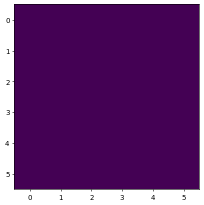

In [25]:
env.render()

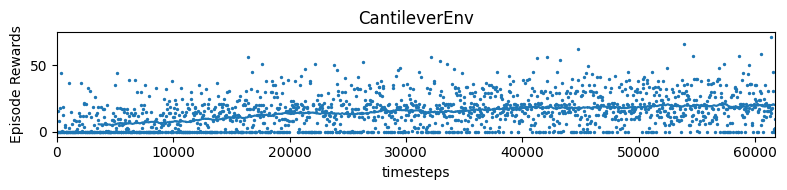

In [26]:
results_plotter.plot_results([log_dir], ts, results_plotter.X_TIMESTEPS, "CantileverEnv")

In [27]:
obs=env.reset()
obs=obs[0]

In [28]:
# Load the agent
model_best = PPO.load(log_dir + "best_model.zip", env=env)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.render_mode to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.render_mode` for environment variables or `env.get_wrapper_attr('render_mode')` that will search the reminding wrappers.
  logger.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/stable_baselines3/common/vec_env/base_vec_env.py:77: UserWarning: The `render_mode` attribute is not defined in your environment. It will be set to None.
  warnings.warn("The `render_mode` attribute is not defined in your environment. It will be set to None.")


In [29]:
i=0
while i<2000:
    action, _states = model_best.predict(obs)
    
    obs, rewards, dones, _ , info = env.step(int(action))
    if dones:
        break
    i+=1

1/1 [==============================] - 0s 44ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 18809510.0000 - mae: 18809510.0000
Epoch 5/5
1/1 [==============================] - 0s 43

1/1 [==============================] - 0s 3ms/step - loss: 49.1351 - mae: 49.1351
Epoch 5/5
1/1 [==============================] - 0s 43ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 49.1332 - mae: 49.1332
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1322 - mae: 49.1322
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1312 - mae: 49.1312
Epoch 4/5
1/1 [==============================] - 0s 2ms/step - loss: 49.1302 - mae: 49.1302
Epoch 5/5
1/1 [==============================] - 0s 42ms/step
Epoch 1/5
1/1 [==============================] - 0s 3ms/step - loss: 65.1766 - mae: 65.1766
Epoch 2/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1756 - mae: 65.1756
Epoch 3/5
1/1 [==============================] - 0s 2ms/step - loss: 65.1746 - mae: 65.1746
Epoch 4/5
1/1 [==============================] - 0s 3ms/step - loss: 65.1737 - mae: 65.1737
Epoch 5/5
1/1 [==============================] - 0s 43ms/s

In [30]:
i

36


Final Cantilever beam design:


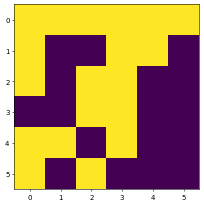

In [31]:
env.render()

In [32]:
# https://stable-baselines3.readthedocs.io/en/master/guide/save_format.html

In [33]:
fast_stopt(env.args, env.x)

/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.args to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.args` for environment variables or `env.get_wrapper_attr('args')` that will search the reminding wrappers.
  logger.warn(
/Library/Frameworks/Python.framework/Versions/3.9/lib/python3.9/site-packages/gymnasium/core.py:311: UserWarning: WARN: env.x to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.x` for environment variables or `env.get_wrapper_attr('x')` that will search the reminding wrappers.
  logger.warn(


(70.69254034644706, 0.5278250000000001)